In [ ]:
#!pip install netCDF4
#!pip install rocketpy
%pip install imageio
import sys
print(sys.path)
from datetime import datetime
from datetime import date
from datetime import timedelta
from time import process_time, perf_counter, time
import glob
import pandas as pd



#from rocketpy import Environment, SolidMotor, Rocket, Flight, Function

import numpy as np
from numpy.random import normal, uniform, choice
from IPython.display import display
tomorrow = date.today() + timedelta(days=1) #test
date_info= (tomorrow.year, tomorrow.month, tomorrow.day, 9) #test

# %config InlineBackend.figure_formats = ['svg']
import matplotlib as mpl
import matplotlib.pyplot as plt
# %matplotlib inline
mpl.rcParams['figure.figsize'] = [8, 5]
mpl.rcParams['figure.dpi'] = 120
mpl.rcParams['font.size'] = 14
mpl.rcParams['legend.fontsize'] = 14
mpl.rcParams['figure.titlesize'] = 14

def inch_to_meter(length):
  return length * 0.0254

def lbs_to_kg(mass):
  return mass * 0.45359237

def lbs_in3_to_kg_m3(density):
  return density * 27679.904710191

def lbft2_to_kgm2(areaMass):
  return areaMass * 0.0421401101

analysis_parameters = {
    # Mass Details
    "rocketMass": (lbs_to_kg(50.69), 0.1), # Rocket's dry mass (kg) and its uncertainty (standard deviation)

    # Propulsion Details - run help(SolidMotor) for more information
    # Sporadic Impulse values of 08/02/22 (impulse, burnOut)
    "impulse": (34391.28, 35.3),                         # Motor total impulse (N*s)
    "burnOut": (9, 0.1),                              # Motor burn out time (s)
    "nozzleRadius": (inch_to_meter(.582)*2/2.0, 0.5/1000),            # Motor's nozzle radius (m)
    "throatRadius": (inch_to_meter(.7715)*2/2.0, 0.001) ,                # Motor's nozzle throat radius (m)
    "grainSeparation": (inch_to_meter(0.25), 1/1000), #Check this                # Motor's grain separation (axial distance between two grains) (m)
    "grainDensity": (lbs_in3_to_kg_m3(0.0565), 0.001),                         # Motor's grain density (kg/m^3)
    "grainOuterRadius": (inch_to_meter(2.625)*2/2.0, 0.375/1000),        # Motor's grain outer radius (m)
    "grainInitialInnerRadius": (inch_to_meter(.875)*2/2.0, 0.375/1000), # Motor's grain inner radius (m)
    "grainInitialHeight": (inch_to_meter(8.25), 1/1000),           # Motor's grain height (m)

    # Aerodynamic Details - run help(Rocket) for more information
    "inertiaI": (lbft2_to_kgm2(5.3695), 0.03675),                       # Rocket's inertia moment perpendicular to its axis (kg*m^2)
    "inertiaZ": (lbft2_to_kgm2(1186.5), 0.00007),                       # Rocket's inertia moment relative to its axis (kg*m^2)
    "radius": (inch_to_meter(6.24)/2, 0.001),                      # Rocket's radius (kg*m^2)
    "distanceRocketNozzle": (inch_to_meter(.5),0.001),             # Distance between rocket's center of dry mass and nozzle exit plane (m) (negative)
    "distanceRocketPropellant": (-1 * inch_to_meter(24),0.001),         # TBD: Distance between rocket's center of dry mass and and center of propellant mass (m) (negative)
    "powerOffDrag": (0.5309, 0.033),               # From ChatGPT: TBD: ultiplier for rocket's drag curve. Usually has a mean value of 1 and a uncertainty of 5% to 10% #Openrocket plot and export, ignition to burnout
    "powerOnDrag": ( 0.5261, 0.033),                # From ChatGPT TBD: Multiplier for rocket's drag curve. Usually has a mean value of 1 and a uncertainty of 5% to 10% #burnout to end
    "noseLength": (inch_to_meter(14), 0.001),                       # Rocket's nose cone length (m)
    "noseDistanceToCM": (inch_to_meter(55.693), 0.001),                 # Axial distance between rocket's center of dry mass and nearest point in its nose cone (m)
    "finSpan": (inch_to_meter(6.75), 0.0005),                         # Fin span (m)
    "finRootChord": (inch_to_meter(14.25), 0.0005),                    # Fin root chord (m)
    "finTipChord": (inch_to_meter(5.625), 0.0005),                     # Fin tip chord (m)
    "finDistanceToCM": (inch_to_meter(30.531), 0.001),                 # Axial distance between rocket's center of dry mass and nearest point in its fin (m)

    # Launch and Environment Details - run help(Environment) and help(Flight) for more information
    # Sporadic Impulse values of 08/02/22 (inclanation, heading, rail length)
    "inclination": (90, 1),                           # Launch rail inclination angle relative to the horizontal plane (degrees)
    "heading": (90, 1),                                 # Launch rail heading relative to north (degrees)
    "railLength": (inch_to_meter(204) , 0.0005),                       # Launch rail length (m)
    "ensembleMember": list(range(10)),                  # Members of the ensemble forecast to be used

    # Parachute Details - run help(Rocket) for more information
    # Sporadic Impulse values of 08/02/22 (CdSDrogue)
    "CdSDrogue": (1.51, 0.07),                     # Drag coefficient times reference area for the drogue chute (m^2)
    "lag_rec": (1.5 , 0.5),                               # Time delay between parachute ejection signal is detected and parachute is inflated (s)

    # Parachute Details - run help(Rocket) for more information
    # Sporadic Impulse values of 08/02/22 (CdSDrogue)
    "CdSMain": (2.56644665, 0.07),                     # Drag coefficient times reference area for the drogue chute (m^2)
    #"lag_rec": (1 , 0.5),                               # Time delay between parachute ejection signal is detected and parachute is inflated (s)

    # Electronic Systems Details - run help(Rocket) for more information
    "lag_se": (3, 0.16)                              # Time delay between sensor signal is received and ejection signal is fired (s)
}



def flight_settings(analysis_parameters, total_number):
    i = 0
    while i < total_number:
        # Generate a flight setting
        flight_setting = {}

        for parameter_key, parameter_value in analysis_parameters.items():
            print(f"parameter_key: {parameter_key}, parameter_value: {parameter_value}")
            if type(parameter_value) is tuple:
                flight_setting[parameter_key] =  normal(*parameter_value)
            else:
                flight_setting[parameter_key] =  choice(parameter_value)

        # Skip if certain values are negative, which happens due to the normal curve but isnt realistic
        if flight_setting['lag_rec'] < 0 or  flight_setting['lag_se'] < 0: continue

        # Update counter
        i += 1
        # Yield a flight setting
        yield flight_setting



def export_flight_data(flight_setting, flight_data, exec_time):
    print(dir(flight_data))
    apogee_time = flight_data.apogee_time
    print(apogee_time)
    [print(flight_data.x(apogee_time))]
    print(flight_data.x_impact)
    print(flight_data.altitude - Env.elevation)

    flight_result = {"outOfRailTime": flight_data.out_of_rail_time,
                 "outOfRailVelocity": flight_data.out_of_rail_velocity,
                     "apogeeX": flight_data.x(apogee_time),
                     "apogeeY": flight_data.y(apogee_time),
                        "apogeeTime": flight_data.apogee_time,
                    "apogeeAltitude": flight_data.altitude - Env.elevation,
                      "impactX": flight_data.x_impact,
                     "impactY": flight_data.y_impact,
                    "impactVelocity": flight_data.impact_velocity,
               "initialStaticMargin": flight_data.rocket.static_margin(0),
             "outOfRailStaticMargin": flight_data.rocket.static_margin(TestFlight.out_of_rail_time),
                 "finalStaticMargin": flight_data.rocket.static_margin(TestFlight.rocket.motor.burn_out_time),
                    "numberOfEvents": len(flight_data.parachute_events),
                     "executionTime": exec_time}

    # Calculate maximum reached velocity
    sol = np.array(flight_data.solution)
    flight_data.vx = Function(sol[:, [0, 4]], 'Time (s)', 'Vx (m/s)', 'linear', extrapolation="natural")
    flight_data.vy = Function(sol[:, [0, 5]], 'Time (s)', 'Vy (m/s)', 'linear', extrapolation="natural")
    flight_data.vz = Function(sol[:, [0, 6]], 'Time (s)', 'Vz (m/s)', 'linear', extrapolation="natural")
    flight_data.v = (flight_data.vx**2 + flight_data.vy**2 + flight_data.vz**2)**0.5
    flight_data.maxVel = np.amax(flight_data.v.source[:, 1])
    flight_result['maxVelocity'] = flight_data.maxVel

    # Take care of parachute results
    if len(flight_data.parachute_events) > 0:
        flight_result['drogueTriggerTime'] = flight_data.parachute_events[0][0]
        flight_result['drogueInflatedTime'] = flight_data.parachute_events[0][0] + flight_data.parachute_events[0][1].lag
        flight_result['drogueInflatedVelocity'] = flight_data.v(flight_data.parachute_events[0][0] + flight_data.parachute_events[0][1].lag)
    else:
        flight_result['drogueTriggerTime'] = 0
        flight_result['drogueInflatedTime'] = 0
        flight_result['drogueInflatedVelocity'] = 0

    # Write flight setting and results to file
    #if dispersion_input_file.closed:
    dispersion_input_file = open("valetudo_rocket_v0.disp_inputs.txt", 'w')
    dispersion_input_file.write(str(flight_setting) + '\n')
    #dispersion_output_file = open("valetudo_rocket_v0.disp_outputs.txt", 'w')
    #dispersion_output_file.write(str(flight_result) + '\n')
    #with open(dispersion_input_file, "w") as file:
    #   file.write(str(flight_setting) + '\n')
    #with open(dispersion_output_file, "w") as file:
    #   file.write(str(flight_result) + '\n')
       

    dispersion_input_file.write(str(flight_setting) + '\n')
    #dispersion_output_file.write(str(flight_result) + '\n')
    return flight_result

def export_flight_error(flight_setting):
    global dispersion_error_file
    if dispersion_error_file.closed:
        dispersion_error_file = open(str(filename) + '.disp_errors.txt', 'a')
        dispersion_error_file.write(str(flight_setting) + '\n')







[notice] A new release of pip is available: 24.2 -> 25.0.1
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.
['/opt/anaconda3/lib/python312.zip', '/opt/anaconda3/lib/python3.12', '/opt/anaconda3/lib/python3.12/lib-dynload', '', '/Users/alexzhang/Desktop/projects/Aero/MonteCarloCode/my_env/lib/python3.12/site-packages']


In [145]:
import os

# Define the full path to your Downloads directory
output_dir = '/Users/alexzhang/Desktop/projects/Aero/MonteCarlo/RocketPy-Jupiter/rocketpy/valetudo_rocket_v0'

# Ensure the directory exists
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

# Proceed with file operations
filename = os.path.join(output_dir, '/Users/alexzhang/Desktop/projects/Aero/MonteCarlo/RocketPy-Jupiter/rocketpy/valetudo_rocket_v0')

try:
    #dispersion_error_file = open(str(filename) + '.disp_errors.txt', 'w')
    dispersion_error_file = open('valetudo_rocket_v0.disp_errors.txt', 'w')

    dispersion_input_file = open('valetudo_rocket_v0.disp_inputs.txt', 'w')
    dispersion_output_file = open("valetudo_rocket_v0.disp_outputs.txt", 'w')

    # Replace the test data with actual data
    dispersion_error_file.write("Your actual error messages.\n")
    dispersion_input_file.write("Your actual input data.\n")
    dispersion_output_file.write("Your actual output data.\n")

    # Close the files
    dispersion_error_file.close()
    dispersion_input_file.close()
    dispersion_output_file.close()
except Exception as e:
    print(f"An error occurred: {e}")
# Initialize counter and timer
i = 0

initial_wall_time = time()
initial_cpu_time = process_time()

In [137]:
# Define basic Environment object
#from Environment import Environment
from rocketpy import Environment
from datetime import datetime
from datetime import timedelta


current_time = datetime.now()
tomorrow = current_time+timedelta(days = 1)

Env = Environment(
    
    date = tomorrow,

    latitude = 32.988528,
    longitude = -106.975056,
    
    #elevation = 1400
)






#########
import xarray as xr



dictionary = {
                    "time": "time",
                    "latitude": "lat",
                    "longitude": "lon",
                    "level": "lev",
                    "ensemble": "ens",
                    "temperature": "tmpprs",
                    "surface_geopotential_height": None,
                    "geopotential_height": "hgtprs",
                    "geopotential": None,
                    "u_wind": "ugrdprs",
                    "v_wind": "vgrdprs",
                }

#If type is ensemble, file is GEFS
#If type is Forecast, file is GFS
Env.set_atmospheric_model(
        type = "Ensemble",
        #type = "Forecast",
        #file = "GEFS",
        file = "GEFS",
        dictionary = dictionary,
        pressure=None,
        temperature=None,
        wind_u=0,
        wind_v=0,
    )


oc_open: server error retrieving url: code=0 message="/gens_bc/gens20250218/gep_all_18z is not an available dataset"/Users/alexzhang/Desktop/projects/Aero/MonteCarloCode/my_env/lib/python3.12/site-packages/rocketpy/environment/tools.py:309: UserWarning: Exact chosen launch time is not available in the provided file, using 2025-02-19 18:00:00 UTC instead.
  warnings.warn(


In [138]:
#Env.all_info()


'Starting'

parameter_key: rocketMass, parameter_value: (54.93910785440001, 0.1)
parameter_key: impulse, parameter_value: (34391.28, 35.3)
parameter_key: burnOut, parameter_value: (9, 0.1)
parameter_key: nozzleRadius, parameter_value: (0.014782799999999999, 0.0005)
parameter_key: throatRadius, parameter_value: (0.019596099999999998, 0.001)
parameter_key: grainSeparation, parameter_value: (0.00635, 0.001)
parameter_key: grainDensity, parameter_value: (1563.9146161257916, 0.001)
parameter_key: grainOuterRadius, parameter_value: (0.066675, 0.000375)
parameter_key: grainInitialInnerRadius, parameter_value: (0.022224999999999998, 0.000375)
parameter_key: grainInitialHeight, parameter_value: (0.20955, 0.001)
parameter_key: inertiaI, parameter_value: (0.22627132118195004, 0.03675)
parameter_key: inertiaZ, parameter_value: (49.999240633650004, 7e-05)
parameter_key: radius, parameter_value: (0.079248, 0.001)
parameter_key: distanceRocketNozzle, parameter_value: (0.0127, 0.001)
parameter_key: distanceRocket

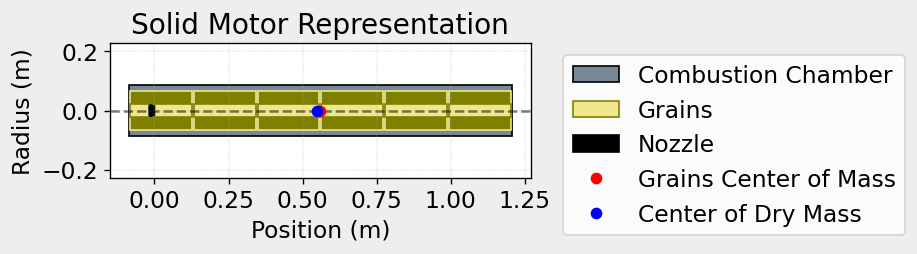

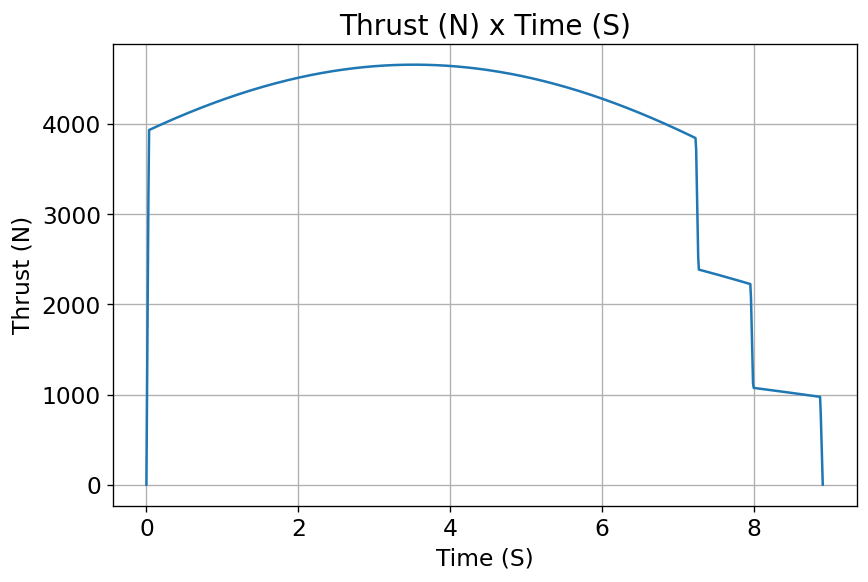

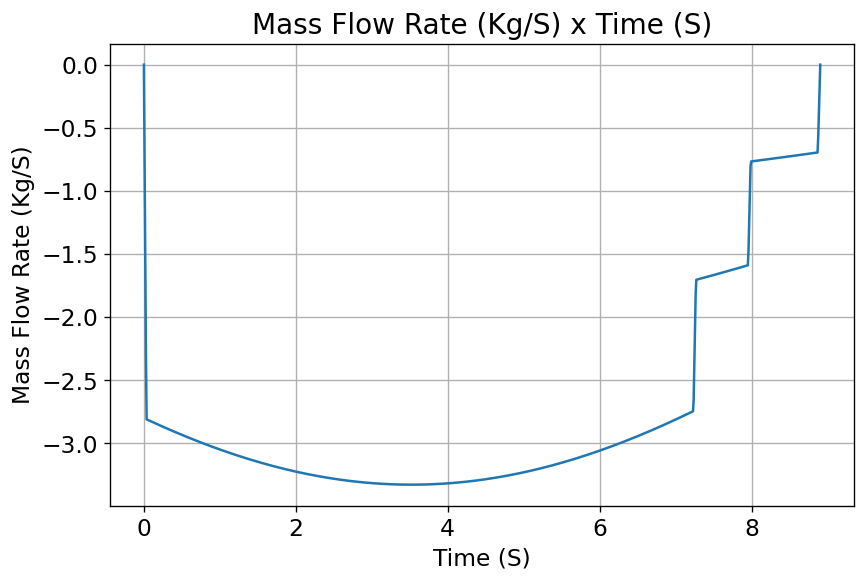

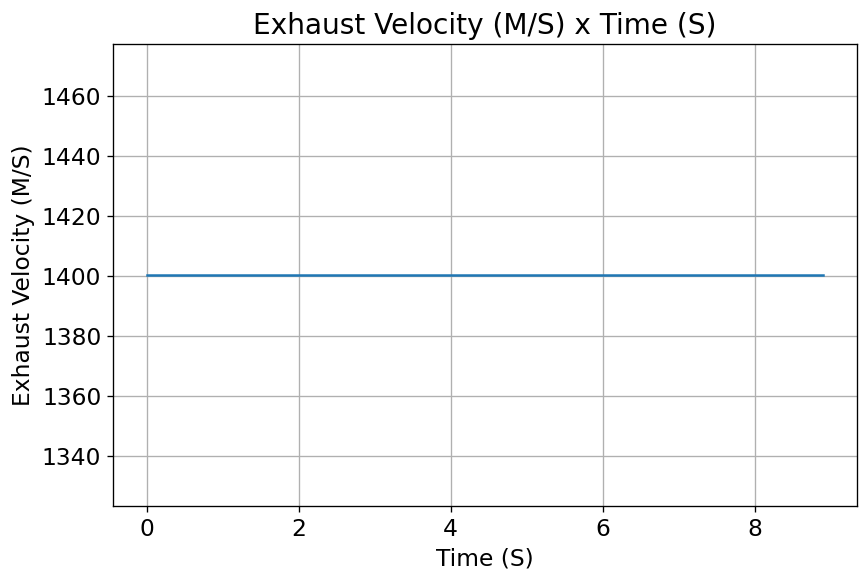

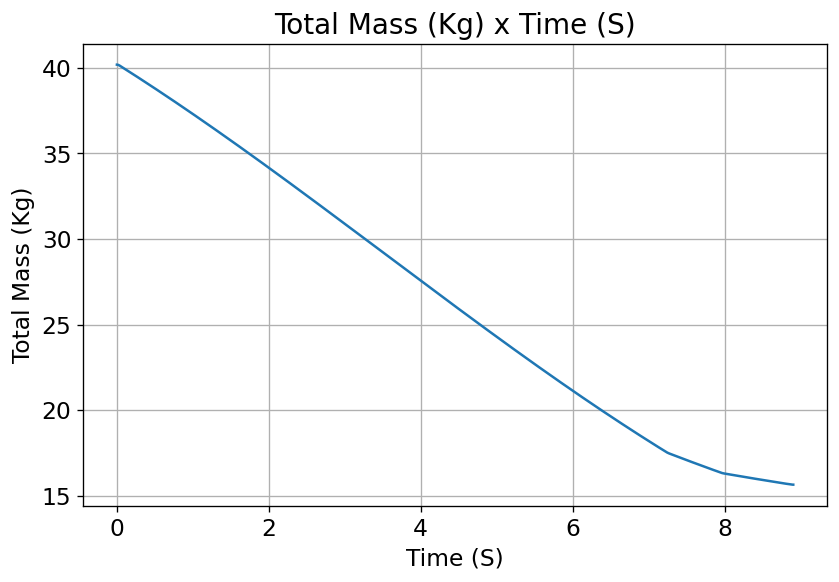

...

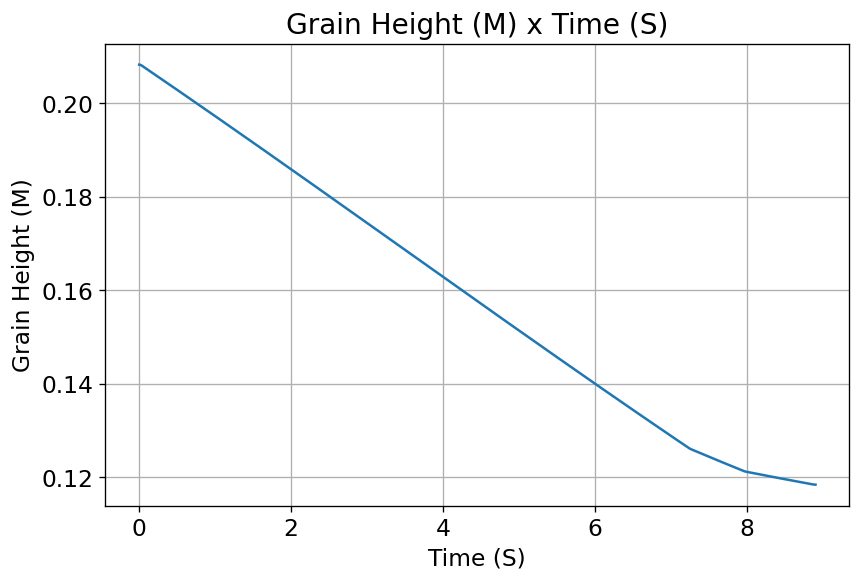

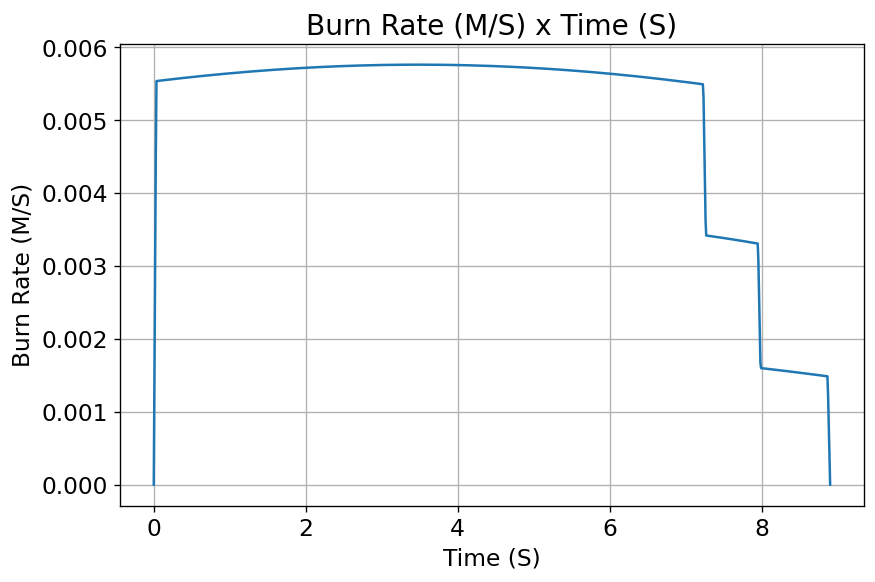

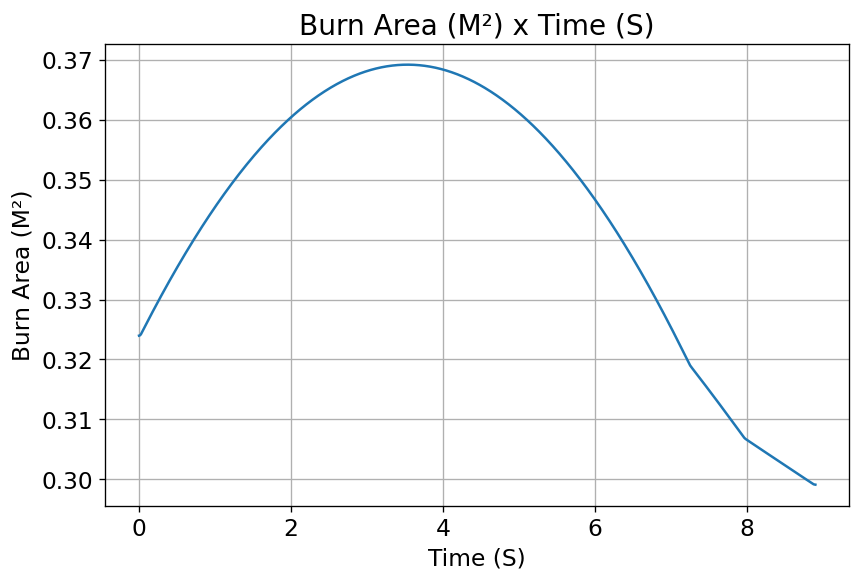

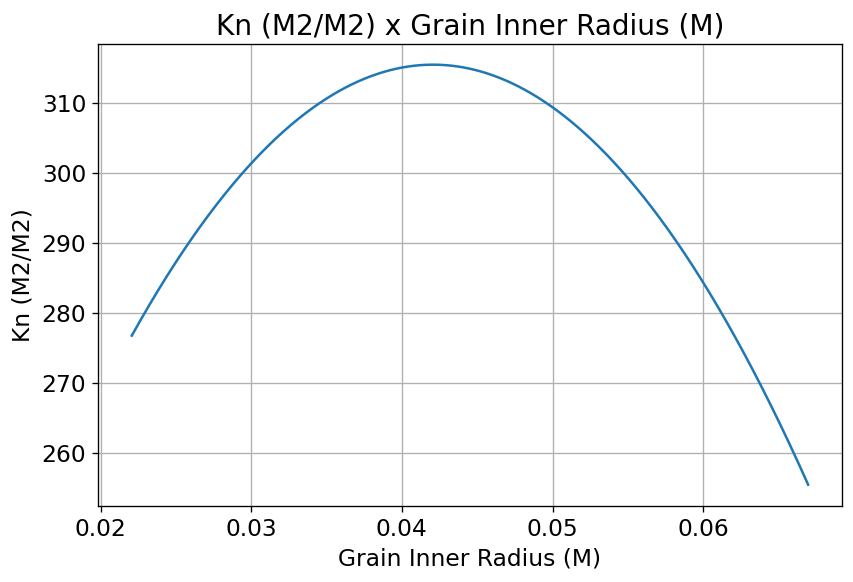

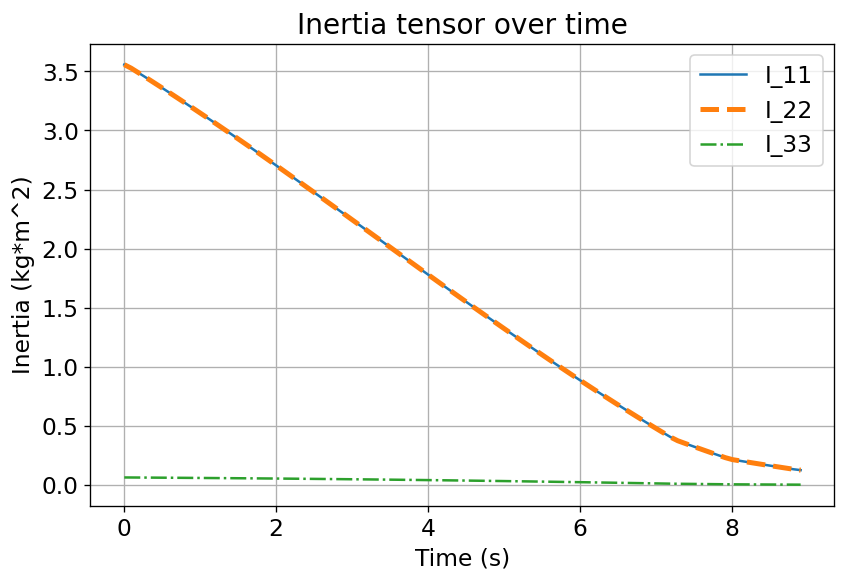

rocketCreated!!!

Inertia Details

Rocket Mass: 54.766 kg (without motor)
Rocket Dry Mass: 70.406 kg (with unloaded motor)
Rocket Loaded Mass: 94.956 kg
Rocket Structural Mass Ratio: 0.741
Rocket Inertia (with unloaded motor) 11: 26.035 kg*m2
Rocket Inertia (with unloaded motor) 22: 75.788 kg*m2
Rocket Inertia (with unloaded motor) 33: 0.002 kg*m2
Rocket Inertia (with unloaded motor) 12: 0.000 kg*m2
Rocket Inertia (with unloaded motor) 13: 0.000 kg*m2
Rocket Inertia (with unloaded motor) 23: 0.000 kg*m2

Geometrical Parameters

Rocket Maximum Radius: 0.07982000761921289 m
Rocket Frontal Area: 0.020016 m2

Rocket Distances
Rocket Center of Dry Mass - Center of Mass without Motor: 0.323 m
Rocket Center of Dry Mass - Nozzle Exit: 1.679 m
Rocket Center of Dry Mass - Center of Propellant Mass: 1.119 m
Rocket Center of Mass - Rocket Loaded Center of Mass: 0.289 m


Aerodynamics Lift Coefficient Derivatives

Nose Cone Lift Coefficient Derivative: 2.000/rad
Fins Lift Coefficient Derivative: 7.

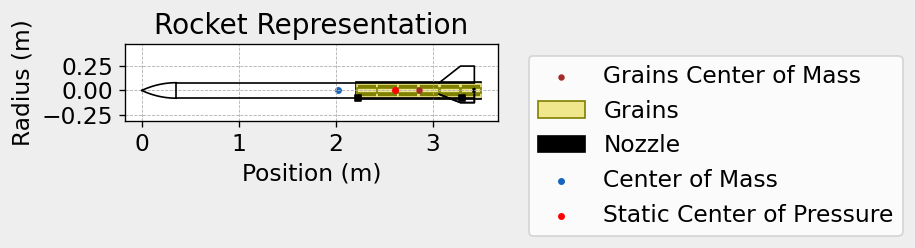


Mass Plots
----------------------------------------


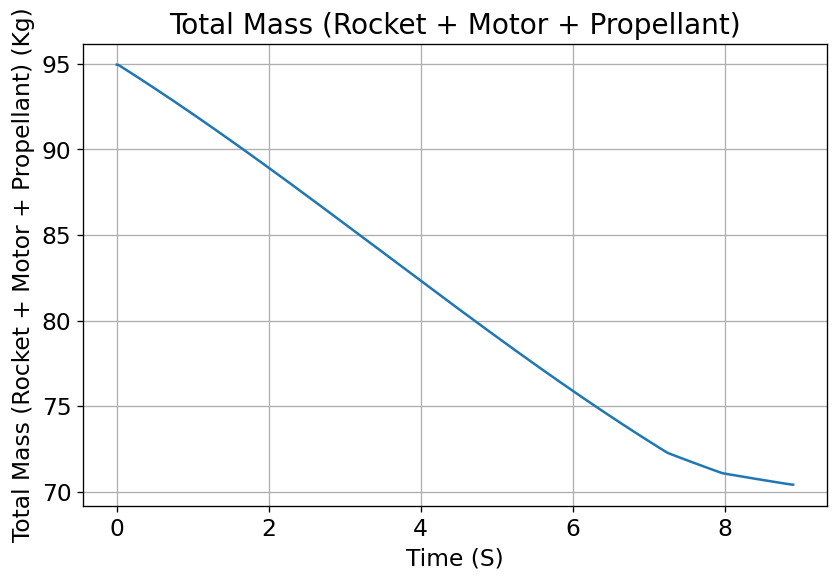

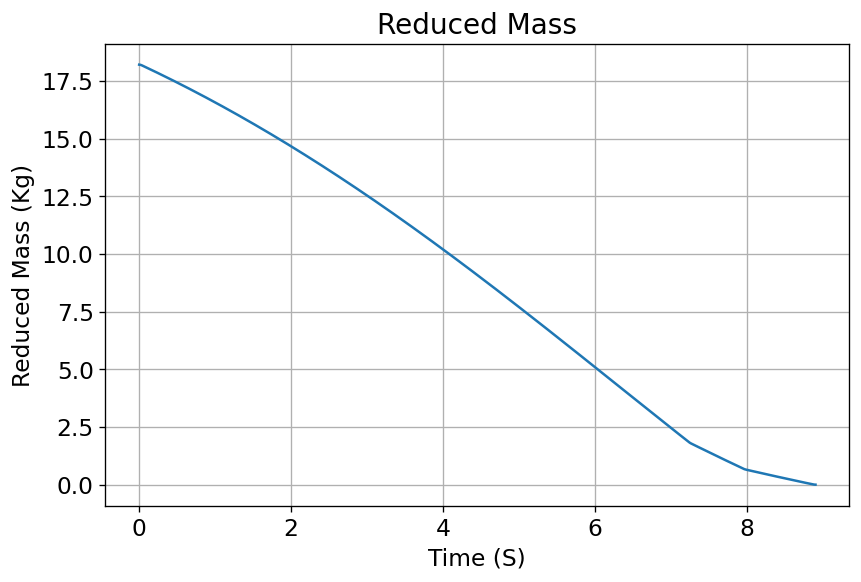


Aerodynamics Plots
----------------------------------------
Drag Plots
--------------------


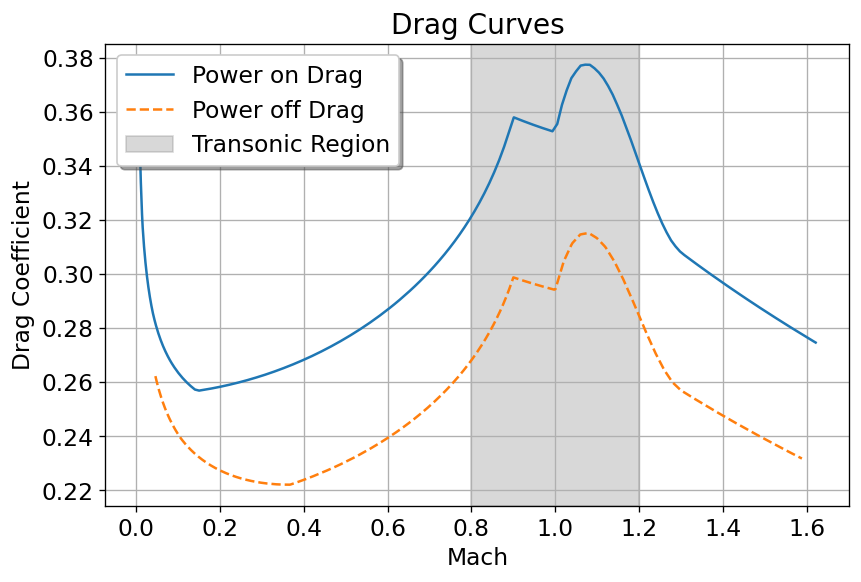


Stability Plots
--------------------


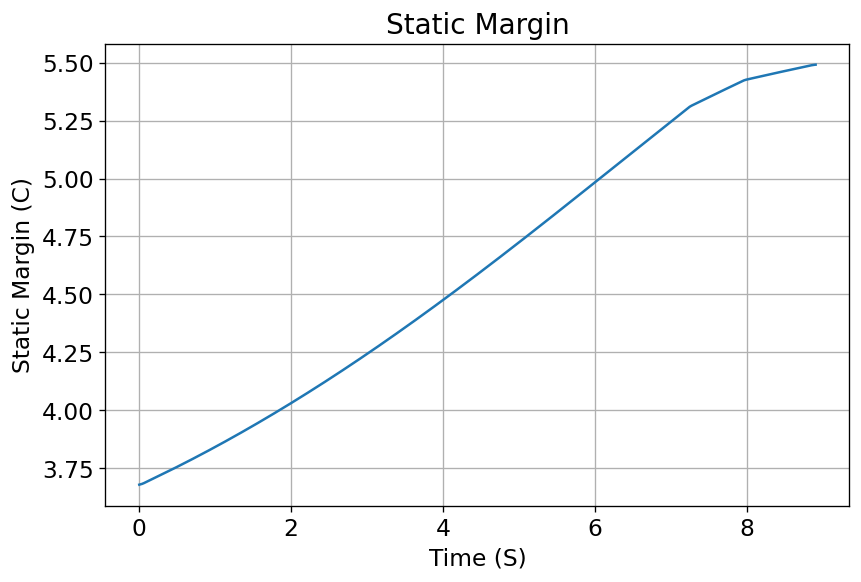

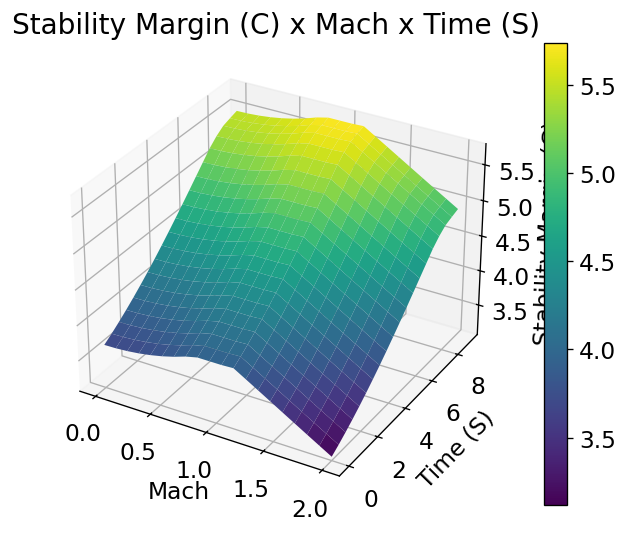


Thrust-to-Weight Plot
----------------------------------------


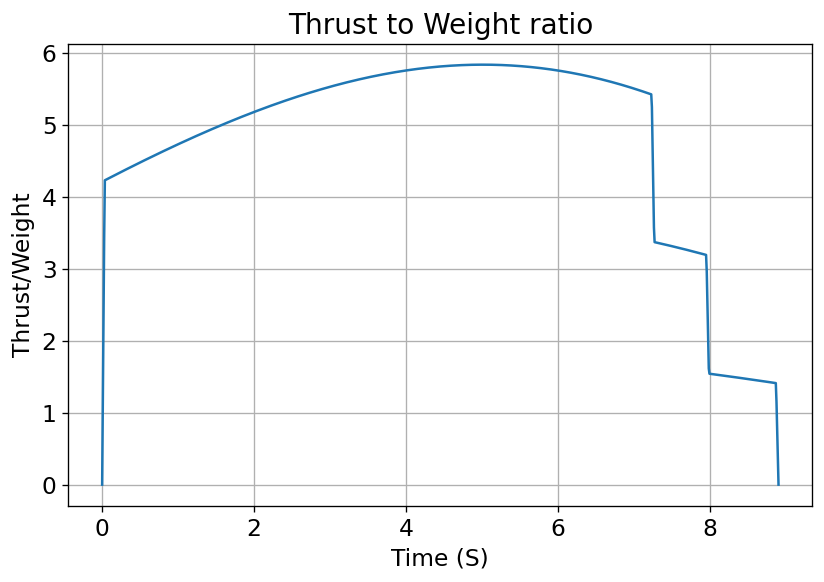

running flight

Initial Conditions

Initial time: 0.000 s
Position - x: 0.00 m | y: 0.00 m | z: 0.00 m
Velocity - Vx: 0.00 m/s | Vy: 0.00 m/s | Vz: 0.00 m/s
Attitude (quaternions) - e0: 0.721 | e1: 0.004 | e2: -0.004 | e3: -0.693
Euler Angles - Spin φ : -180.00° | Nutation θ: -0.69° | Precession ψ: 92.25°
Angular Velocity - ω1: 0.00 rad/s | ω2: 0.00 rad/s | ω3: 0.00 rad/s
Initial Stability Margin: 3.679 c


Surface Wind Conditions

Frontal Surface Wind Speed: -0.98 m/s
Lateral Surface Wind Speed: 1.76 m/s


Launch Rail

Launch Rail Length: 5.1816 m
Launch Rail Inclination: 90.69°
Launch Rail Heading: 87.75°


Rail Departure State

Rail Departure Time: 0.516 s
Rail Departure Velocity: 16.310 m/s
Rail Departure Stability Margin: 3.760 c
Rail Departure Angle of Attack: 7.038°
Rail Departure Thrust-Weight Ratio: 4.484
Rail Departure Reynolds Number: 1.719e+05


Burn out State

Burn out time: 8.903 s
Altitude at burn out: 1567.085 m (ASL) | 1567.085 m (AGL)
Rocket speed at burn out: 313.721

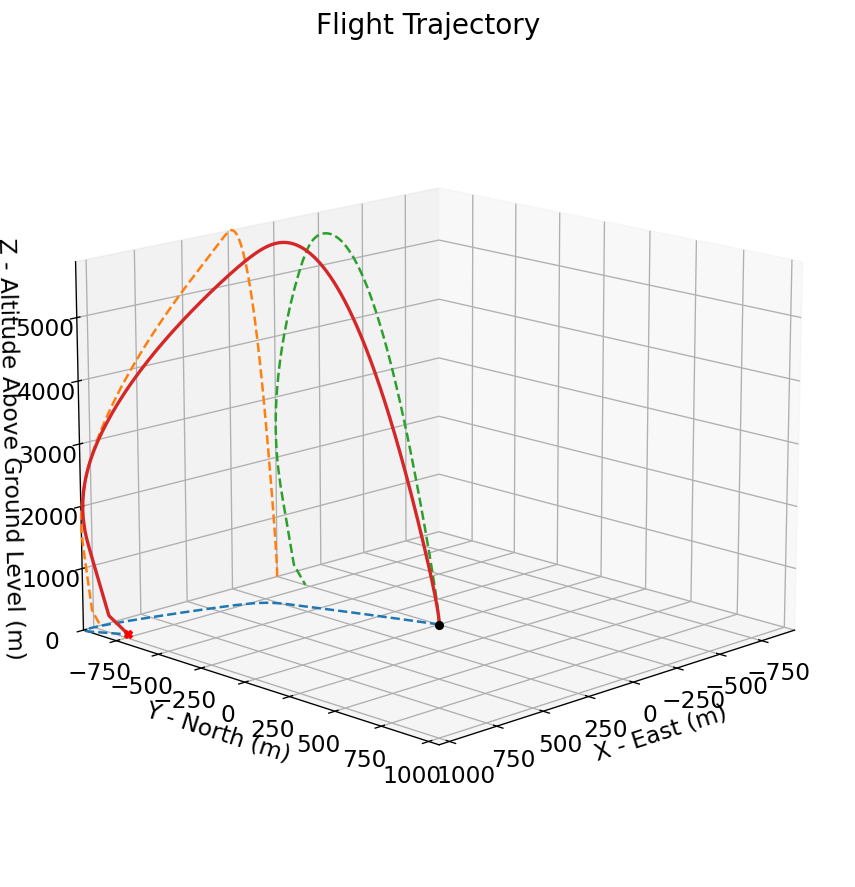



Trajectory Kinematic Plots



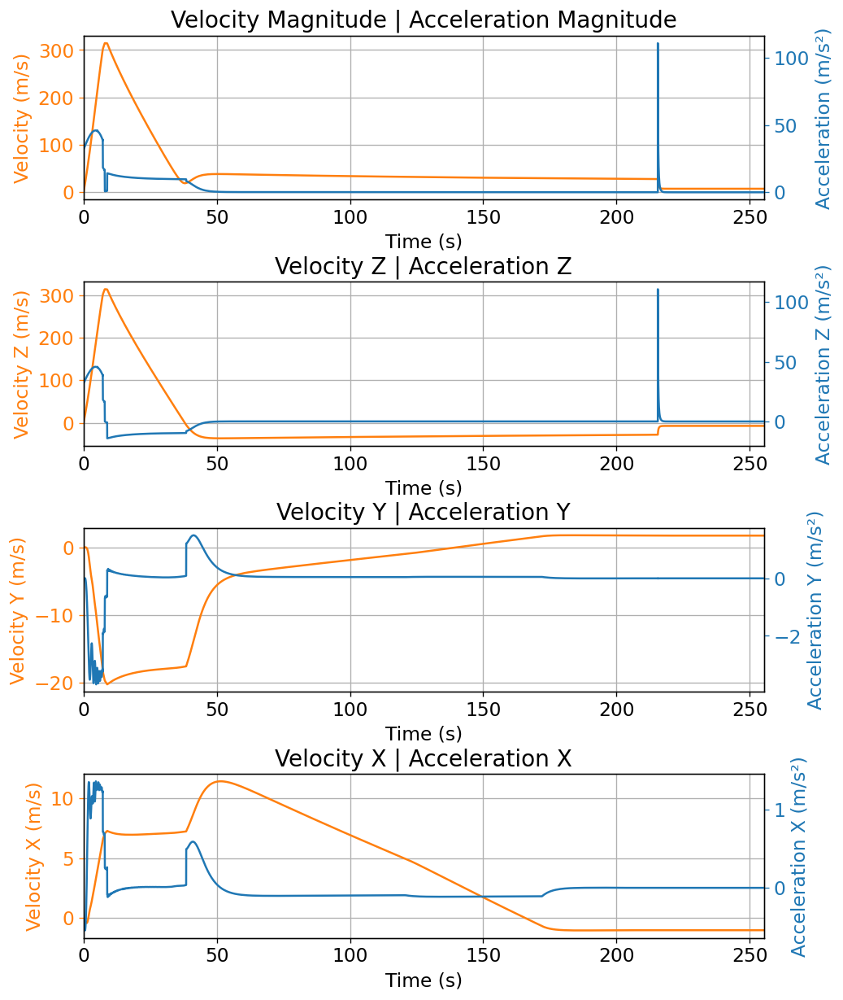



Angular Position Plots



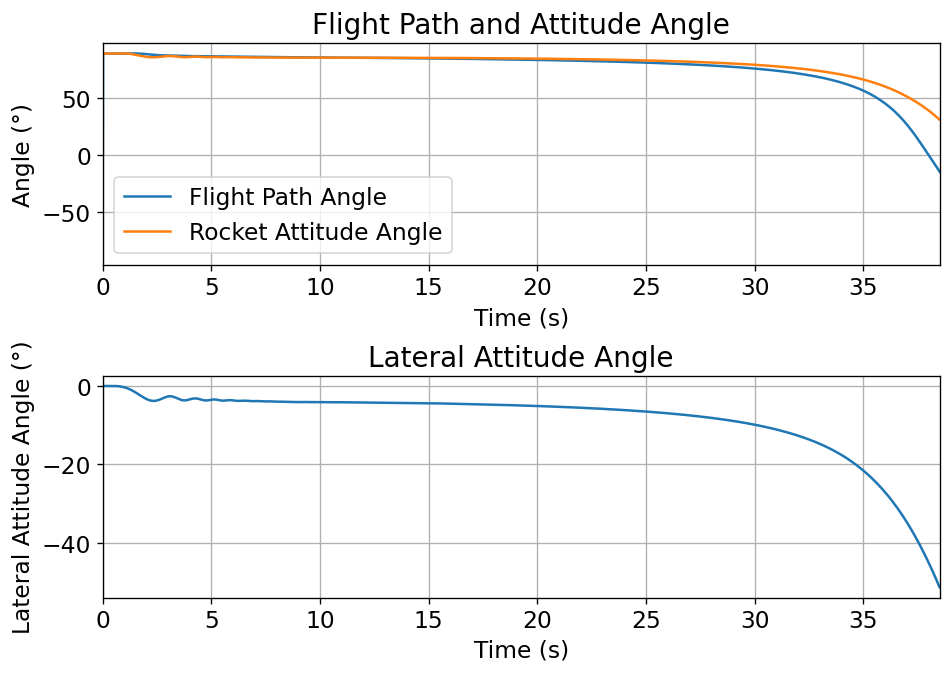



Path, Attitude and Lateral Attitude Angle plots



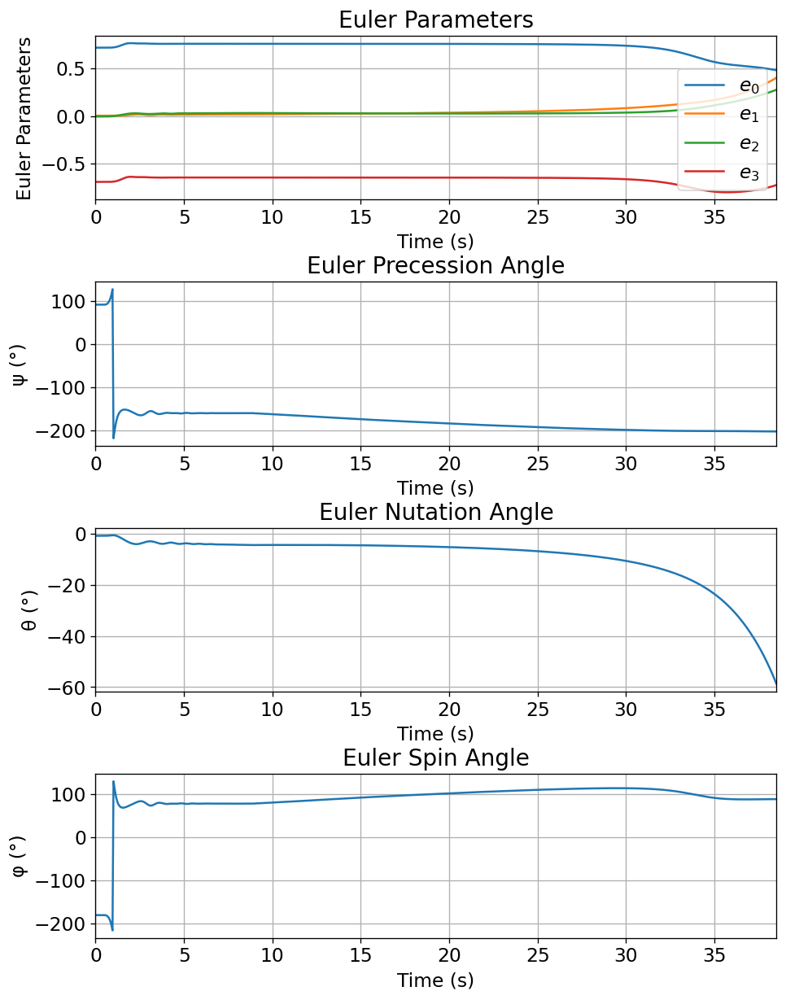



Trajectory Angular Velocity and Acceleration Plots



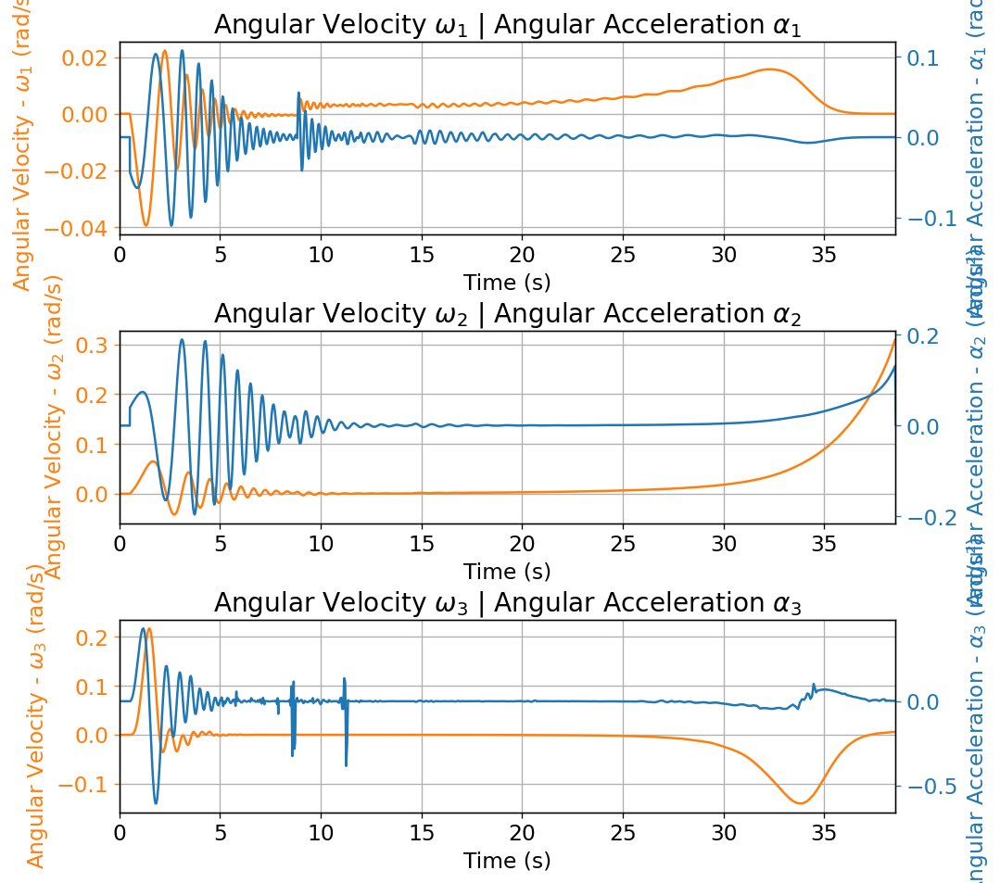



Aerodynamic Forces Plots



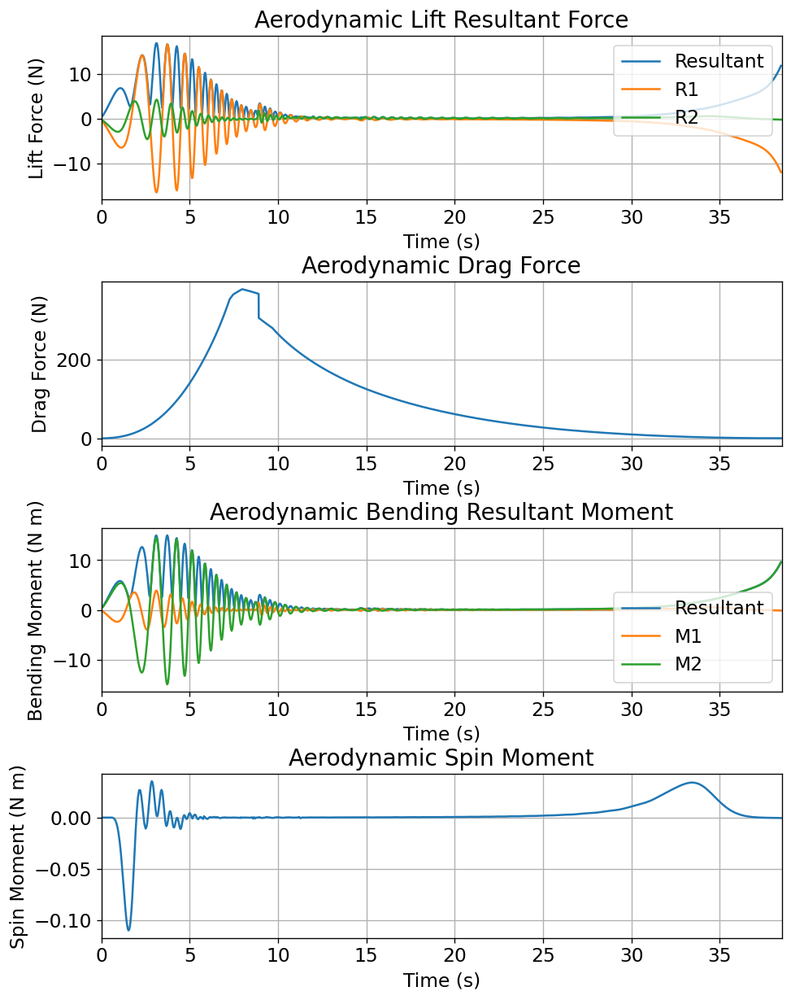



Rail Buttons Forces Plots



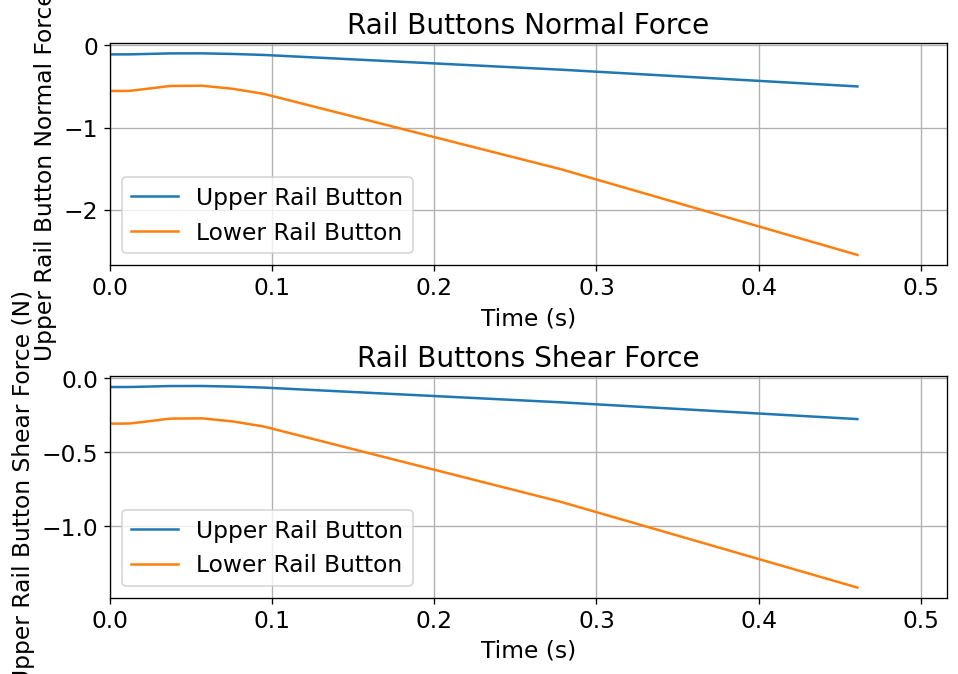



Trajectory Energy Plots



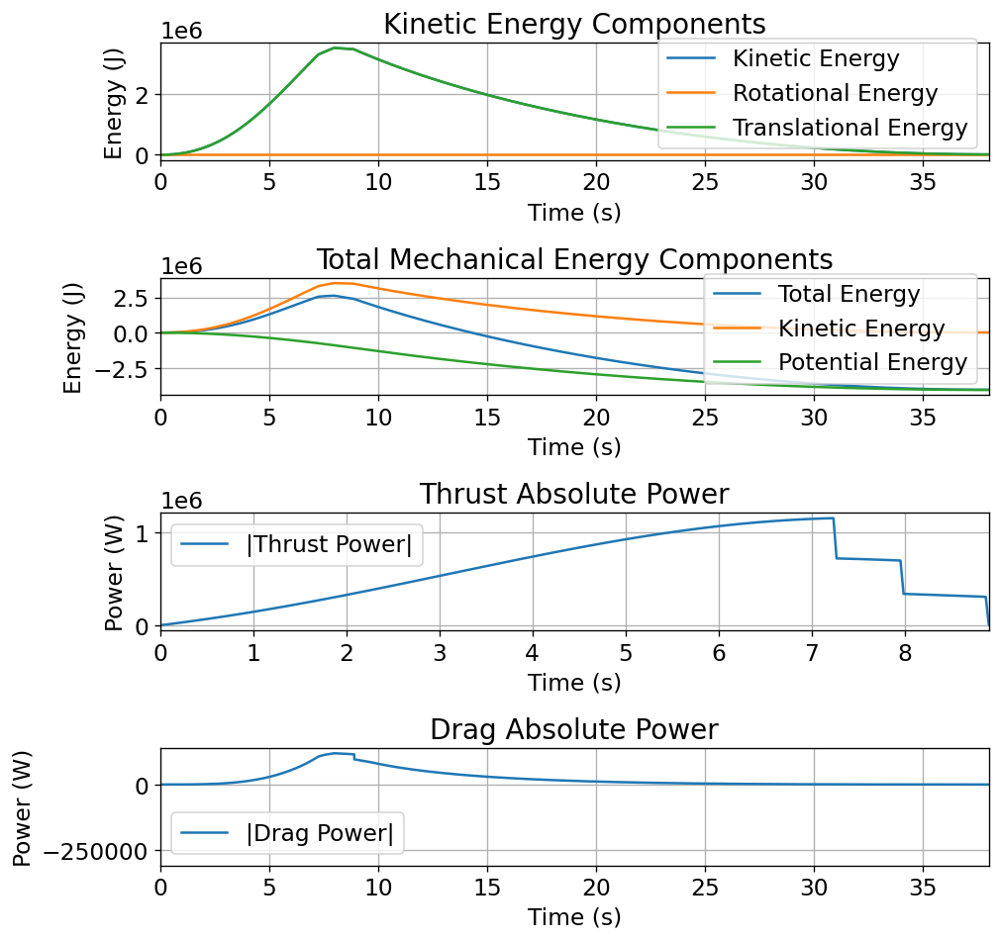



Trajectory Fluid Mechanics Plots



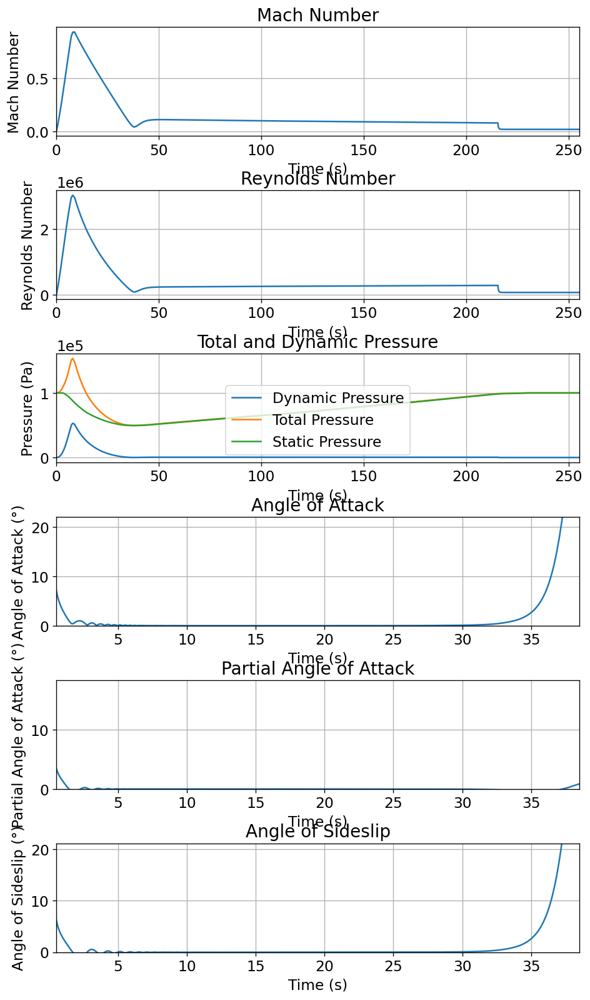



Trajectory Stability and Control Plots



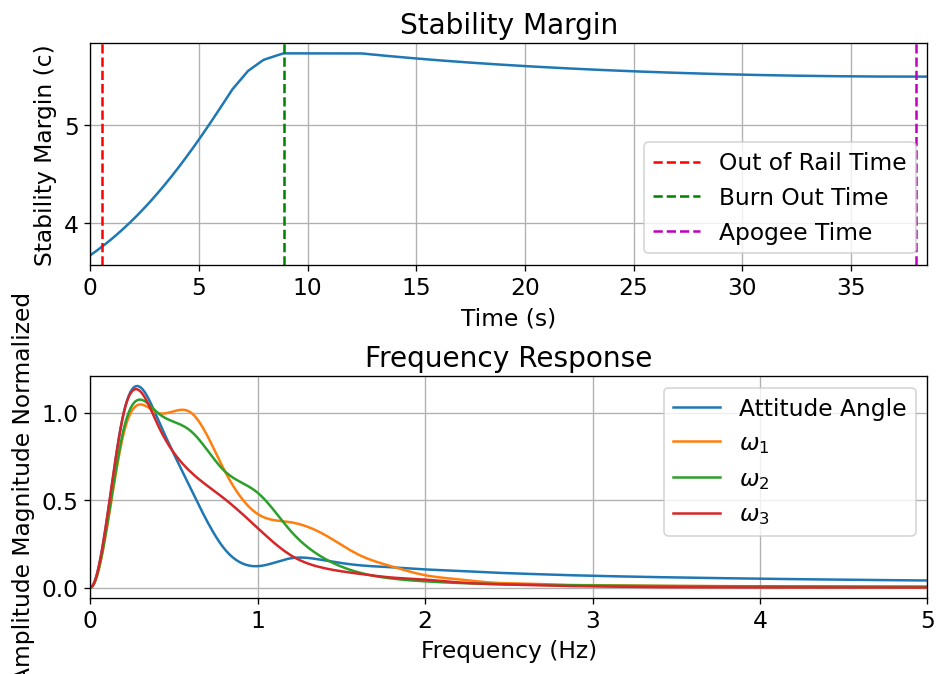



Rocket and Parachute Pressure Plots



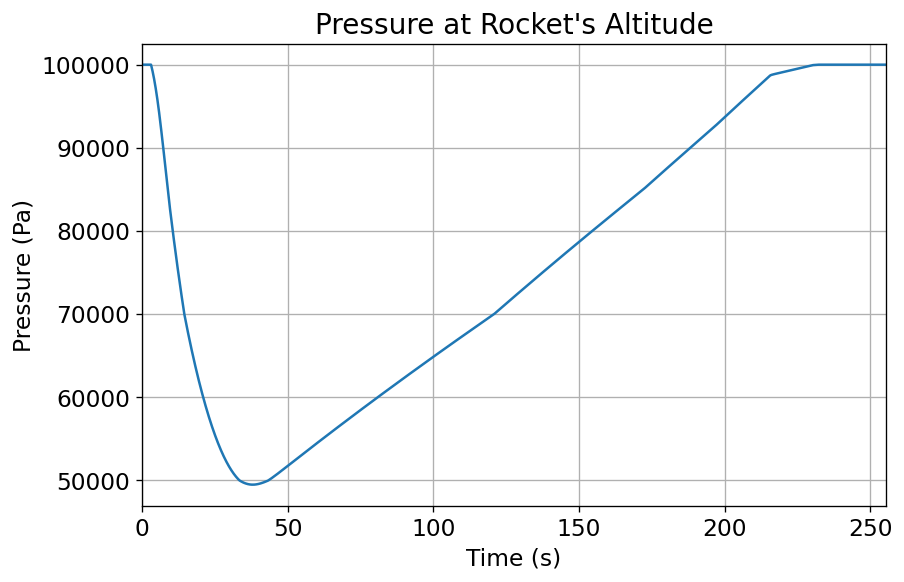


Parachute:  Drogue


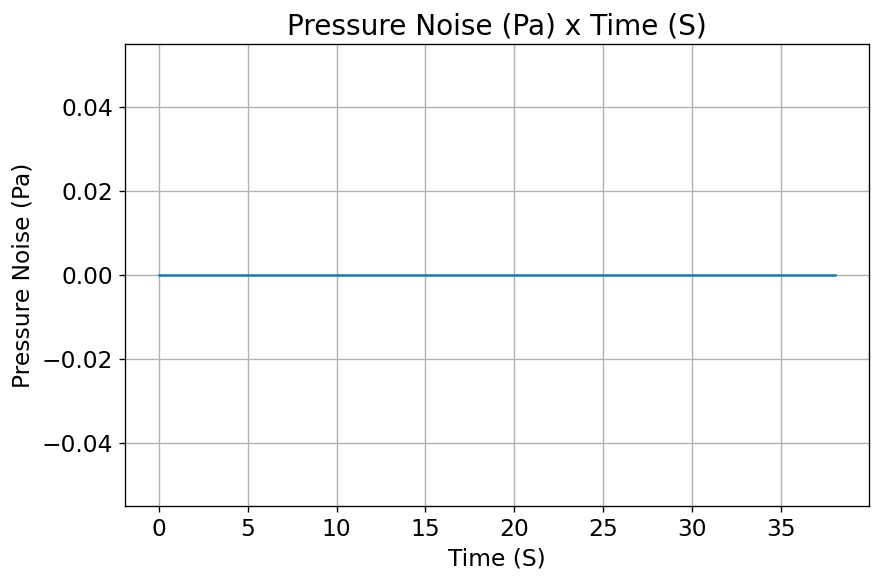

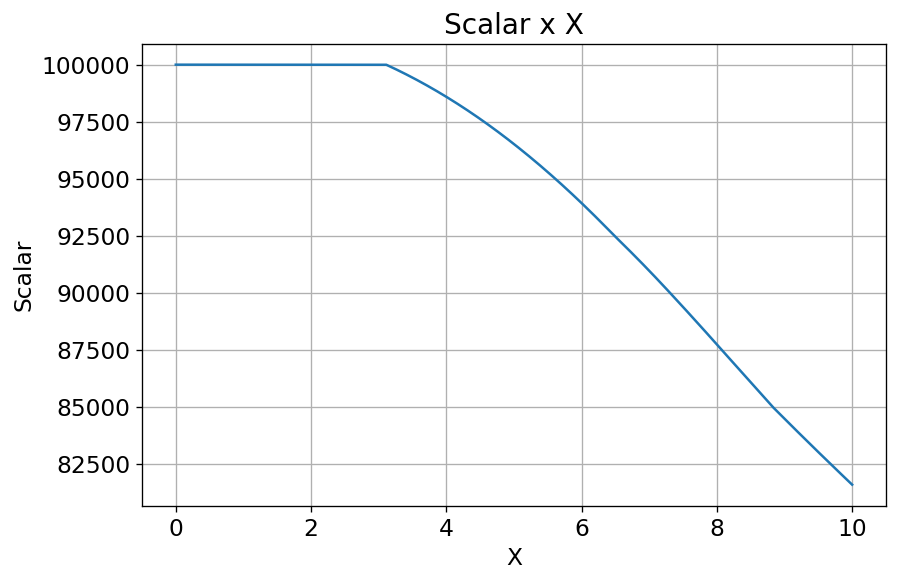

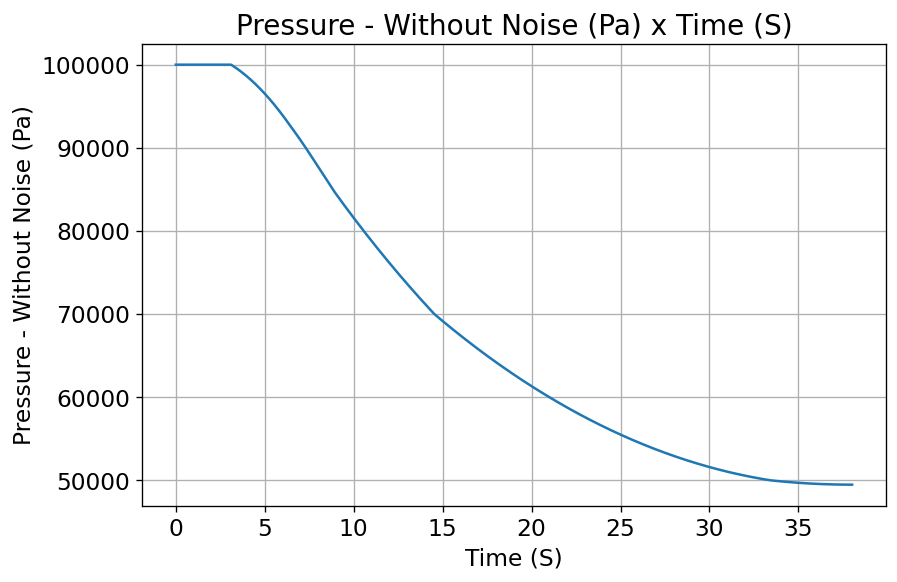


Parachute:  Main


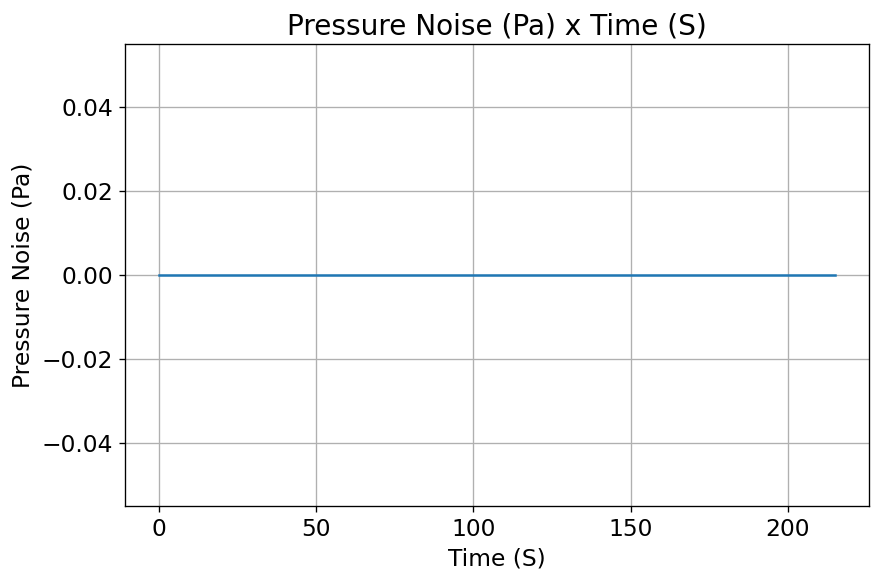

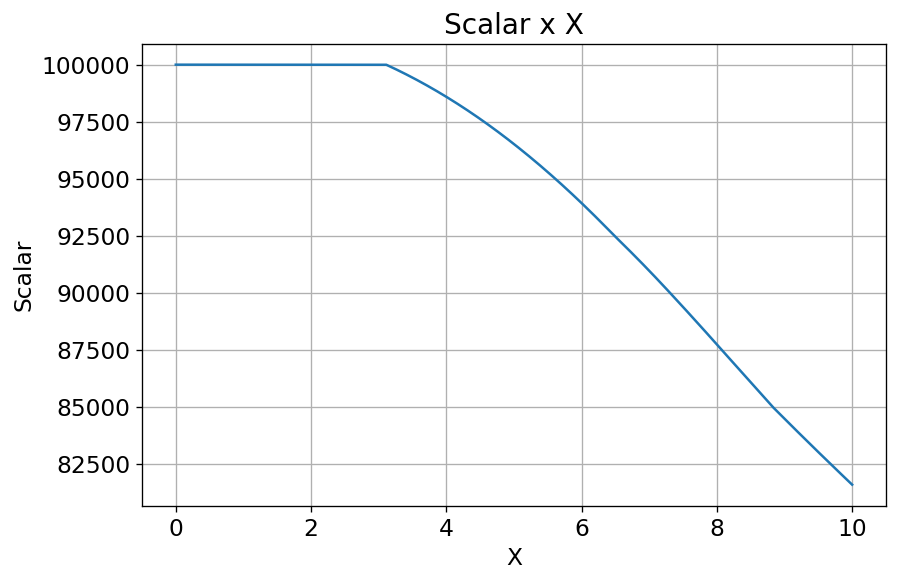

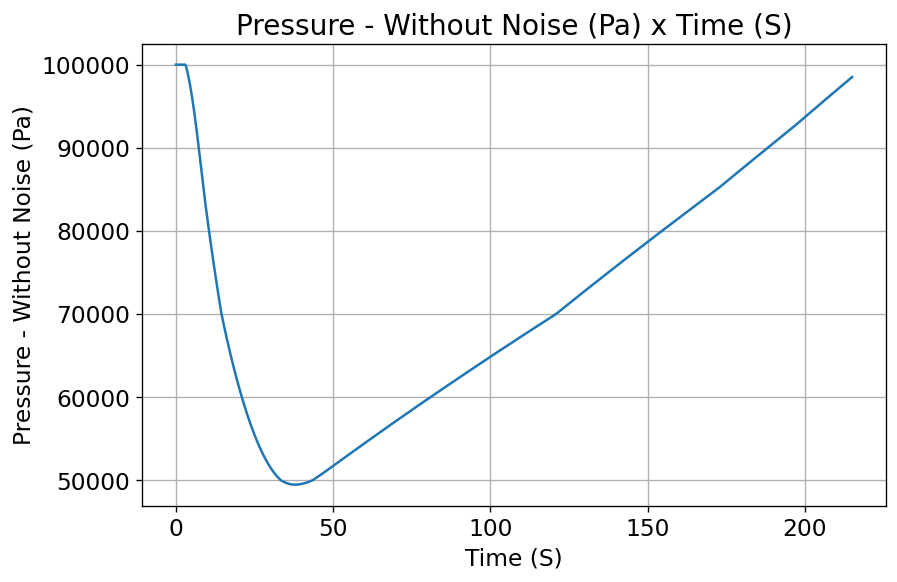

['FlightPhases', 'M1', 'M2', 'M3', 'R1', 'R2', 'R3', 'TimeNodes', '_Flight__cache_sensor_data', '_Flight__calculate_and_save_pressure_signals', '_Flight__calculate_rail_button_forces', '_Flight__evaluate_post_process', '_Flight__init_controllers', '_Flight__init_equations_of_motion', '_Flight__init_flight_state', '_Flight__init_solution_monitors', '_Flight__init_solver_monitors', '_Flight__is_lsoda', '_Flight__post_processed_variables', '_Flight__set_ode_solver', '_Flight__simulate', '_Flight__transform_pressure_signals_lists_to_functions', '__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_controllers', '_solver', 'acceleration', 'aerodynamic_bending_moment', 'aerodynamic_drag', 

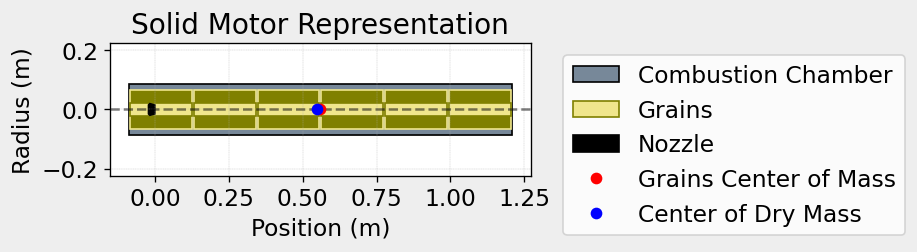

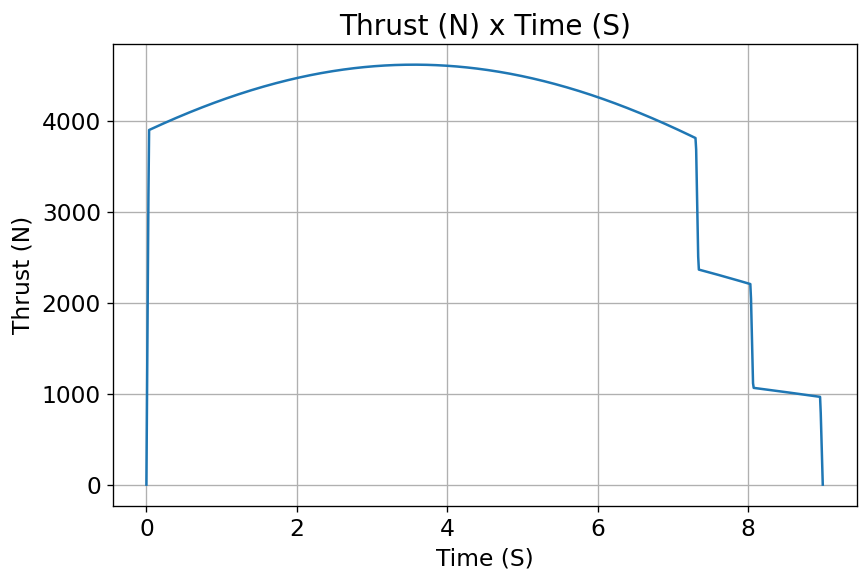

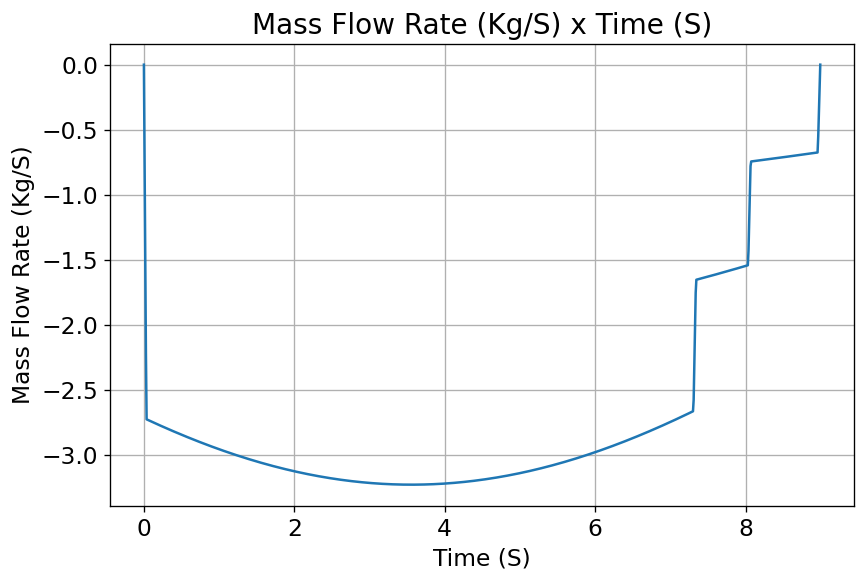

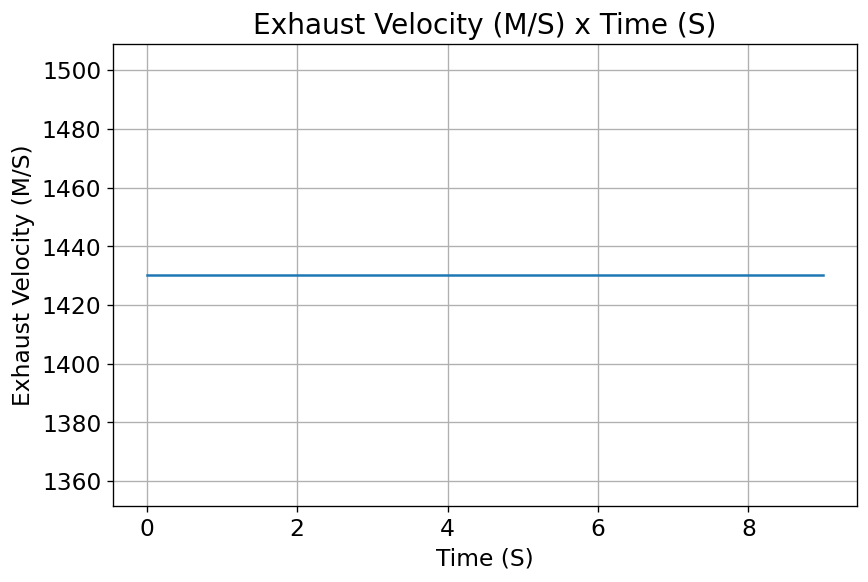

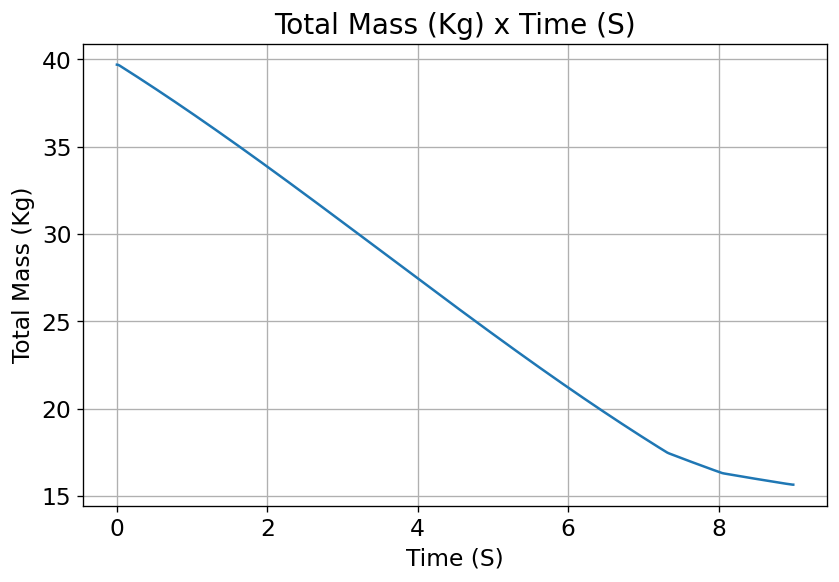

...

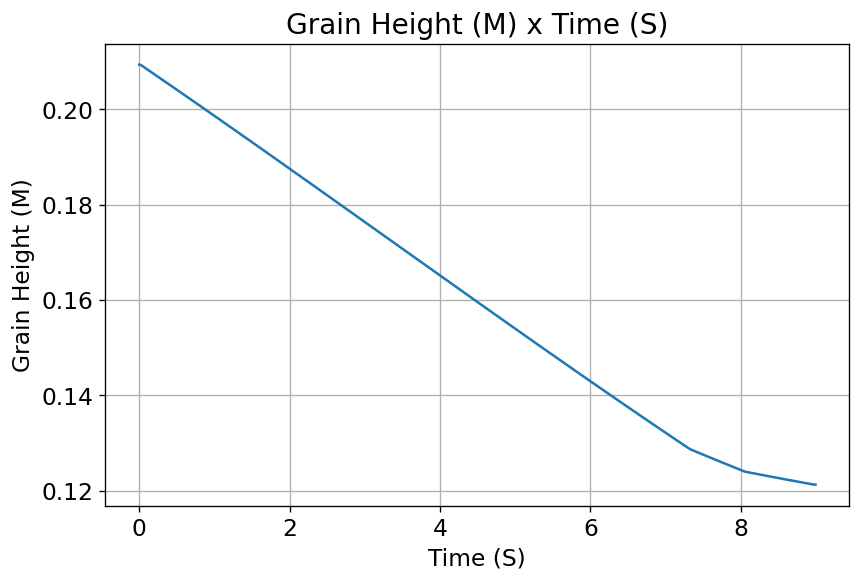

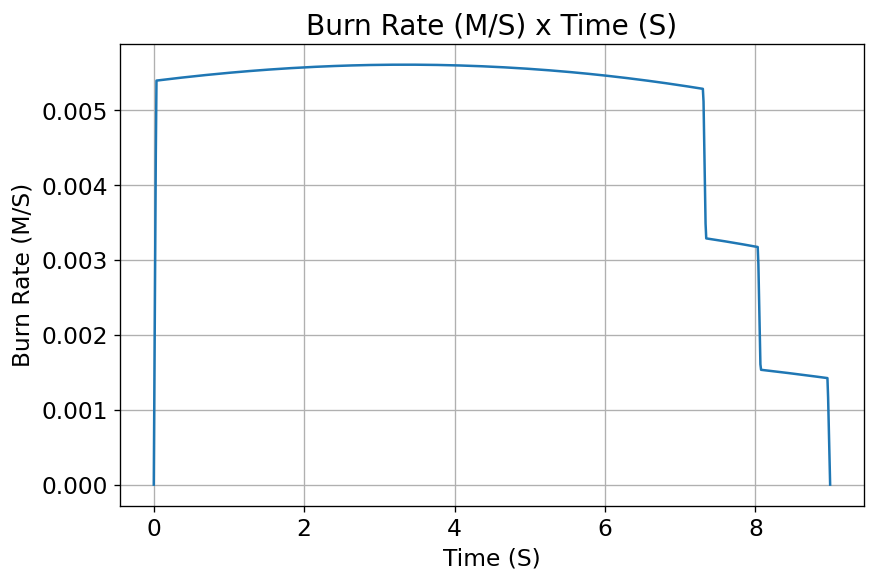

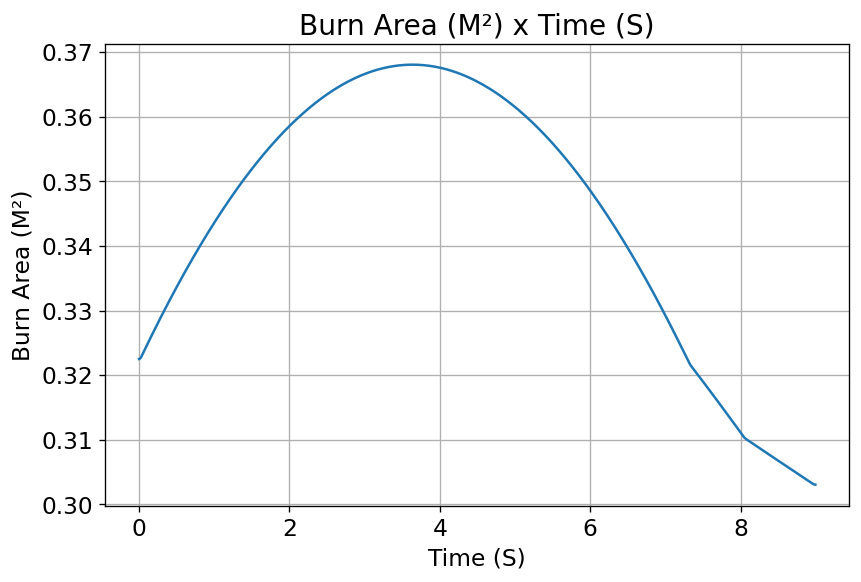

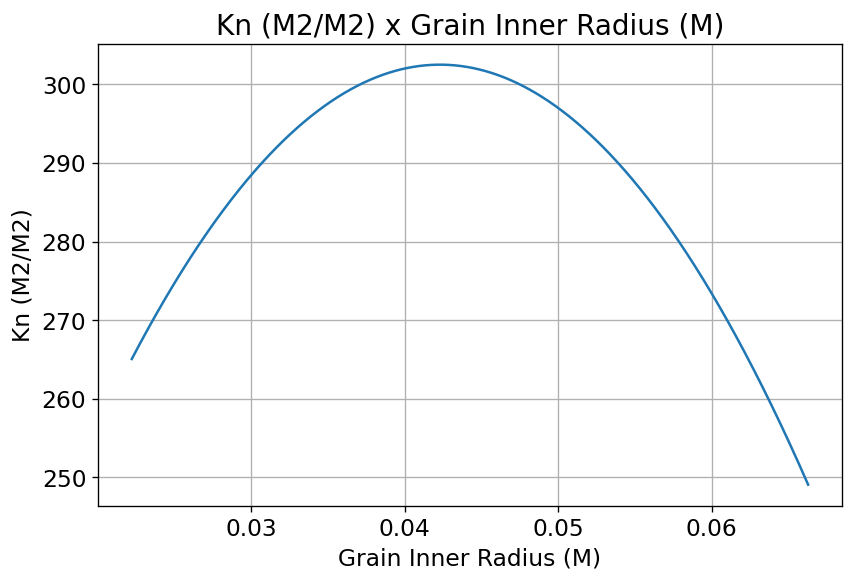

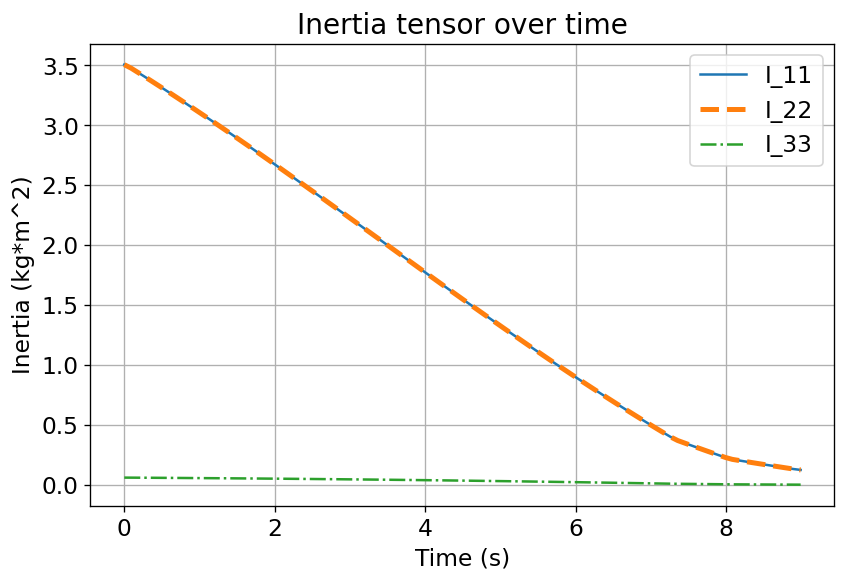

rocketCreated!!!

Inertia Details

Rocket Mass: 54.873 kg (without motor)
Rocket Dry Mass: 70.513 kg (with unloaded motor)
Rocket Loaded Mass: 94.576 kg
Rocket Structural Mass Ratio: 0.746
Rocket Inertia (with unloaded motor) 11: 26.002 kg*m2
Rocket Inertia (with unloaded motor) 22: 75.799 kg*m2
Rocket Inertia (with unloaded motor) 33: 0.002 kg*m2
Rocket Inertia (with unloaded motor) 12: 0.000 kg*m2
Rocket Inertia (with unloaded motor) 13: 0.000 kg*m2
Rocket Inertia (with unloaded motor) 23: 0.000 kg*m2

Geometrical Parameters

Rocket Maximum Radius: 0.07926101951332079 m
Rocket Frontal Area: 0.019736 m2

Rocket Distances
Rocket Center of Dry Mass - Center of Mass without Motor: 0.322 m
Rocket Center of Dry Mass - Nozzle Exit: 1.680 m
Rocket Center of Dry Mass - Center of Propellant Mass: 1.120 m
Rocket Center of Mass - Rocket Loaded Center of Mass: 0.285 m


Aerodynamics Lift Coefficient Derivatives

Nose Cone Lift Coefficient Derivative: 2.000/rad
Fins Lift Coefficient Derivative: 8.

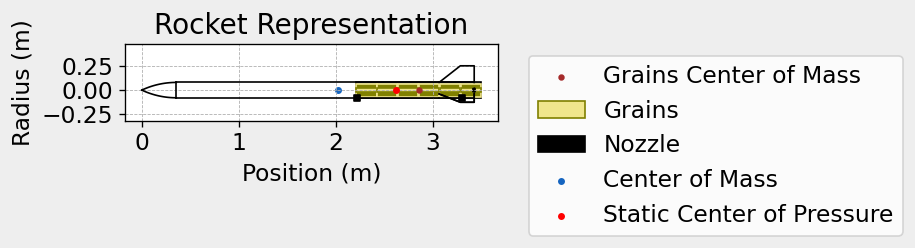


Mass Plots
----------------------------------------


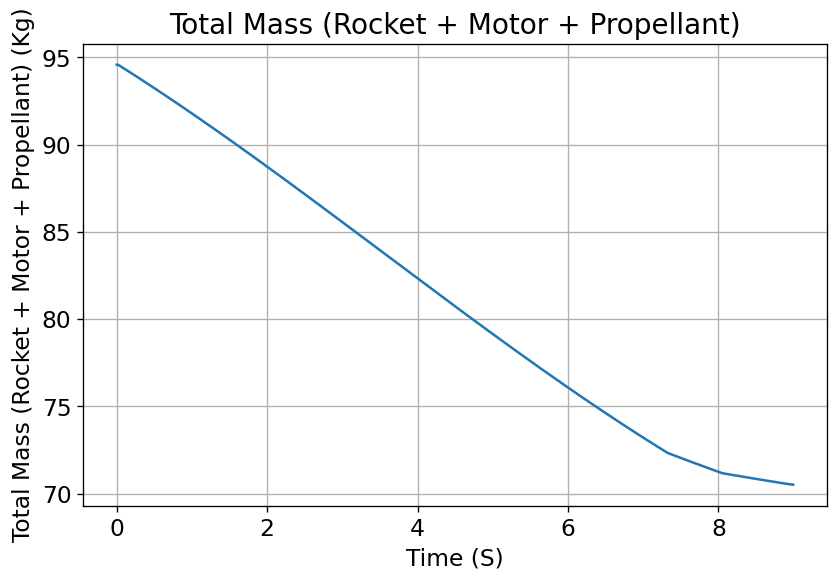

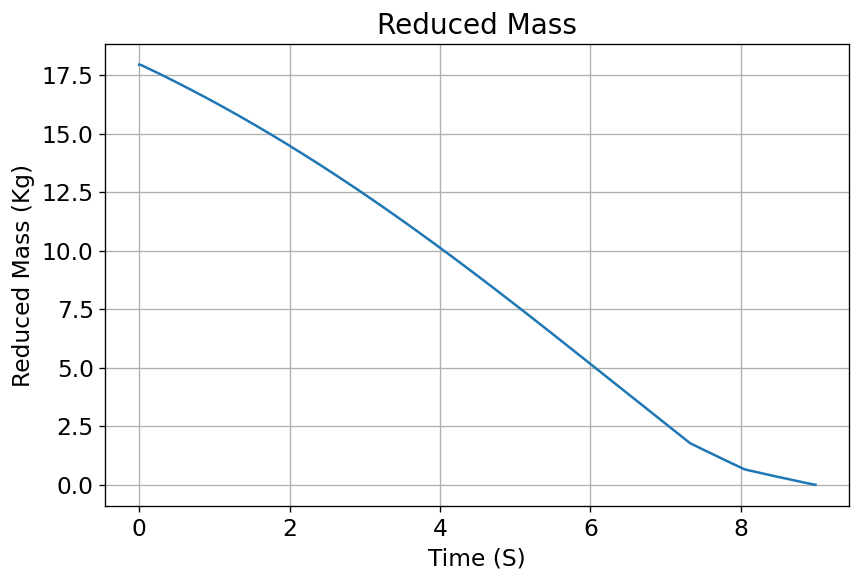


Aerodynamics Plots
----------------------------------------
Drag Plots
--------------------


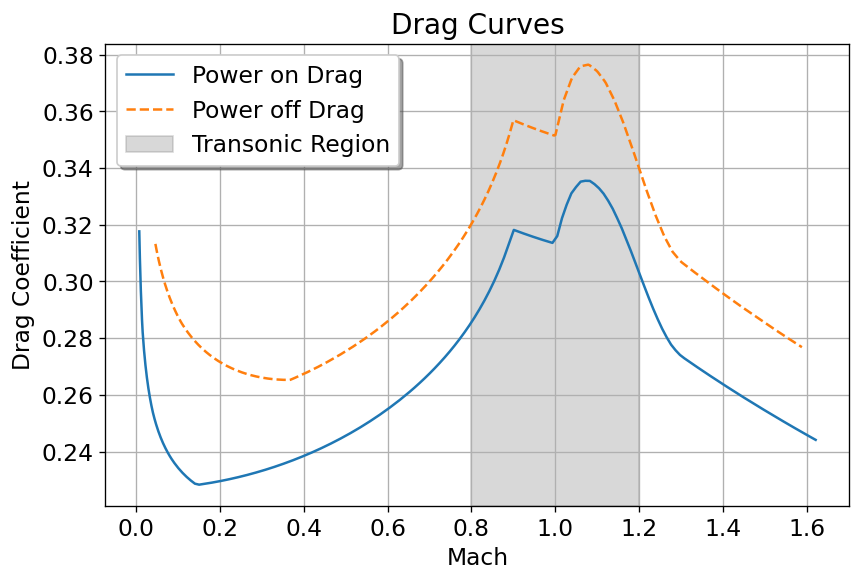


Stability Plots
--------------------


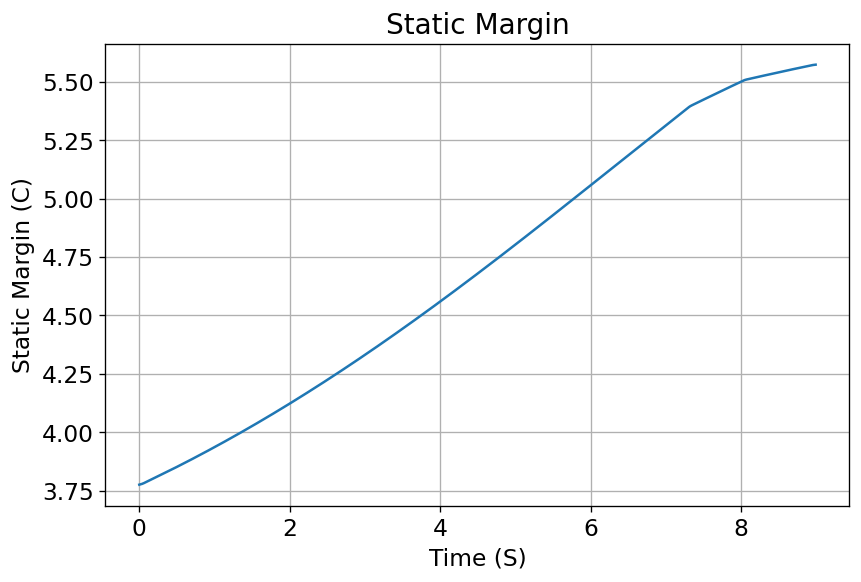

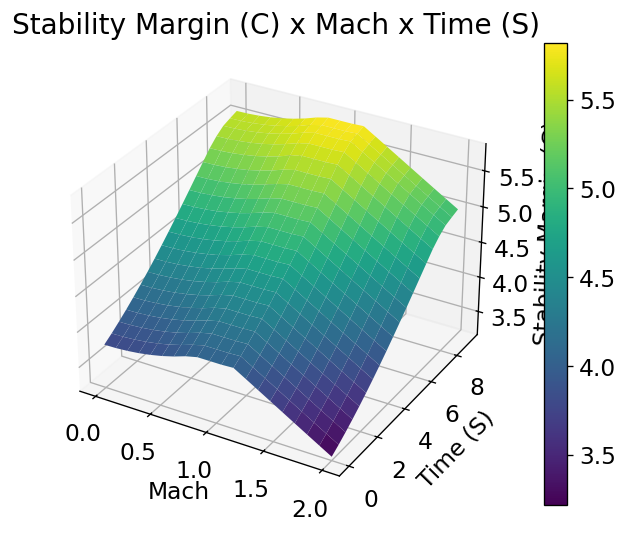


Thrust-to-Weight Plot
----------------------------------------


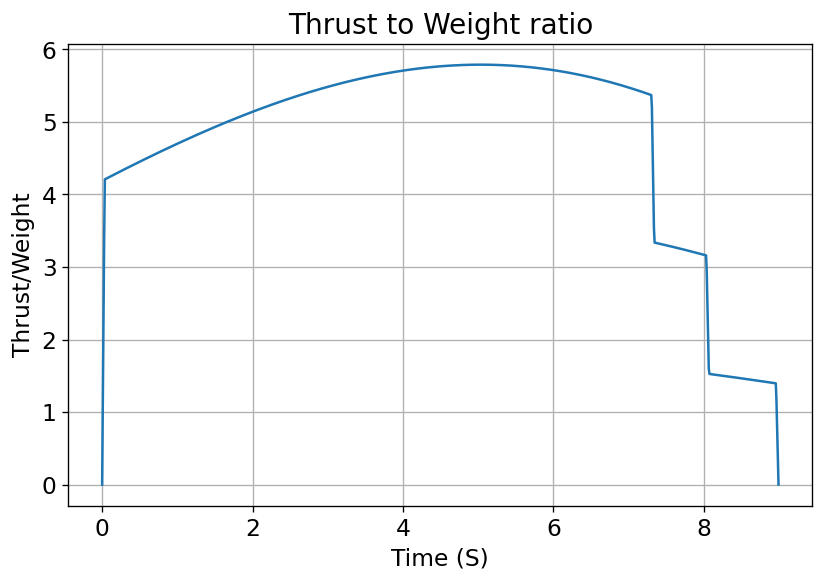

running flight

Initial Conditions

Initial time: 0.000 s
Position - x: 0.00 m | y: 0.00 m | z: 0.00 m
Velocity - Vx: 0.00 m/s | Vy: 0.00 m/s | Vz: 0.00 m/s
Attitude (quaternions) - e0: 0.704 | e1: 0.014 | e2: -0.015 | e3: -0.710
Euler Angles - Spin φ : -180.00° | Nutation θ: -2.34° | Precession ψ: 89.53°
Angular Velocity - ω1: 0.00 rad/s | ω2: 0.00 rad/s | ω3: 0.00 rad/s
Initial Stability Margin: 3.776 c


Surface Wind Conditions

Frontal Surface Wind Speed: -1.06 m/s
Lateral Surface Wind Speed: 1.71 m/s


Launch Rail

Launch Rail Length: 5.1816 m
Launch Rail Inclination: 92.34°
Launch Rail Heading: 90.47°


Rail Departure State

Rail Departure Time: 0.518 s
Rail Departure Velocity: 16.254 m/s
Rail Departure Stability Margin: 3.856 c
Rail Departure Angle of Attack: 7.073°
Rail Departure Thrust-Weight Ratio: 4.459
Rail Departure Reynolds Number: 1.698e+05


Burn out State

Burn out time: 8.994 s
Altitude at burn out: 1589.418 m (ASL) | 1589.418 m (AGL)
Rocket speed at burn out: 315.845

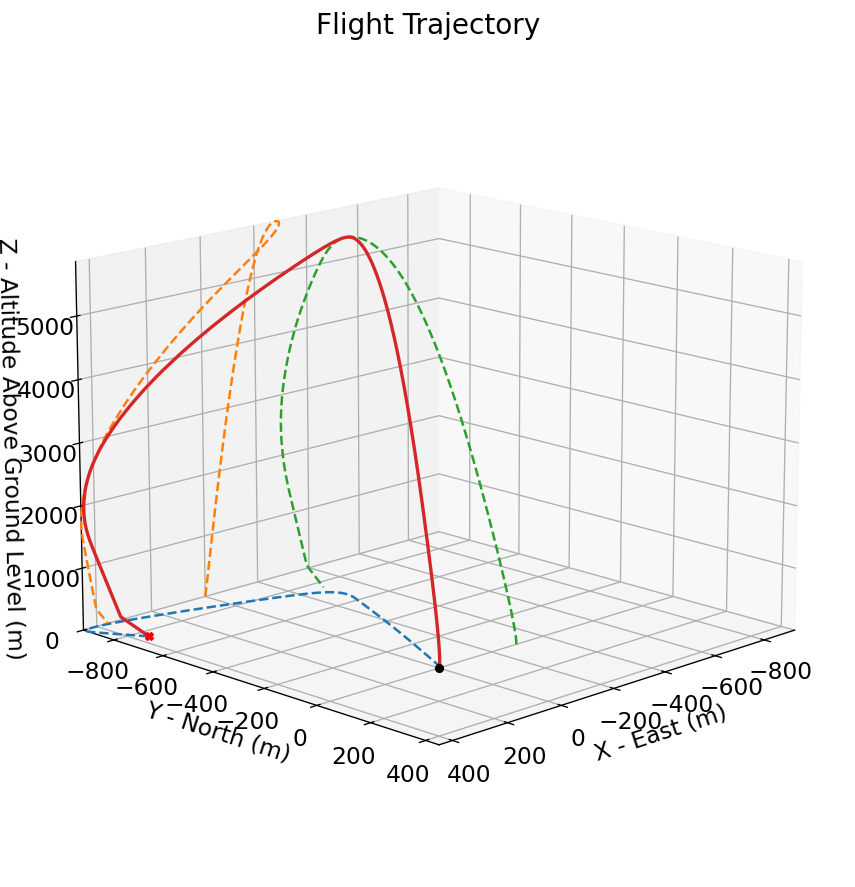



Trajectory Kinematic Plots



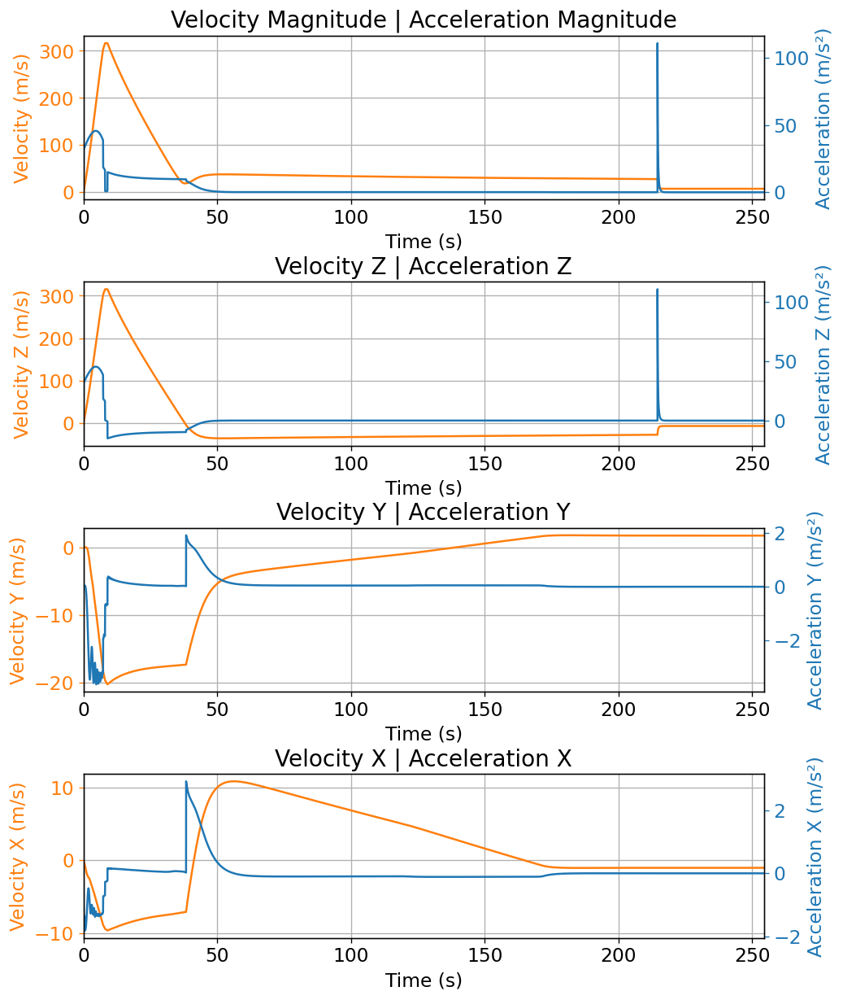



Angular Position Plots



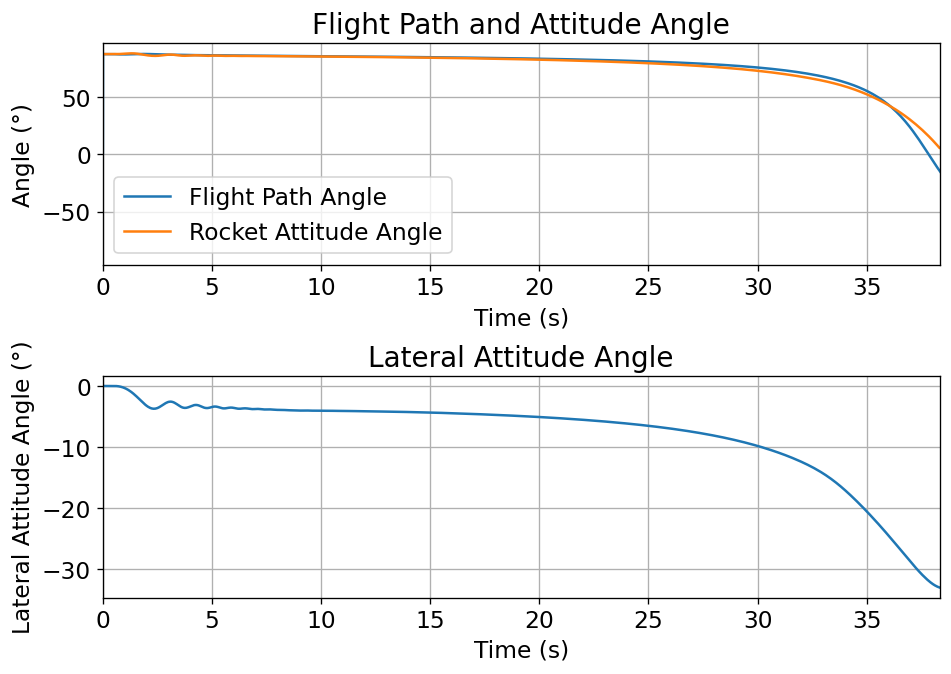



Path, Attitude and Lateral Attitude Angle plots



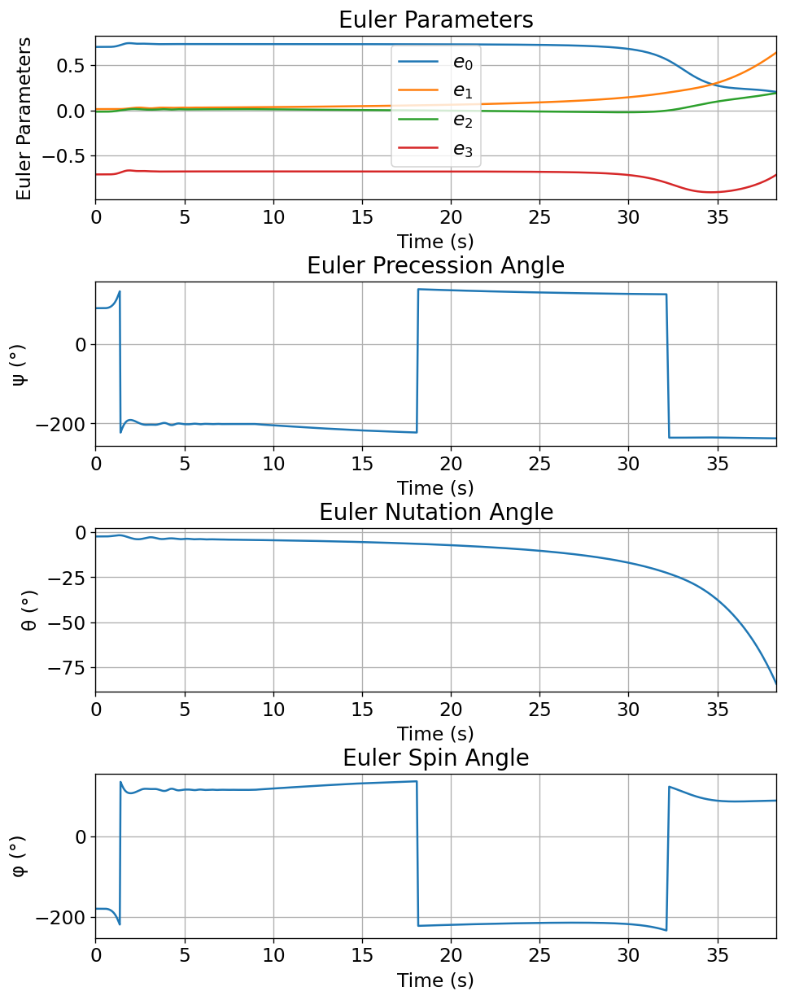



Trajectory Angular Velocity and Acceleration Plots



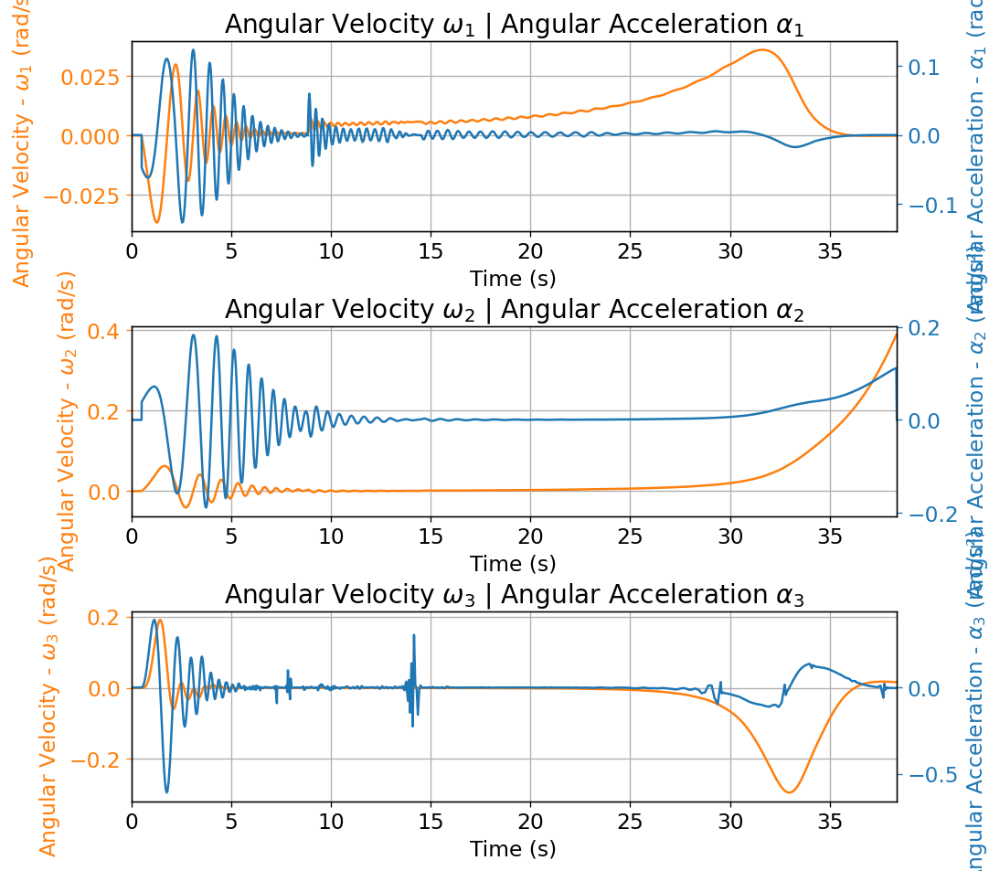



Aerodynamic Forces Plots



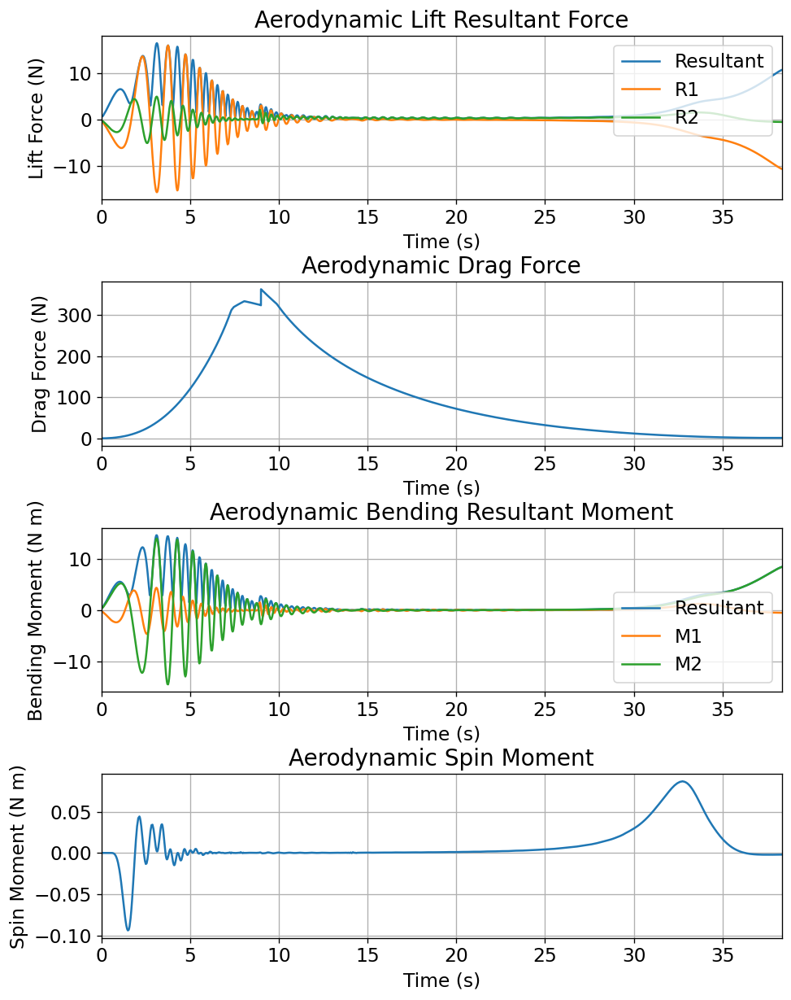



Rail Buttons Forces Plots



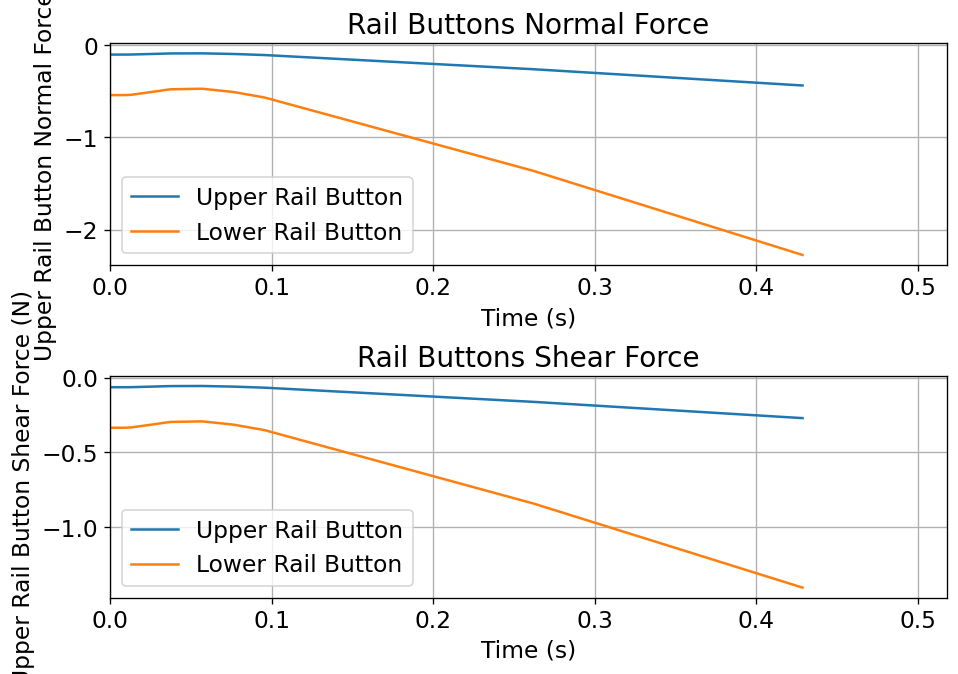



Trajectory Energy Plots



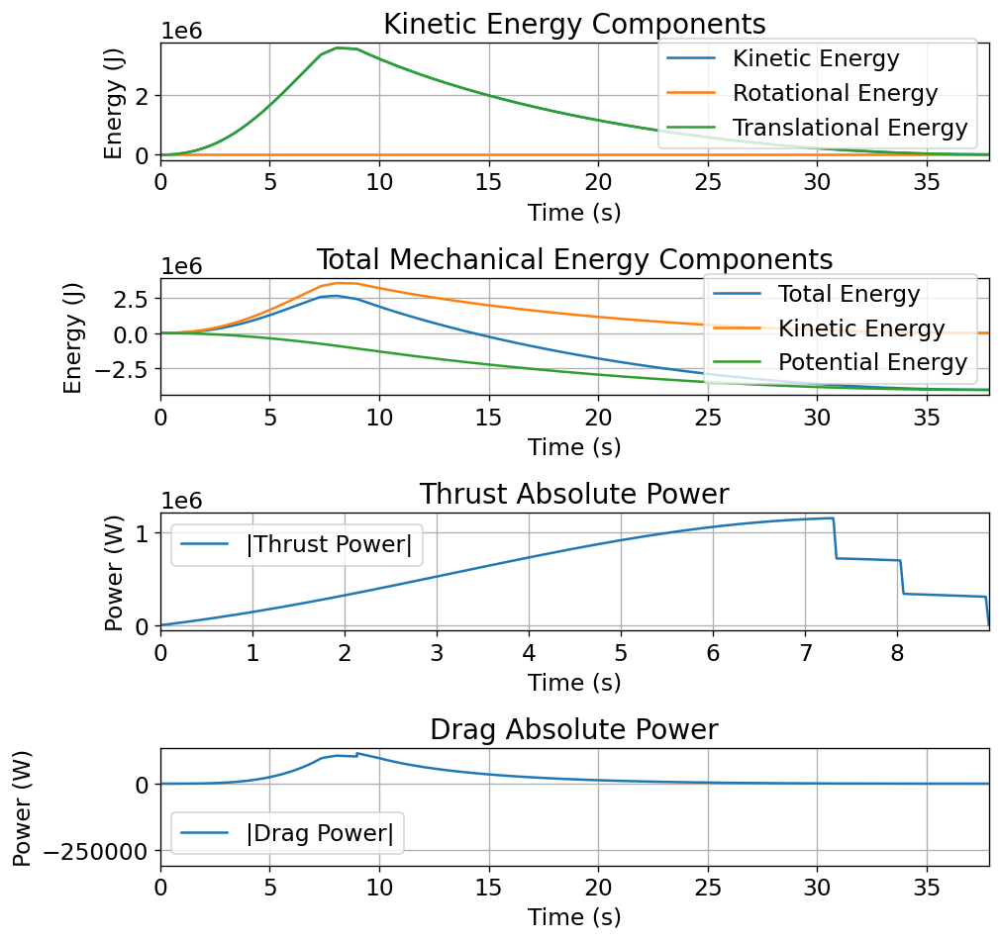



Trajectory Fluid Mechanics Plots



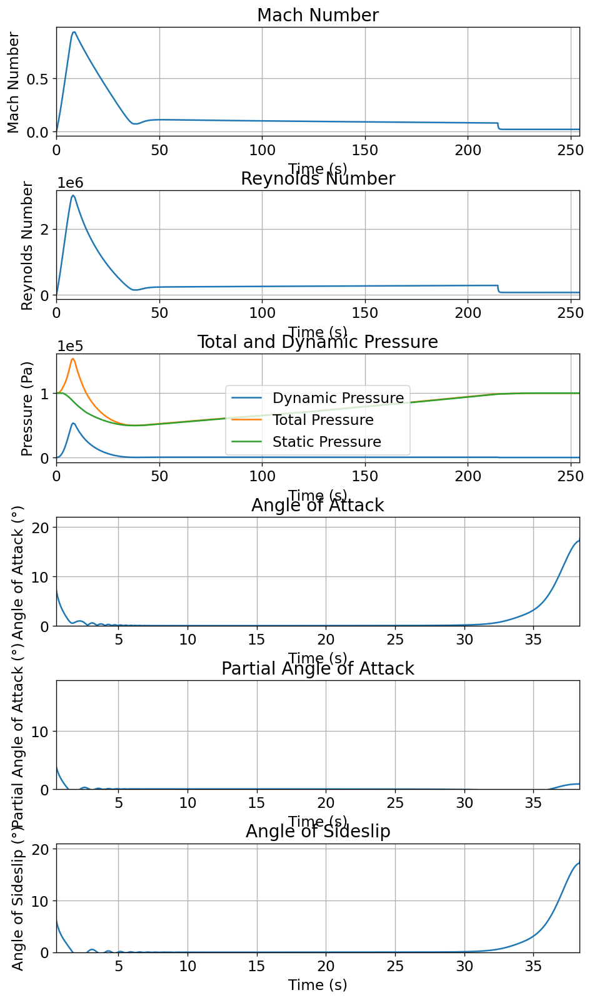



Trajectory Stability and Control Plots



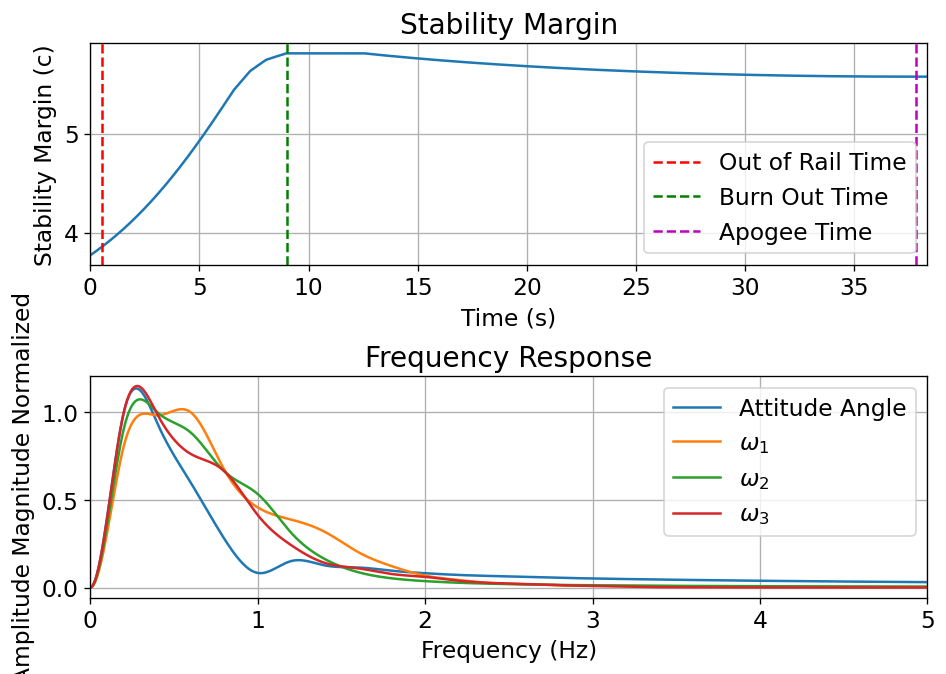



Rocket and Parachute Pressure Plots



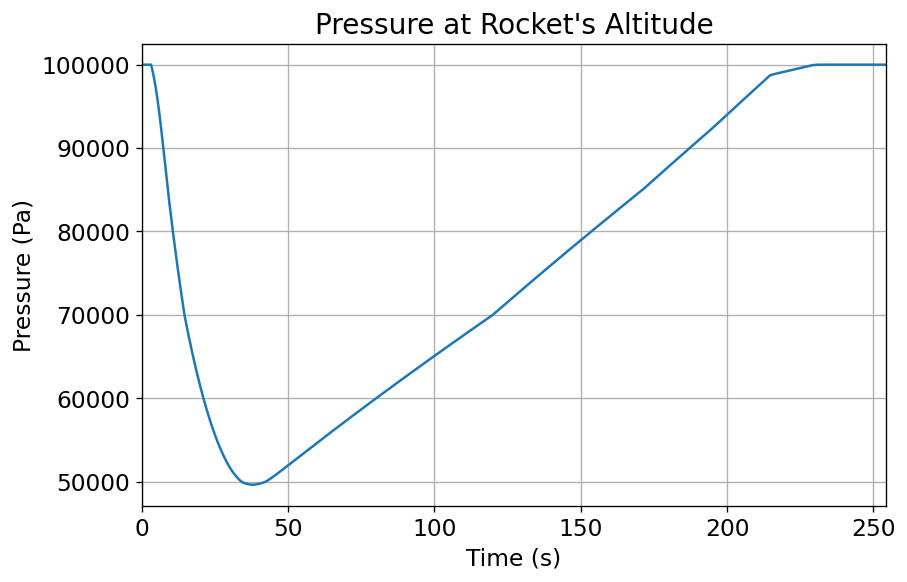


Parachute:  Drogue


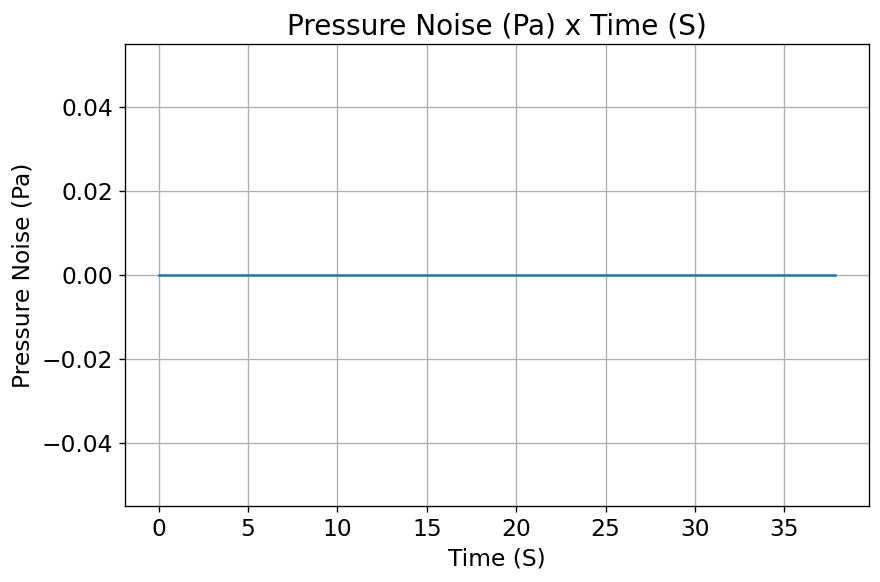

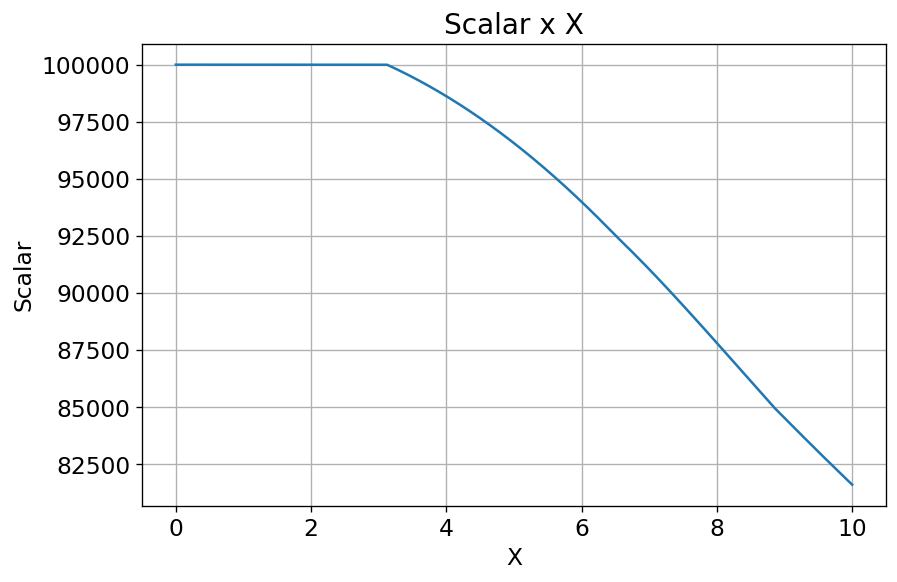

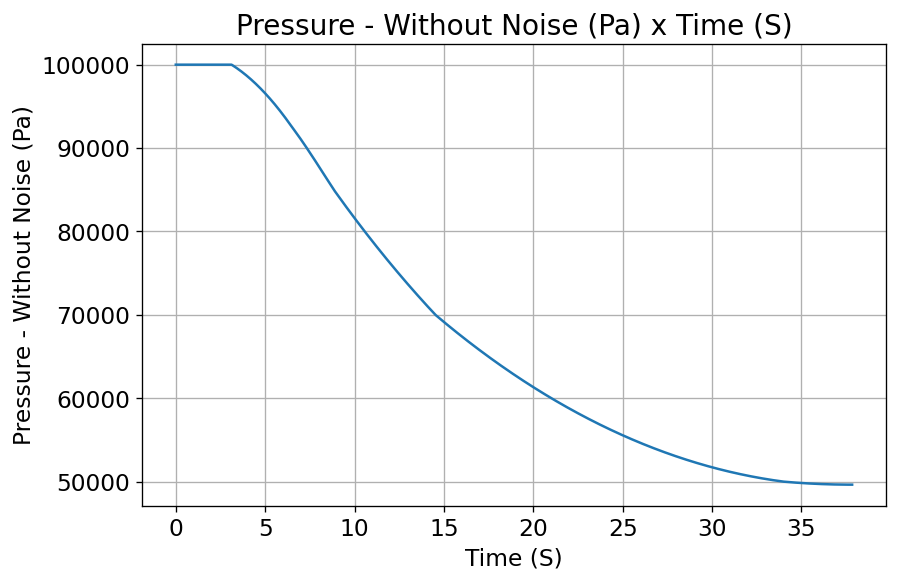


Parachute:  Main


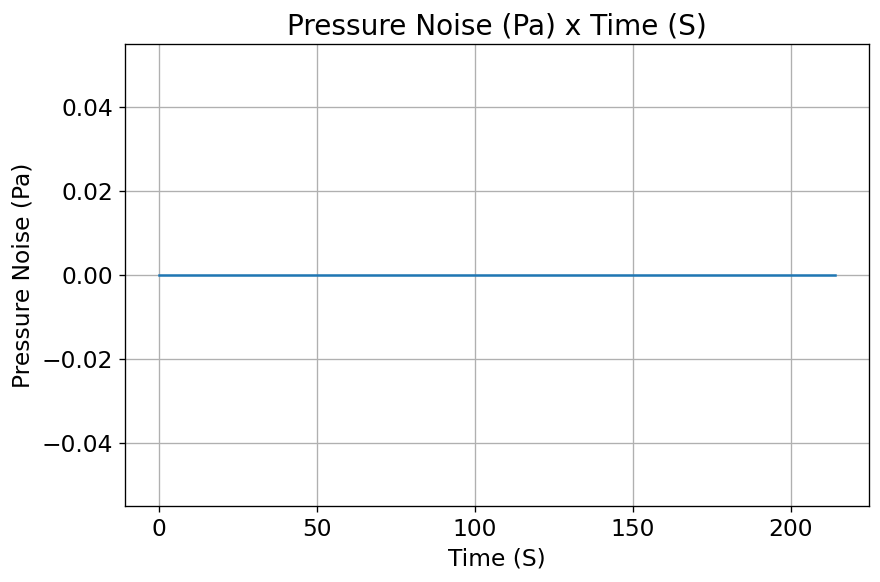

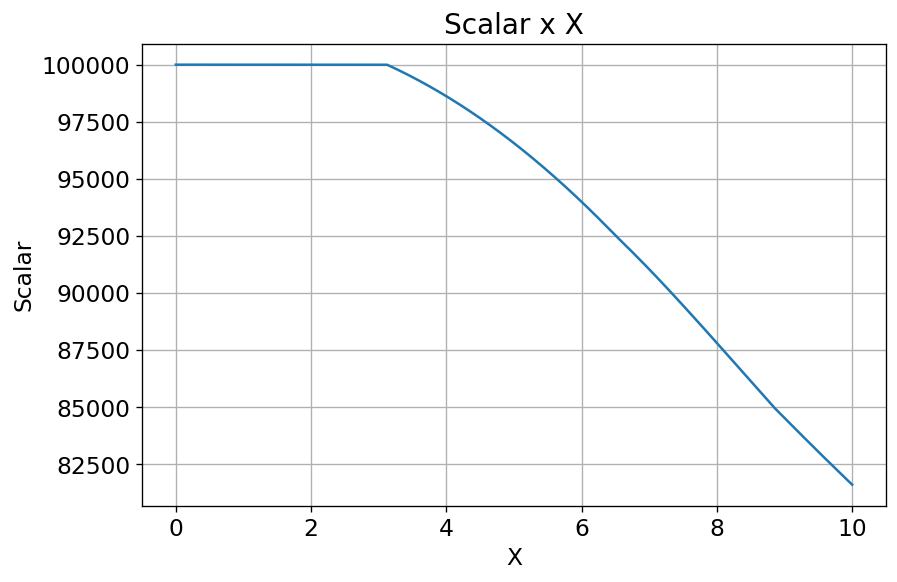

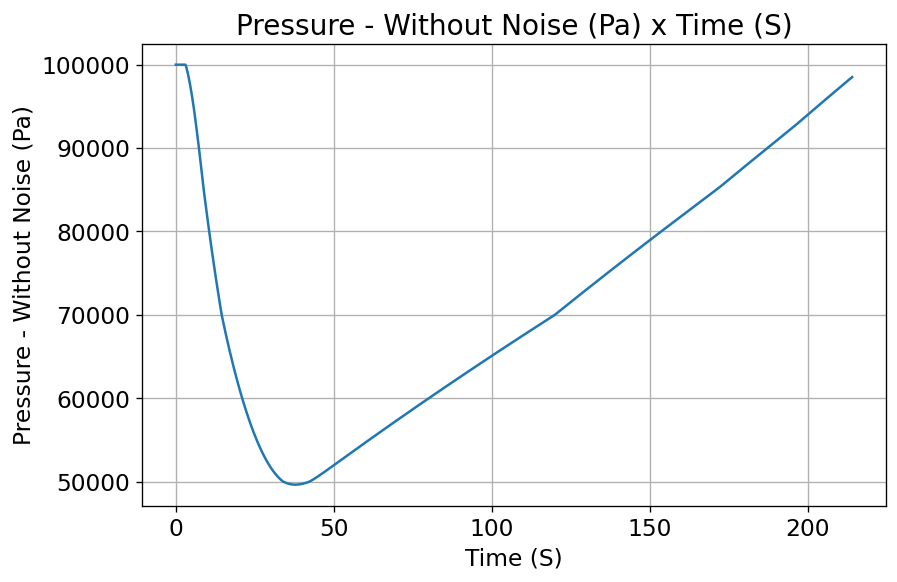

['FlightPhases', 'M1', 'M2', 'M3', 'R1', 'R2', 'R3', 'TimeNodes', '_Flight__cache_sensor_data', '_Flight__calculate_and_save_pressure_signals', '_Flight__calculate_rail_button_forces', '_Flight__evaluate_post_process', '_Flight__init_controllers', '_Flight__init_equations_of_motion', '_Flight__init_flight_state', '_Flight__init_solution_monitors', '_Flight__init_solver_monitors', '_Flight__is_lsoda', '_Flight__post_processed_variables', '_Flight__set_ode_solver', '_Flight__simulate', '_Flight__transform_pressure_signals_lists_to_functions', '__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_controllers', '_solver', 'acceleration', 'aerodynamic_bending_moment', 'aerodynamic_drag', 

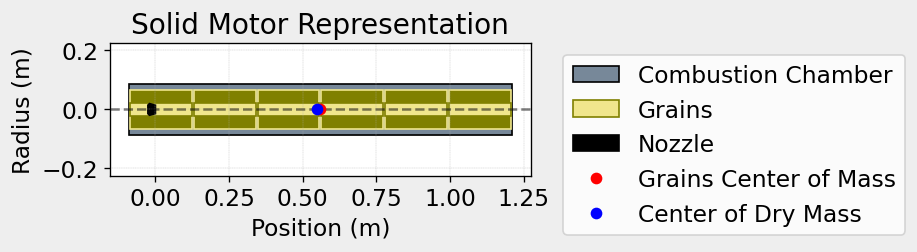

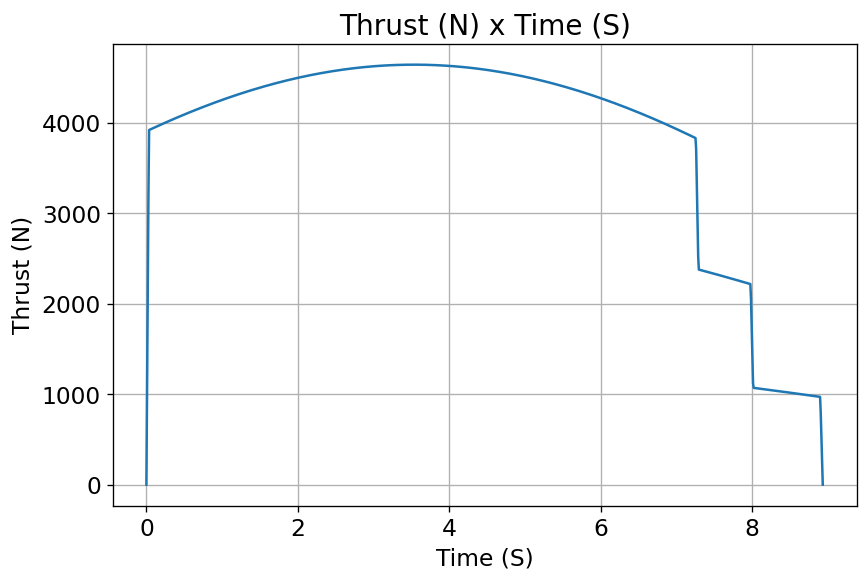

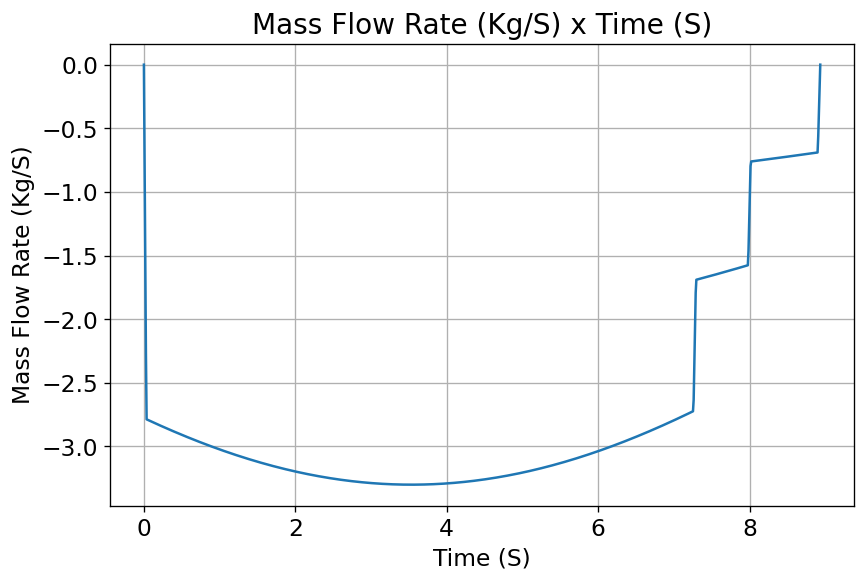

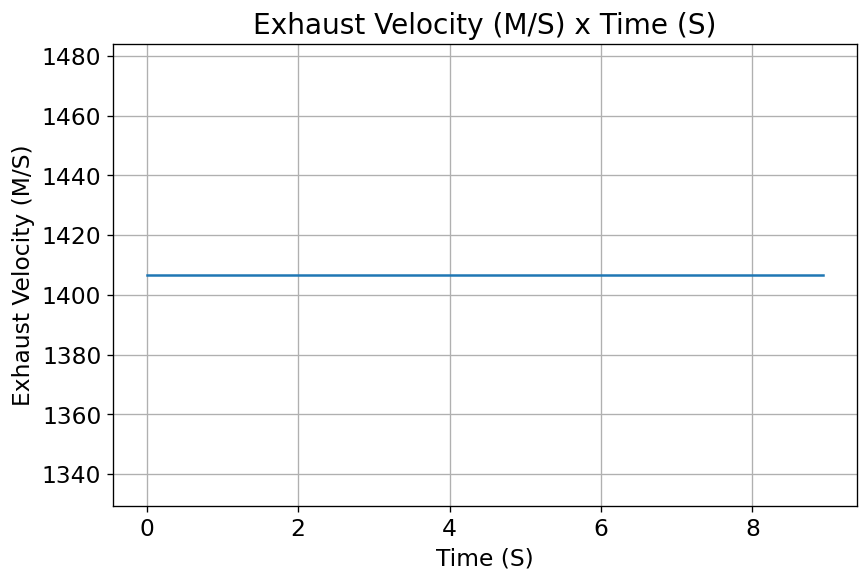

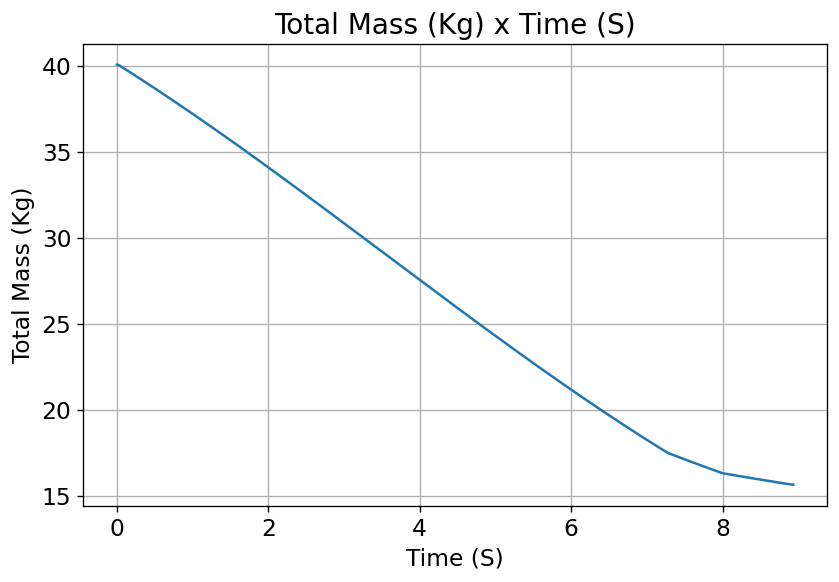

...

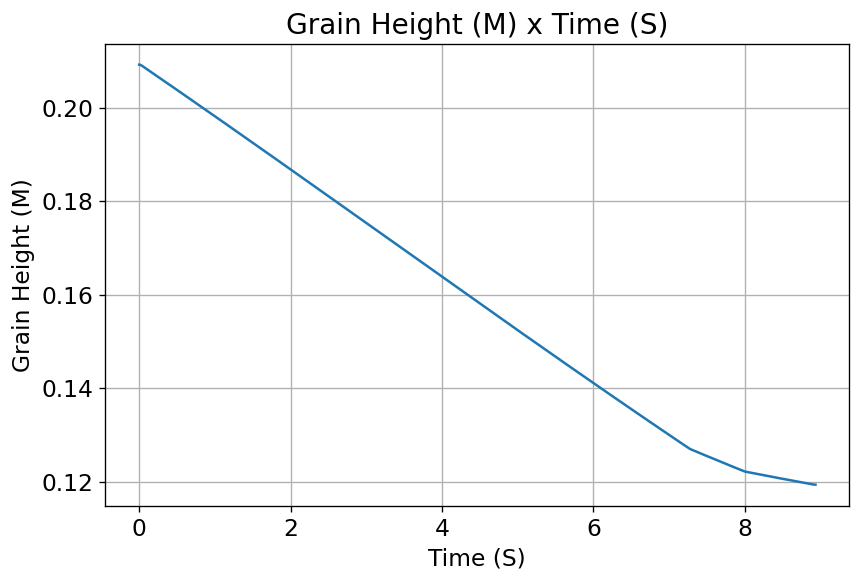

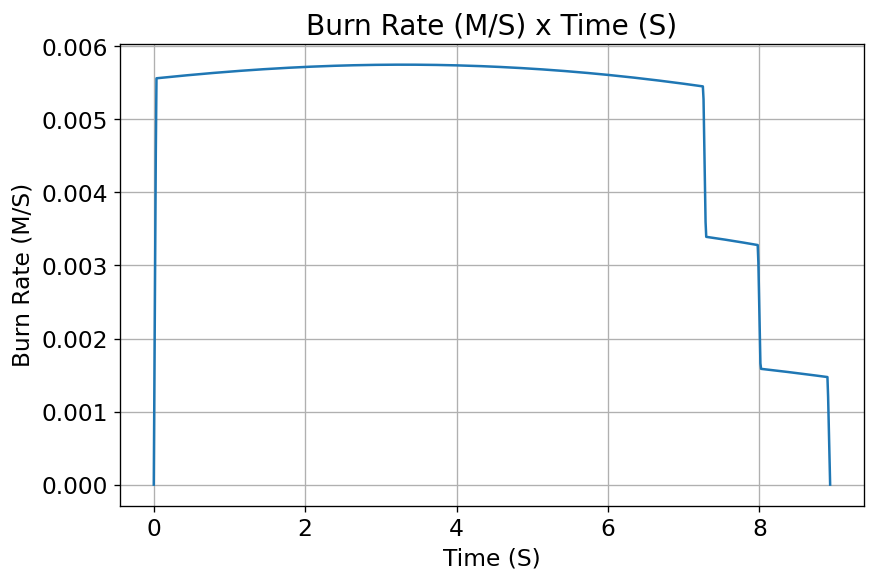

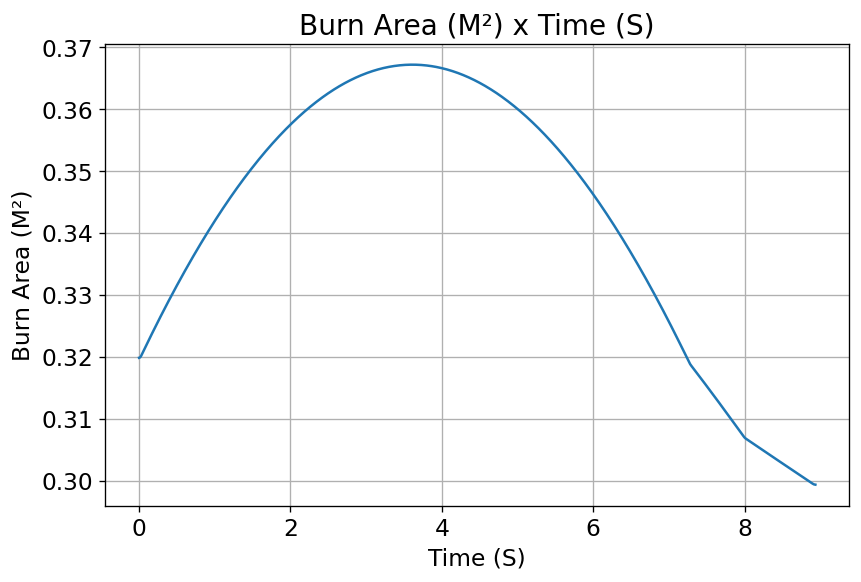

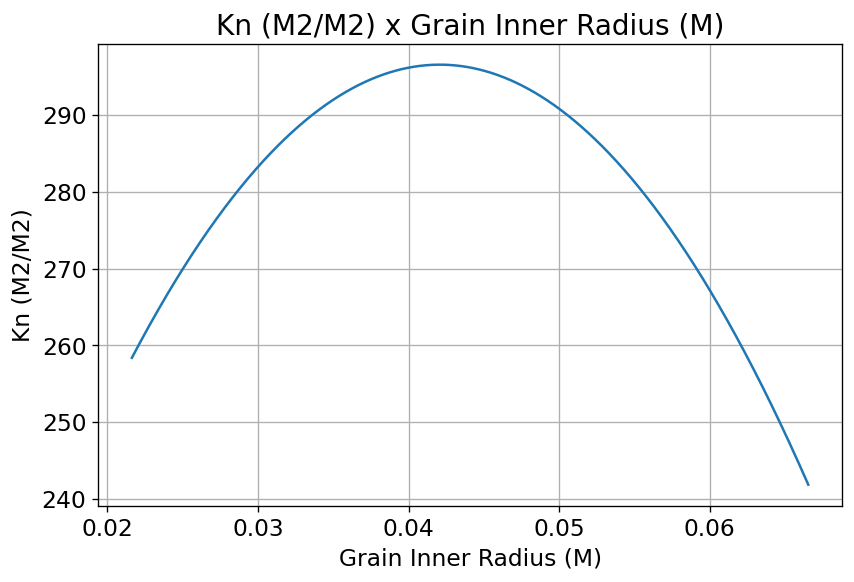

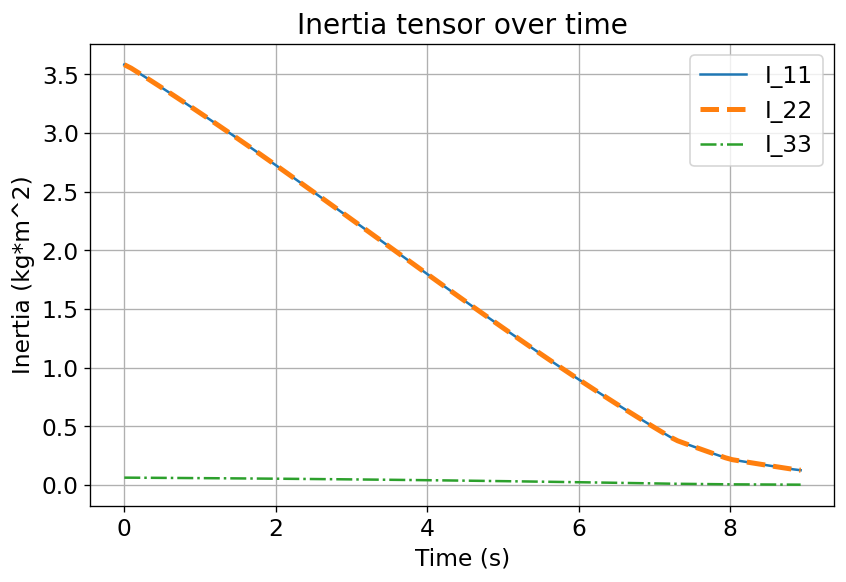

rocketCreated!!!

Inertia Details

Rocket Mass: 54.909 kg (without motor)
Rocket Dry Mass: 70.549 kg (with unloaded motor)
Rocket Loaded Mass: 94.982 kg
Rocket Structural Mass Ratio: 0.743
Rocket Inertia (with unloaded motor) 11: 26.043 kg*m2
Rocket Inertia (with unloaded motor) 22: 75.803 kg*m2
Rocket Inertia (with unloaded motor) 33: 0.002 kg*m2
Rocket Inertia (with unloaded motor) 12: 0.000 kg*m2
Rocket Inertia (with unloaded motor) 13: 0.000 kg*m2
Rocket Inertia (with unloaded motor) 23: 0.000 kg*m2

Geometrical Parameters

Rocket Maximum Radius: 0.0779013609749202 m
Rocket Frontal Area: 0.019065 m2

Rocket Distances
Rocket Center of Dry Mass - Center of Mass without Motor: 0.322 m
Rocket Center of Dry Mass - Nozzle Exit: 1.680 m
Rocket Center of Dry Mass - Center of Propellant Mass: 1.120 m
Rocket Center of Mass - Rocket Loaded Center of Mass: 0.288 m


Aerodynamics Lift Coefficient Derivatives

Nose Cone Lift Coefficient Derivative: 2.000/rad
Fins Lift Coefficient Derivative: 8.3

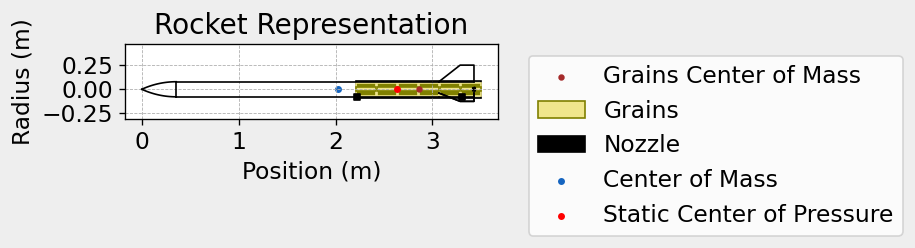


Mass Plots
----------------------------------------


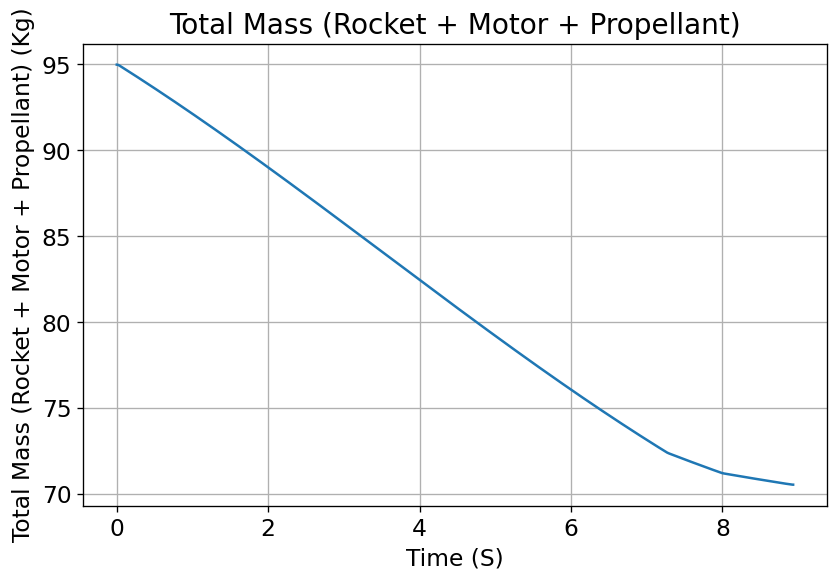

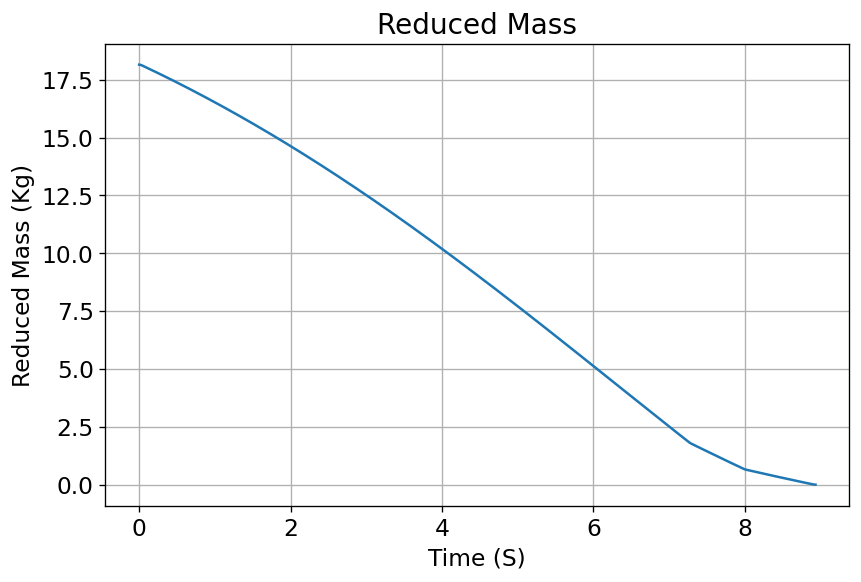


Aerodynamics Plots
----------------------------------------
Drag Plots
--------------------


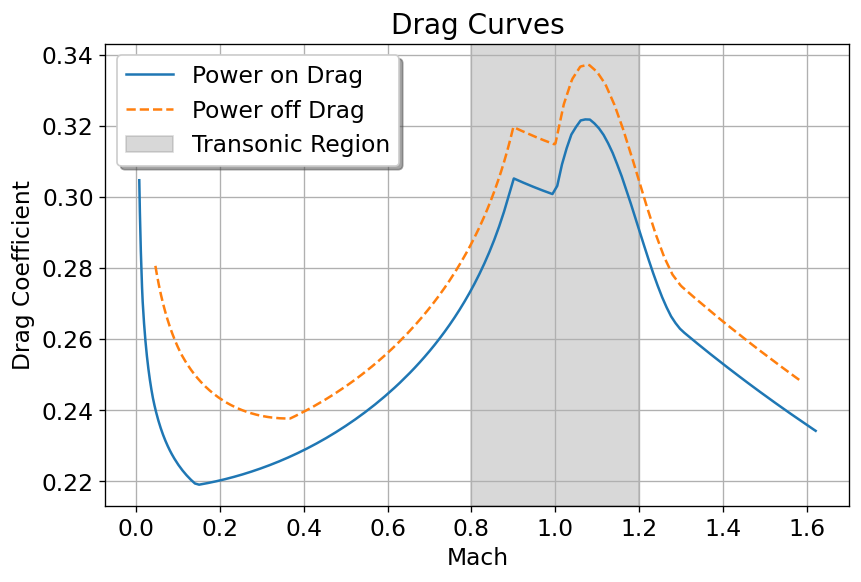


Stability Plots
--------------------


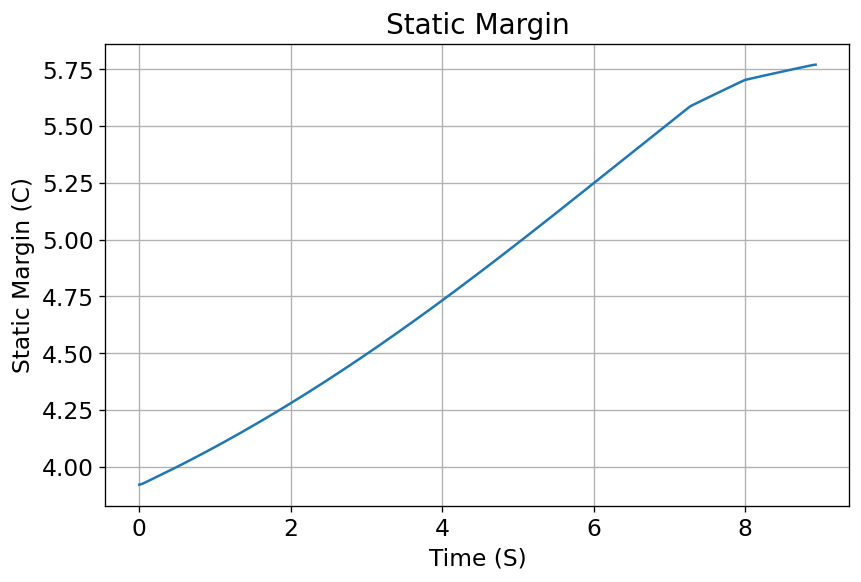

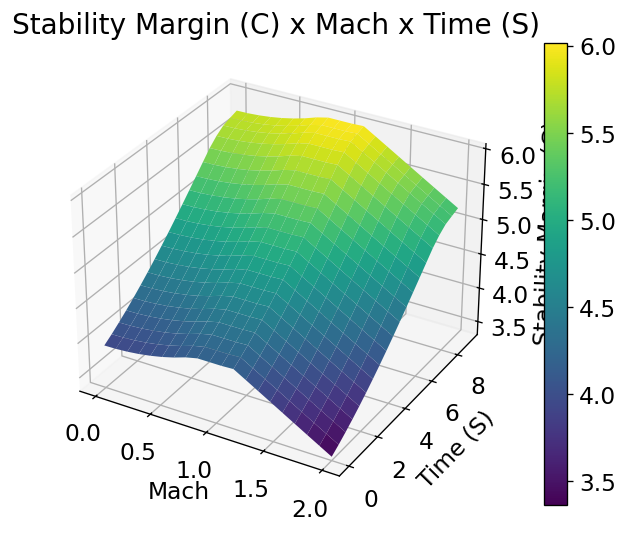


Thrust-to-Weight Plot
----------------------------------------


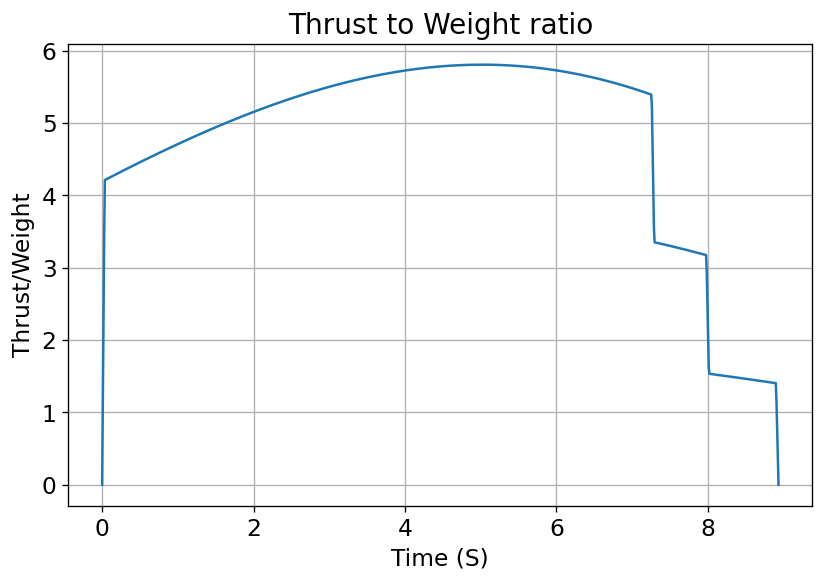

running flight

Initial Conditions

Initial time: 0.000 s
Position - x: 0.00 m | y: 0.00 m | z: 0.00 m
Velocity - Vx: 0.00 m/s | Vy: 0.00 m/s | Vz: 0.00 m/s
Attitude (quaternions) - e0: 0.703 | e1: 0.002 | e2: -0.002 | e3: -0.711
Euler Angles - Spin φ : -180.00° | Nutation θ: -0.38° | Precession ψ: 89.34°
Angular Velocity - ω1: 0.00 rad/s | ω2: 0.00 rad/s | ω3: 0.00 rad/s
Initial Stability Margin: 3.921 c


Surface Wind Conditions

Frontal Surface Wind Speed: -1.07 m/s
Lateral Surface Wind Speed: 1.71 m/s


Launch Rail

Launch Rail Length: 5.1816 m
Launch Rail Inclination: 90.38°
Launch Rail Heading: 90.66°


Rail Departure State

Rail Departure Time: 0.518 s
Rail Departure Velocity: 16.267 m/s
Rail Departure Stability Margin: 4.003 c
Rail Departure Angle of Attack: 7.054°
Rail Departure Thrust-Weight Ratio: 4.466
Rail Departure Reynolds Number: 1.674e+05


Burn out State

Burn out time: 8.934 s
Altitude at burn out: 1575.508 m (ASL) | 1575.508 m (AGL)
Rocket speed at burn out: 316.126

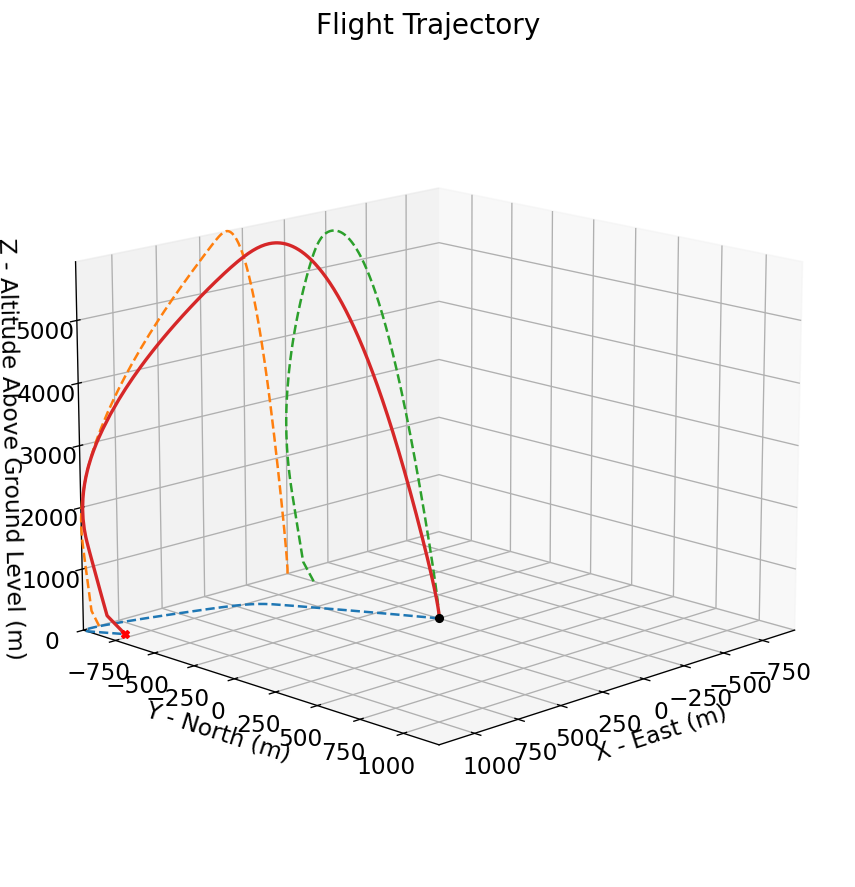



Trajectory Kinematic Plots



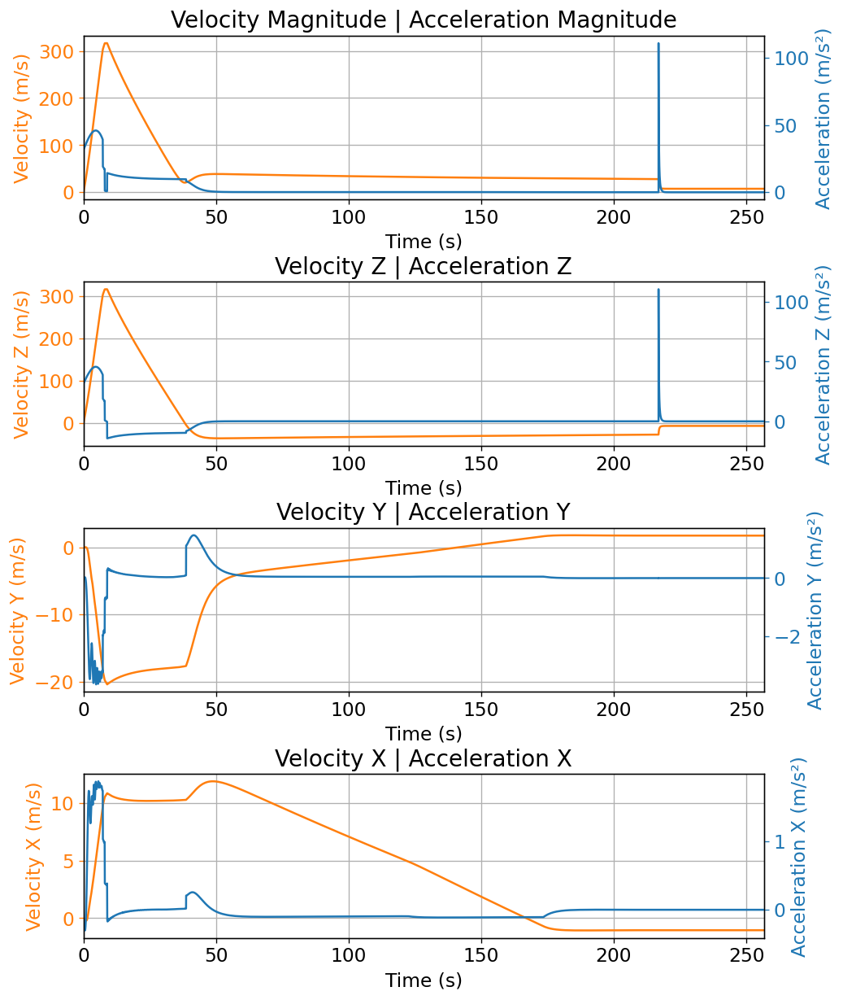



Angular Position Plots



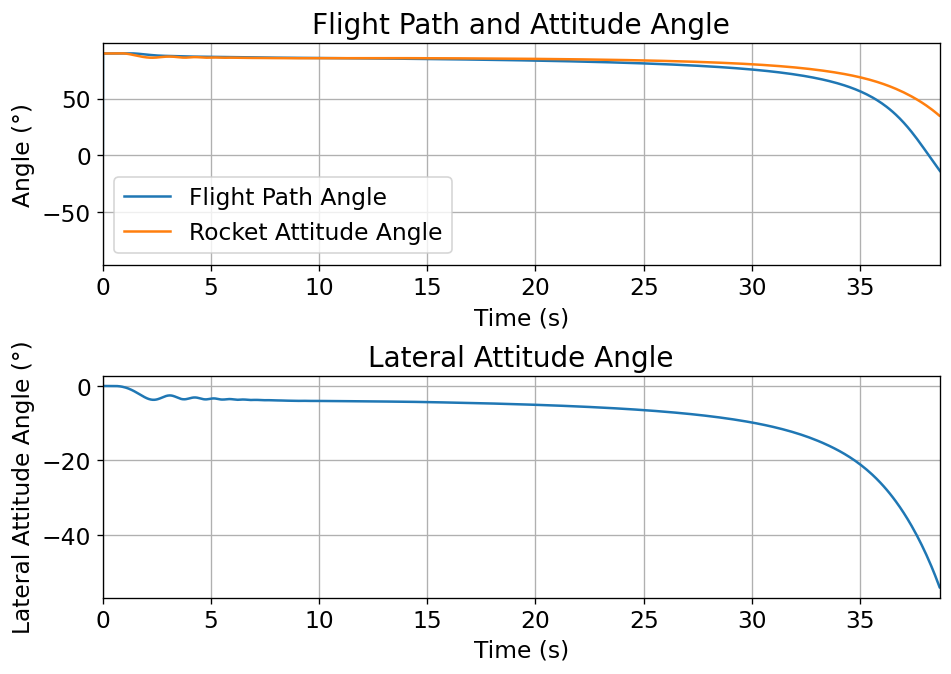



Path, Attitude and Lateral Attitude Angle plots



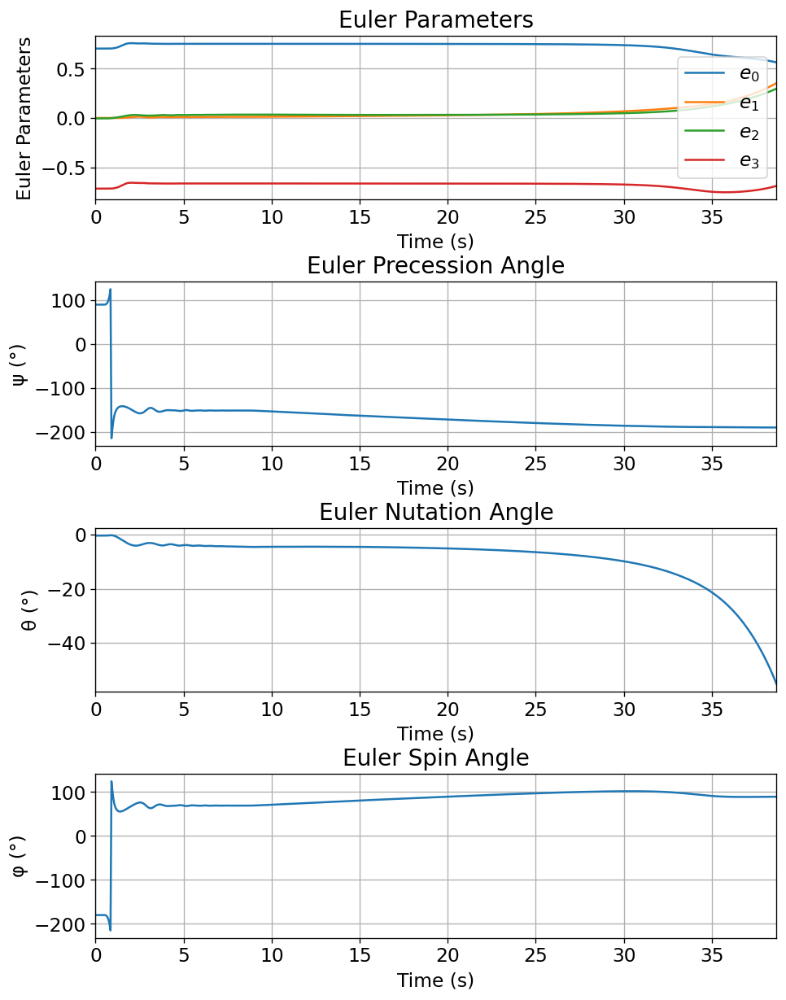



Trajectory Angular Velocity and Acceleration Plots



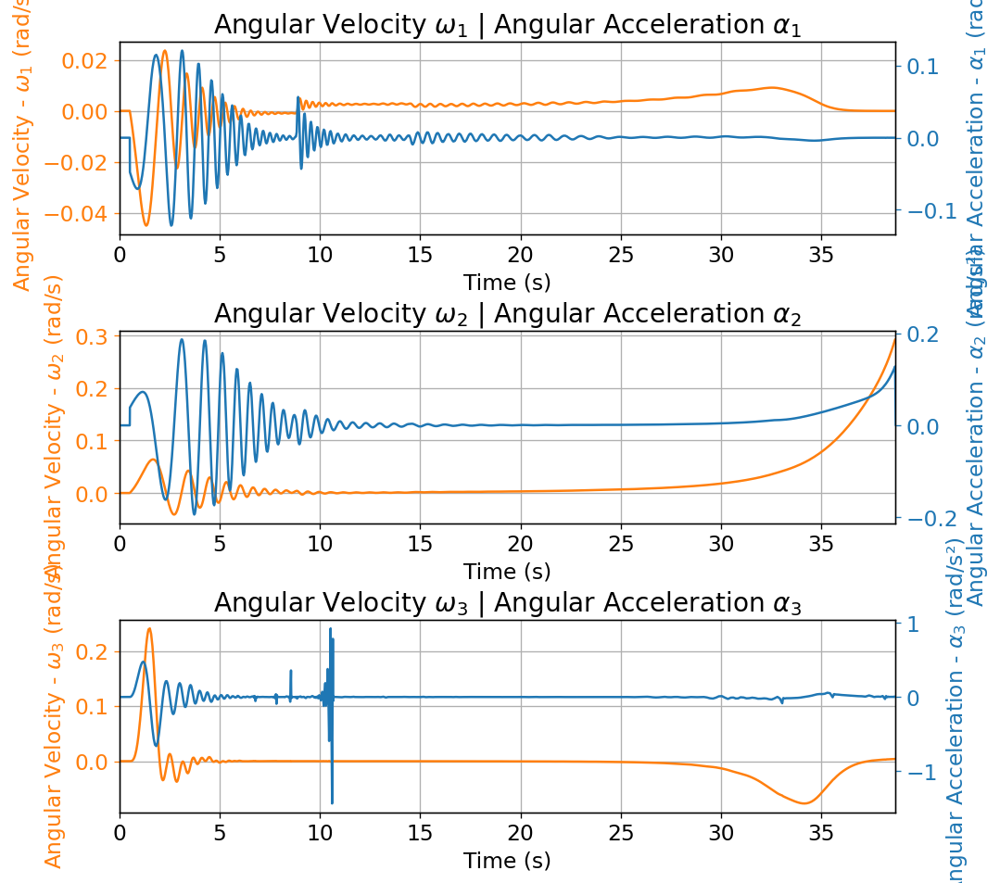



Aerodynamic Forces Plots



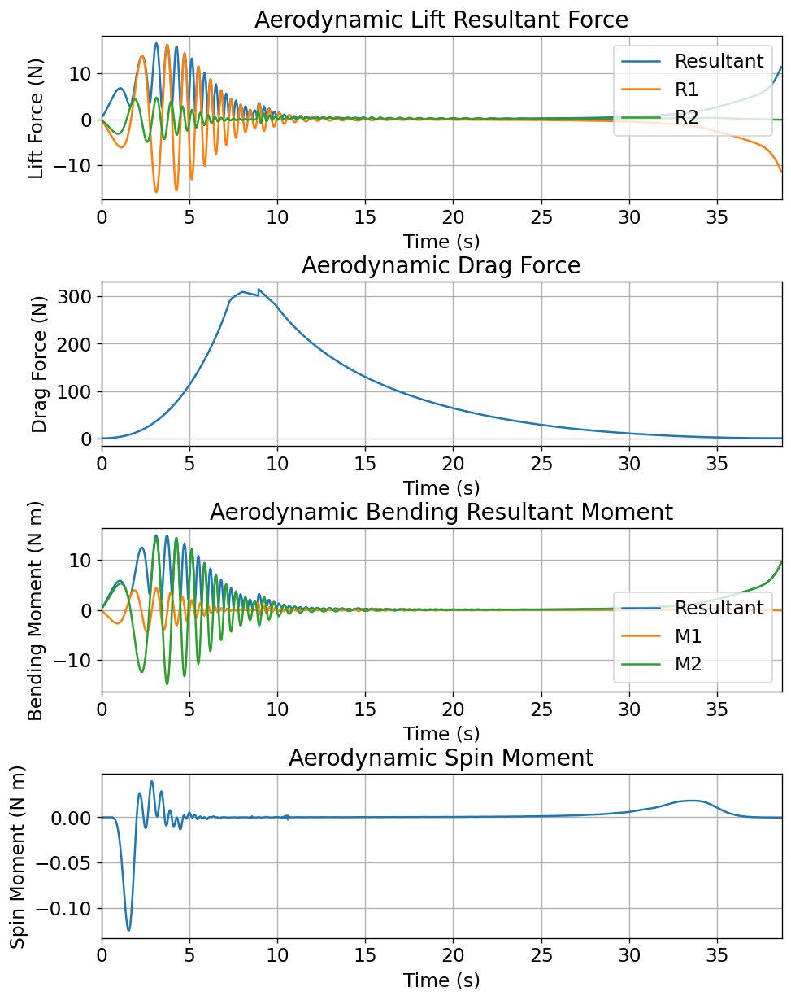



Rail Buttons Forces Plots



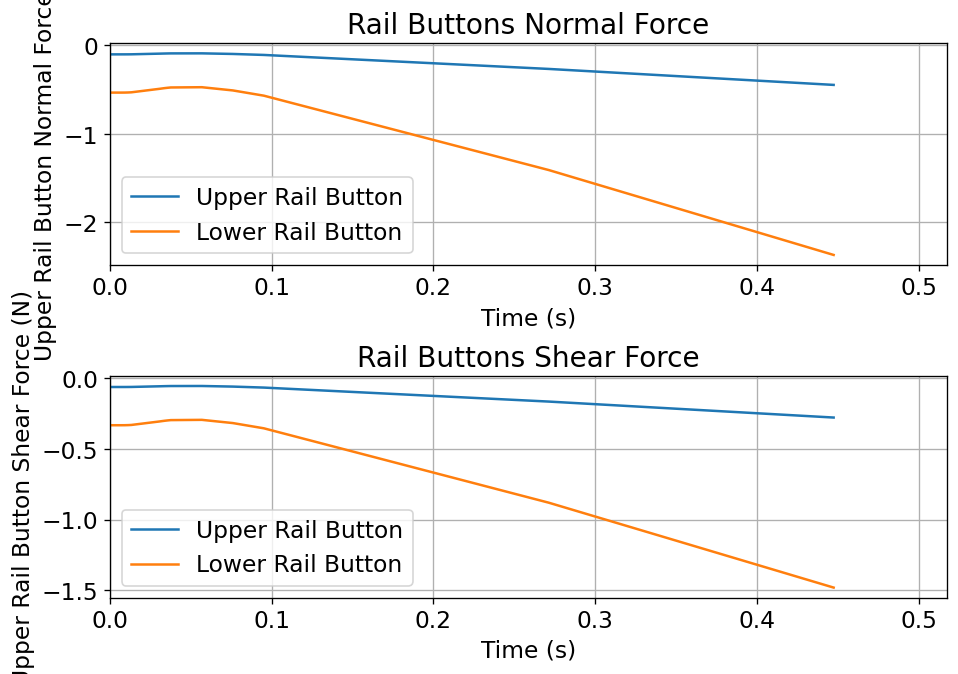



Trajectory Energy Plots



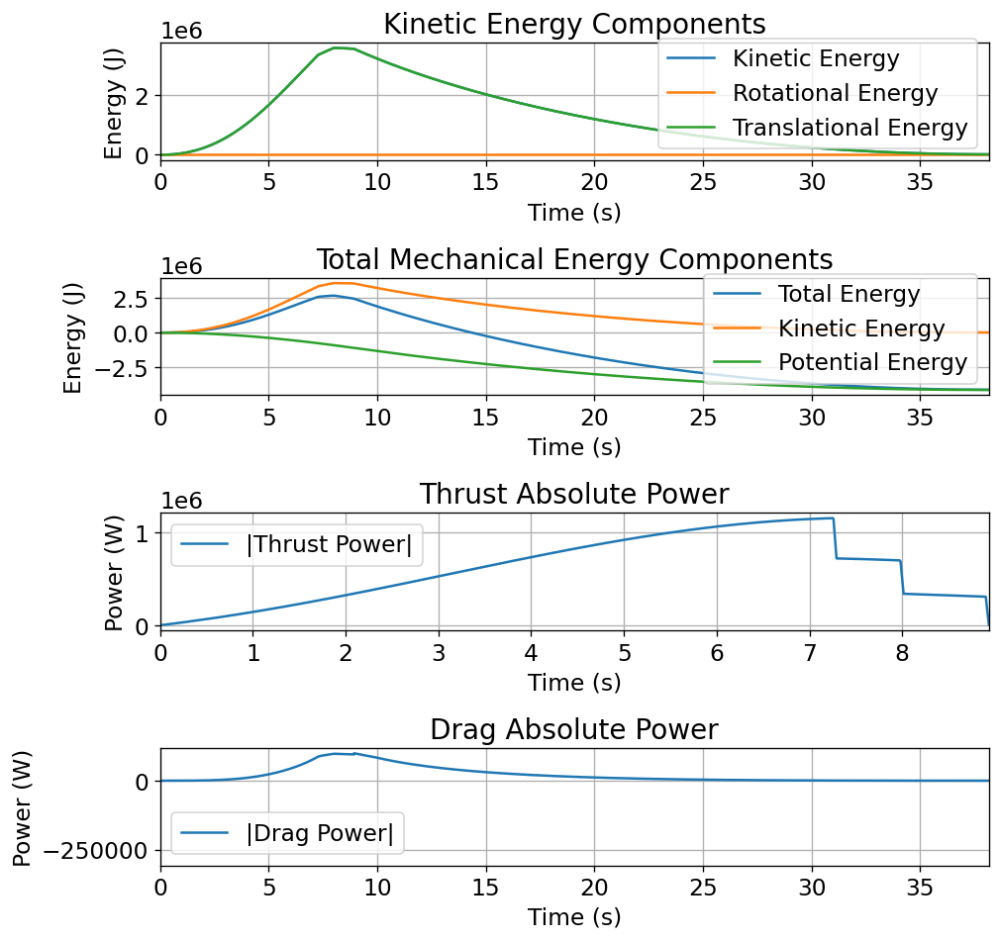



Trajectory Fluid Mechanics Plots



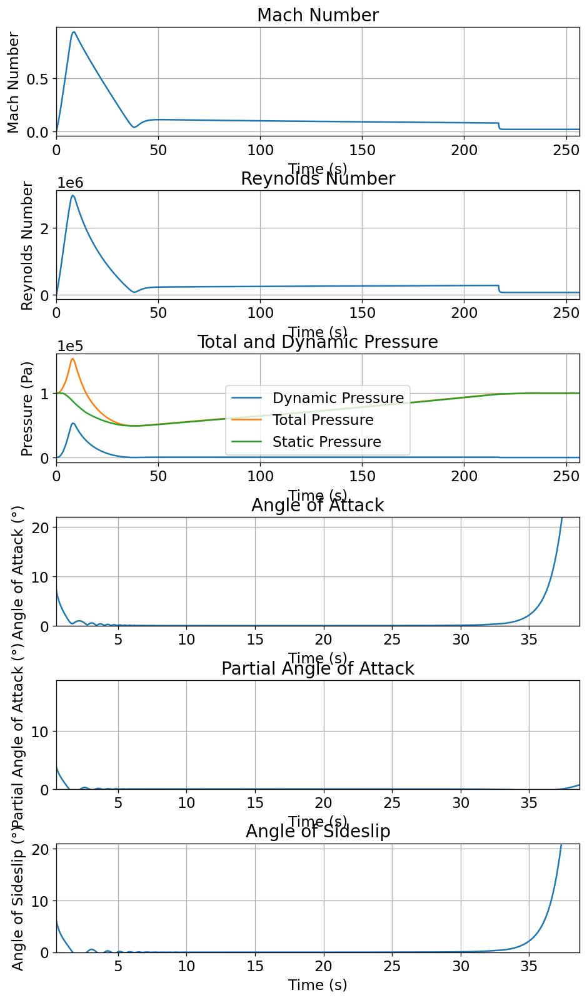



Trajectory Stability and Control Plots



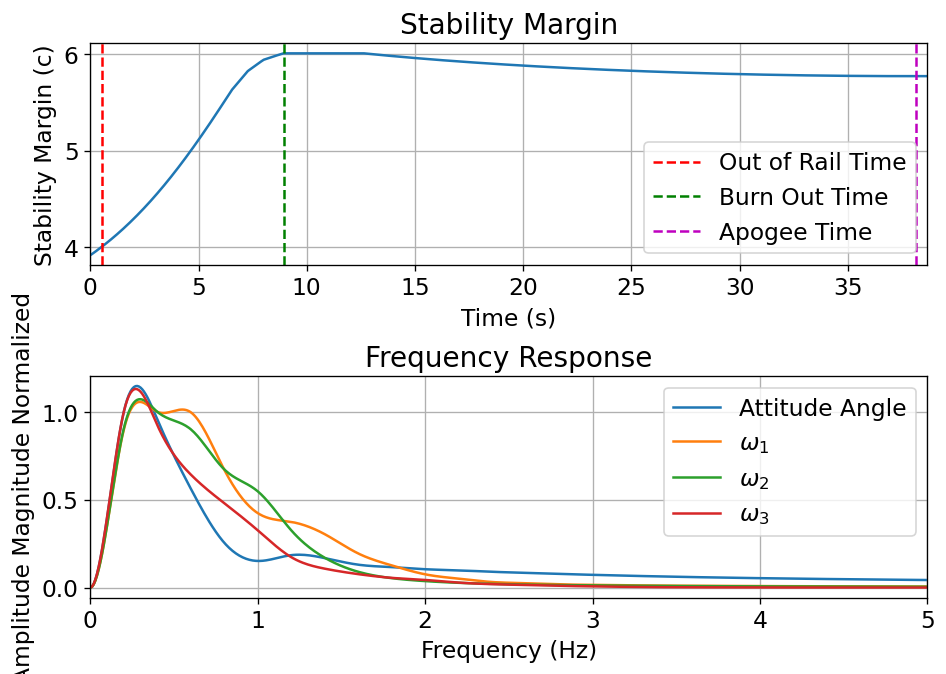



Rocket and Parachute Pressure Plots



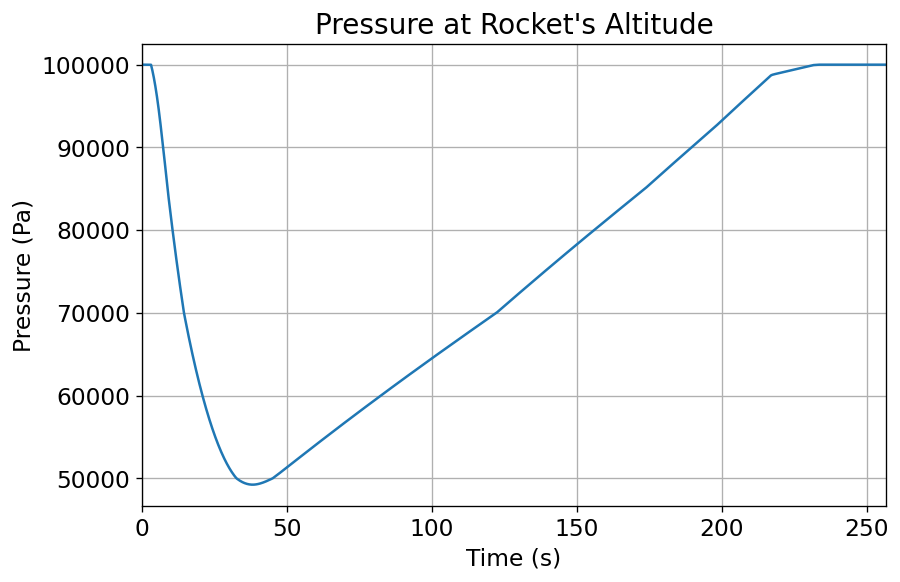


Parachute:  Drogue


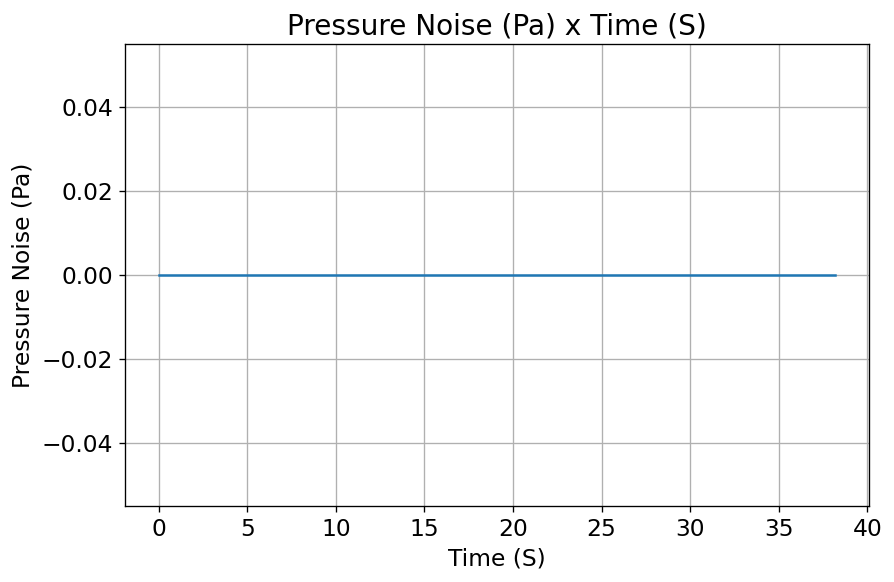

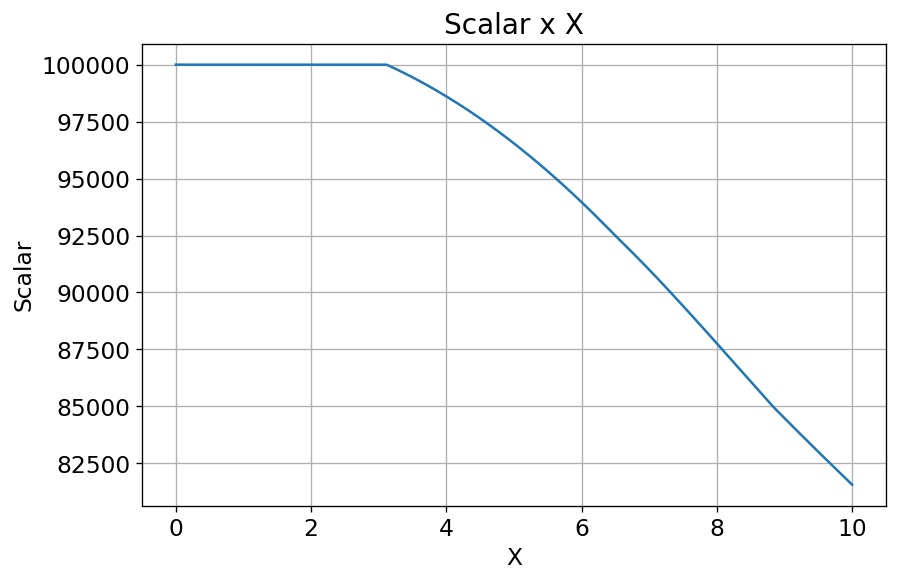

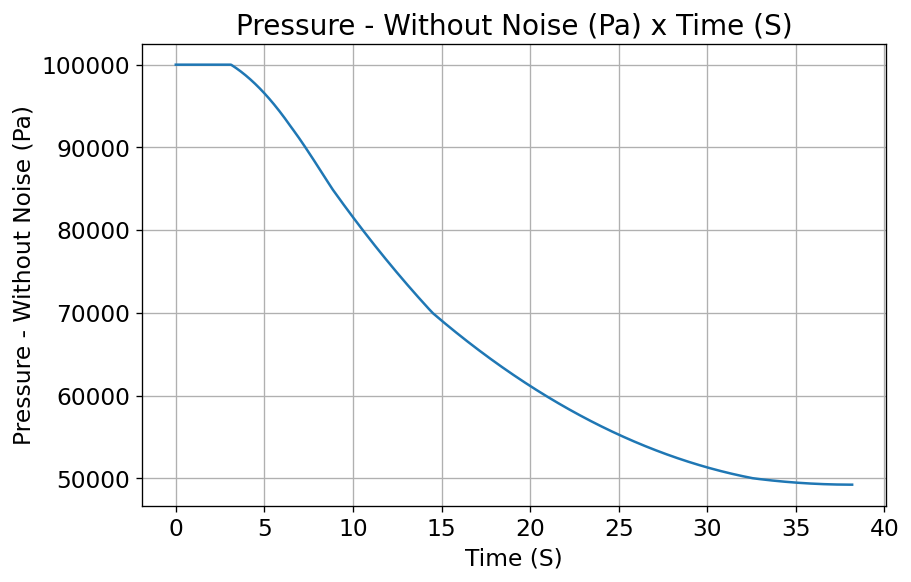


Parachute:  Main


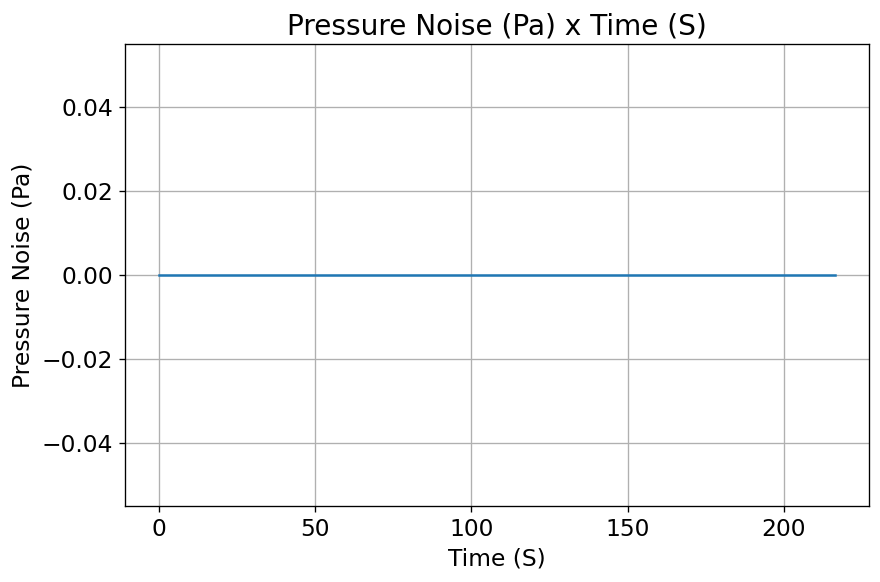

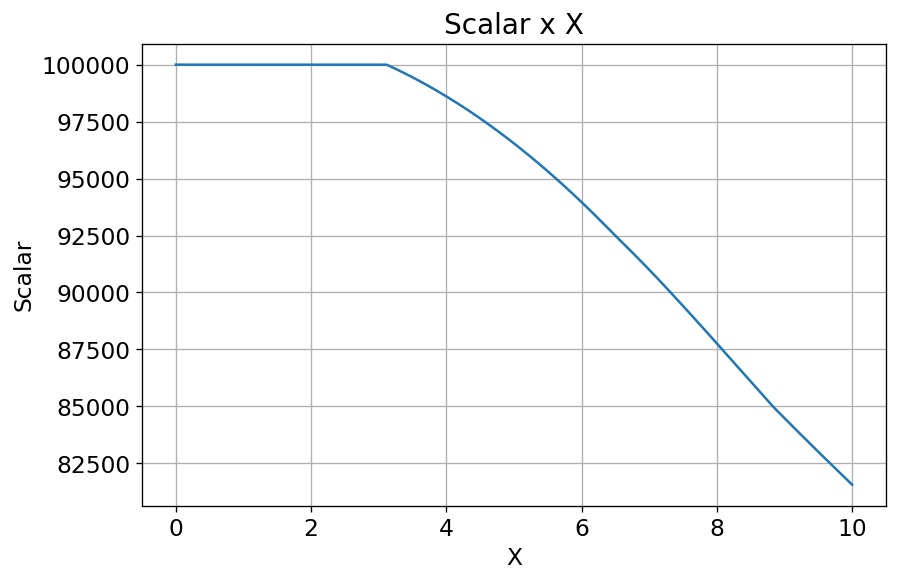

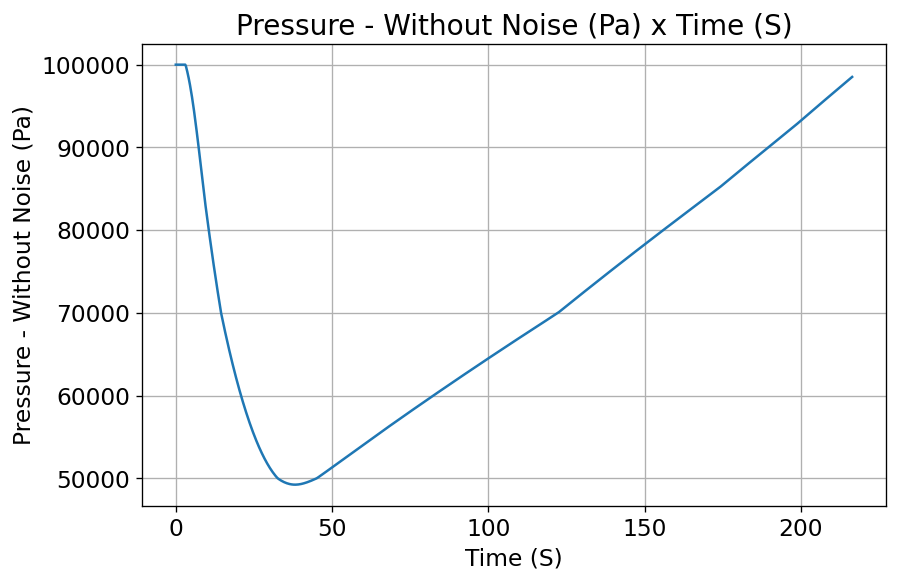

['FlightPhases', 'M1', 'M2', 'M3', 'R1', 'R2', 'R3', 'TimeNodes', '_Flight__cache_sensor_data', '_Flight__calculate_and_save_pressure_signals', '_Flight__calculate_rail_button_forces', '_Flight__evaluate_post_process', '_Flight__init_controllers', '_Flight__init_equations_of_motion', '_Flight__init_flight_state', '_Flight__init_solution_monitors', '_Flight__init_solver_monitors', '_Flight__is_lsoda', '_Flight__post_processed_variables', '_Flight__set_ode_solver', '_Flight__simulate', '_Flight__transform_pressure_signals_lists_to_functions', '__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_controllers', '_solver', 'acceleration', 'aerodynamic_bending_moment', 'aerodynamic_drag', 

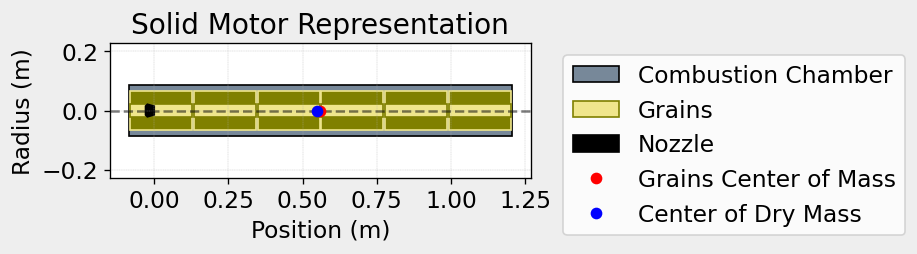

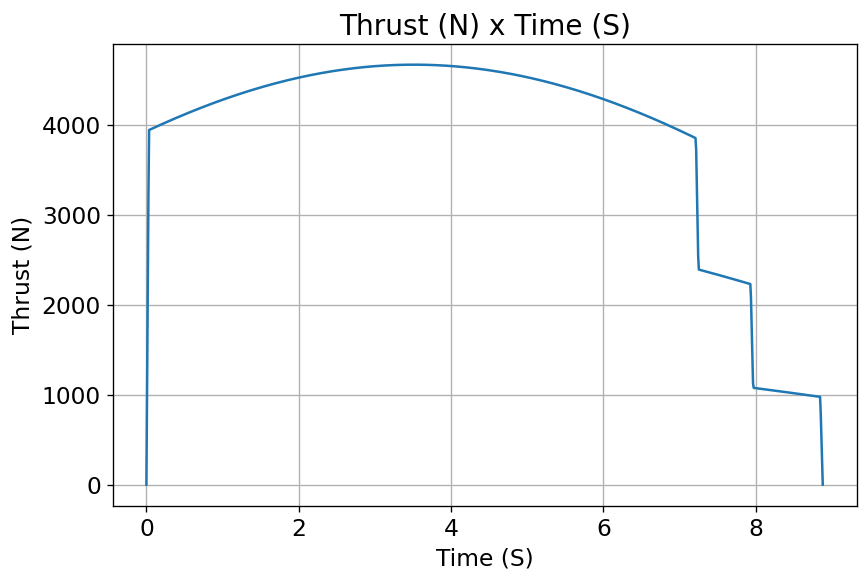

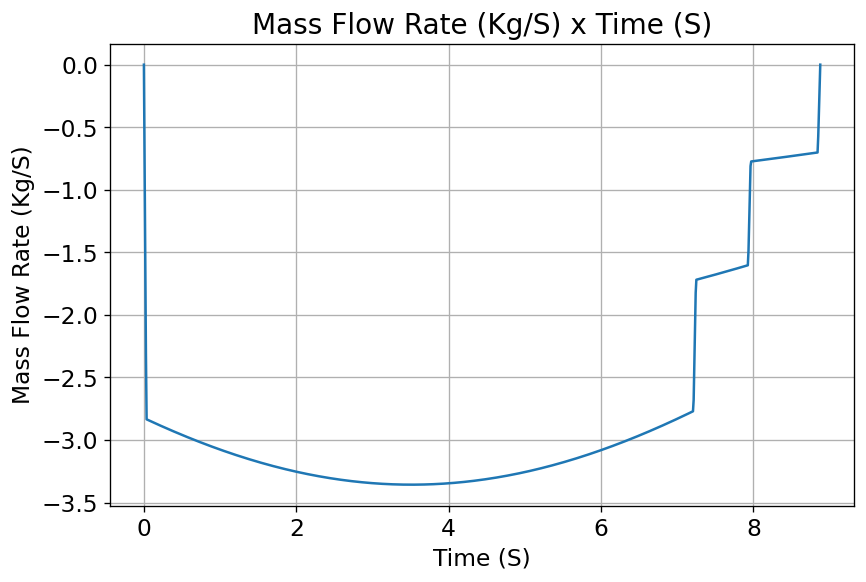

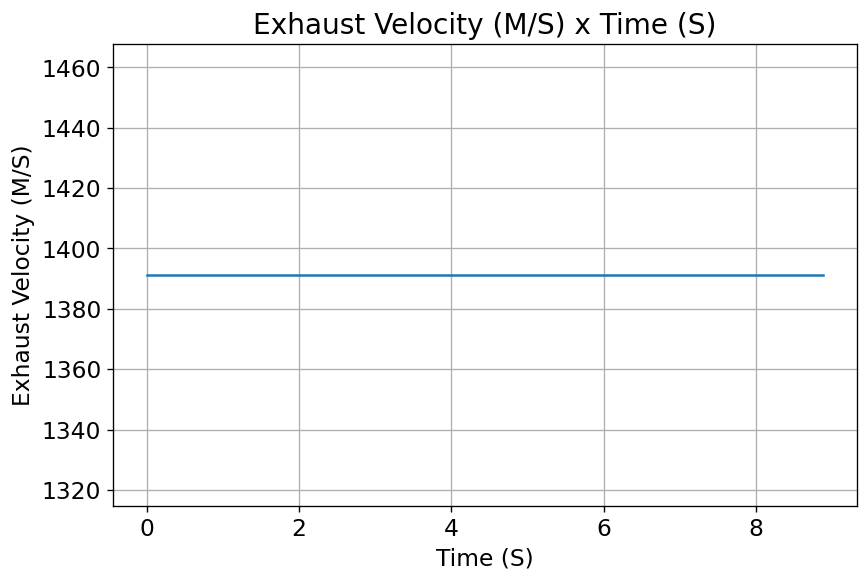

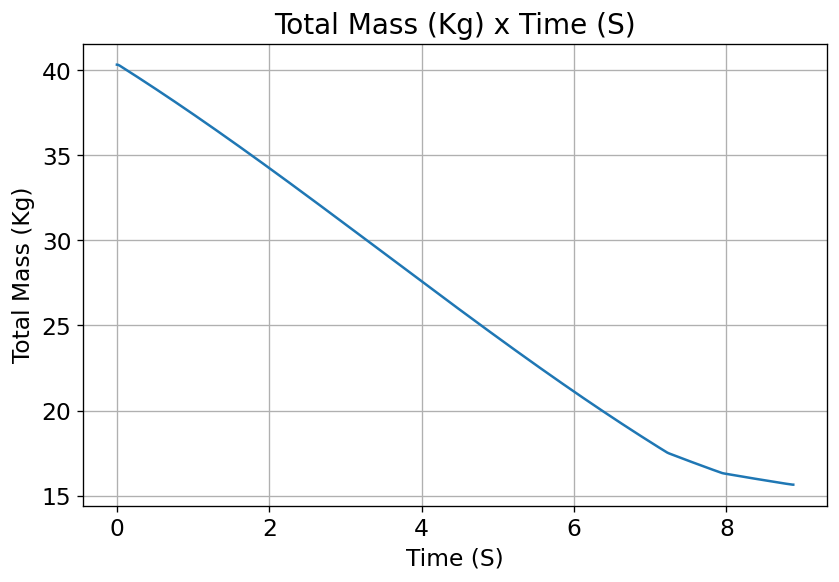

...

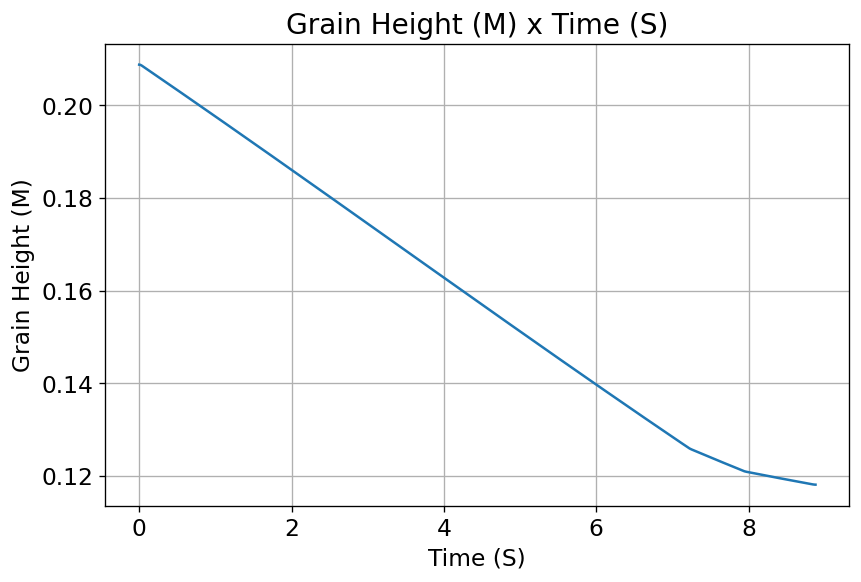

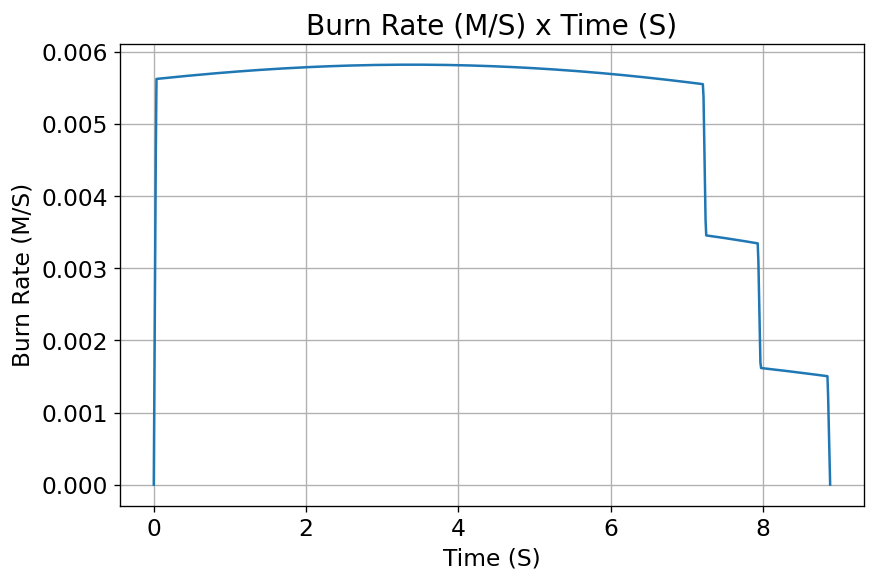

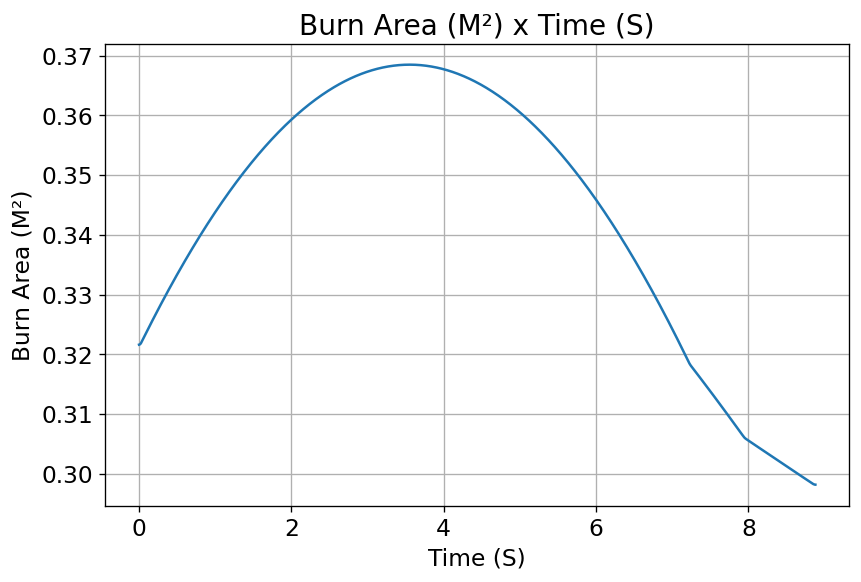

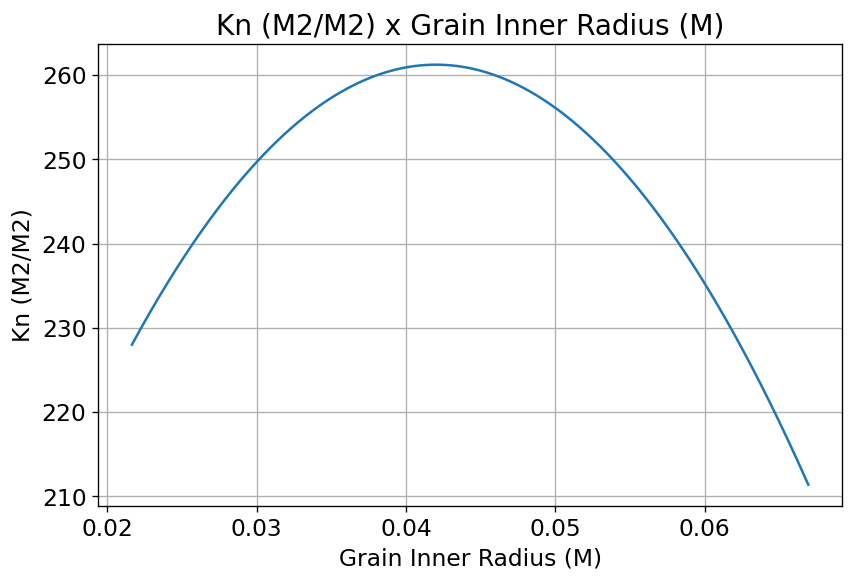

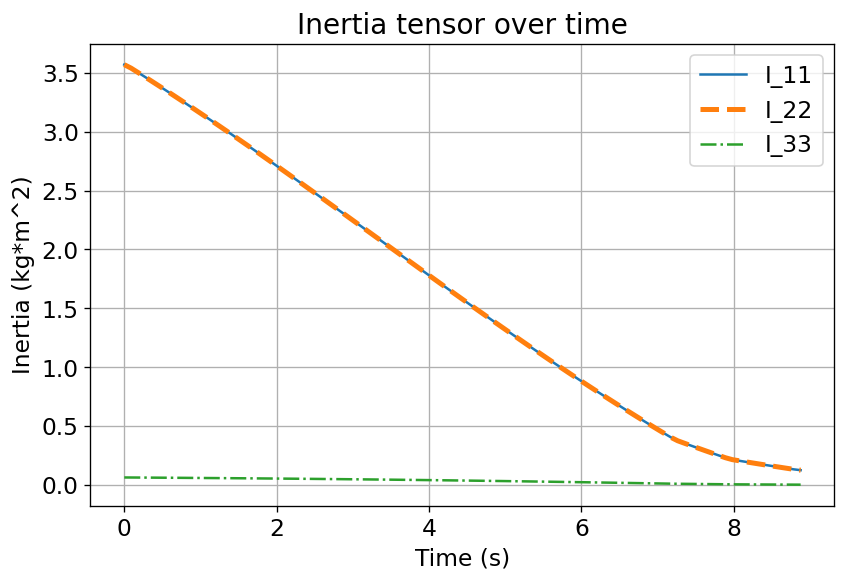

rocketCreated!!!

Inertia Details

Rocket Mass: 54.920 kg (without motor)
Rocket Dry Mass: 70.560 kg (with unloaded motor)
Rocket Loaded Mass: 95.257 kg
Rocket Structural Mass Ratio: 0.741
Rocket Inertia (with unloaded motor) 11: 26.002 kg*m2
Rocket Inertia (with unloaded motor) 22: 75.804 kg*m2
Rocket Inertia (with unloaded motor) 33: 0.002 kg*m2
Rocket Inertia (with unloaded motor) 12: 0.000 kg*m2
Rocket Inertia (with unloaded motor) 13: 0.000 kg*m2
Rocket Inertia (with unloaded motor) 23: 0.000 kg*m2

Geometrical Parameters

Rocket Maximum Radius: 0.0792880690918264 m
Rocket Frontal Area: 0.019750 m2

Rocket Distances
Rocket Center of Dry Mass - Center of Mass without Motor: 0.322 m
Rocket Center of Dry Mass - Nozzle Exit: 1.680 m
Rocket Center of Dry Mass - Center of Propellant Mass: 1.120 m
Rocket Center of Mass - Rocket Loaded Center of Mass: 0.290 m


Aerodynamics Lift Coefficient Derivatives

Nose Cone Lift Coefficient Derivative: 2.000/rad
Fins Lift Coefficient Derivative: 8.0

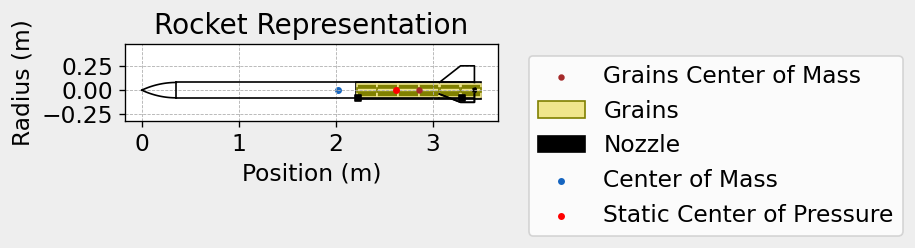


Mass Plots
----------------------------------------


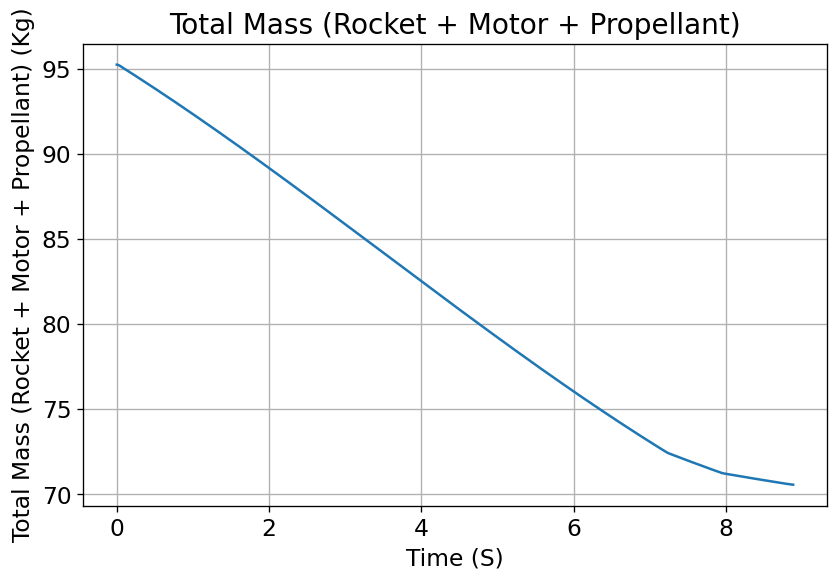

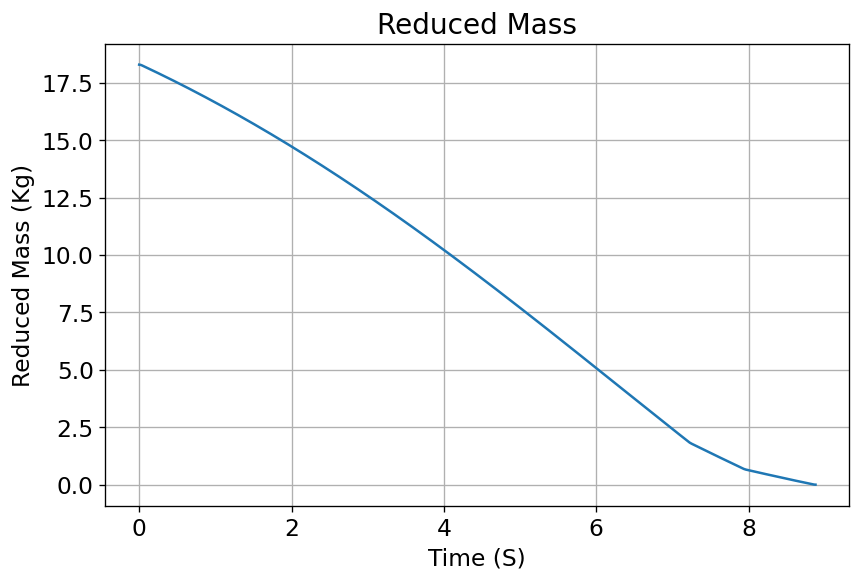


Aerodynamics Plots
----------------------------------------
Drag Plots
--------------------


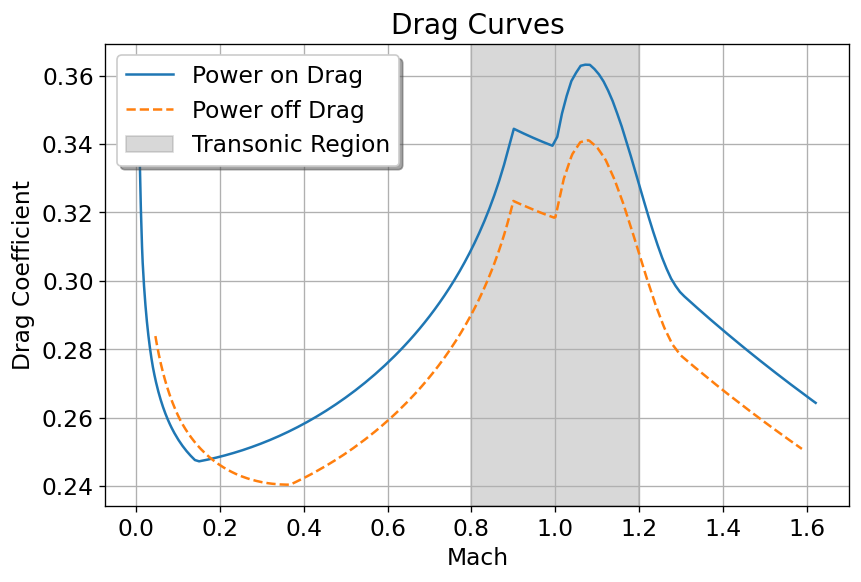


Stability Plots
--------------------


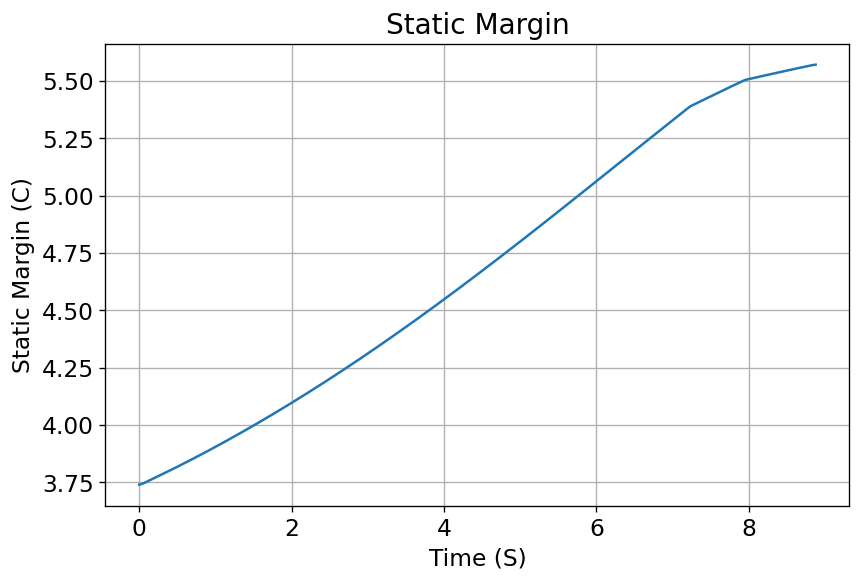

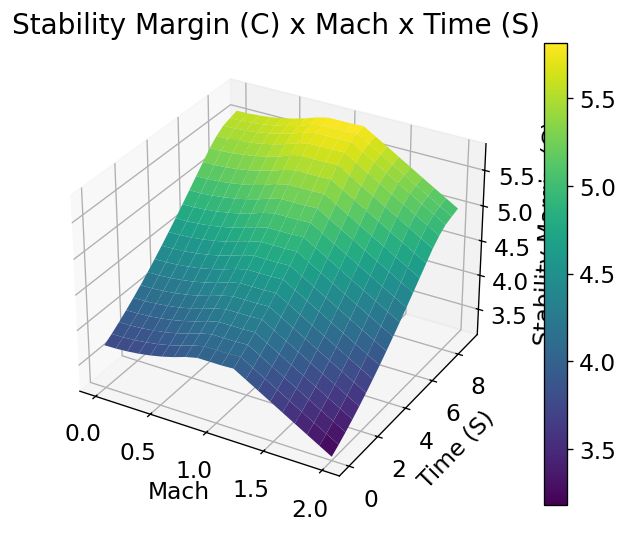


Thrust-to-Weight Plot
----------------------------------------


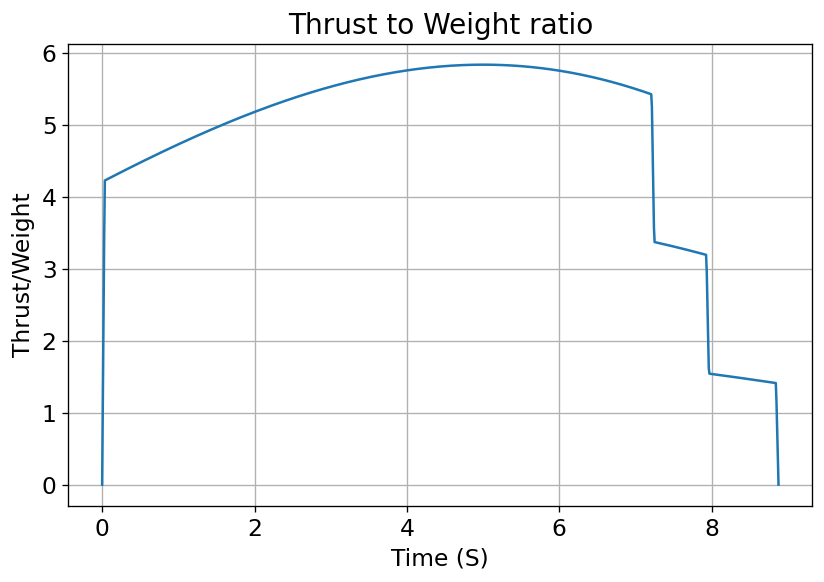

running flight

Initial Conditions

Initial time: 0.000 s
Position - x: 0.00 m | y: 0.00 m | z: 0.00 m
Velocity - Vx: 0.00 m/s | Vy: 0.00 m/s | Vz: 0.00 m/s
Attitude (quaternions) - e0: 0.707 | e1: -0.005 | e2: 0.005 | e3: -0.707
Euler Angles - Spin φ : 0.00° | Nutation θ: -0.88° | Precession ψ: -89.99°
Angular Velocity - ω1: 0.00 rad/s | ω2: 0.00 rad/s | ω3: 0.00 rad/s
Initial Stability Margin: 3.740 c


Surface Wind Conditions

Frontal Surface Wind Speed: -1.05 m/s
Lateral Surface Wind Speed: 1.72 m/s


Launch Rail

Launch Rail Length: 5.1816 m
Launch Rail Inclination: 89.12°
Launch Rail Heading: 89.99°


Rail Departure State

Rail Departure Time: 0.516 s
Rail Departure Velocity: 16.301 m/s
Rail Departure Stability Margin: 3.821 c
Rail Departure Angle of Attack: 7.029°
Rail Departure Thrust-Weight Ratio: 4.481
Rail Departure Reynolds Number: 1.709e+05


Burn out State

Burn out time: 8.879 s
Altitude at burn out: 1556.707 m (ASL) | 1556.707 m (AGL)
Rocket speed at burn out: 313.771 m

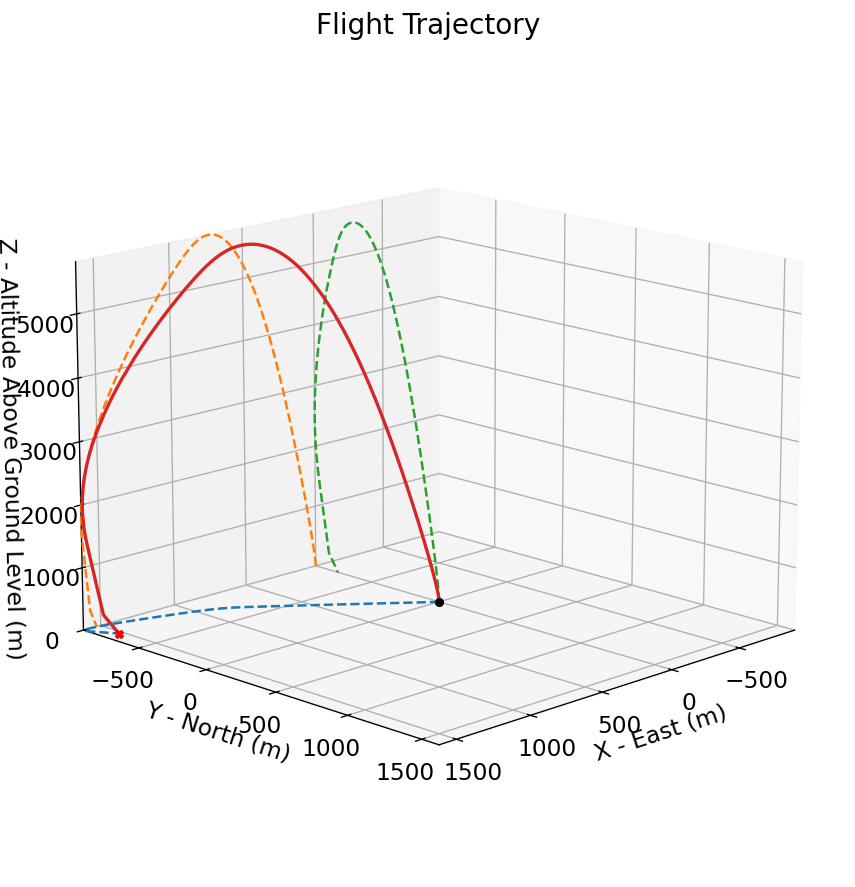



Trajectory Kinematic Plots



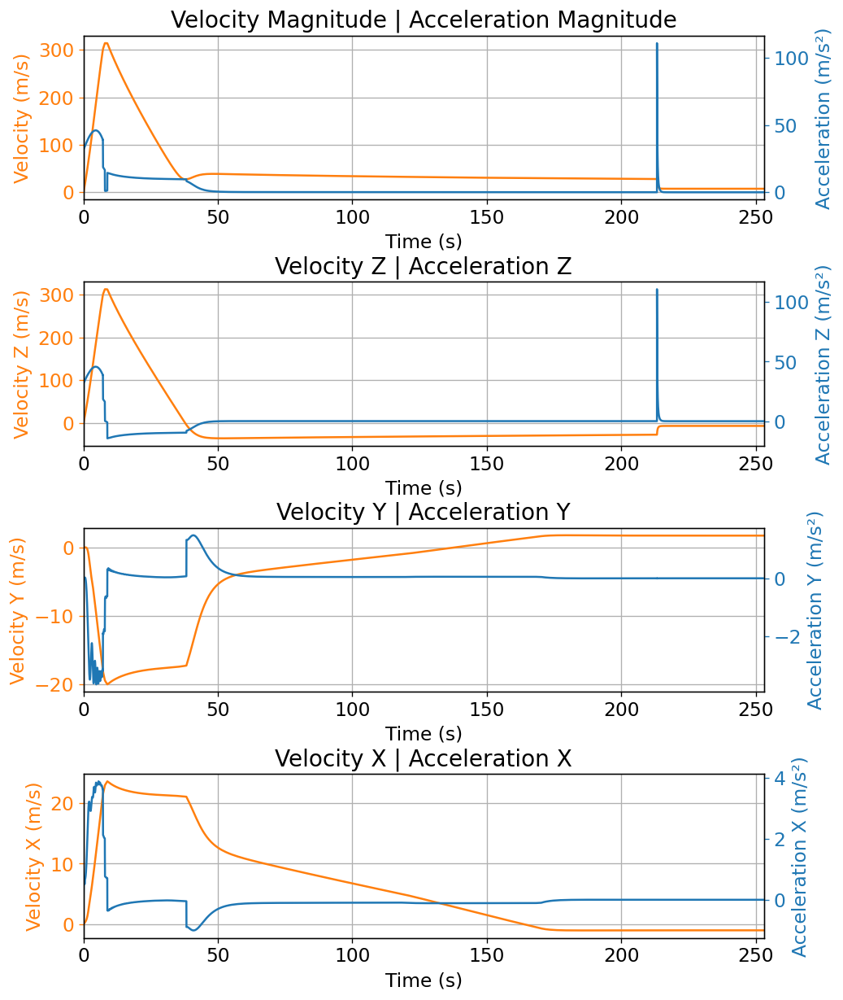



Angular Position Plots



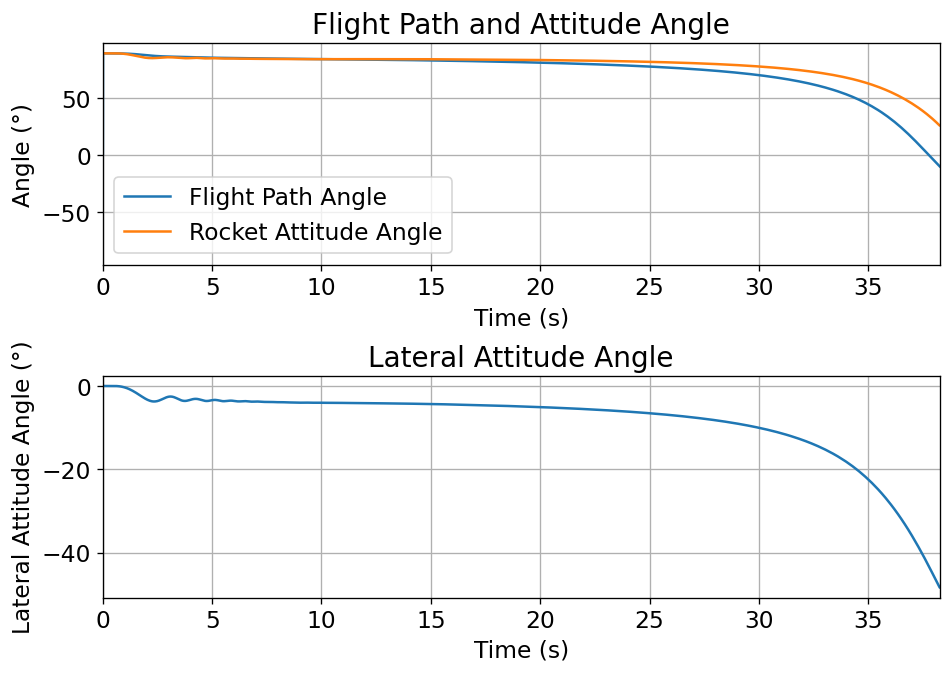



Path, Attitude and Lateral Attitude Angle plots



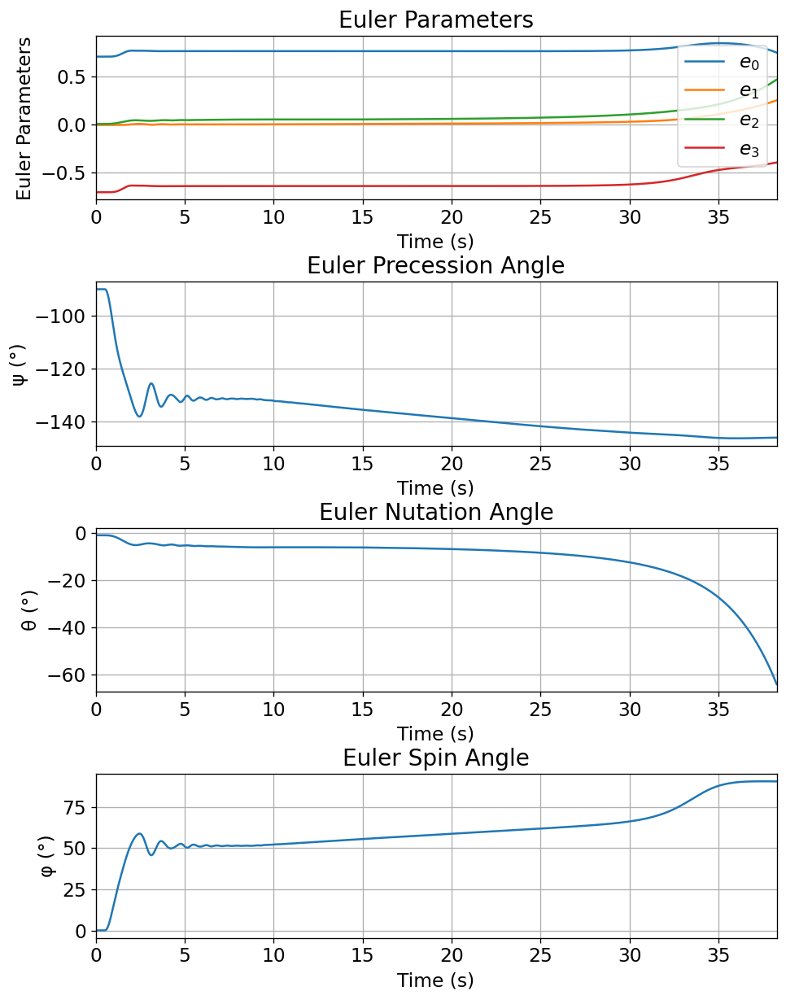



Trajectory Angular Velocity and Acceleration Plots



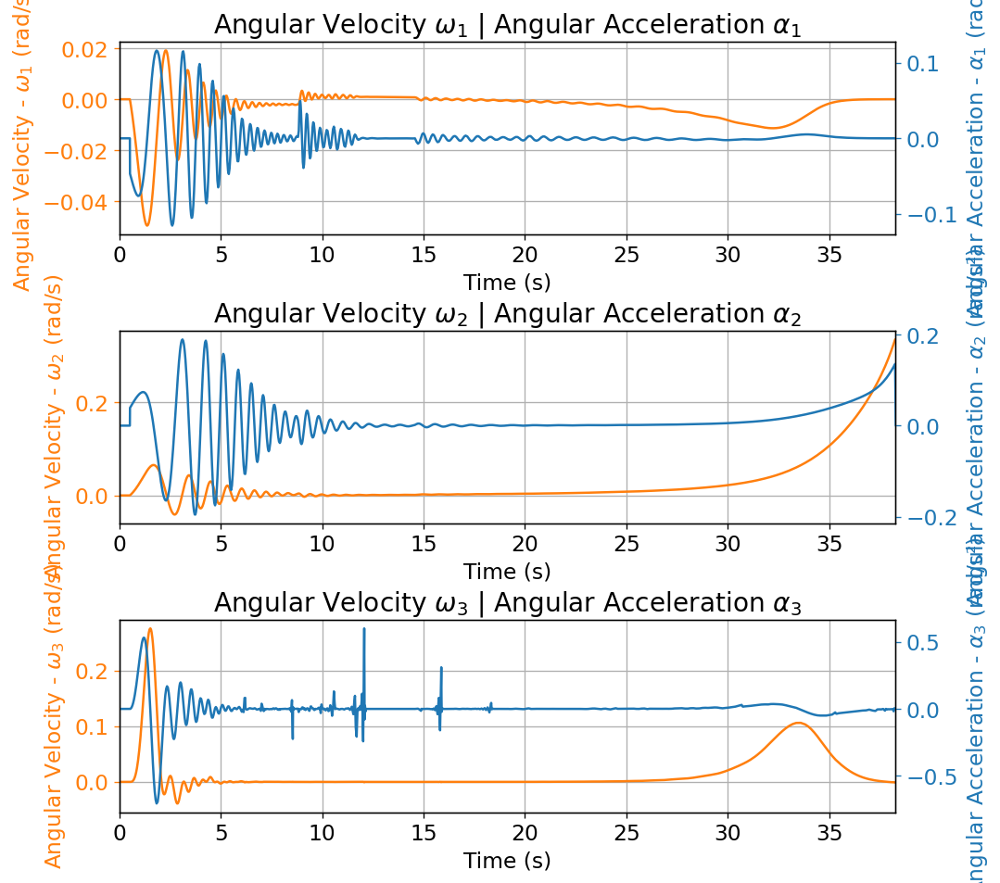



Aerodynamic Forces Plots



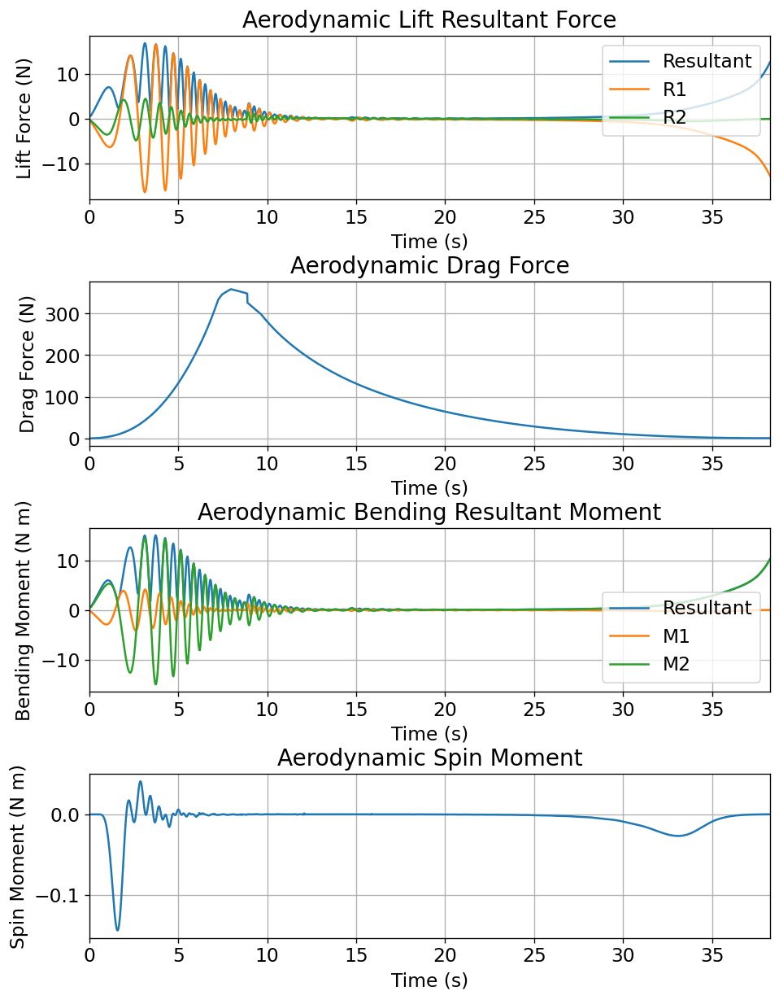



Rail Buttons Forces Plots



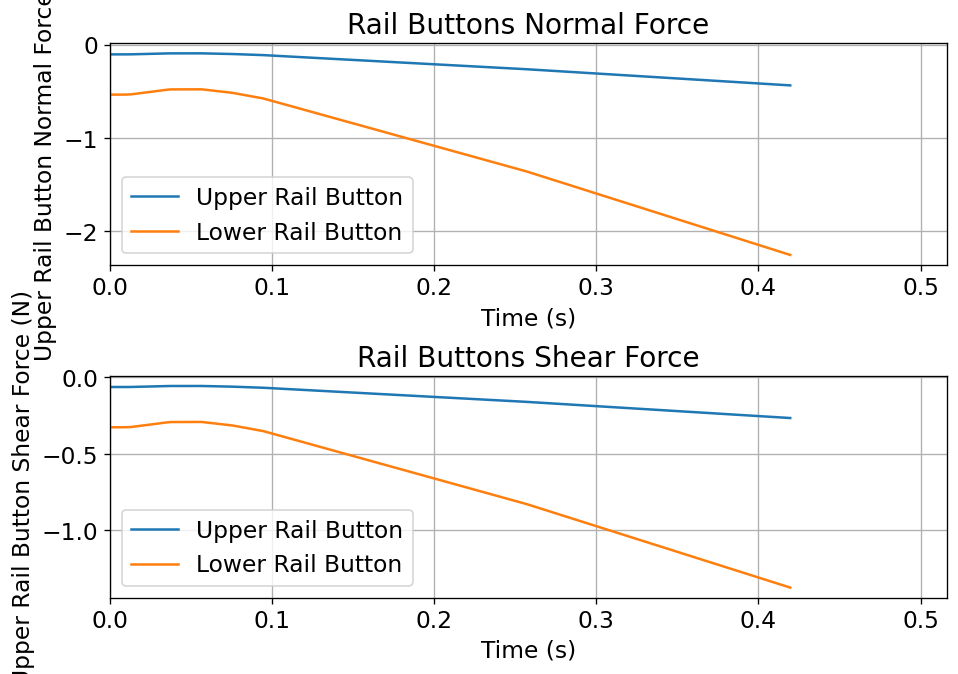



Trajectory Energy Plots



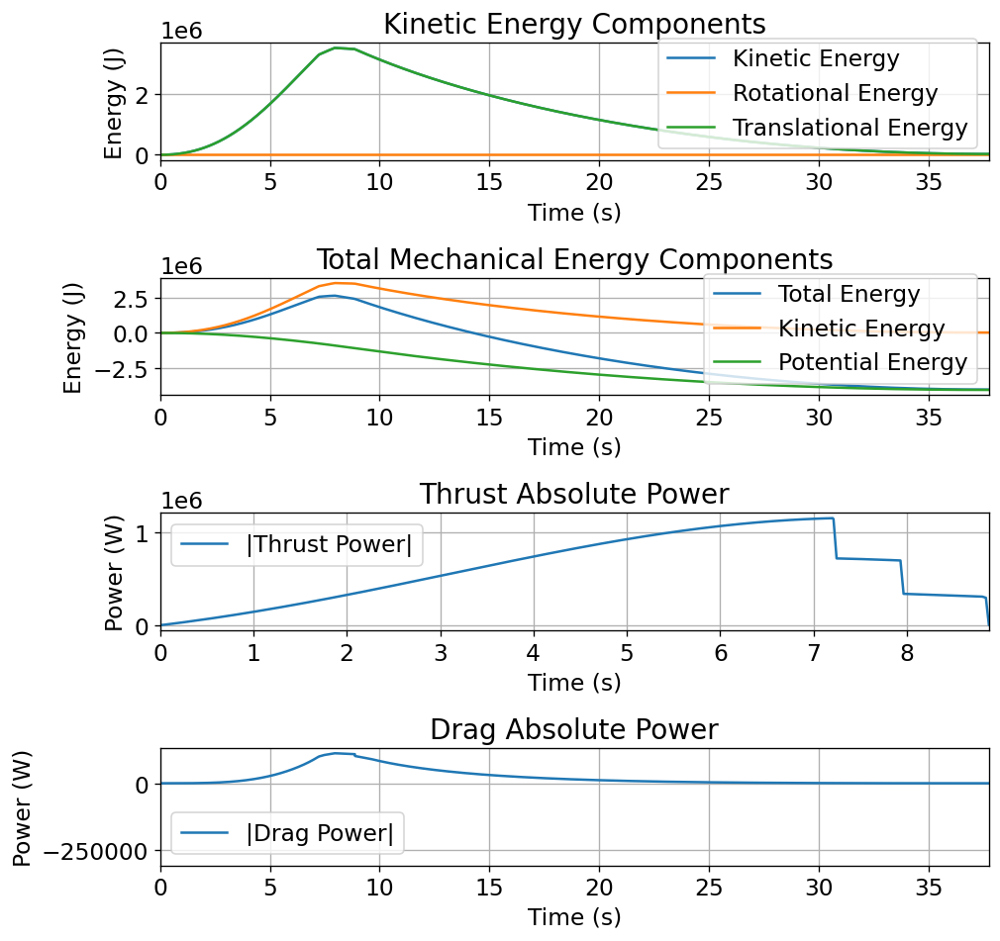



Trajectory Fluid Mechanics Plots



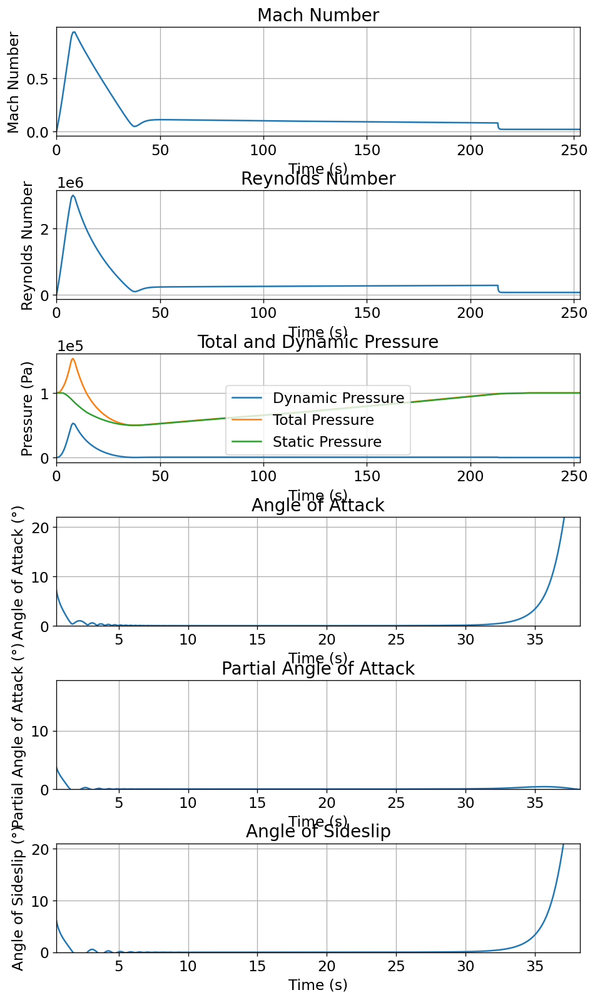



Trajectory Stability and Control Plots



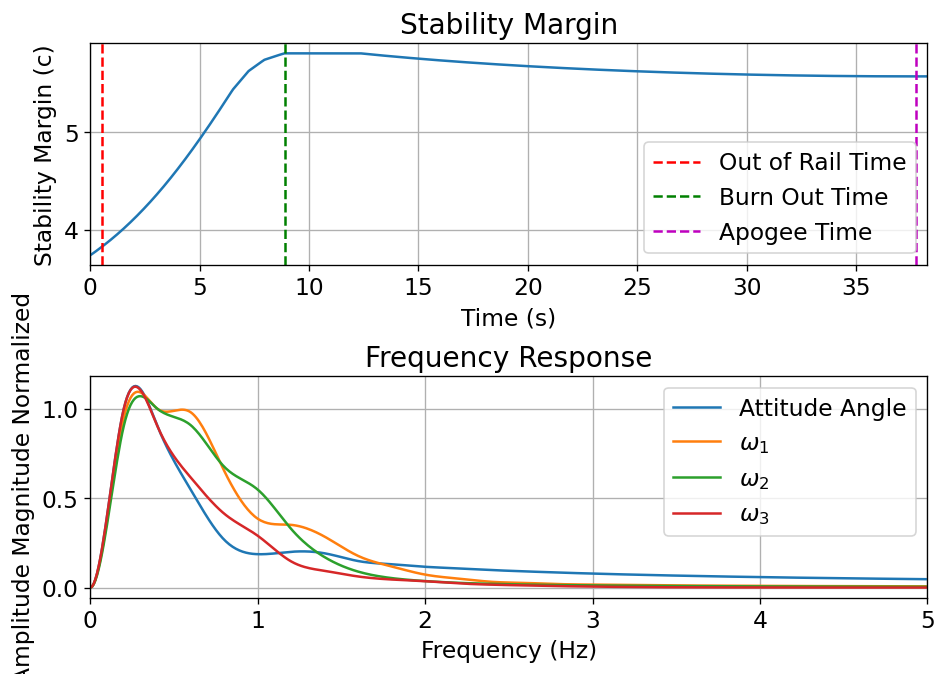



Rocket and Parachute Pressure Plots



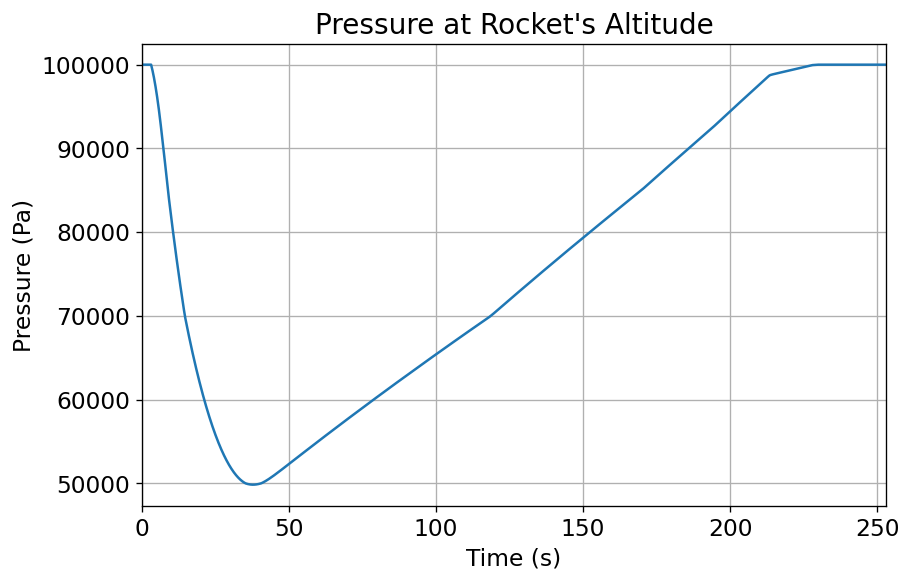


Parachute:  Drogue


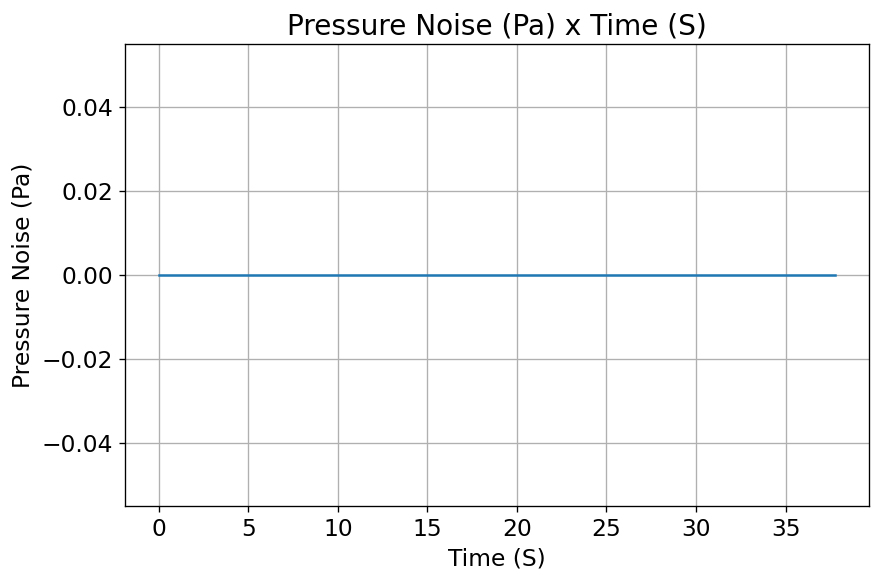

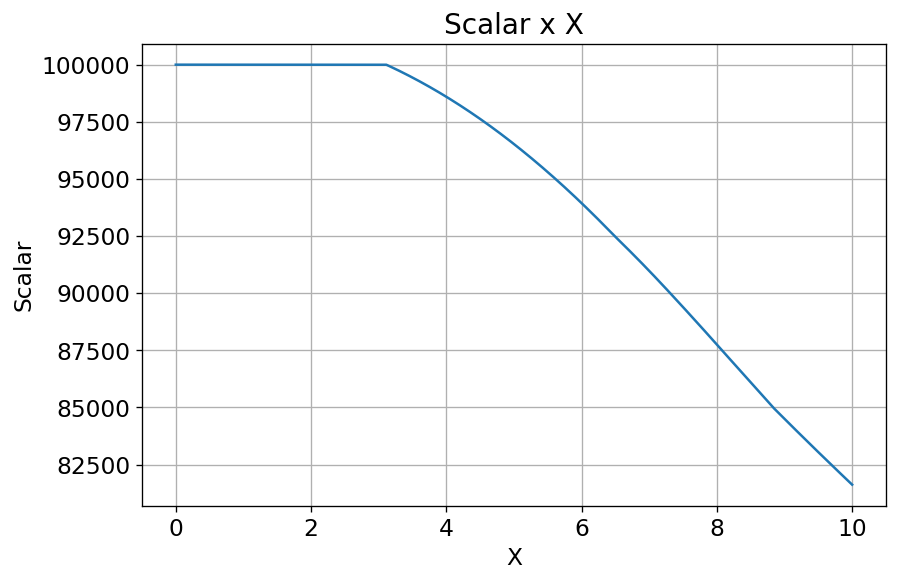

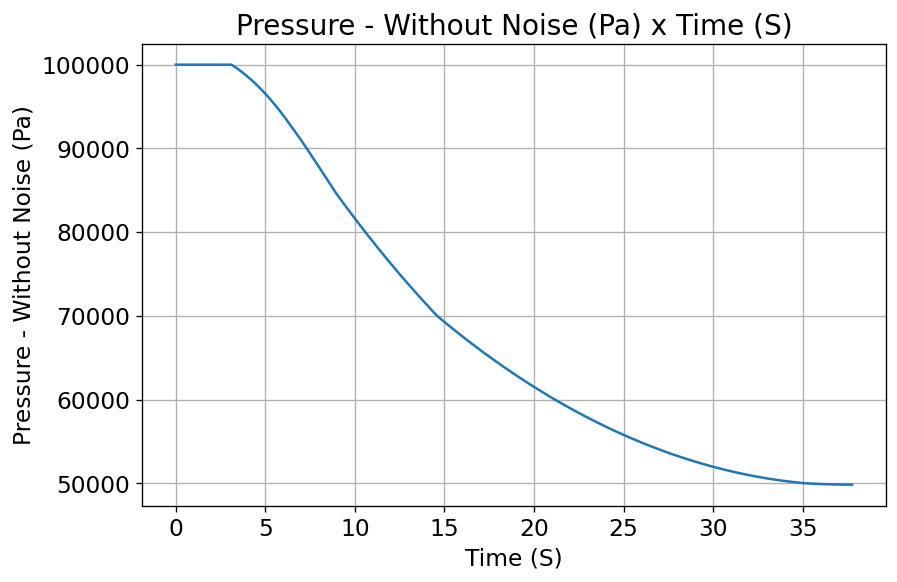


Parachute:  Main


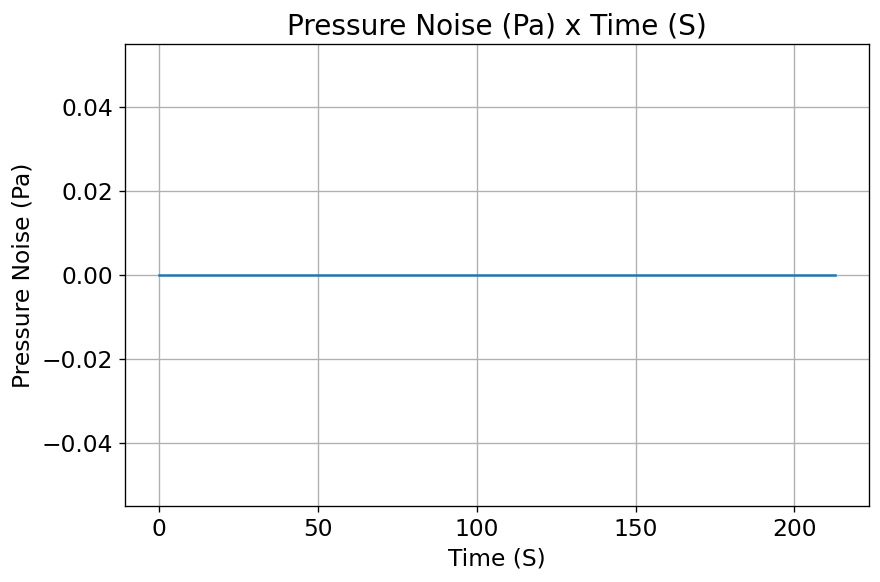

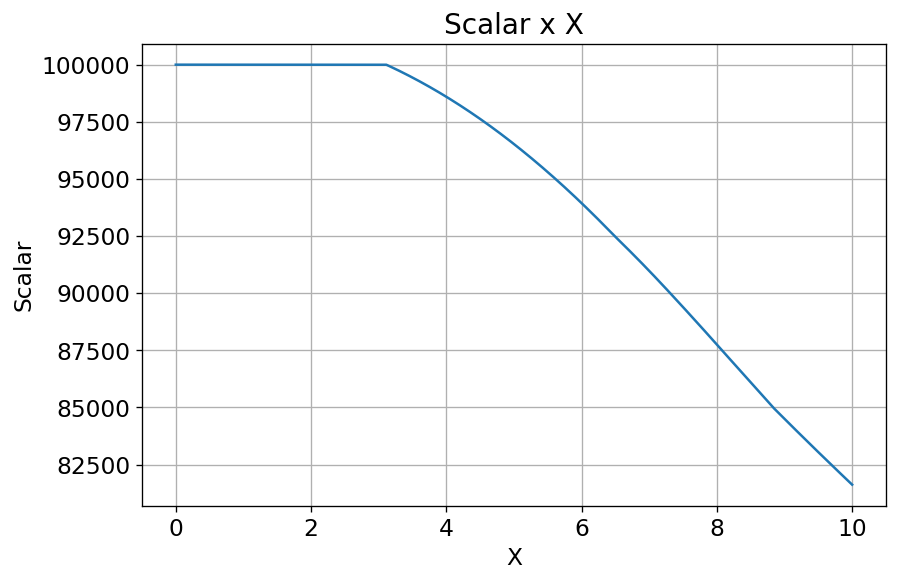

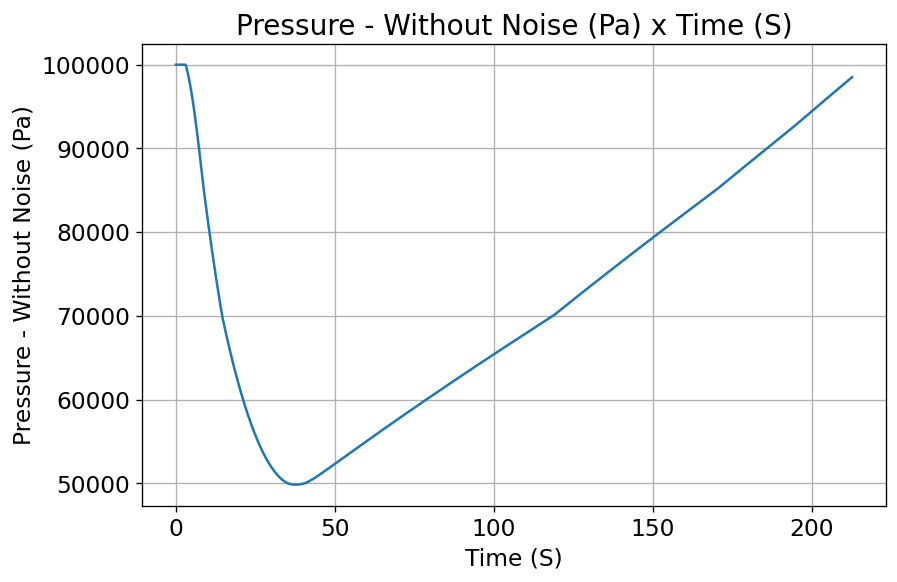

['FlightPhases', 'M1', 'M2', 'M3', 'R1', 'R2', 'R3', 'TimeNodes', '_Flight__cache_sensor_data', '_Flight__calculate_and_save_pressure_signals', '_Flight__calculate_rail_button_forces', '_Flight__evaluate_post_process', '_Flight__init_controllers', '_Flight__init_equations_of_motion', '_Flight__init_flight_state', '_Flight__init_solution_monitors', '_Flight__init_solver_monitors', '_Flight__is_lsoda', '_Flight__post_processed_variables', '_Flight__set_ode_solver', '_Flight__simulate', '_Flight__transform_pressure_signals_lists_to_functions', '__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_controllers', '_solver', 'acceleration', 'aerodynamic_bending_moment', 'aerodynamic_drag', 

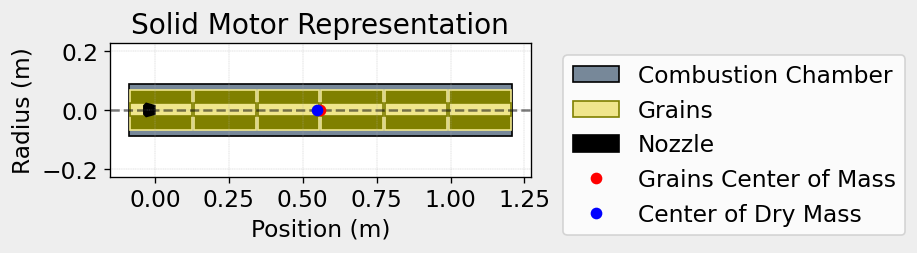

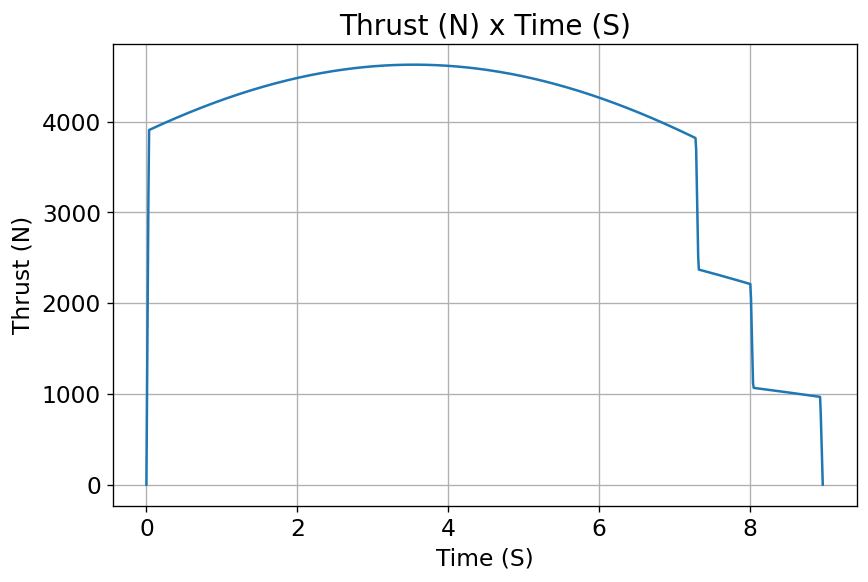

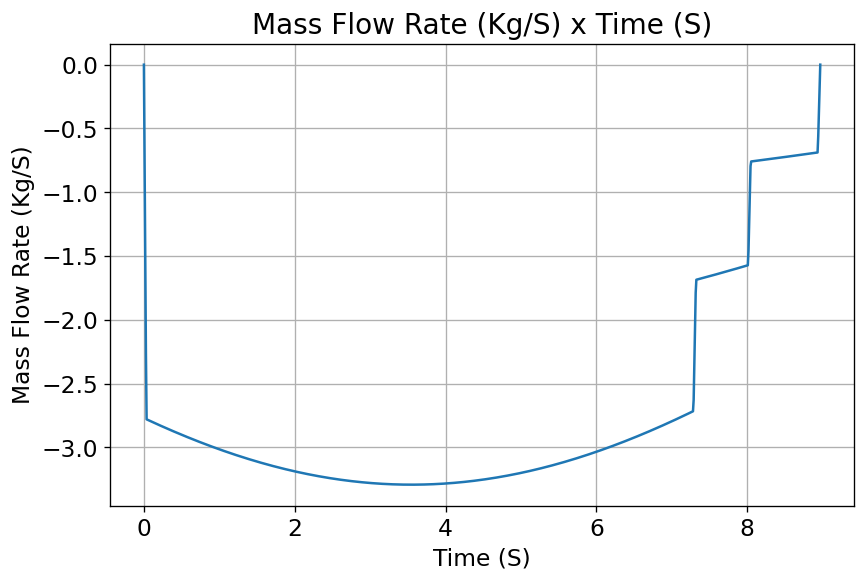

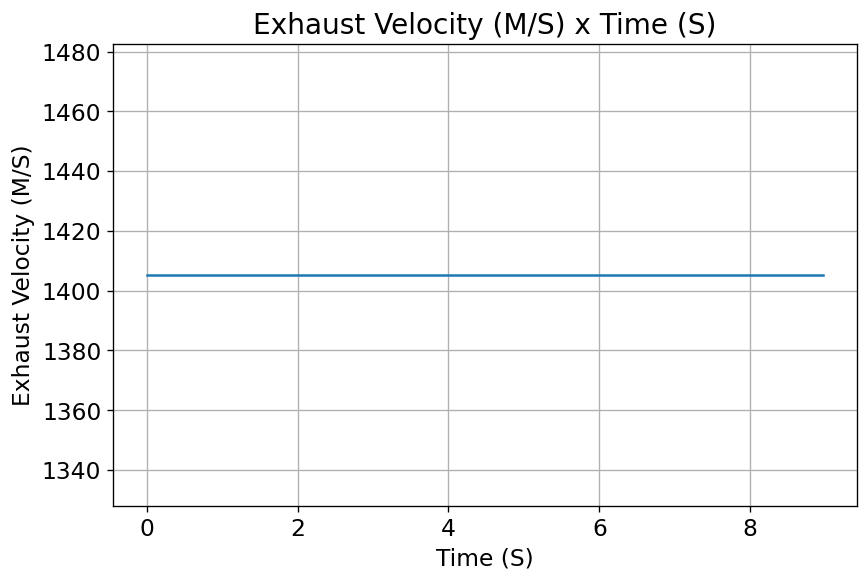

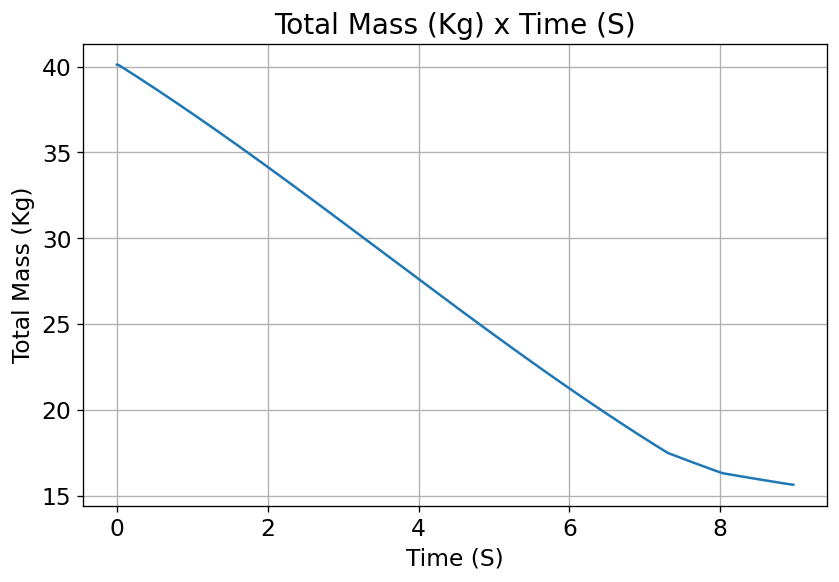

...

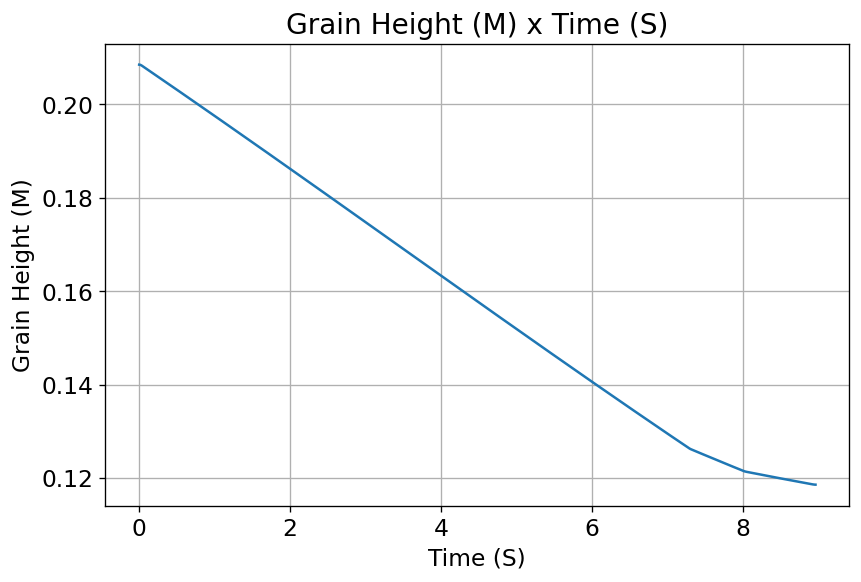

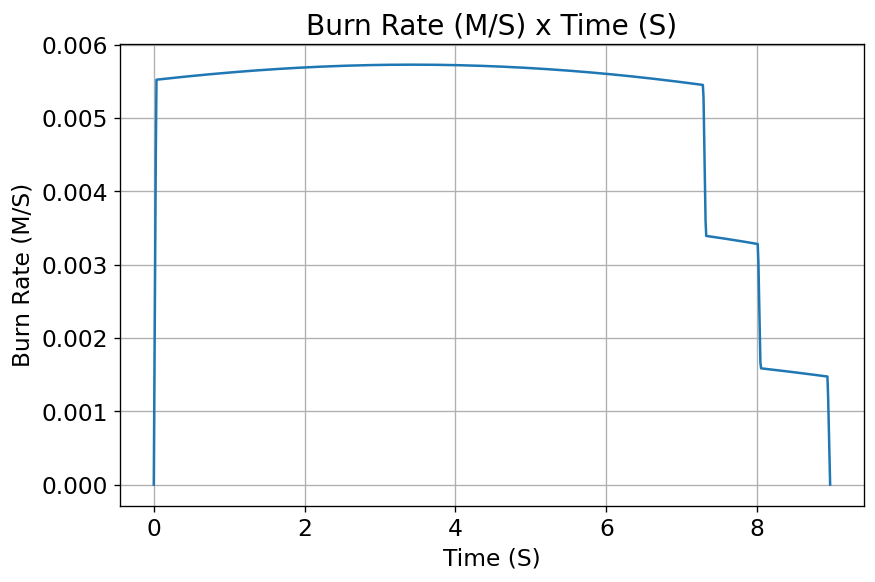

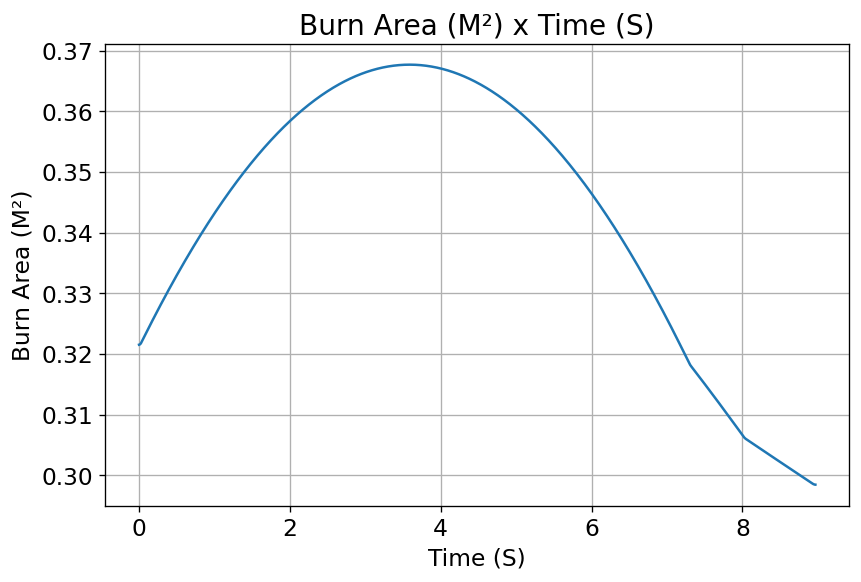

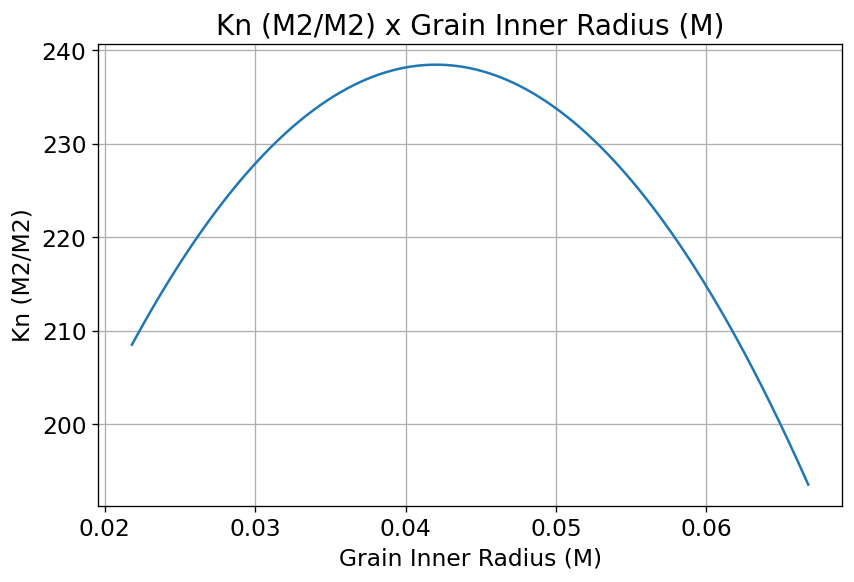

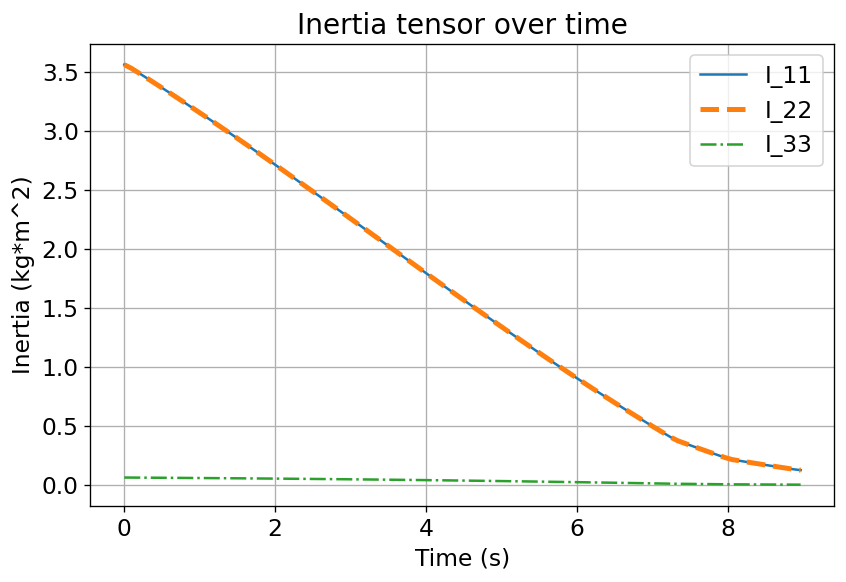

rocketCreated!!!

Inertia Details

Rocket Mass: 55.074 kg (without motor)
Rocket Dry Mass: 70.714 kg (with unloaded motor)
Rocket Loaded Mass: 95.187 kg
Rocket Structural Mass Ratio: 0.743
Rocket Inertia (with unloaded motor) 11: 26.029 kg*m2
Rocket Inertia (with unloaded motor) 22: 75.820 kg*m2
Rocket Inertia (with unloaded motor) 33: 0.002 kg*m2
Rocket Inertia (with unloaded motor) 12: 0.000 kg*m2
Rocket Inertia (with unloaded motor) 13: 0.000 kg*m2
Rocket Inertia (with unloaded motor) 23: 0.000 kg*m2

Geometrical Parameters

Rocket Maximum Radius: 0.0784689619727799 m
Rocket Frontal Area: 0.019344 m2

Rocket Distances
Rocket Center of Dry Mass - Center of Mass without Motor: 0.321 m
Rocket Center of Dry Mass - Nozzle Exit: 1.680 m
Rocket Center of Dry Mass - Center of Propellant Mass: 1.120 m
Rocket Center of Mass - Rocket Loaded Center of Mass: 0.288 m


Aerodynamics Lift Coefficient Derivatives

Nose Cone Lift Coefficient Derivative: 2.000/rad
Fins Lift Coefficient Derivative: 8.2

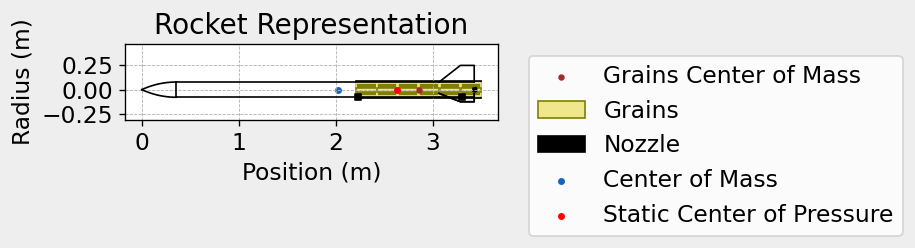


Mass Plots
----------------------------------------


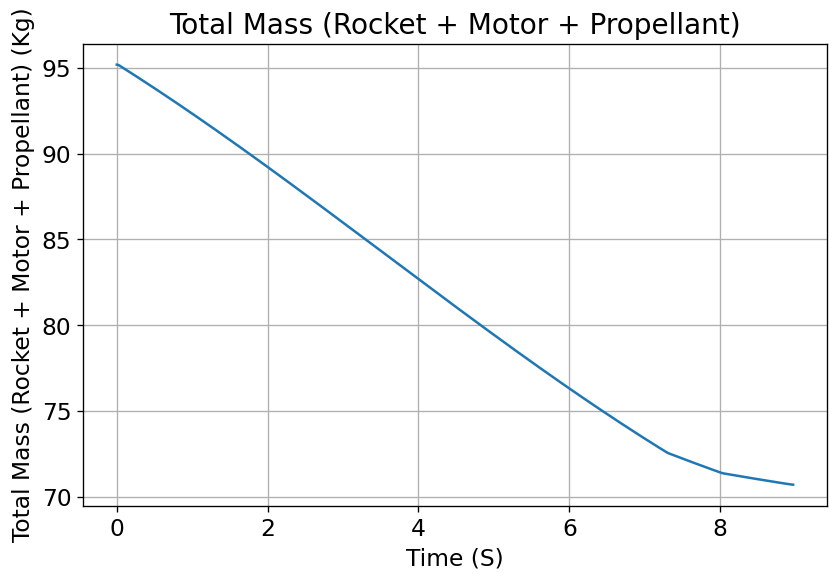

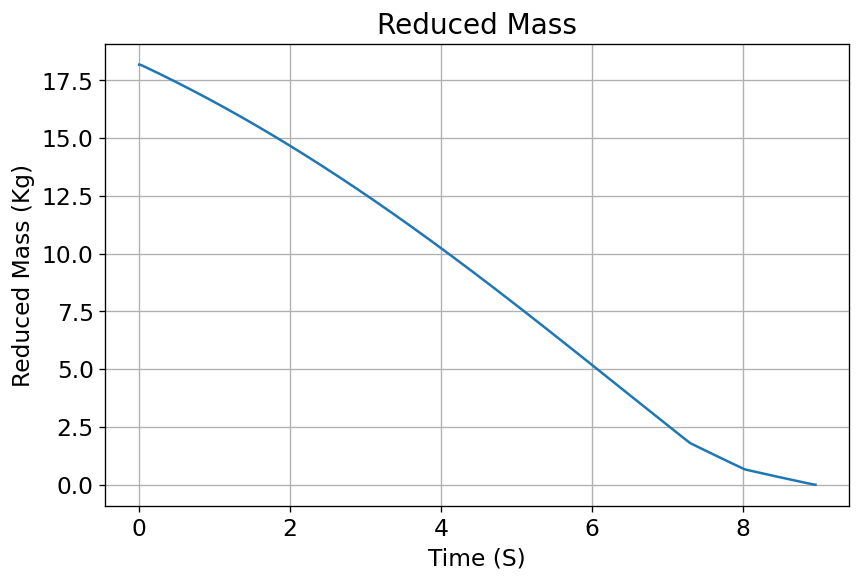


Aerodynamics Plots
----------------------------------------
Drag Plots
--------------------


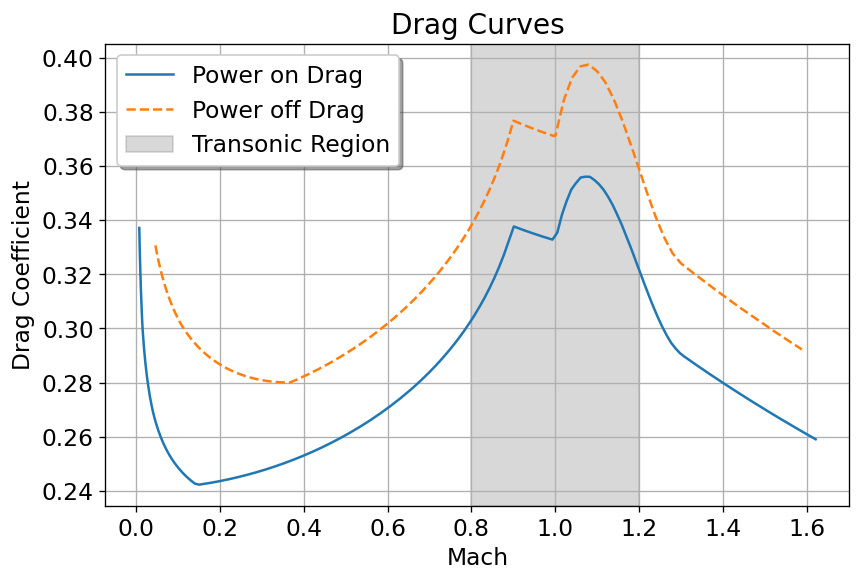


Stability Plots
--------------------


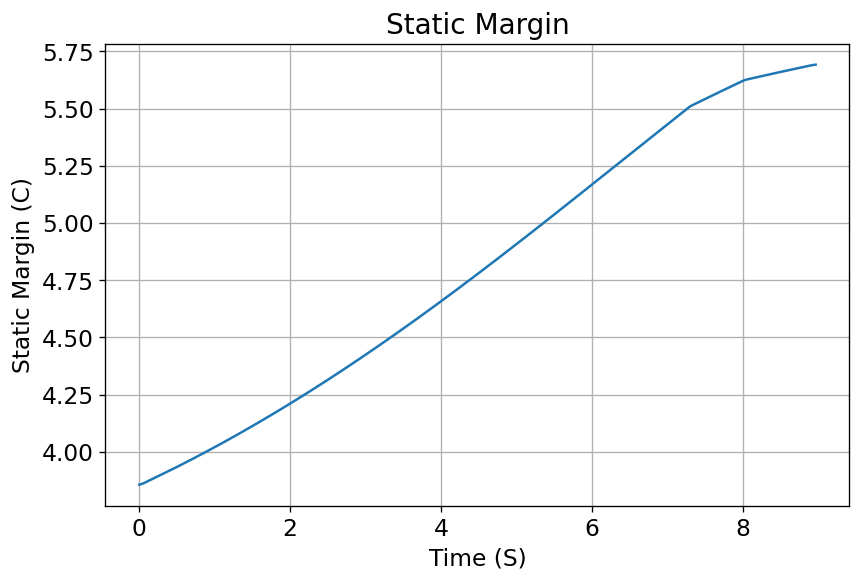

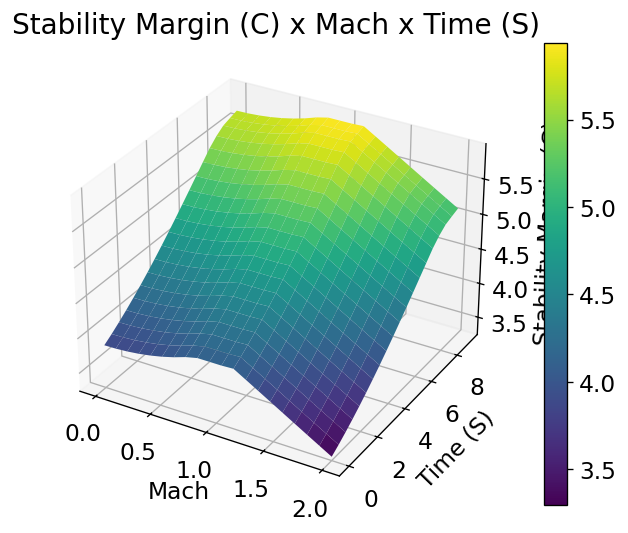


Thrust-to-Weight Plot
----------------------------------------


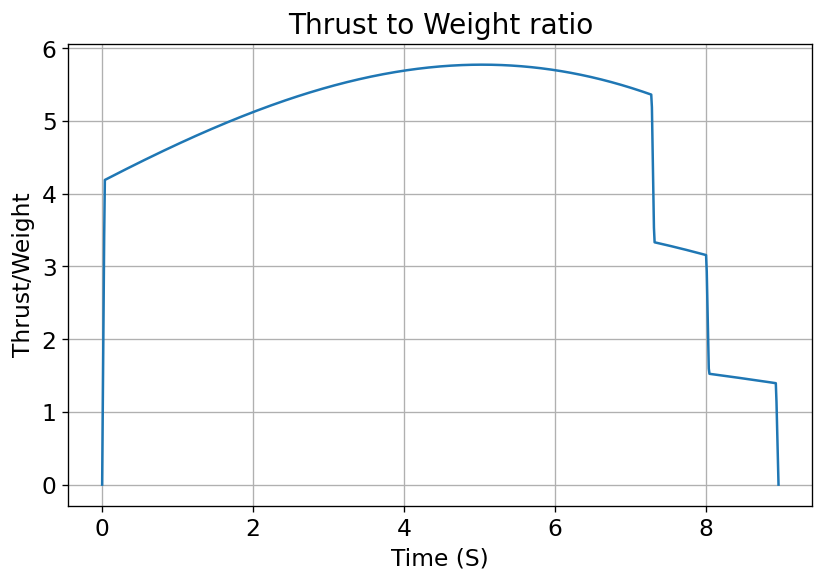

running flight

Initial Conditions

Initial time: 0.000 s
Position - x: 0.00 m | y: 0.00 m | z: 0.00 m
Velocity - Vx: 0.00 m/s | Vy: 0.00 m/s | Vz: 0.00 m/s
Attitude (quaternions) - e0: 0.701 | e1: -0.011 | e2: 0.011 | e3: -0.713
Euler Angles - Spin φ : 0.00° | Nutation θ: -1.76° | Precession ψ: -91.02°
Angular Velocity - ω1: 0.00 rad/s | ω2: 0.00 rad/s | ω3: 0.00 rad/s
Initial Stability Margin: 3.857 c


Surface Wind Conditions

Frontal Surface Wind Speed: -1.08 m/s
Lateral Surface Wind Speed: 1.70 m/s


Launch Rail

Launch Rail Length: 5.1816 m
Launch Rail Inclination: 88.24°
Launch Rail Heading: 91.02°


Rail Departure State

Rail Departure Time: 0.519 s
Rail Departure Velocity: 16.212 m/s
Rail Departure Stability Margin: 3.938 c
Rail Departure Angle of Attack: 7.059°
Rail Departure Thrust-Weight Ratio: 4.442
Rail Departure Reynolds Number: 1.684e+05


Burn out State

Burn out time: 8.967 s
Altitude at burn out: 1567.858 m (ASL) | 1567.858 m (AGL)
Rocket speed at burn out: 313.738 m

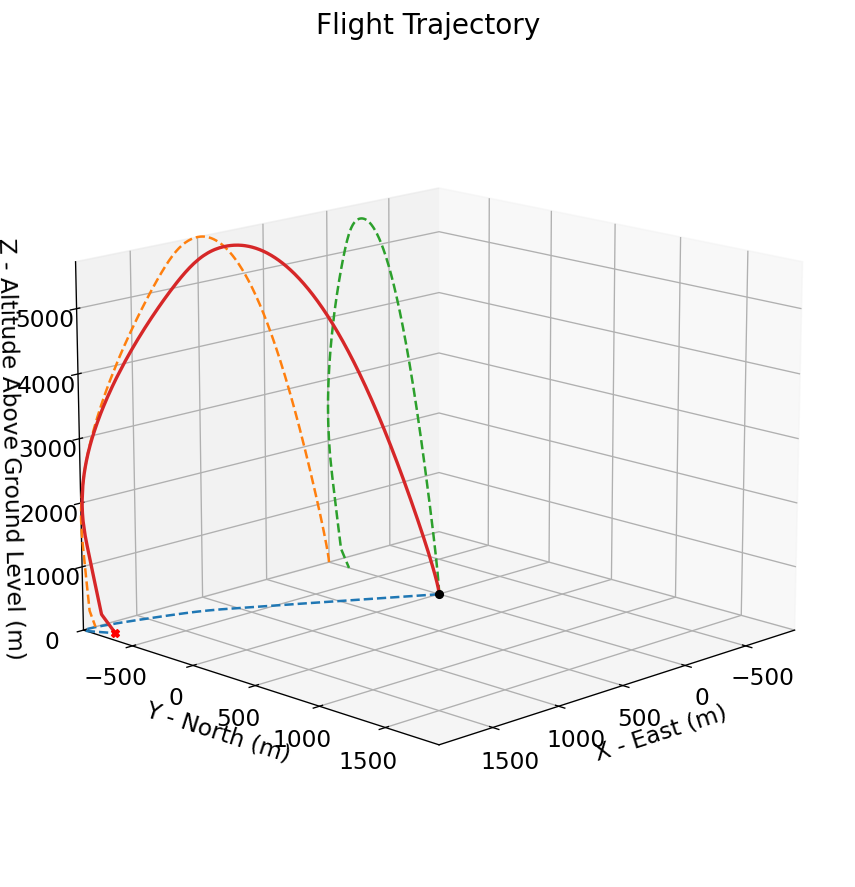



Trajectory Kinematic Plots



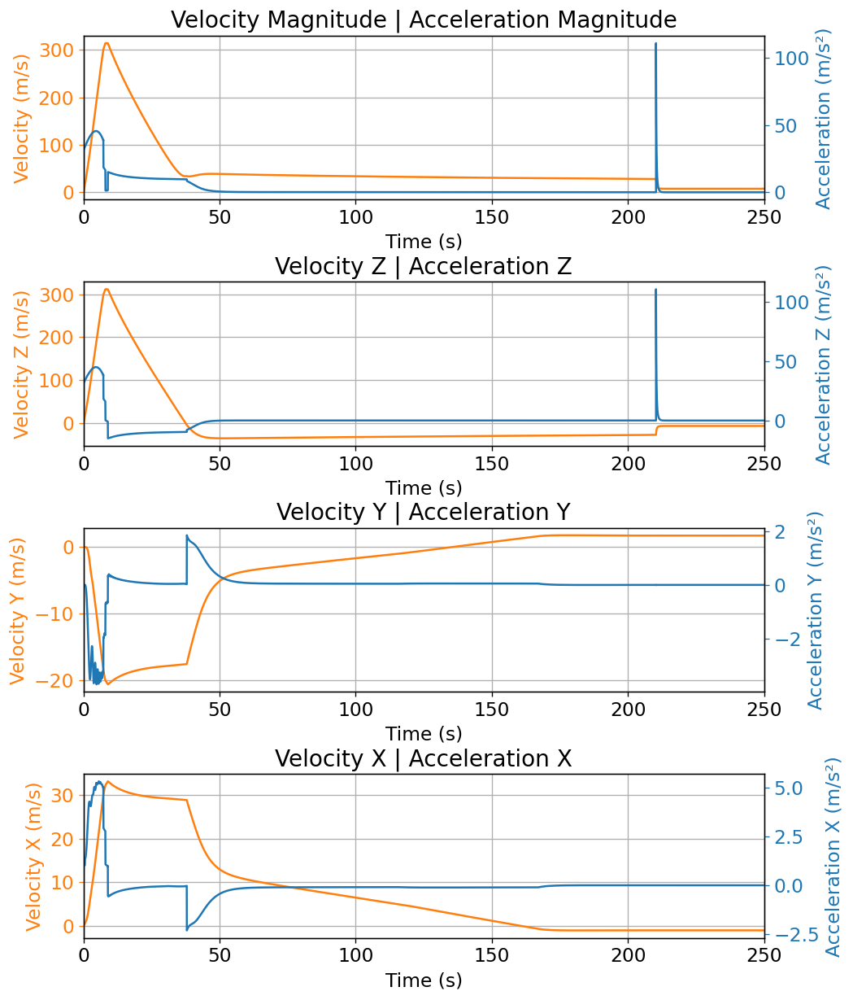



Angular Position Plots



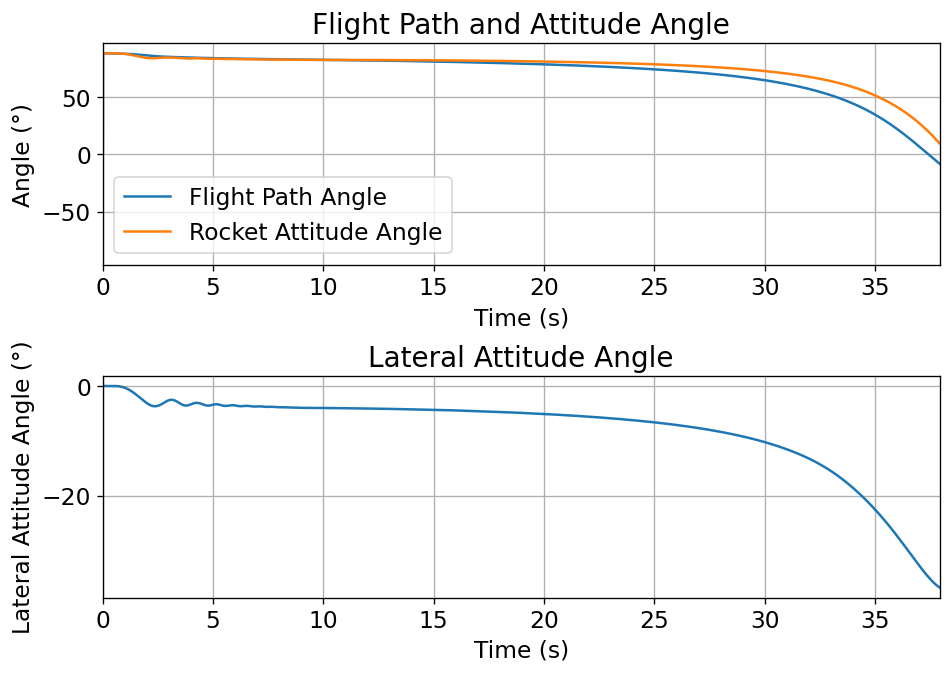



Path, Attitude and Lateral Attitude Angle plots



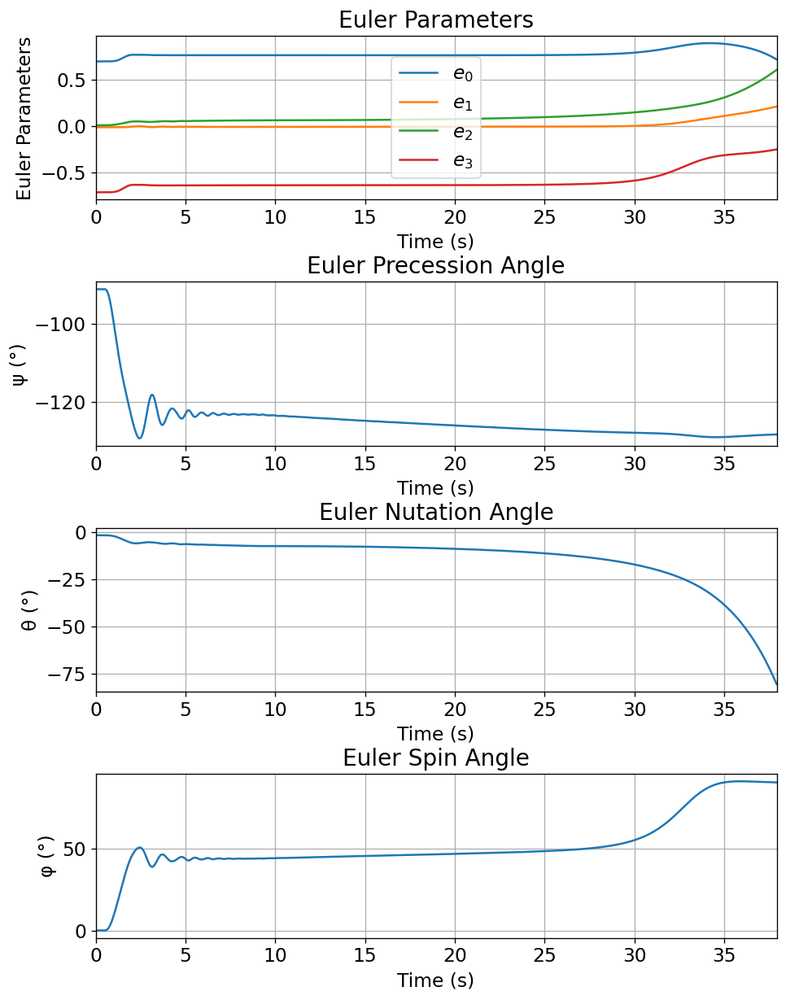



Trajectory Angular Velocity and Acceleration Plots



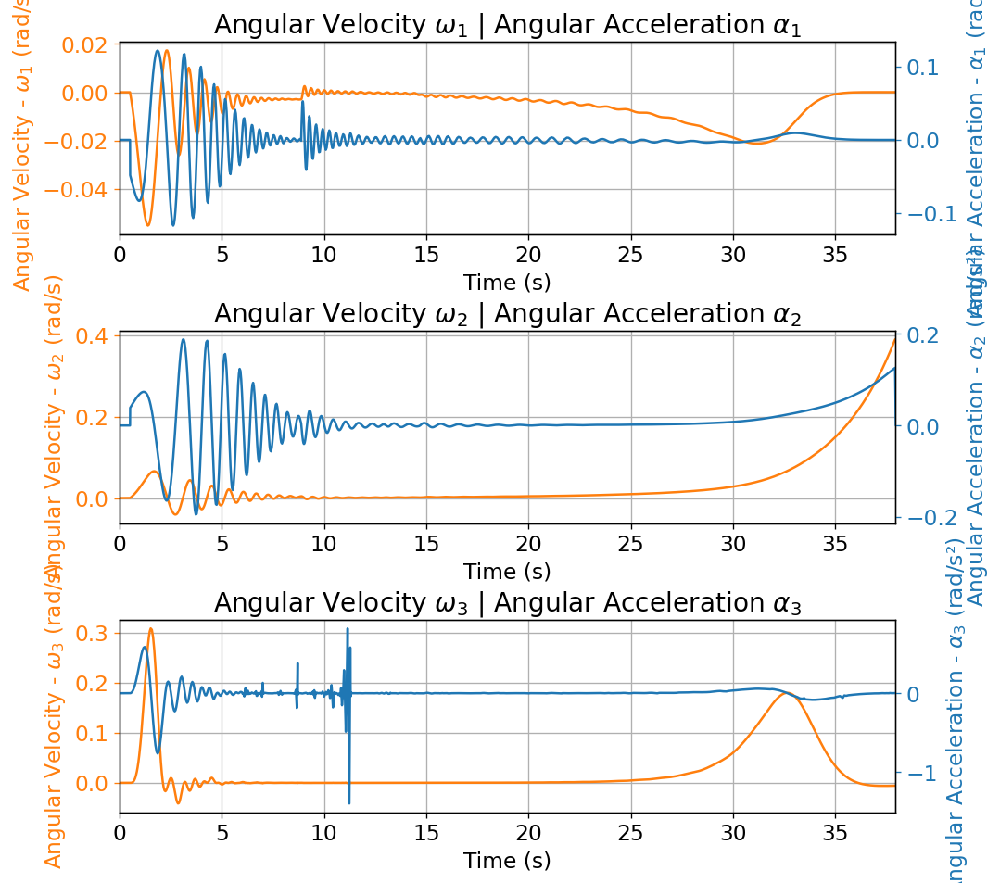



Aerodynamic Forces Plots



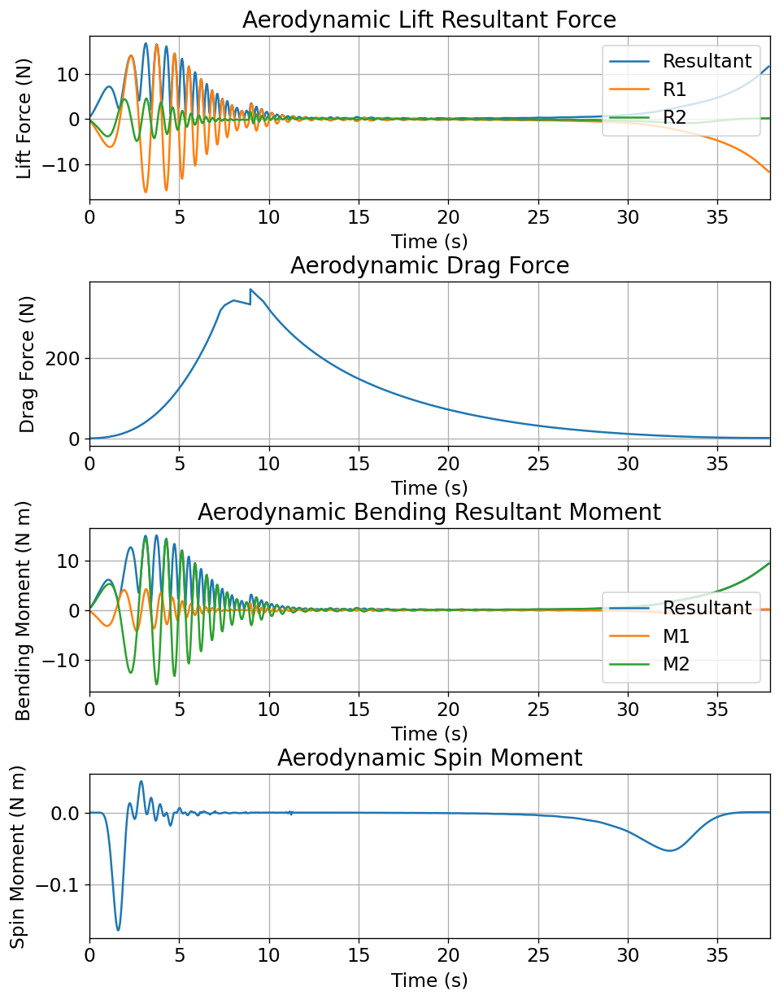



Rail Buttons Forces Plots



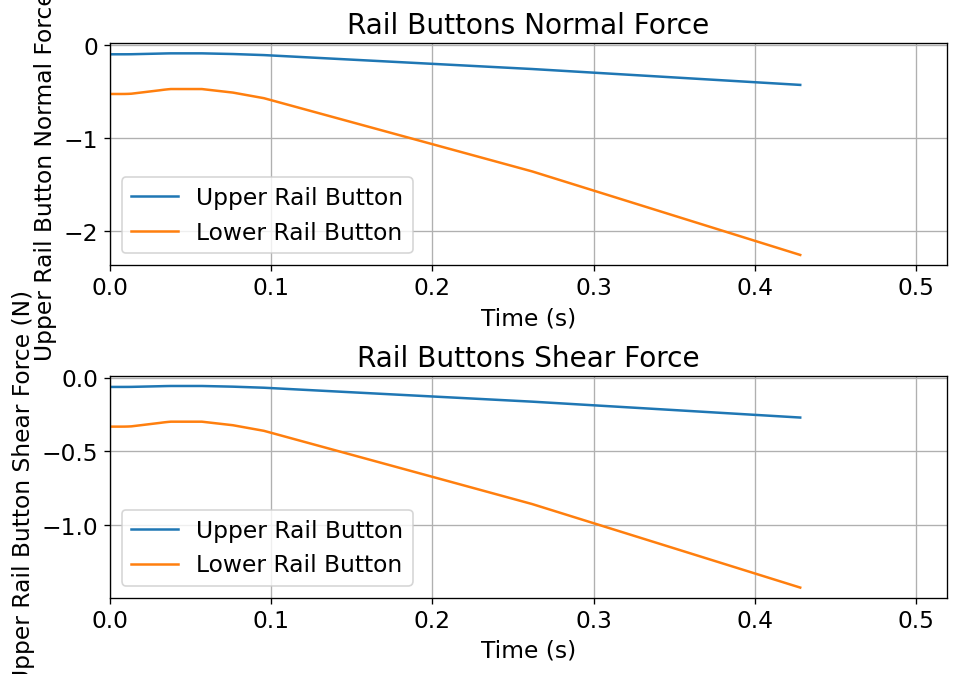



Trajectory Energy Plots



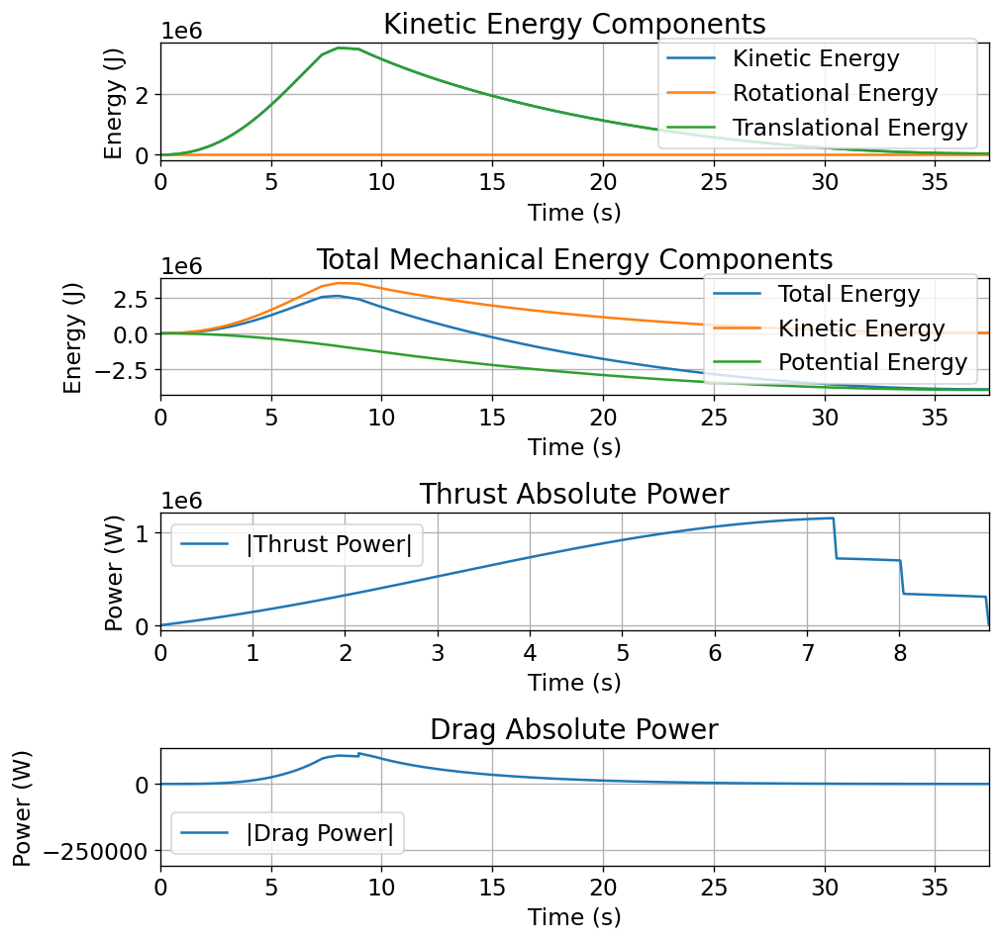



Trajectory Fluid Mechanics Plots



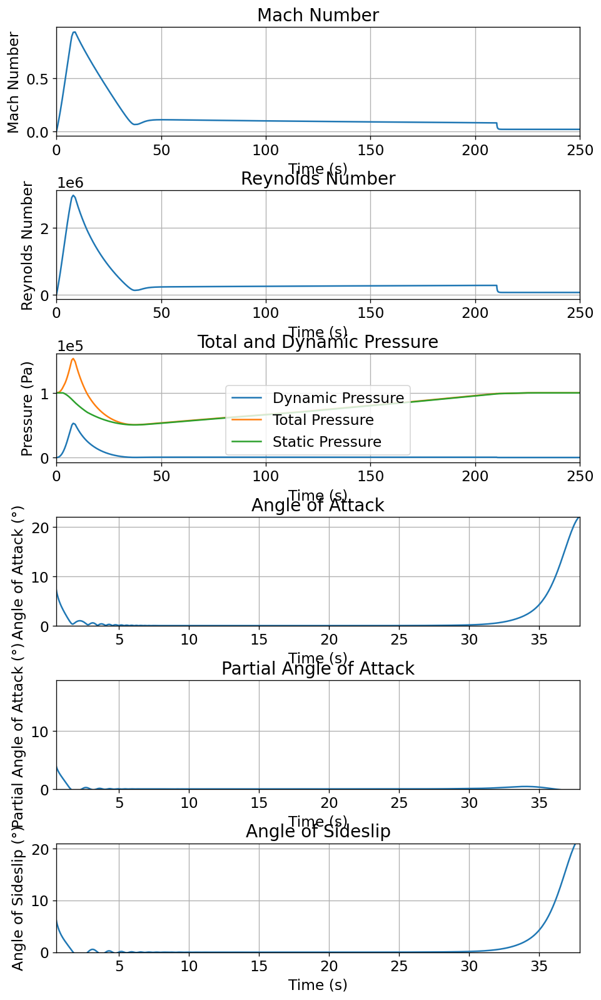



Trajectory Stability and Control Plots



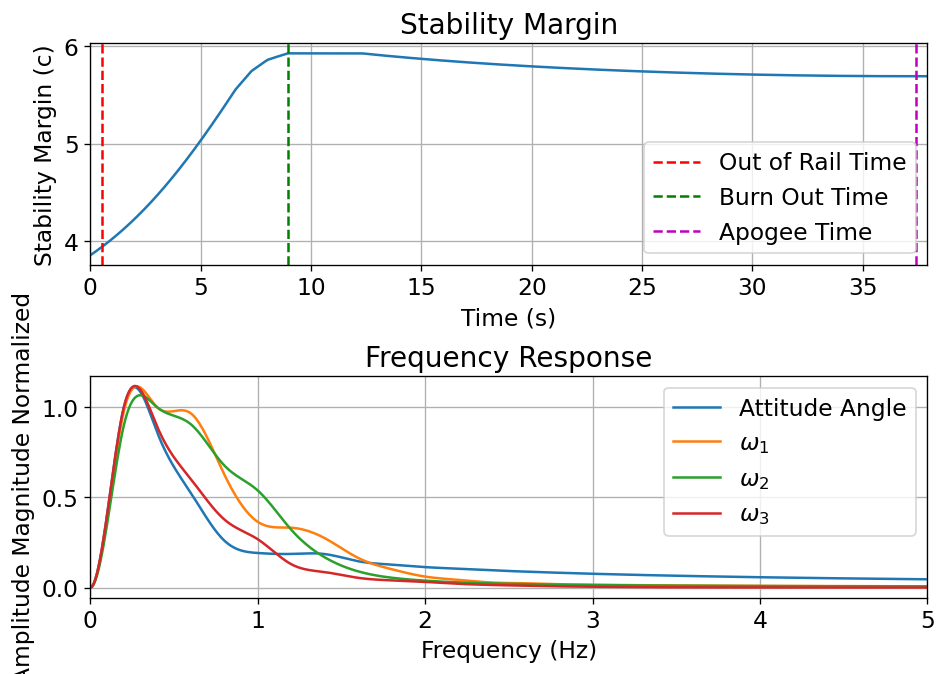



Rocket and Parachute Pressure Plots



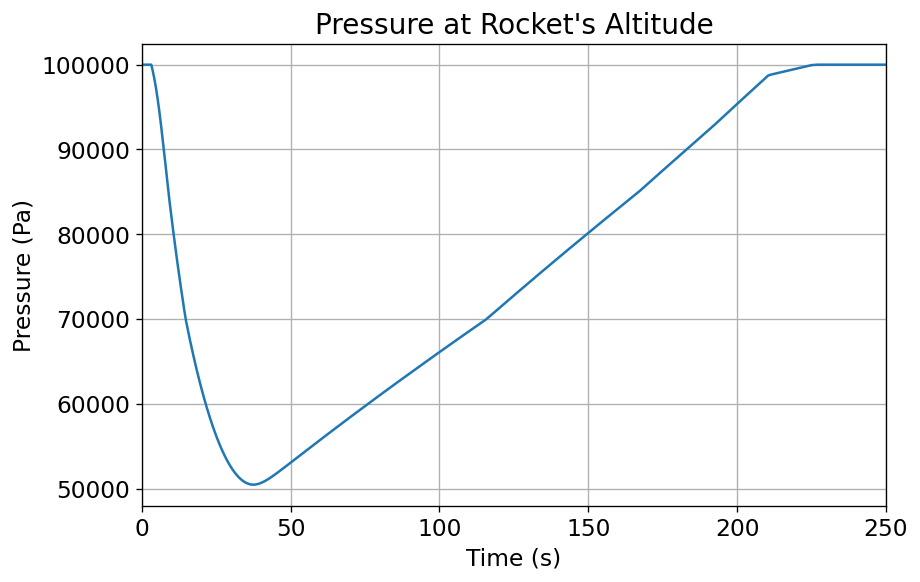


Parachute:  Drogue


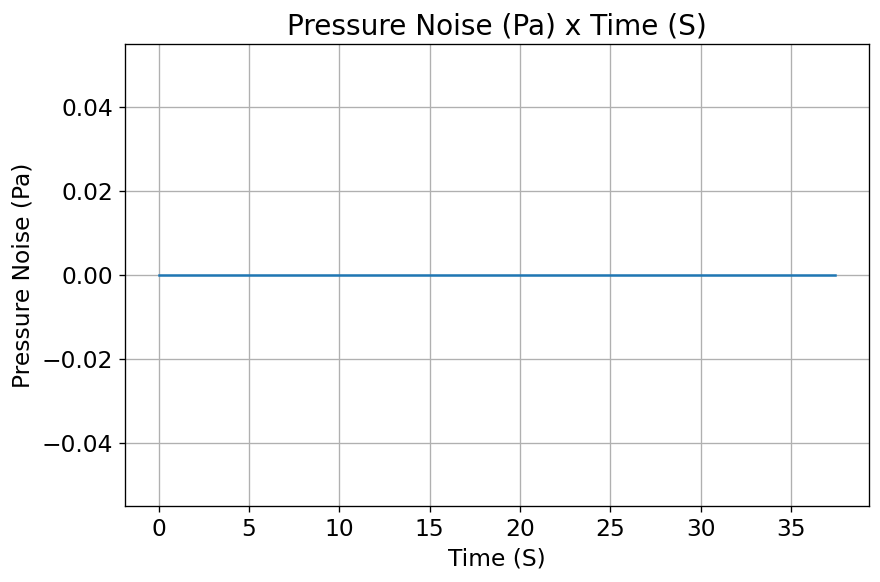

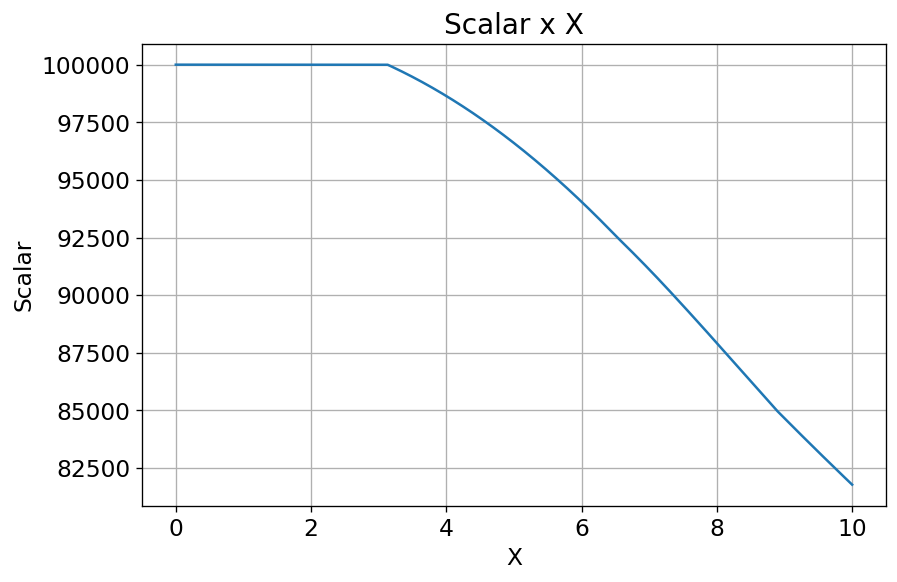

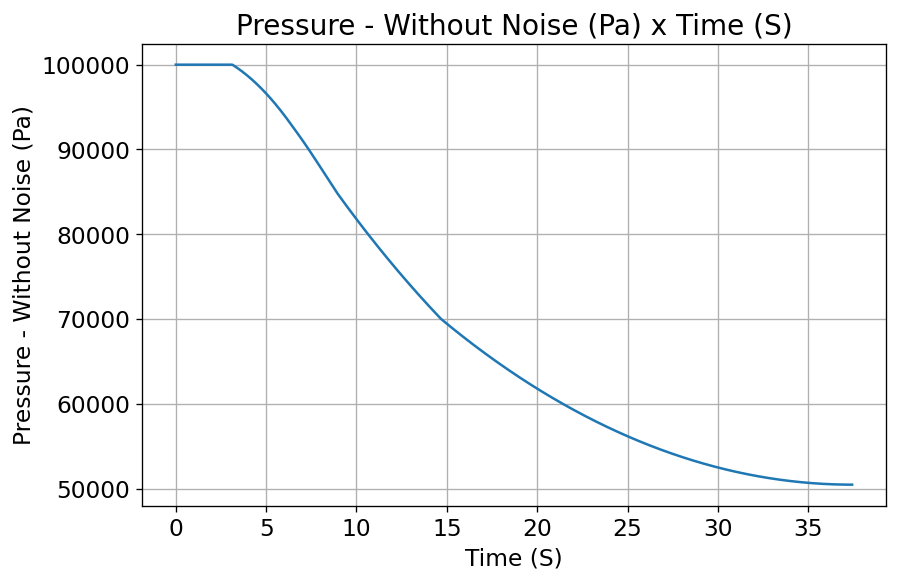


Parachute:  Main


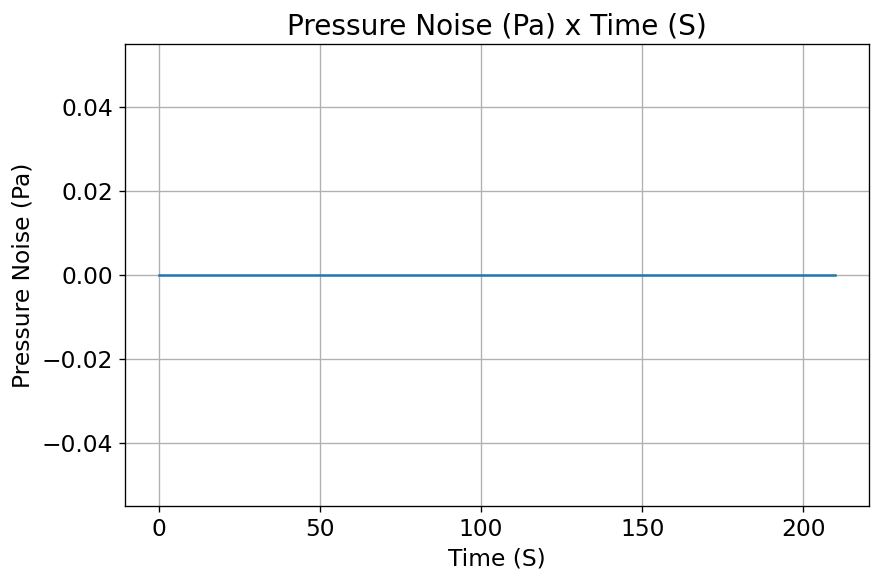

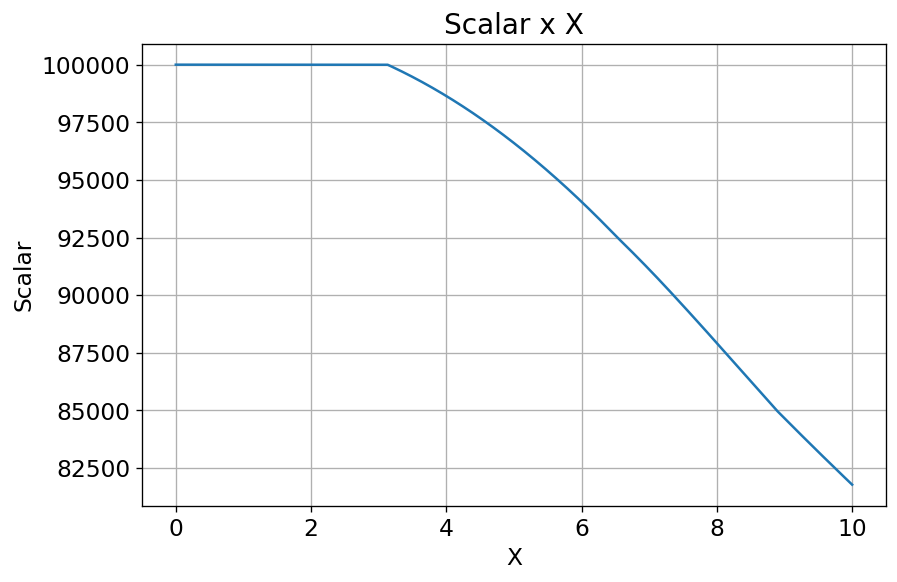

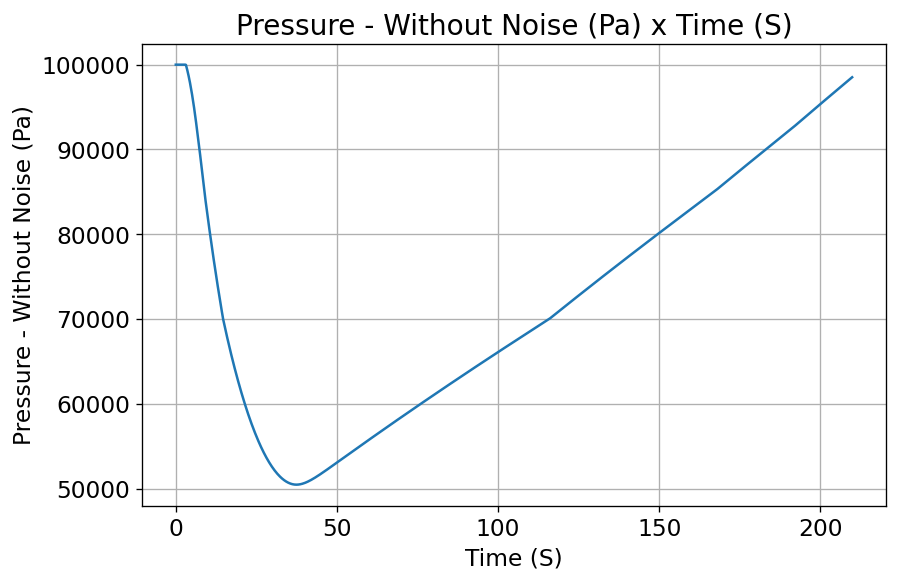

['FlightPhases', 'M1', 'M2', 'M3', 'R1', 'R2', 'R3', 'TimeNodes', '_Flight__cache_sensor_data', '_Flight__calculate_and_save_pressure_signals', '_Flight__calculate_rail_button_forces', '_Flight__evaluate_post_process', '_Flight__init_controllers', '_Flight__init_equations_of_motion', '_Flight__init_flight_state', '_Flight__init_solution_monitors', '_Flight__init_solver_monitors', '_Flight__is_lsoda', '_Flight__post_processed_variables', '_Flight__set_ode_solver', '_Flight__simulate', '_Flight__transform_pressure_signals_lists_to_functions', '__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_controllers', '_solver', 'acceleration', 'aerodynamic_bending_moment', 'aerodynamic_drag', 

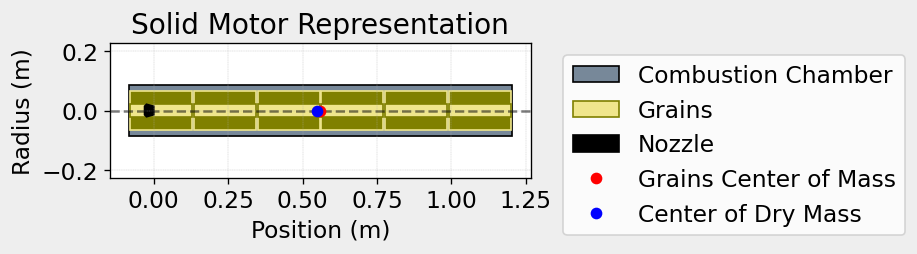

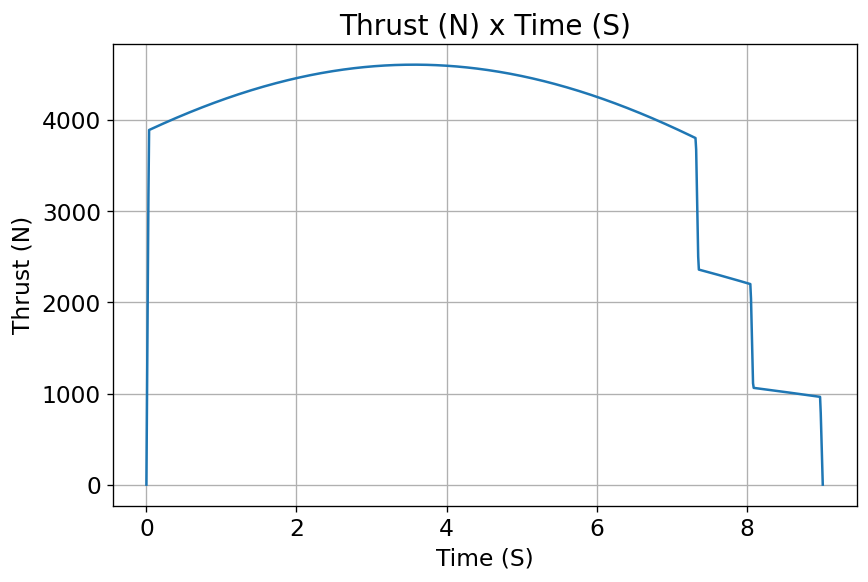

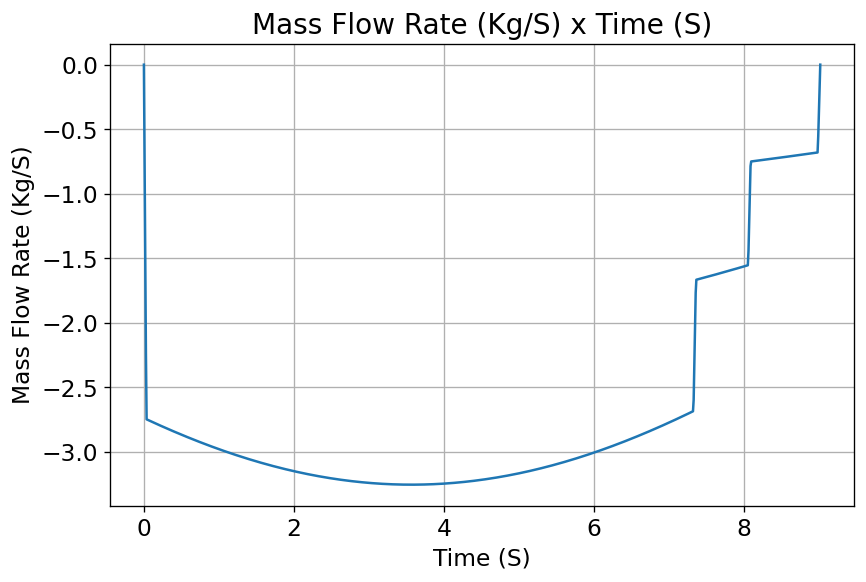

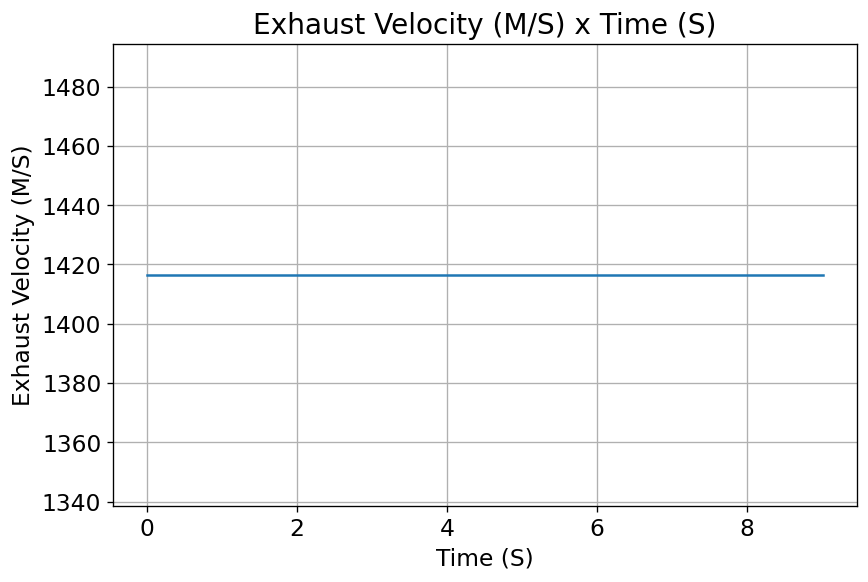

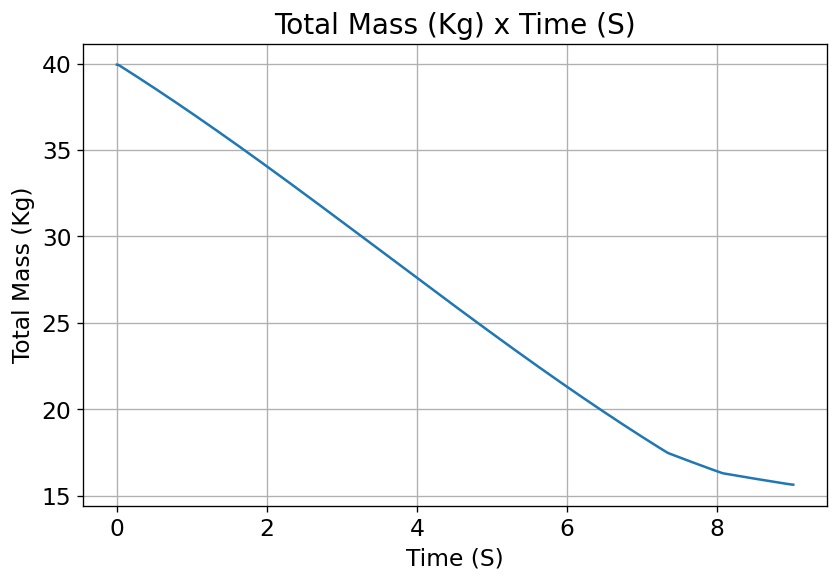

...

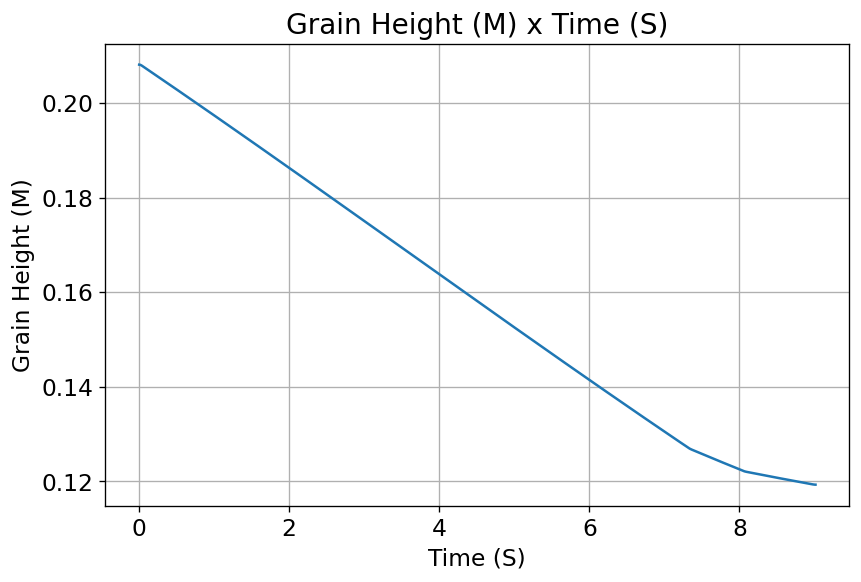

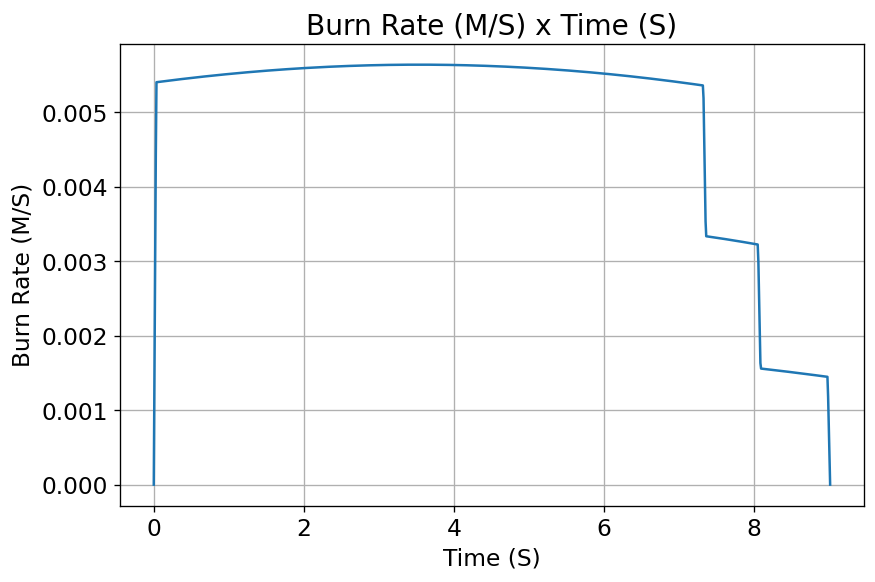

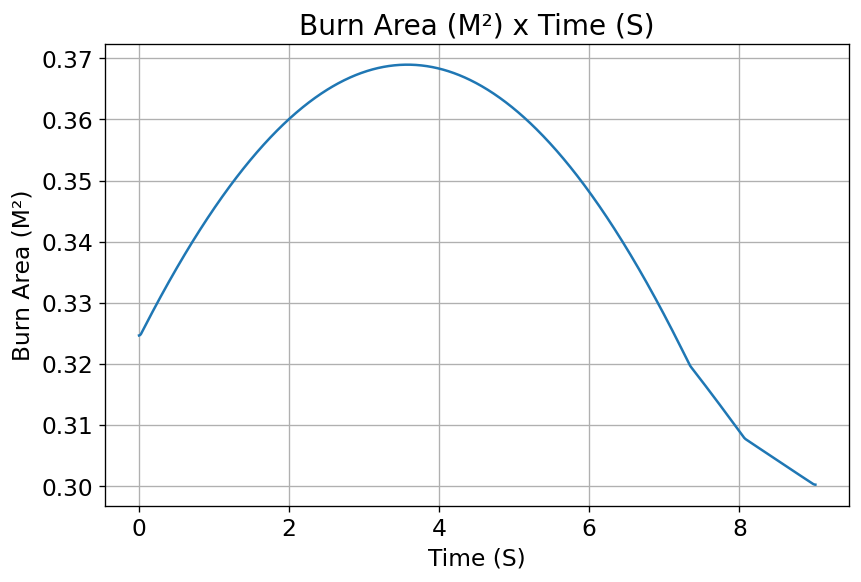

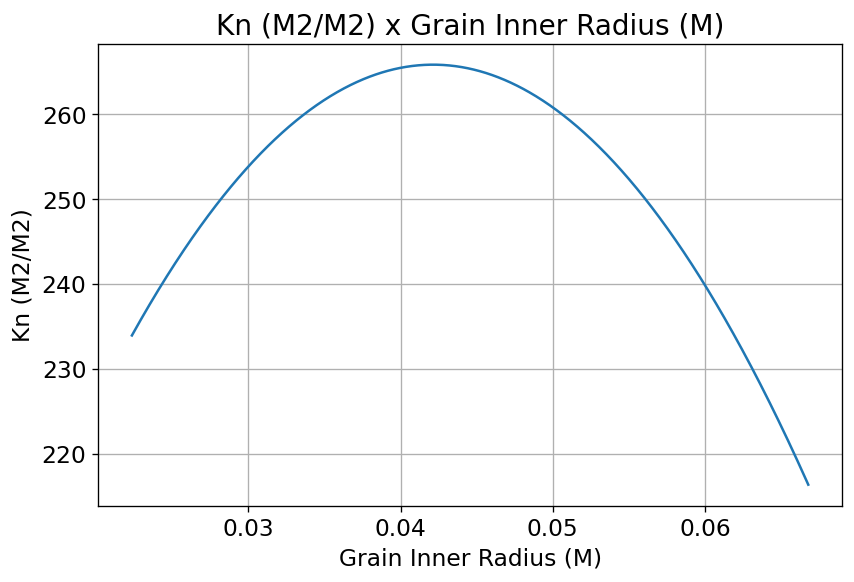

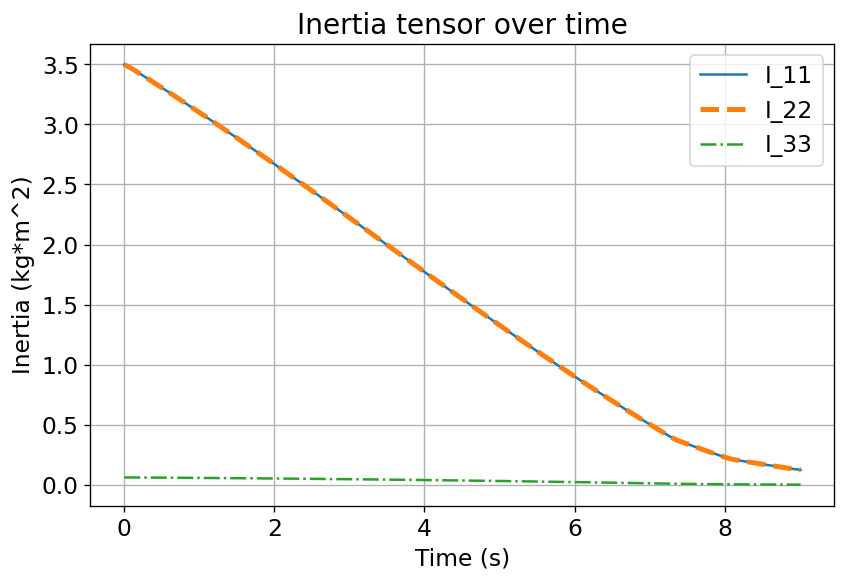

rocketCreated!!!

Inertia Details

Rocket Mass: 54.869 kg (without motor)
Rocket Dry Mass: 70.509 kg (with unloaded motor)
Rocket Loaded Mass: 94.806 kg
Rocket Structural Mass Ratio: 0.744
Rocket Inertia (with unloaded motor) 11: 25.964 kg*m2
Rocket Inertia (with unloaded motor) 22: 75.799 kg*m2
Rocket Inertia (with unloaded motor) 33: 0.002 kg*m2
Rocket Inertia (with unloaded motor) 12: 0.000 kg*m2
Rocket Inertia (with unloaded motor) 13: 0.000 kg*m2
Rocket Inertia (with unloaded motor) 23: 0.000 kg*m2

Geometrical Parameters

Rocket Maximum Radius: 0.07967035681641507 m
Rocket Frontal Area: 0.019941 m2

Rocket Distances
Rocket Center of Dry Mass - Center of Mass without Motor: 0.322 m
Rocket Center of Dry Mass - Nozzle Exit: 1.680 m
Rocket Center of Dry Mass - Center of Propellant Mass: 1.120 m
Rocket Center of Mass - Rocket Loaded Center of Mass: 0.287 m


Aerodynamics Lift Coefficient Derivatives

Nose Cone Lift Coefficient Derivative: 2.000/rad
Fins Lift Coefficient Derivative: 8.

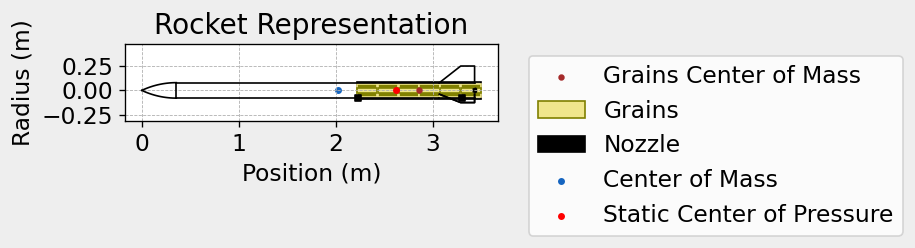


Mass Plots
----------------------------------------


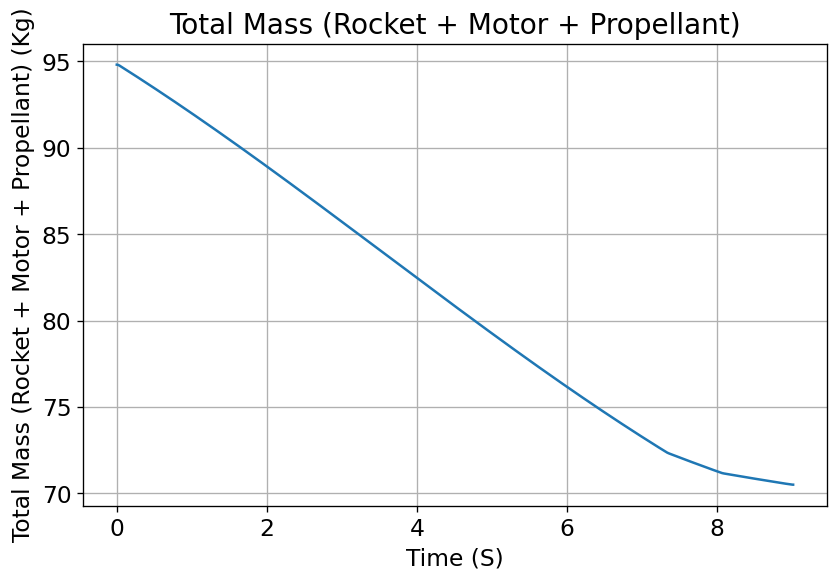

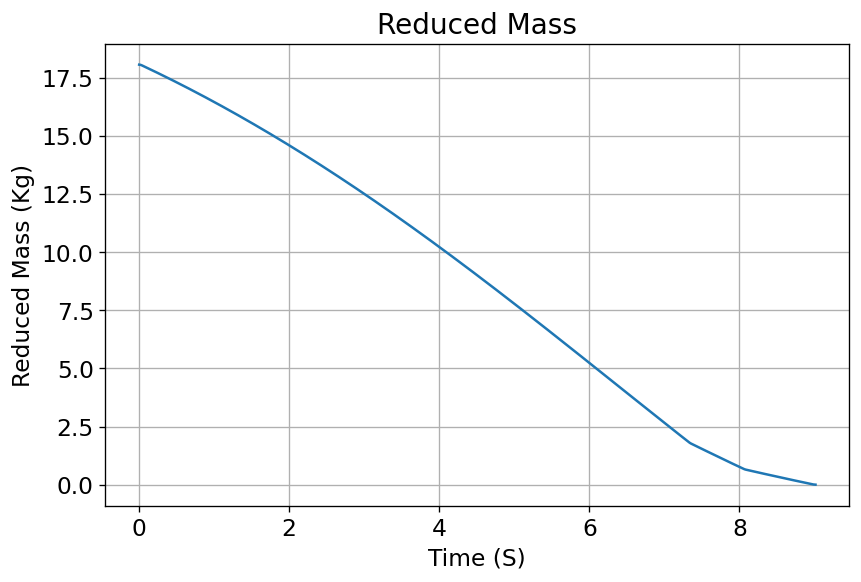


Aerodynamics Plots
----------------------------------------
Drag Plots
--------------------


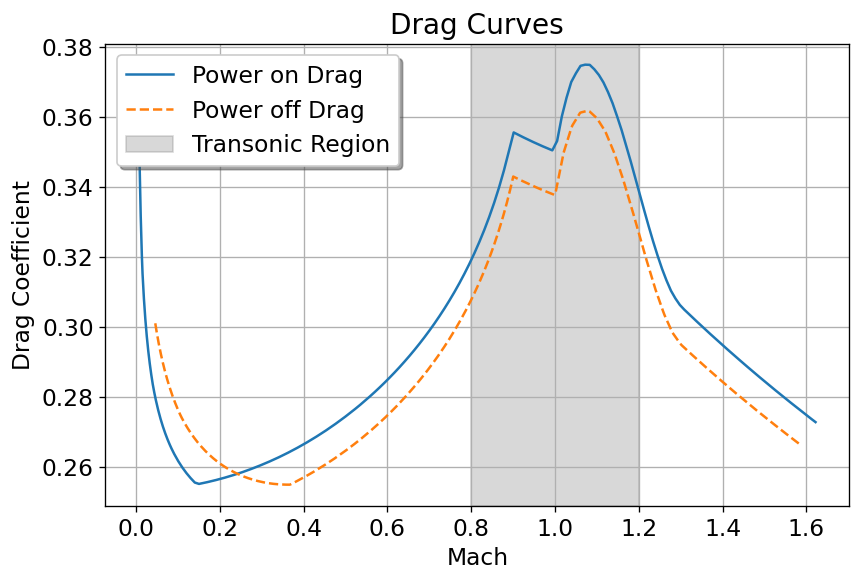


Stability Plots
--------------------


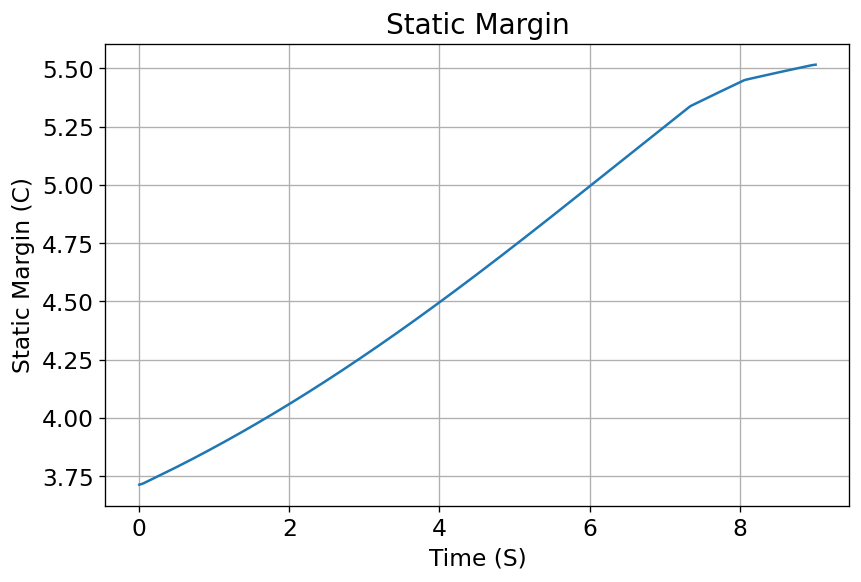

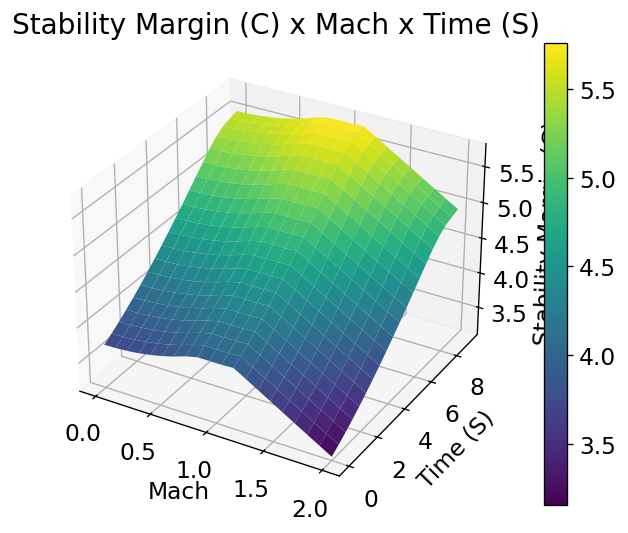


Thrust-to-Weight Plot
----------------------------------------


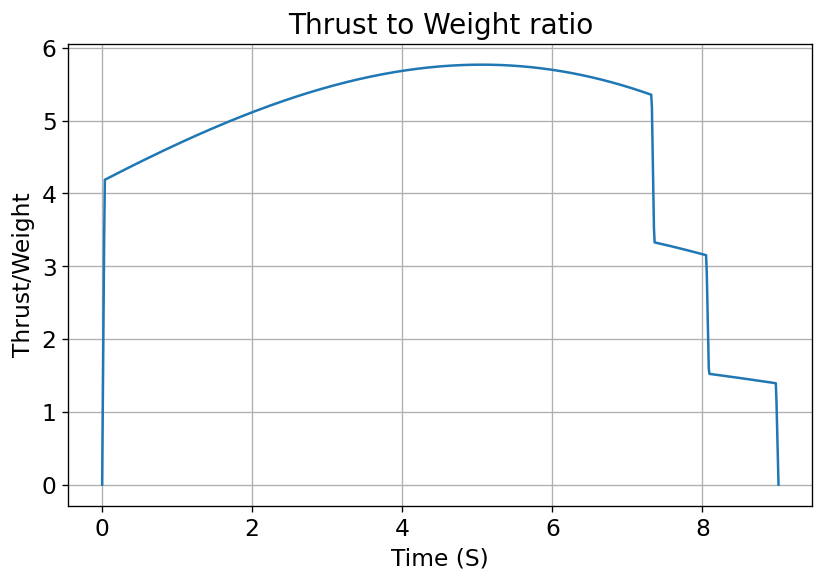

running flight

Initial Conditions

Initial time: 0.000 s
Position - x: 0.00 m | y: 0.00 m | z: 0.00 m
Velocity - Vx: 0.00 m/s | Vy: 0.00 m/s | Vz: 0.00 m/s
Attitude (quaternions) - e0: 0.702 | e1: -0.015 | e2: 0.015 | e3: -0.712
Euler Angles - Spin φ : 0.00° | Nutation θ: -2.47° | Precession ψ: -90.82°
Angular Velocity - ω1: 0.00 rad/s | ω2: 0.00 rad/s | ω3: 0.00 rad/s
Initial Stability Margin: 3.715 c


Surface Wind Conditions

Frontal Surface Wind Speed: -1.07 m/s
Lateral Surface Wind Speed: 1.70 m/s


Launch Rail

Launch Rail Length: 5.1816 m
Launch Rail Inclination: 87.53°
Launch Rail Heading: 90.82°


Rail Departure State

Rail Departure Time: 0.519 s
Rail Departure Velocity: 16.208 m/s
Rail Departure Stability Margin: 3.794 c
Rail Departure Angle of Attack: 7.055°
Rail Departure Thrust-Weight Ratio: 4.439
Rail Departure Reynolds Number: 1.711e+05


Burn out State

Burn out time: 9.013 s
Altitude at burn out: 1576.213 m (ASL) | 1576.213 m (AGL)
Rocket speed at burn out: 313.592 m

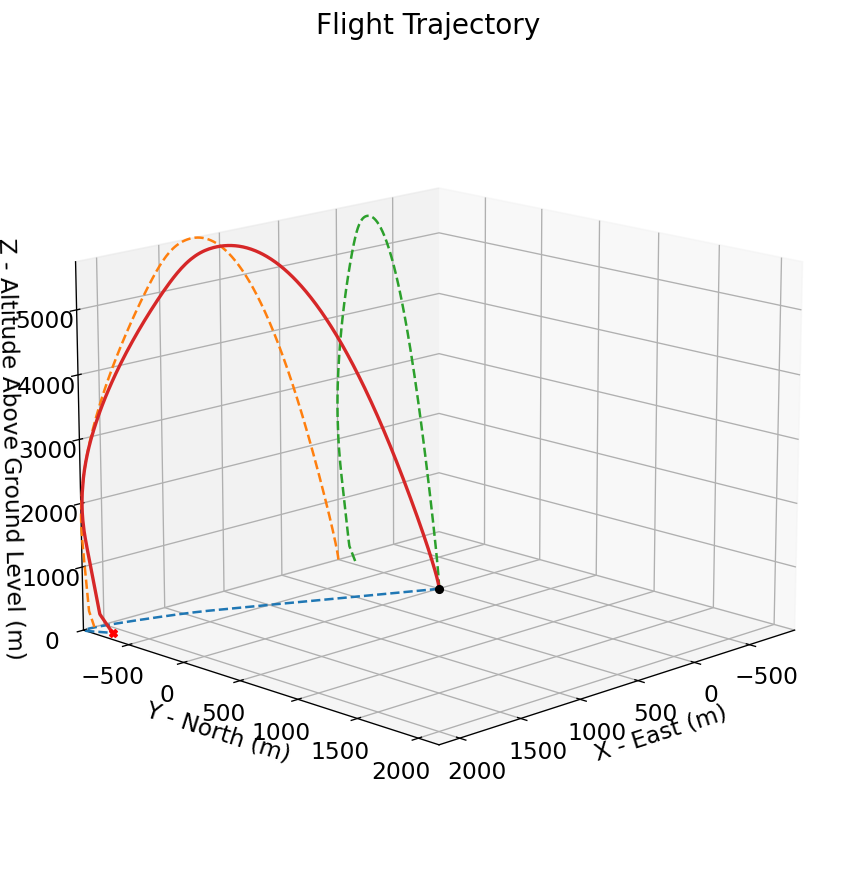



Trajectory Kinematic Plots



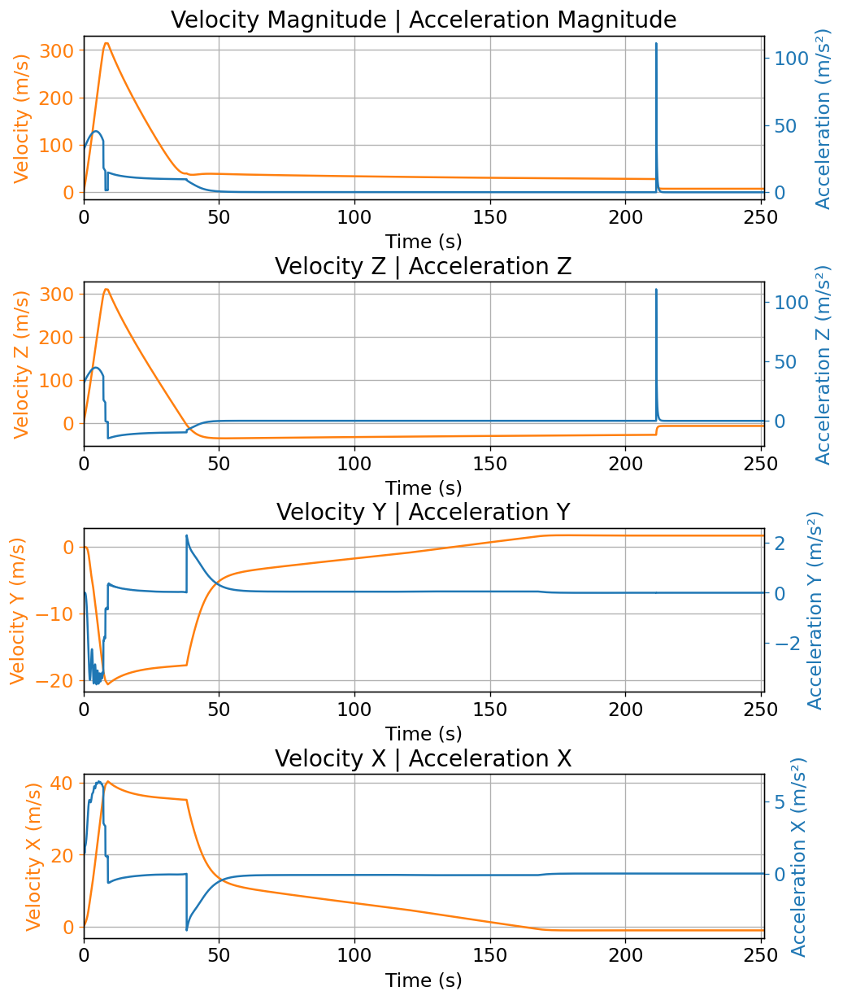



Angular Position Plots



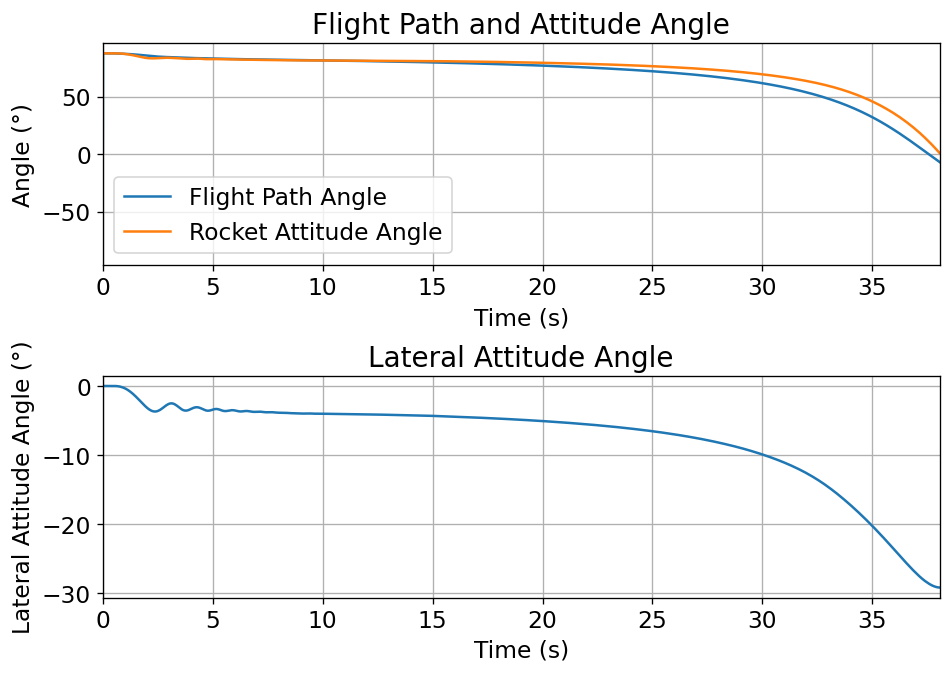



Path, Attitude and Lateral Attitude Angle plots



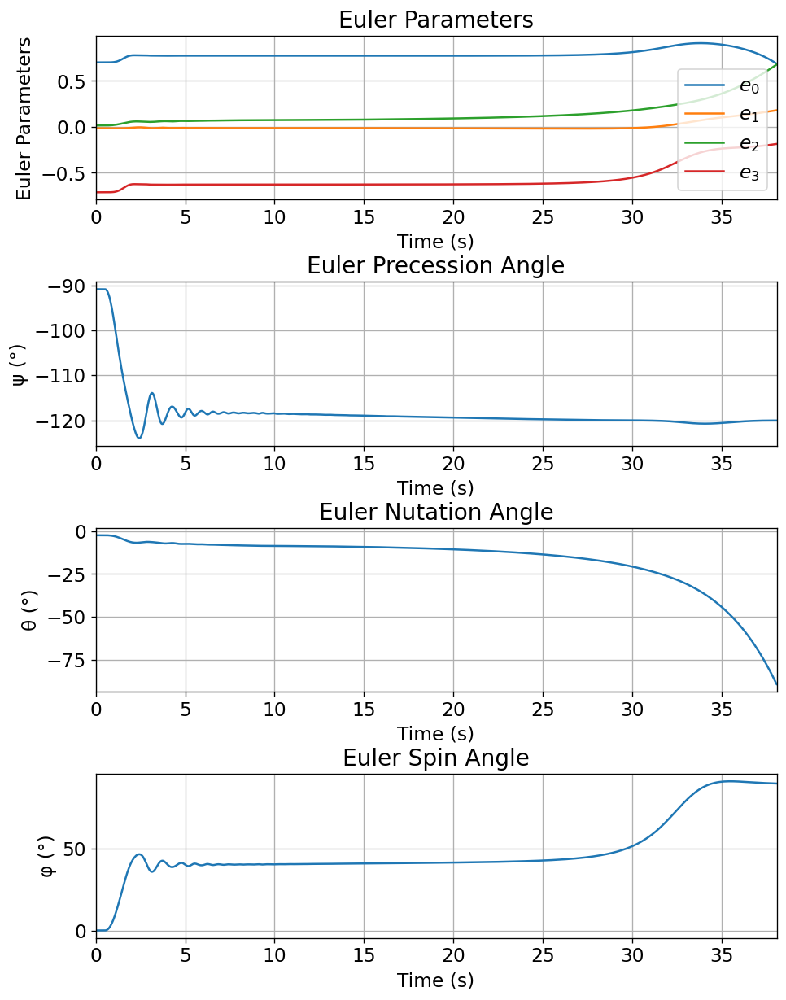



Trajectory Angular Velocity and Acceleration Plots



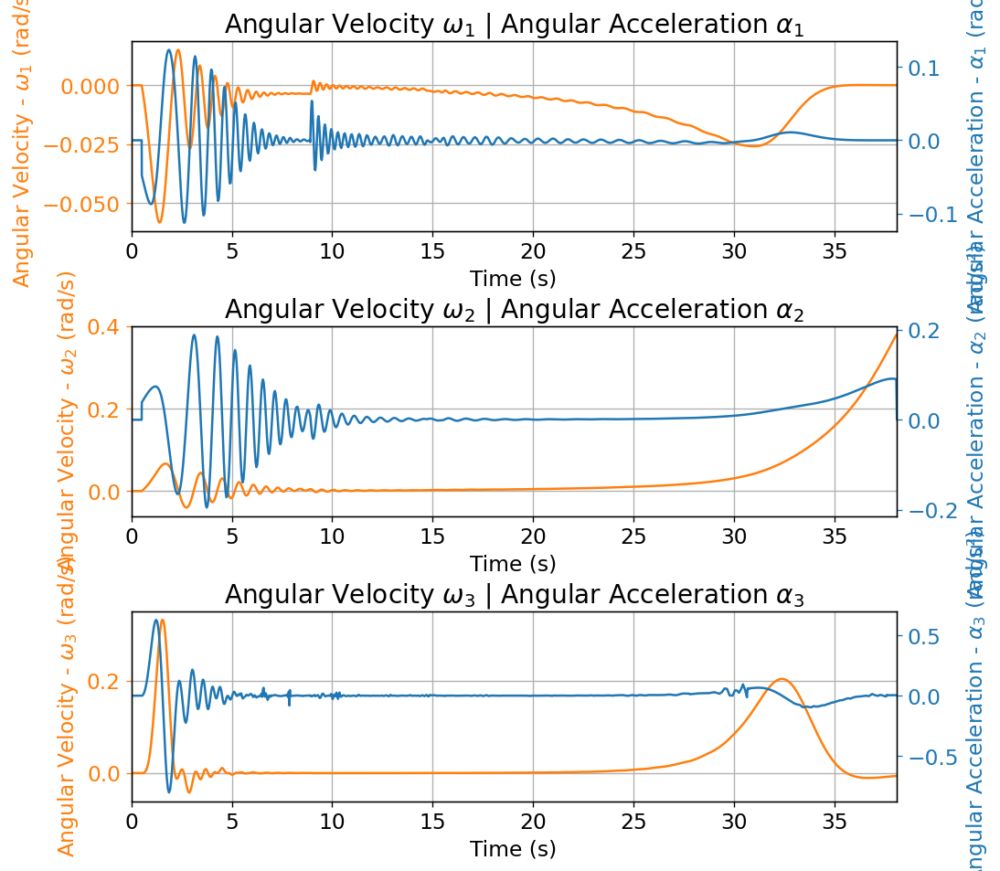



Aerodynamic Forces Plots



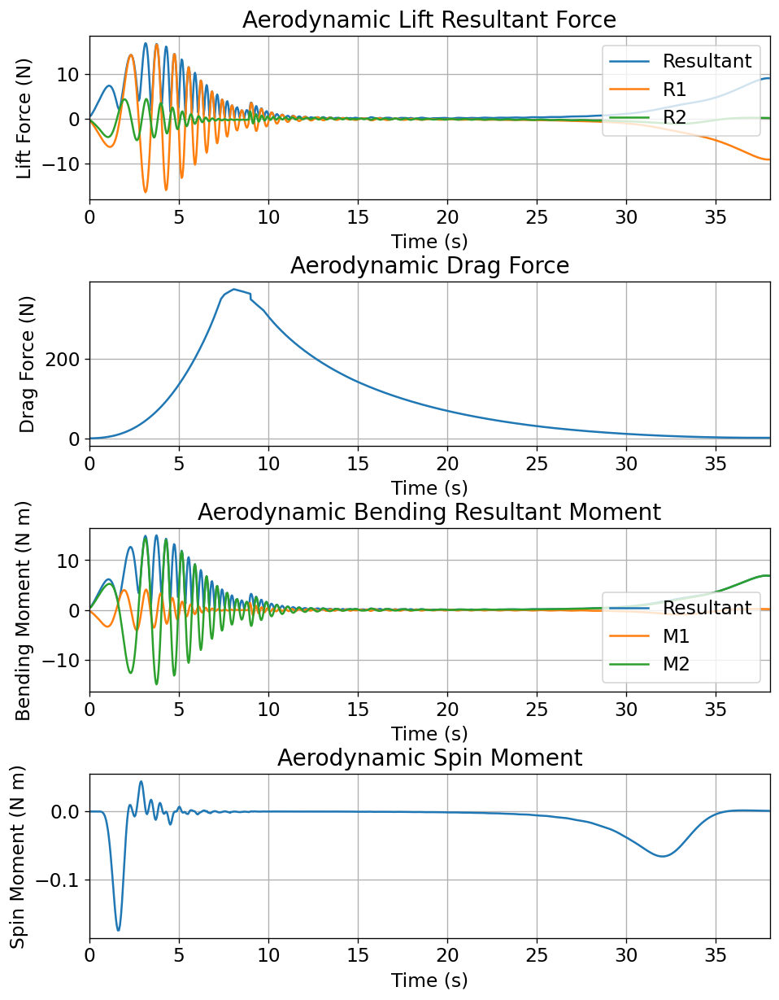



Rail Buttons Forces Plots



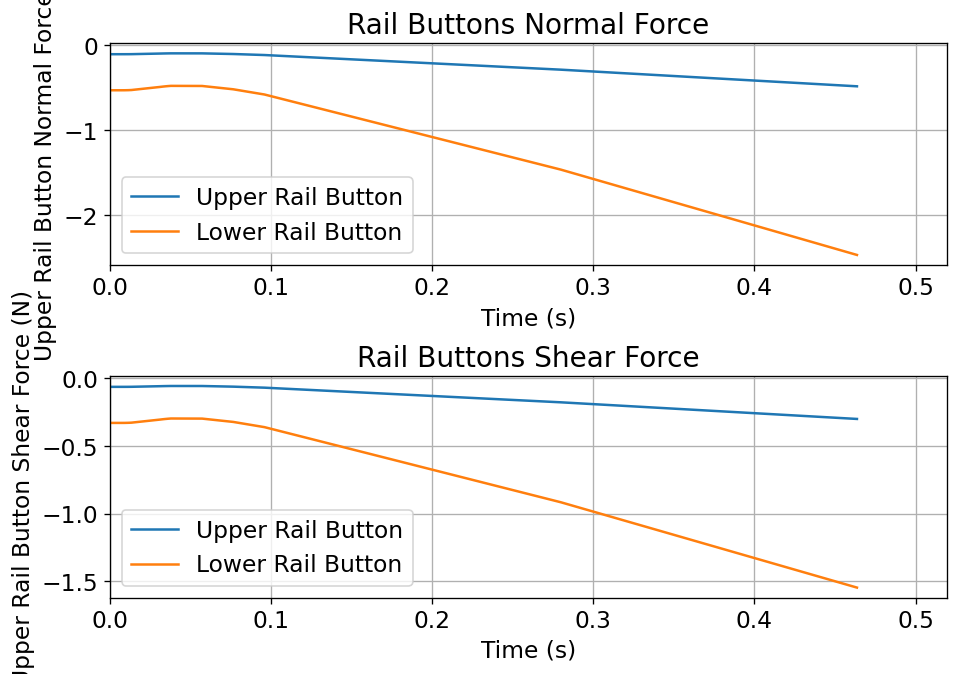



Trajectory Energy Plots



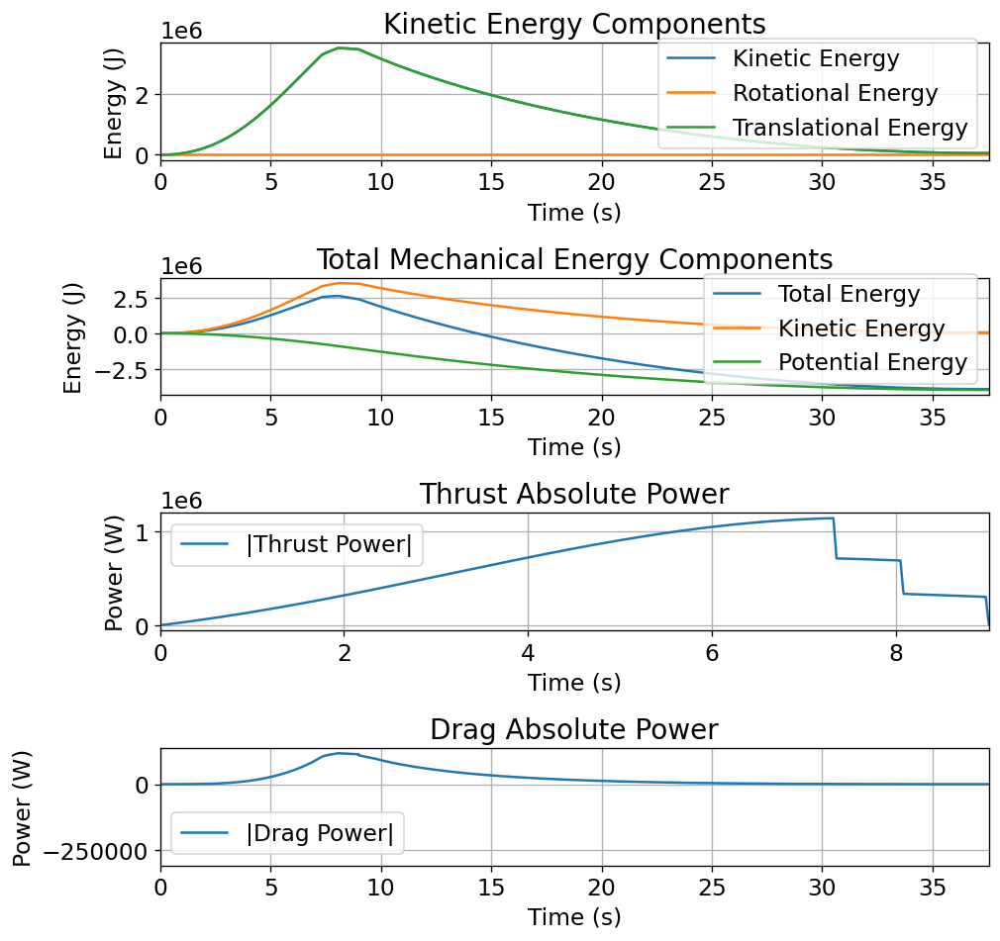



Trajectory Fluid Mechanics Plots



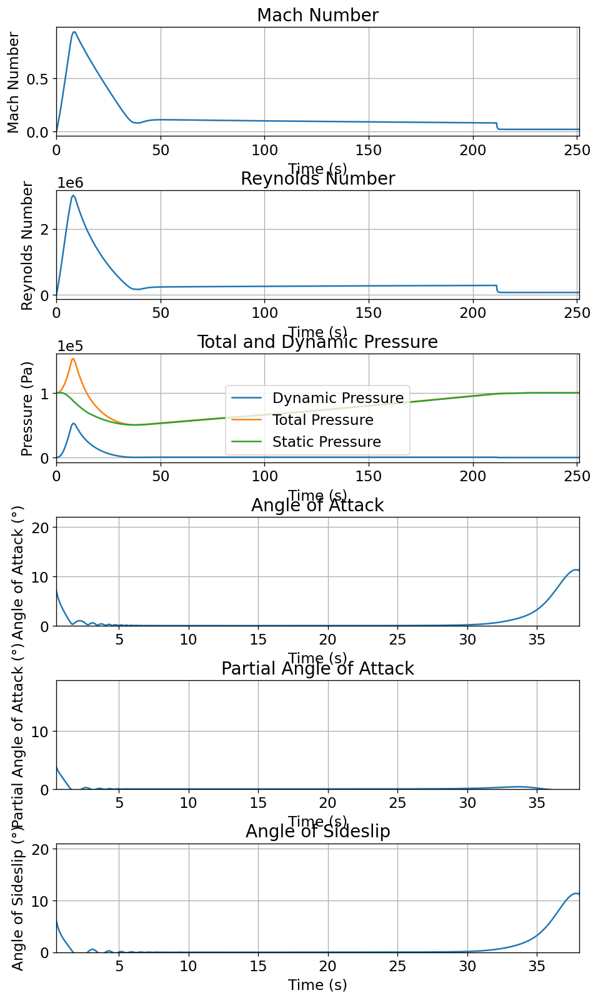



Trajectory Stability and Control Plots



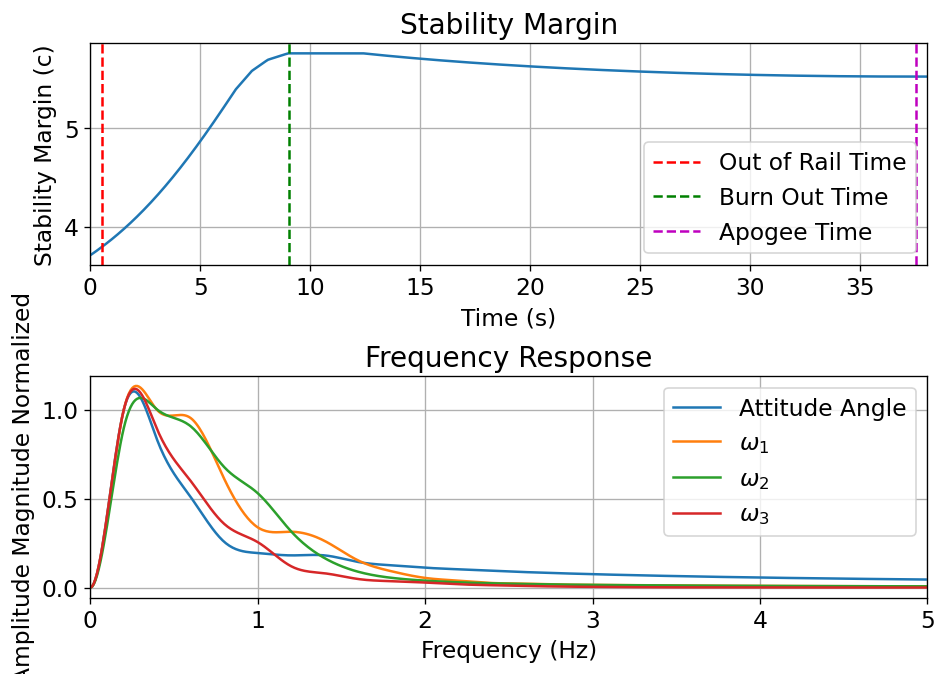



Rocket and Parachute Pressure Plots



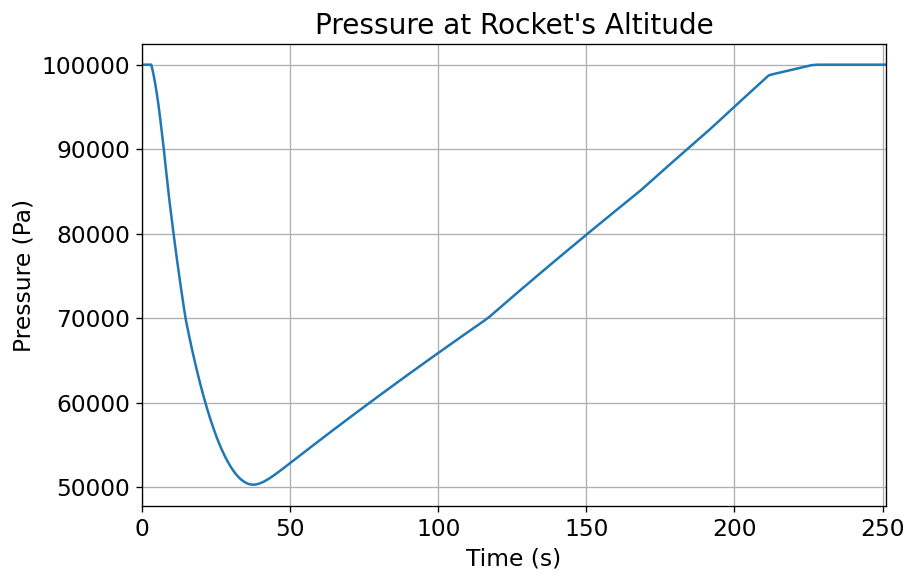


Parachute:  Drogue


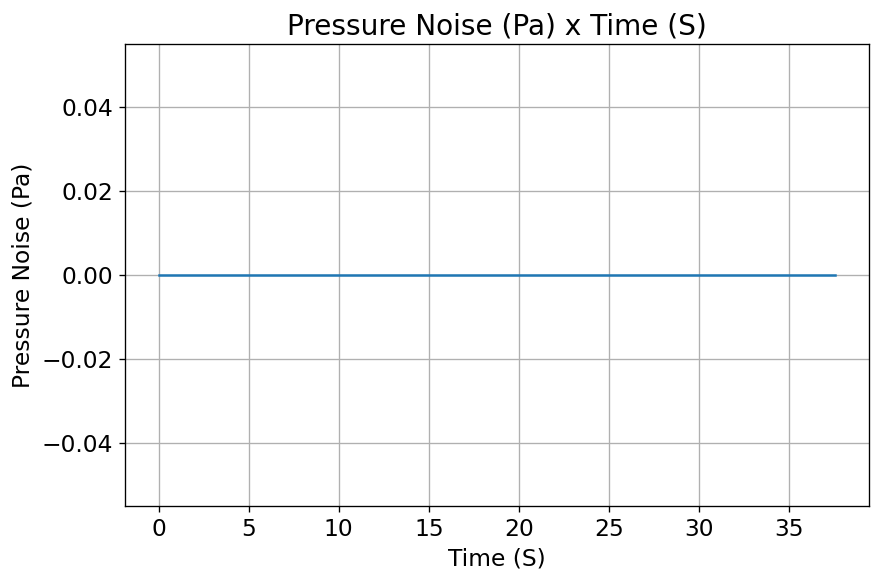

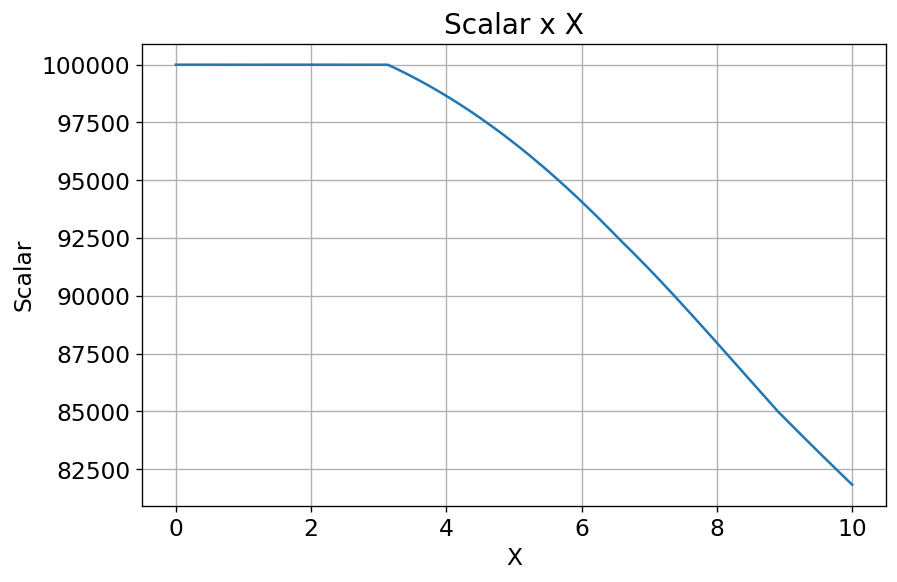

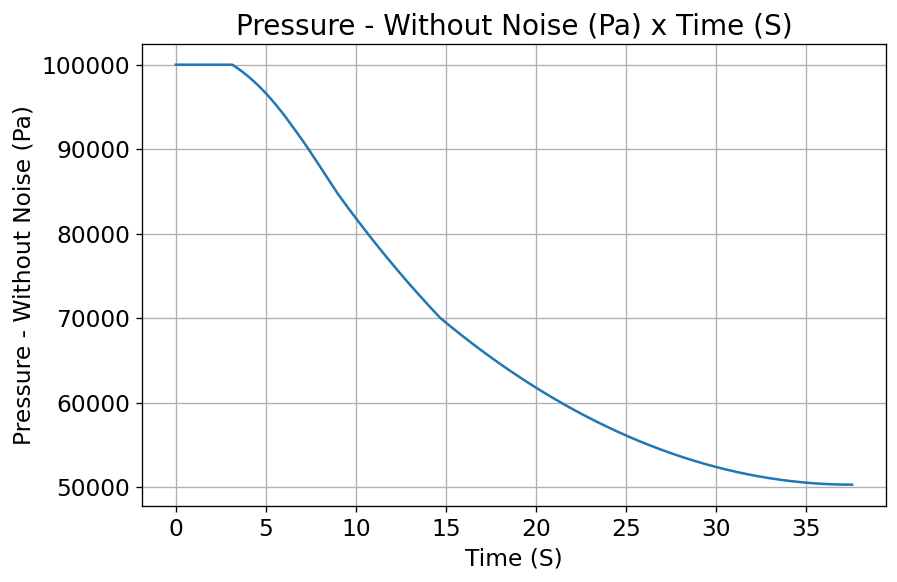


Parachute:  Main


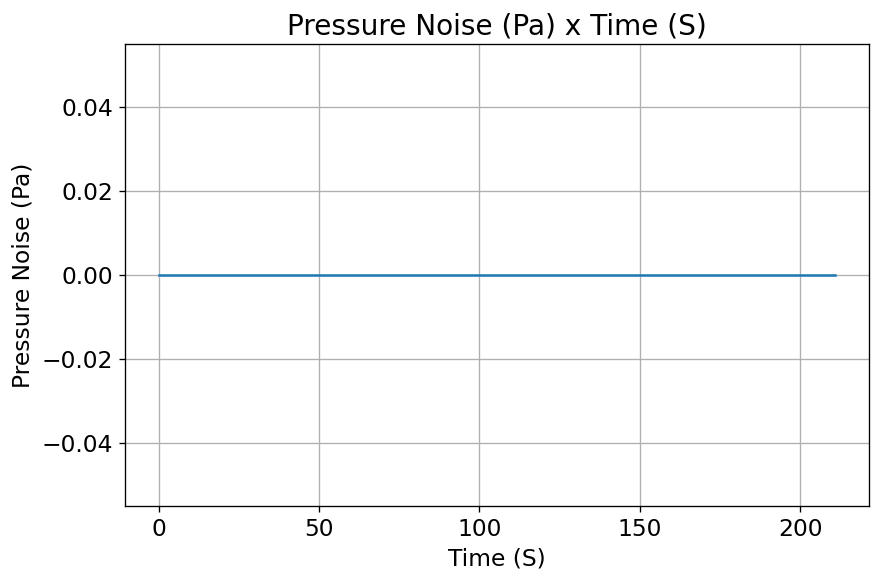

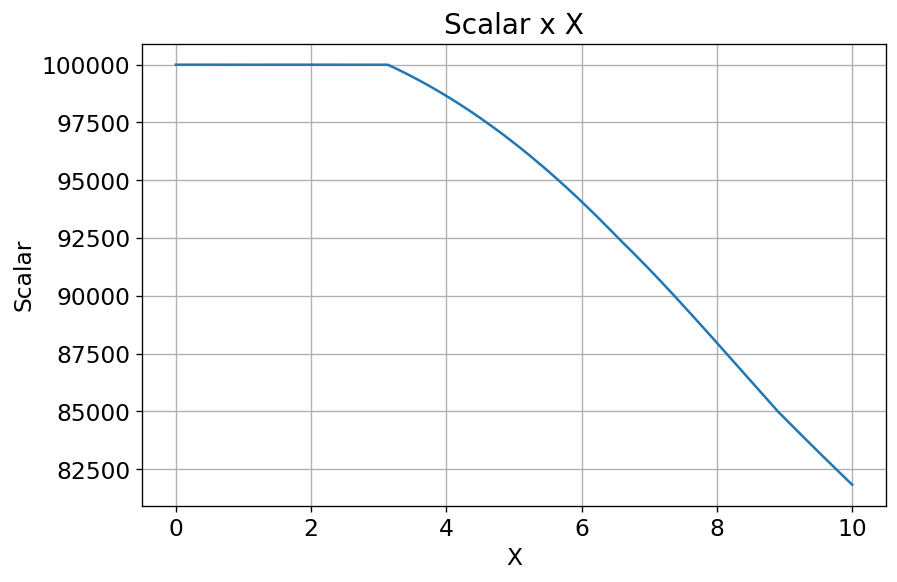

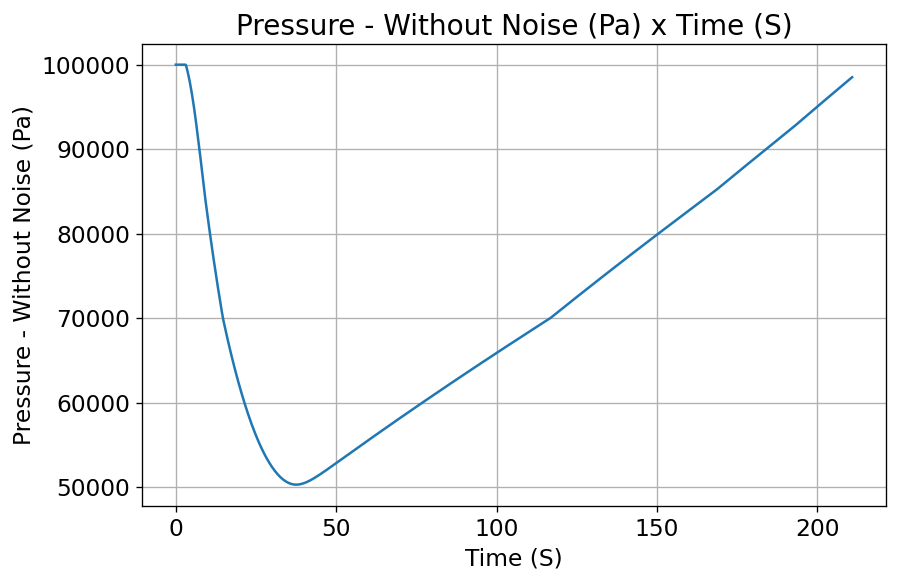

['FlightPhases', 'M1', 'M2', 'M3', 'R1', 'R2', 'R3', 'TimeNodes', '_Flight__cache_sensor_data', '_Flight__calculate_and_save_pressure_signals', '_Flight__calculate_rail_button_forces', '_Flight__evaluate_post_process', '_Flight__init_controllers', '_Flight__init_equations_of_motion', '_Flight__init_flight_state', '_Flight__init_solution_monitors', '_Flight__init_solver_monitors', '_Flight__is_lsoda', '_Flight__post_processed_variables', '_Flight__set_ode_solver', '_Flight__simulate', '_Flight__transform_pressure_signals_lists_to_functions', '__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_controllers', '_solver', 'acceleration', 'aerodynamic_bending_moment', 'aerodynamic_drag', 

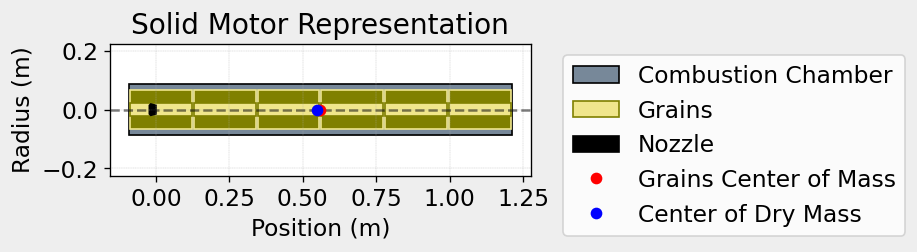

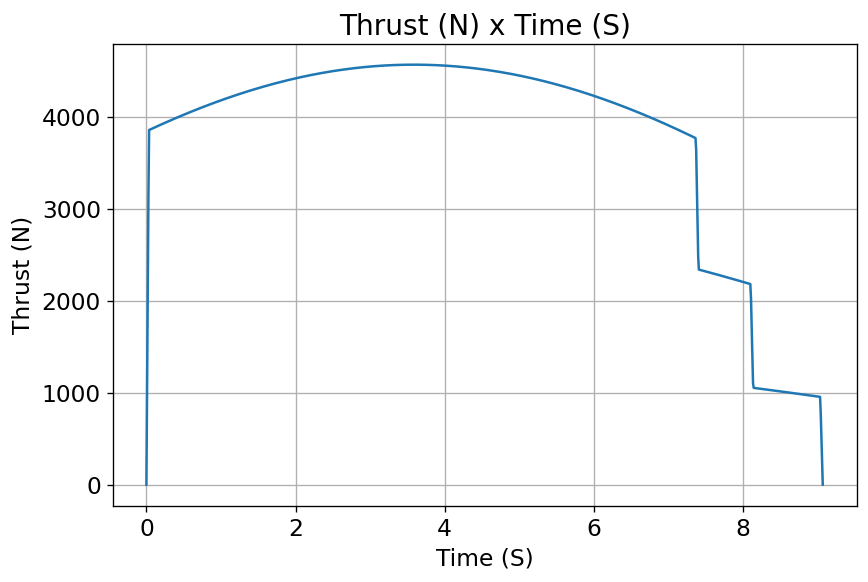

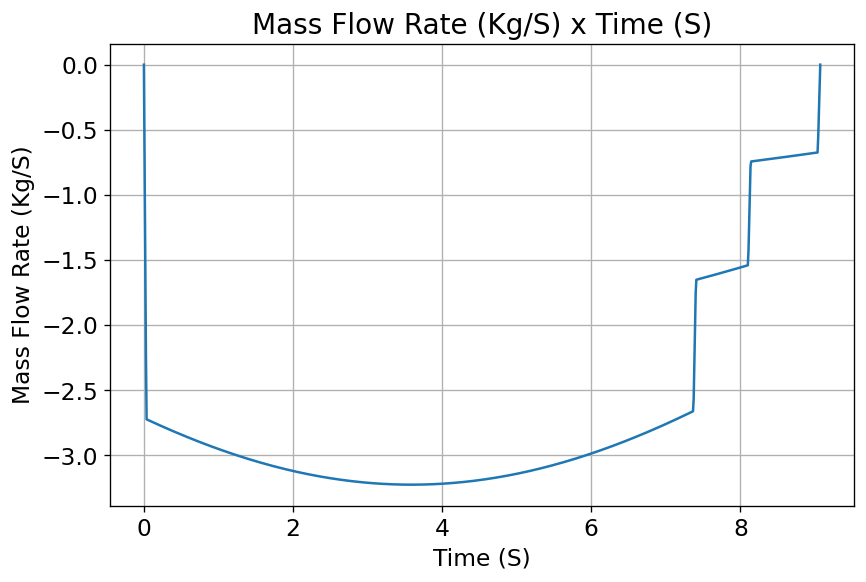

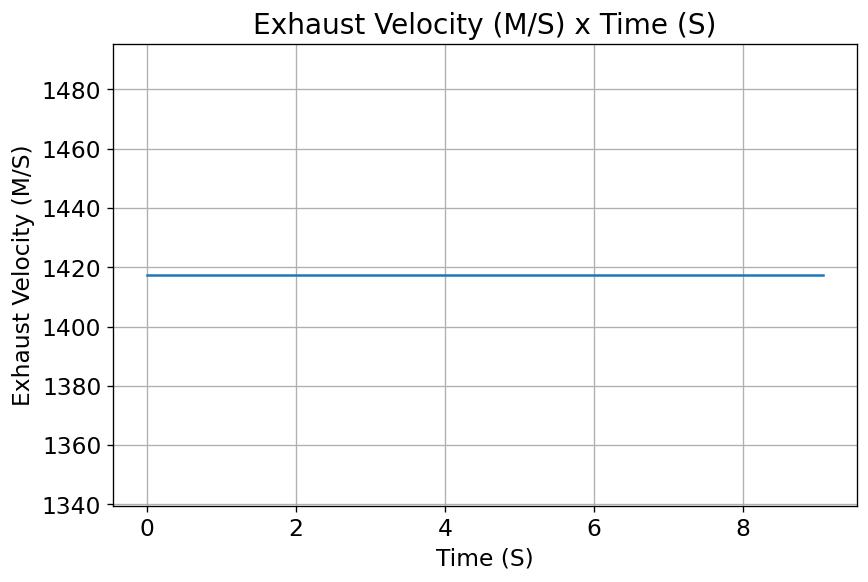

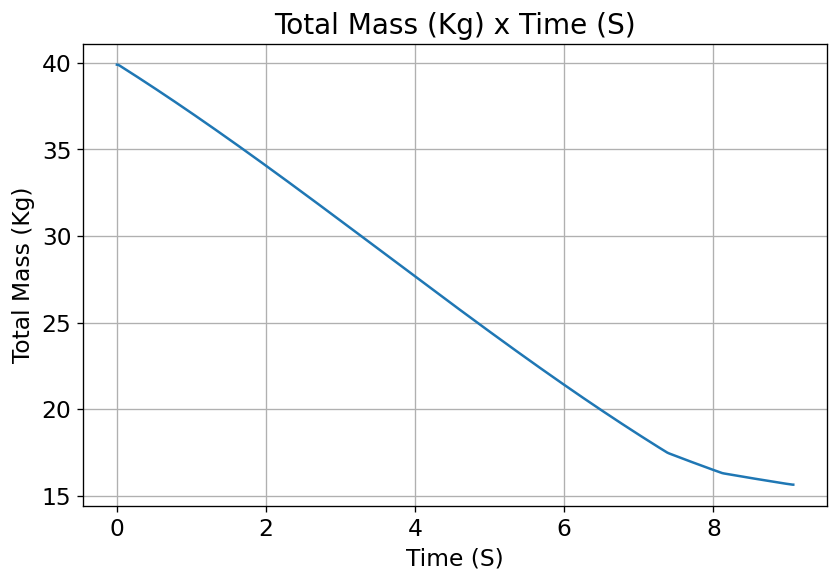

...

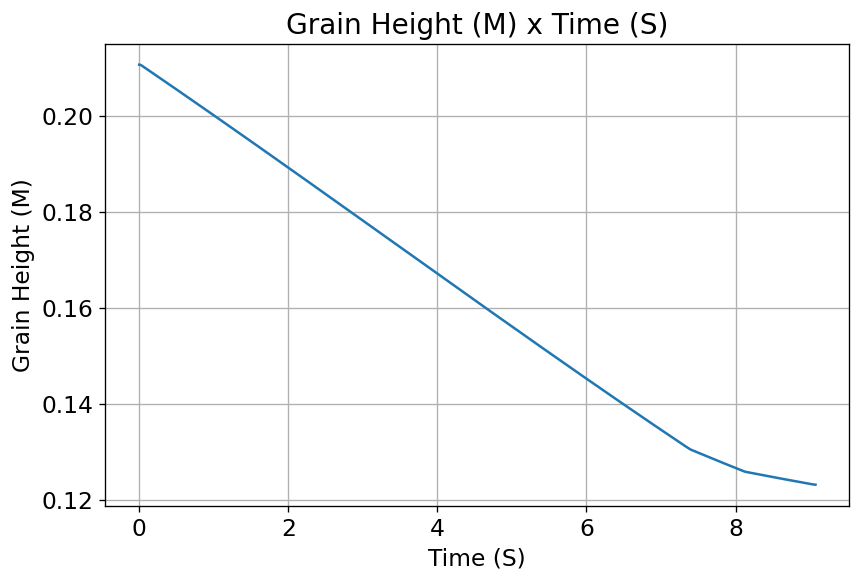

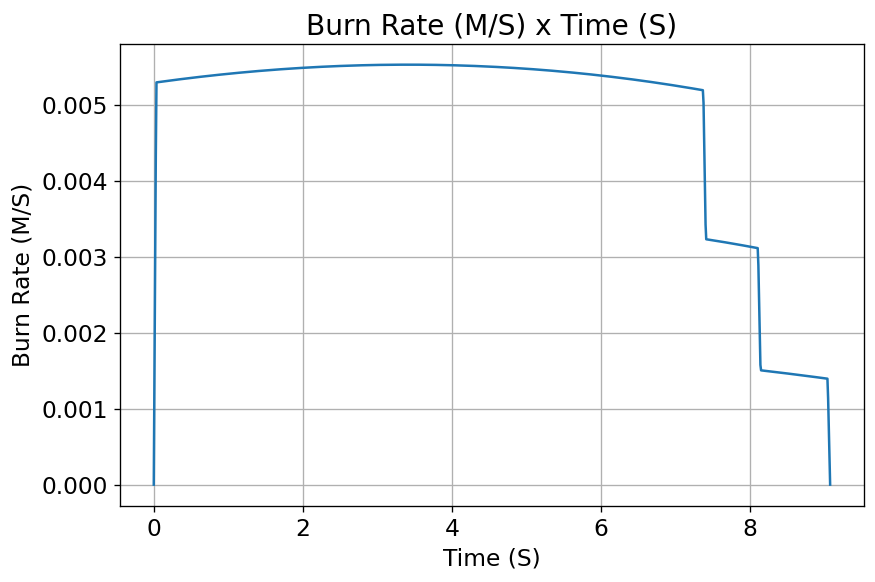

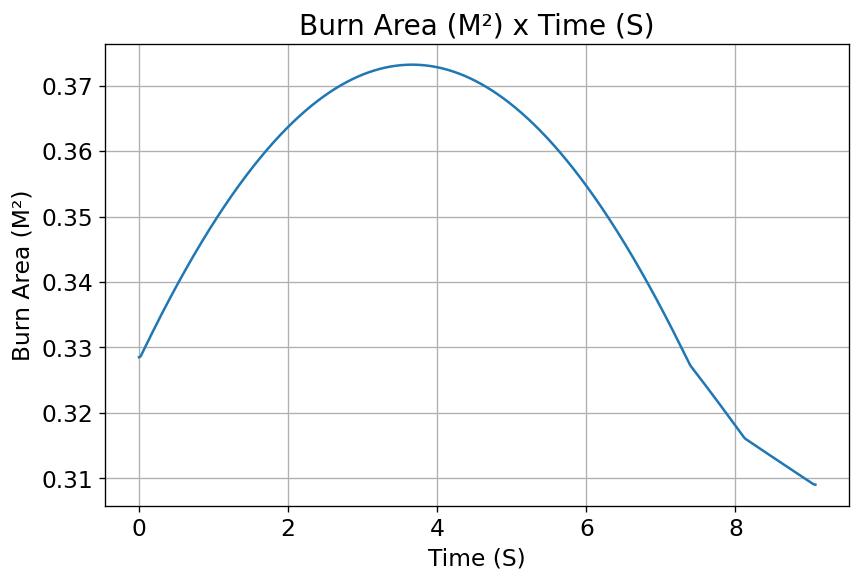

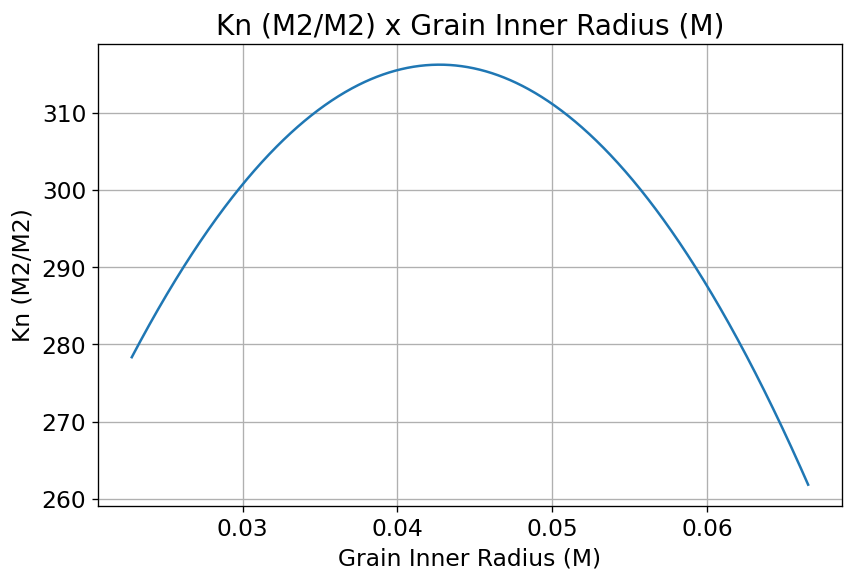

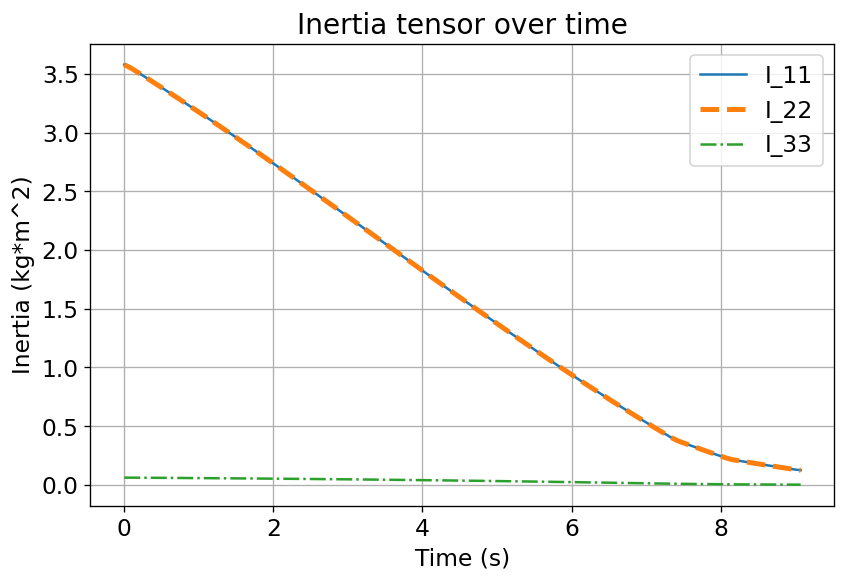

rocketCreated!!!

Inertia Details

Rocket Mass: 54.885 kg (without motor)
Rocket Dry Mass: 70.525 kg (with unloaded motor)
Rocket Loaded Mass: 94.771 kg
Rocket Structural Mass Ratio: 0.744
Rocket Inertia (with unloaded motor) 11: 26.052 kg*m2
Rocket Inertia (with unloaded motor) 22: 75.801 kg*m2
Rocket Inertia (with unloaded motor) 33: 0.002 kg*m2
Rocket Inertia (with unloaded motor) 12: 0.000 kg*m2
Rocket Inertia (with unloaded motor) 13: 0.000 kg*m2
Rocket Inertia (with unloaded motor) 23: 0.000 kg*m2

Geometrical Parameters

Rocket Maximum Radius: 0.07748913214267188 m
Rocket Frontal Area: 0.018864 m2

Rocket Distances
Rocket Center of Dry Mass - Center of Mass without Motor: 0.322 m
Rocket Center of Dry Mass - Nozzle Exit: 1.680 m
Rocket Center of Dry Mass - Center of Propellant Mass: 1.120 m
Rocket Center of Mass - Rocket Loaded Center of Mass: 0.286 m


Aerodynamics Lift Coefficient Derivatives

Nose Cone Lift Coefficient Derivative: 2.000/rad
Fins Lift Coefficient Derivative: 8.

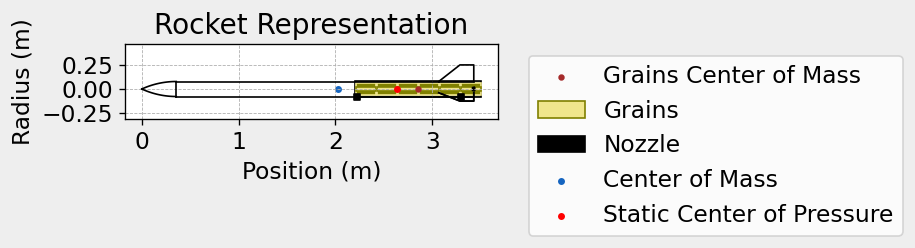


Mass Plots
----------------------------------------


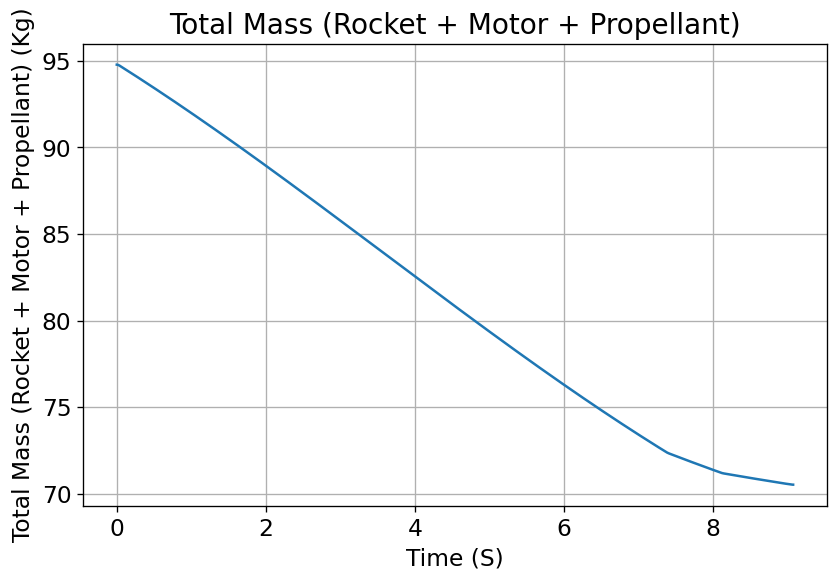

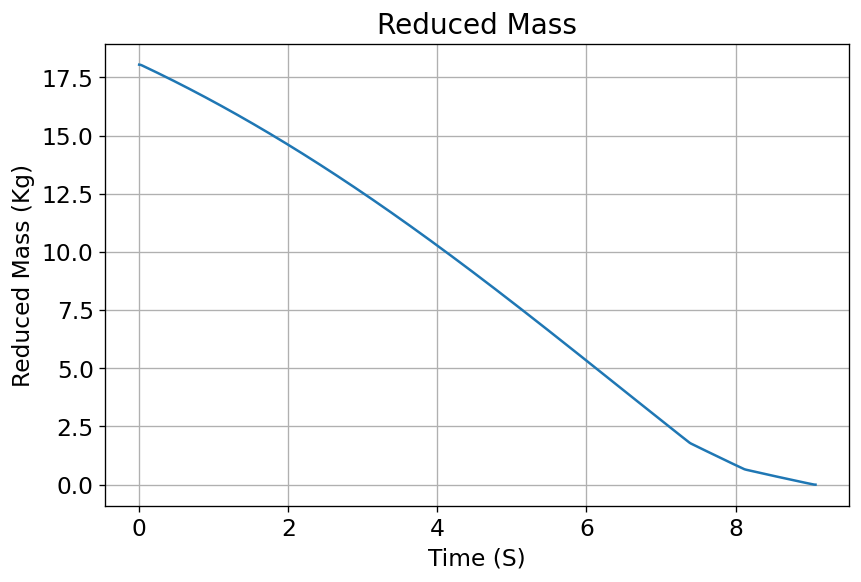


Aerodynamics Plots
----------------------------------------
Drag Plots
--------------------


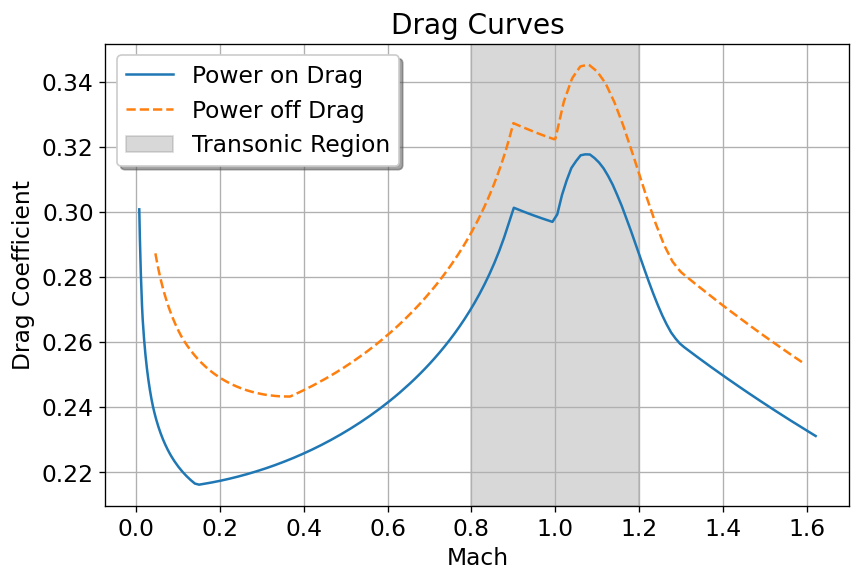


Stability Plots
--------------------


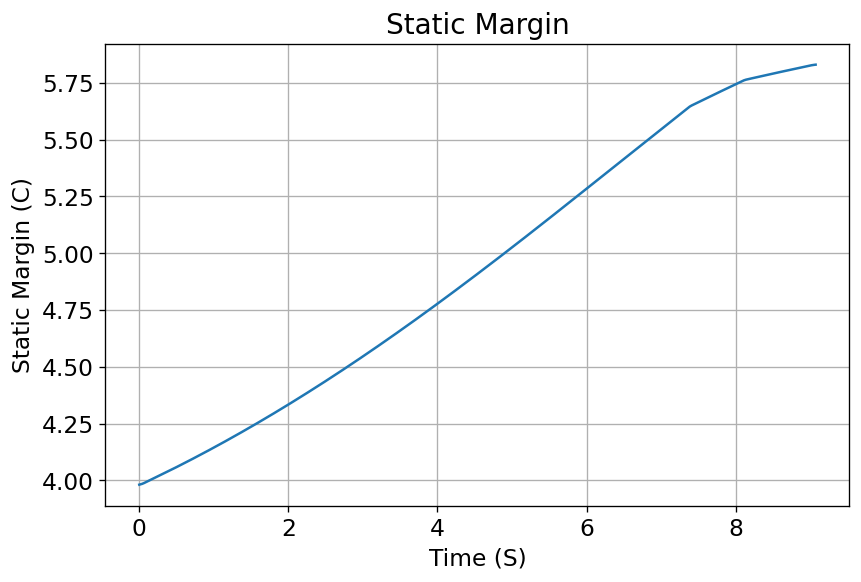

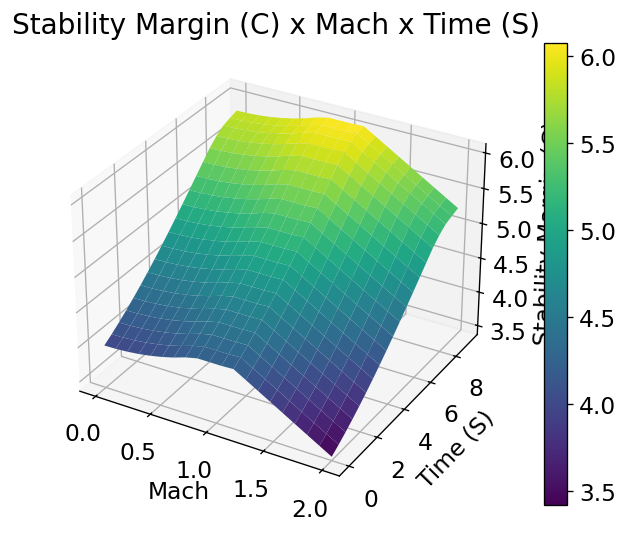


Thrust-to-Weight Plot
----------------------------------------


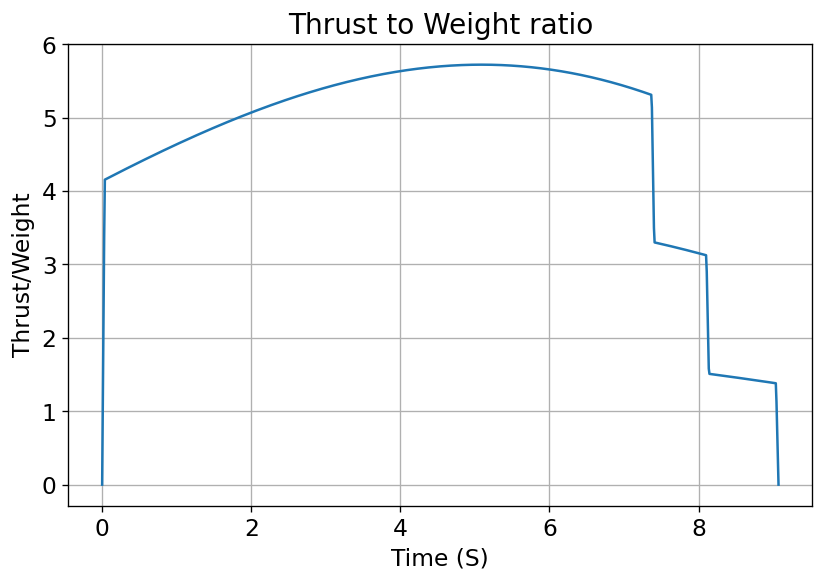

running flight

Initial Conditions

Initial time: 0.000 s
Position - x: 0.00 m | y: 0.00 m | z: 0.00 m
Velocity - Vx: 0.00 m/s | Vy: 0.00 m/s | Vz: 0.00 m/s
Attitude (quaternions) - e0: 0.708 | e1: -0.001 | e2: 0.001 | e3: -0.706
Euler Angles - Spin φ : 0.00° | Nutation θ: -0.13° | Precession ψ: -89.86°
Angular Velocity - ω1: 0.00 rad/s | ω2: 0.00 rad/s | ω3: 0.00 rad/s
Initial Stability Margin: 3.982 c


Surface Wind Conditions

Frontal Surface Wind Speed: -1.04 m/s
Lateral Surface Wind Speed: 1.72 m/s


Launch Rail

Launch Rail Length: 5.1816 m
Launch Rail Inclination: 89.87°
Launch Rail Heading: 89.86°


Rail Departure State

Rail Departure Time: 0.522 s
Rail Departure Velocity: 16.125 m/s
Rail Departure Stability Margin: 4.063 c
Rail Departure Angle of Attack: 7.111°
Rail Departure Thrust-Weight Ratio: 4.405
Rail Departure Reynolds Number: 1.651e+05


Burn out State

Burn out time: 9.072 s
Altitude at burn out: 1596.329 m (ASL) | 1596.329 m (AGL)
Rocket speed at burn out: 315.541 m

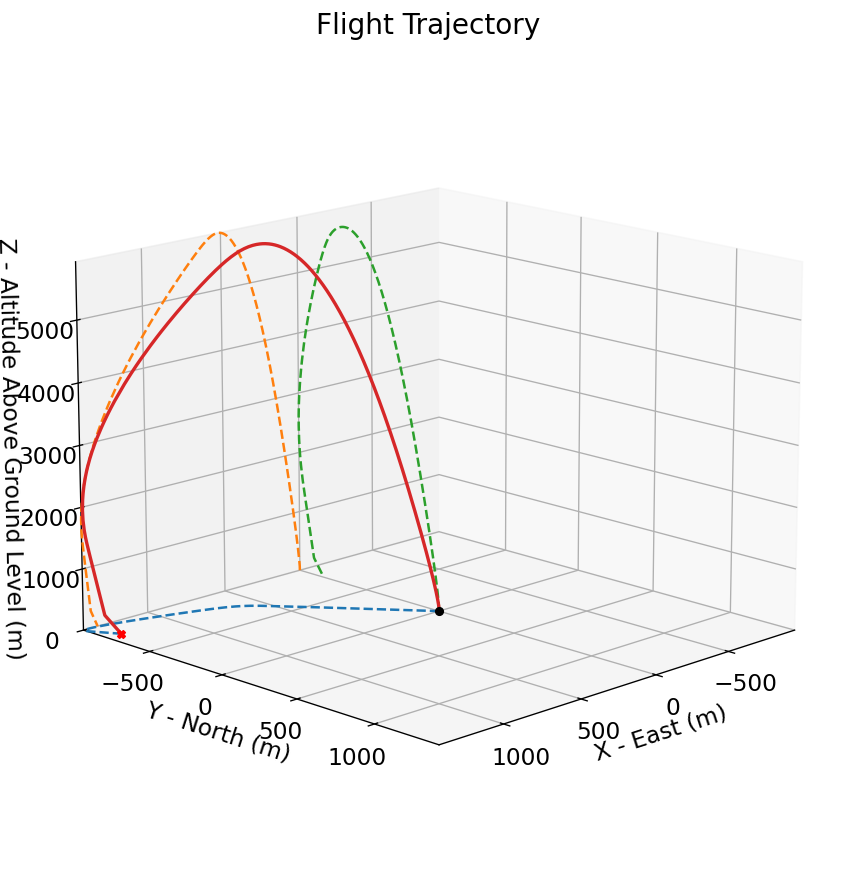



Trajectory Kinematic Plots



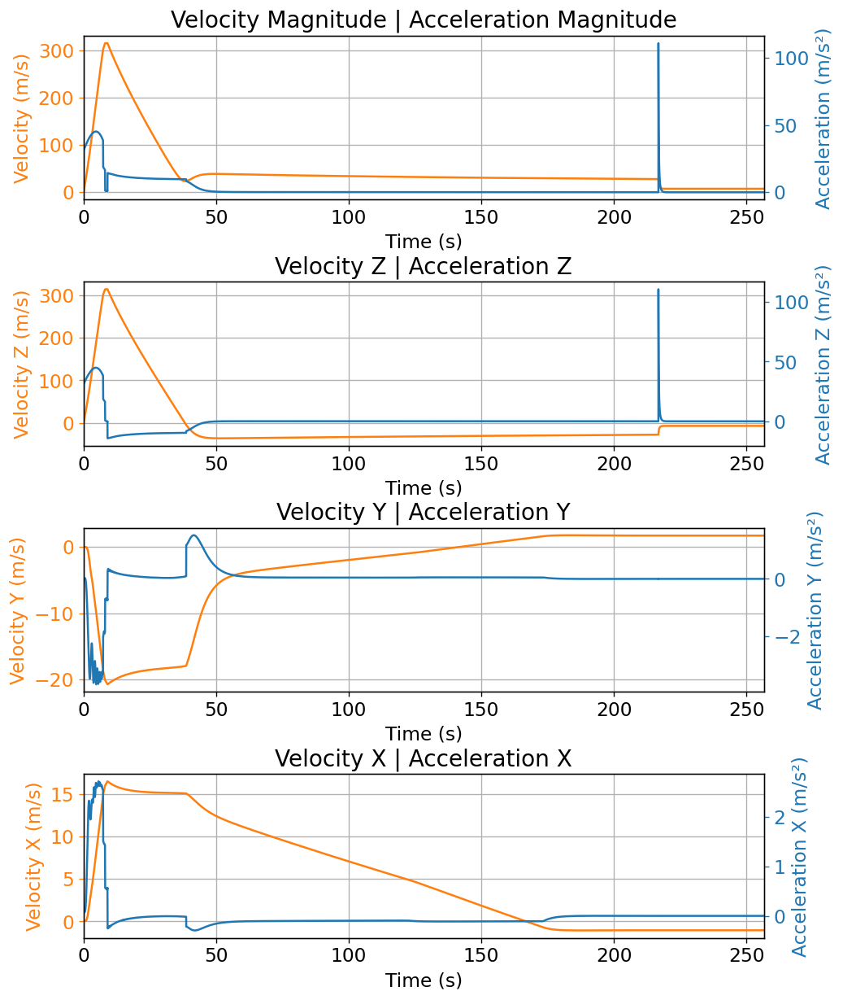



Angular Position Plots



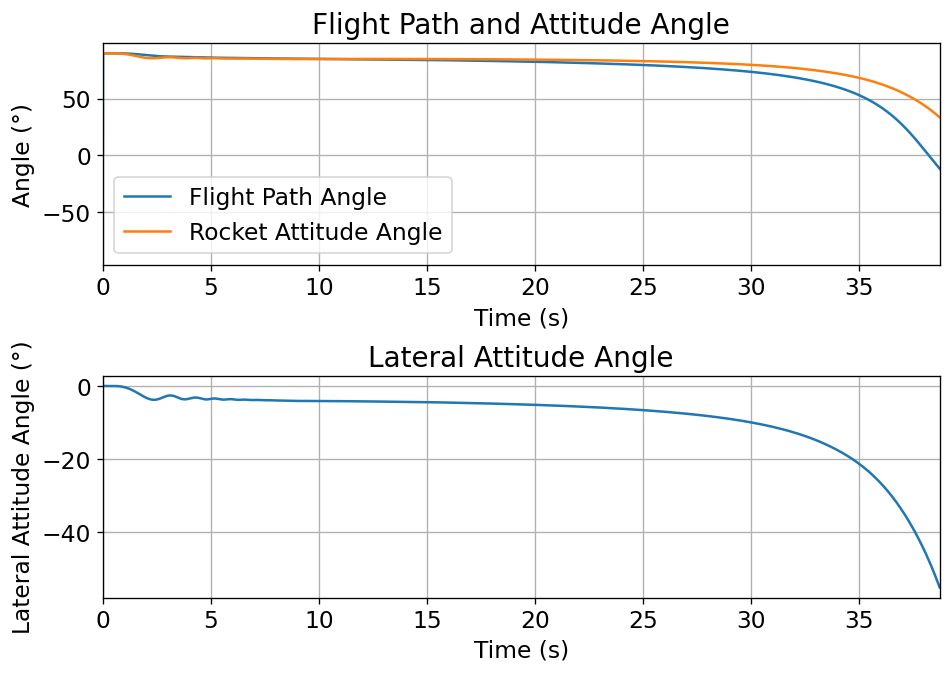



Path, Attitude and Lateral Attitude Angle plots



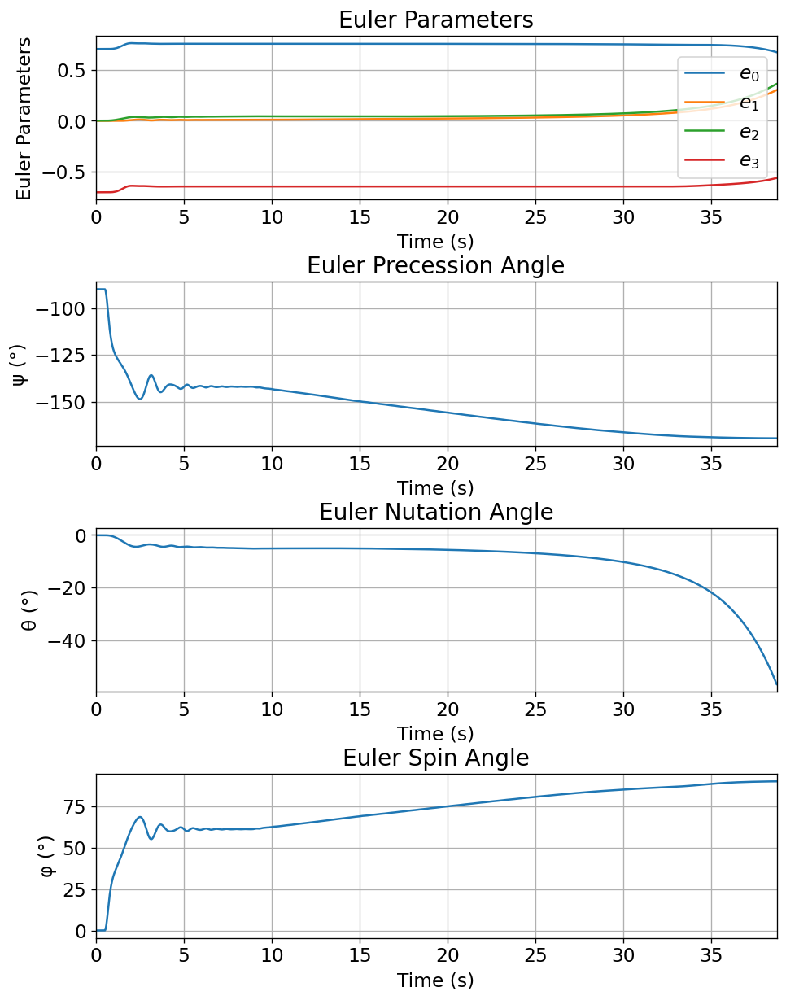



Trajectory Angular Velocity and Acceleration Plots



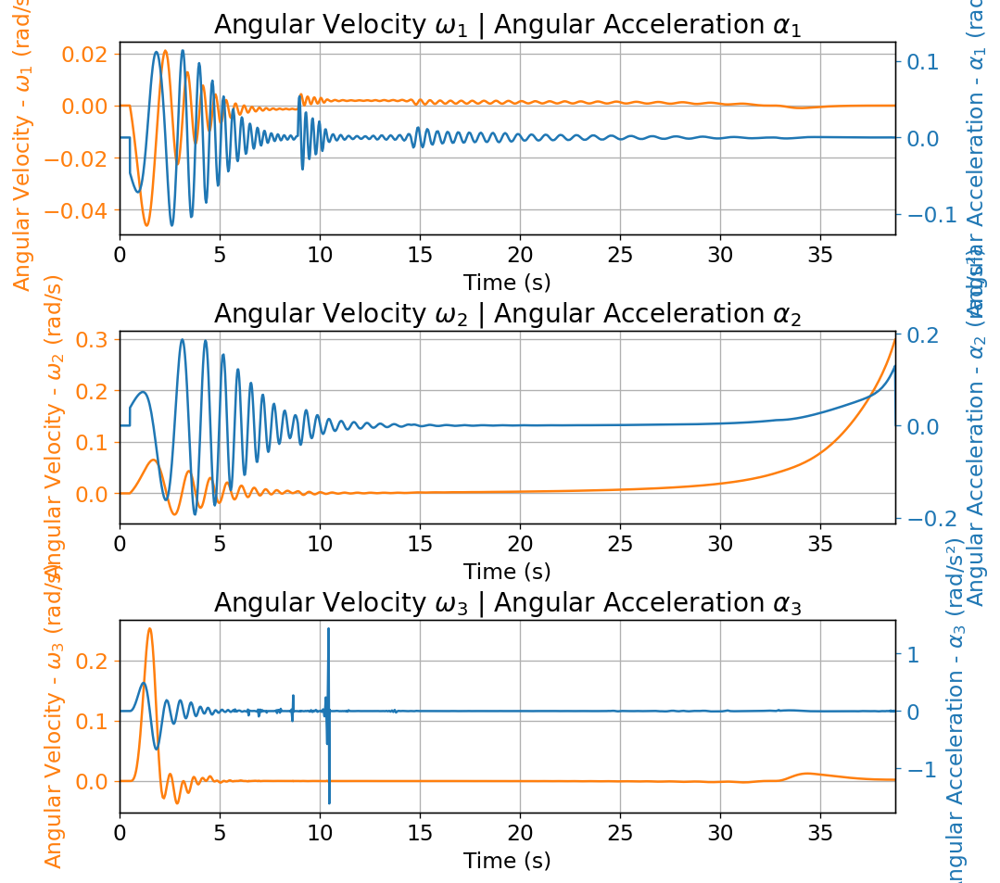



Aerodynamic Forces Plots



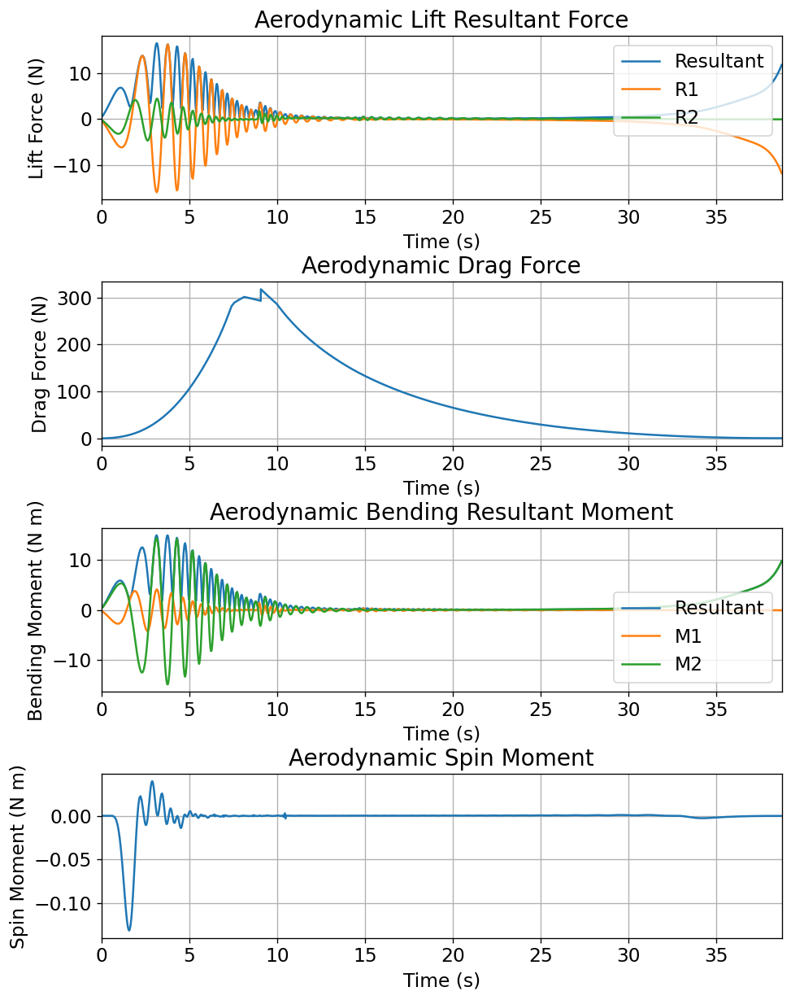



Rail Buttons Forces Plots



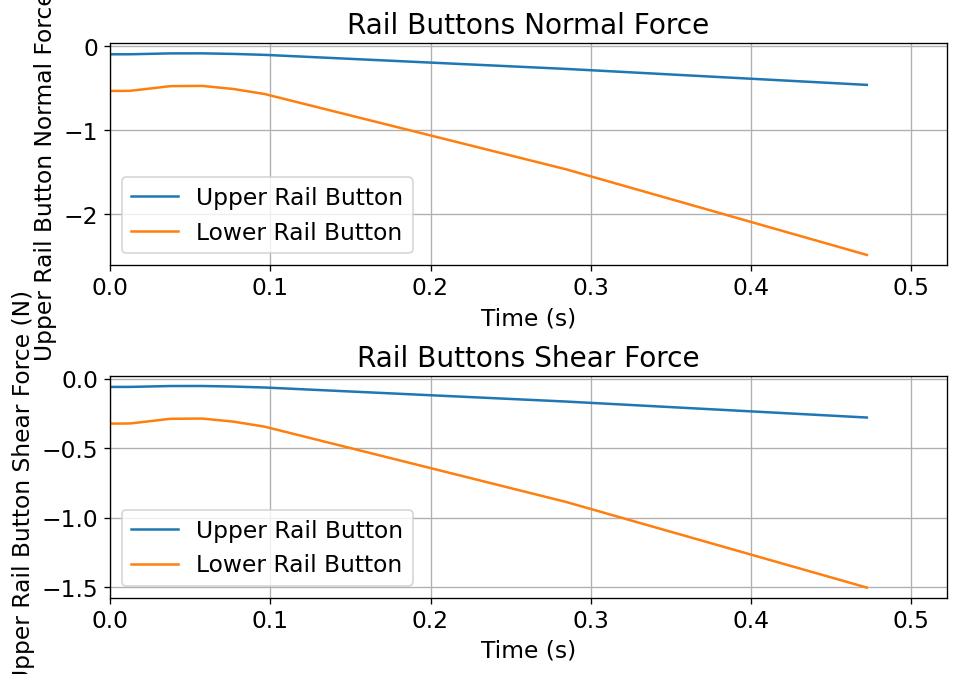



Trajectory Energy Plots



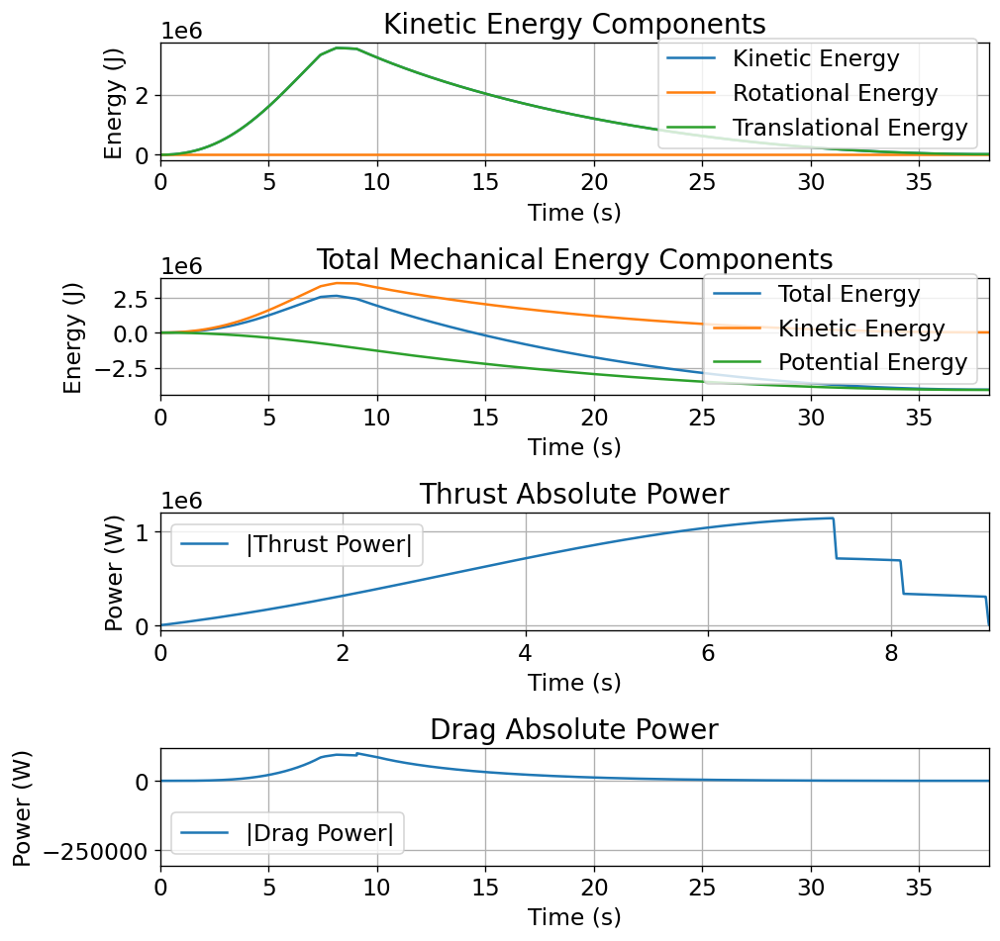



Trajectory Fluid Mechanics Plots



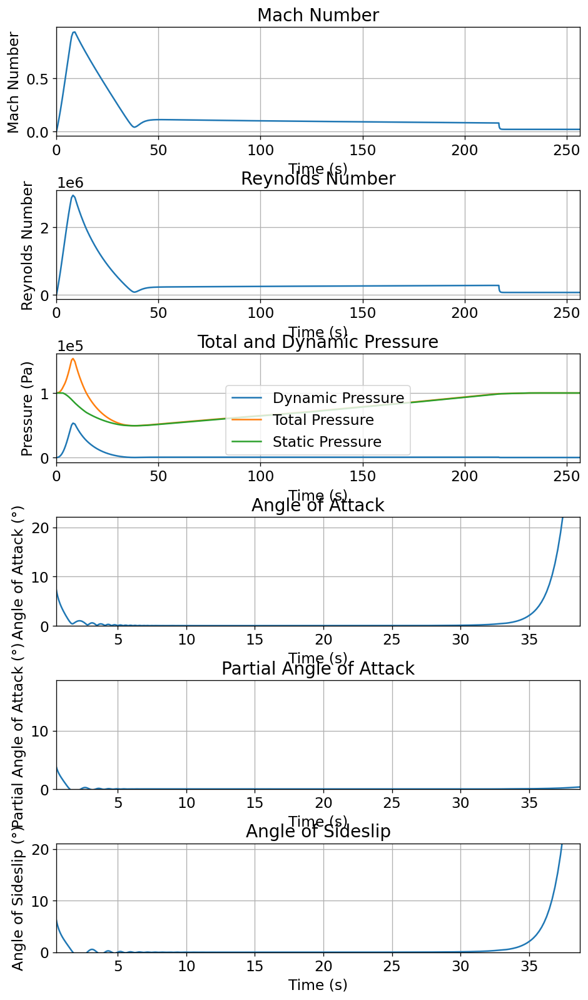



Trajectory Stability and Control Plots



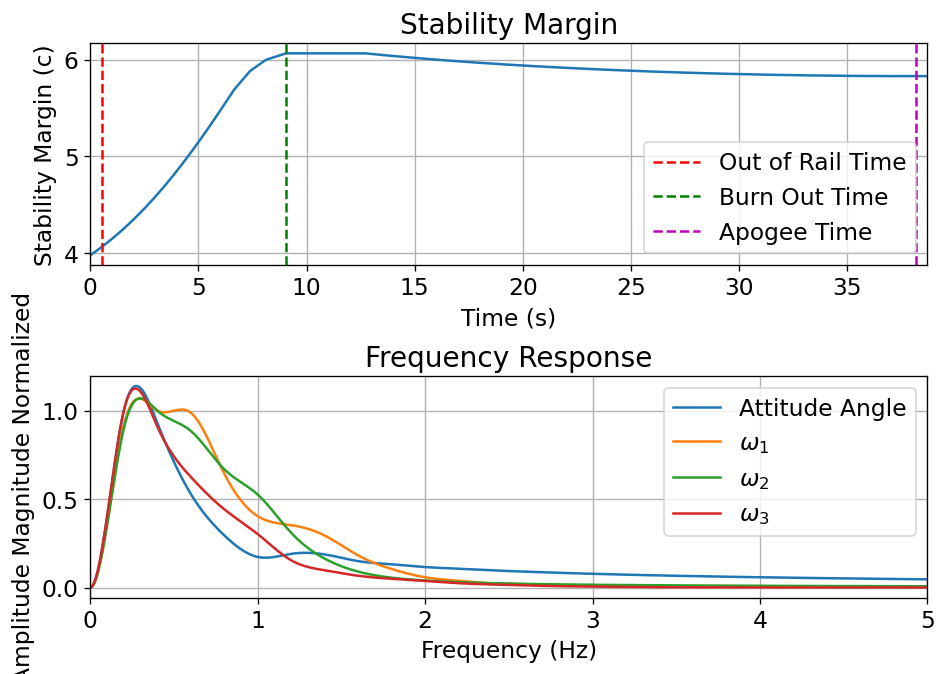



Rocket and Parachute Pressure Plots



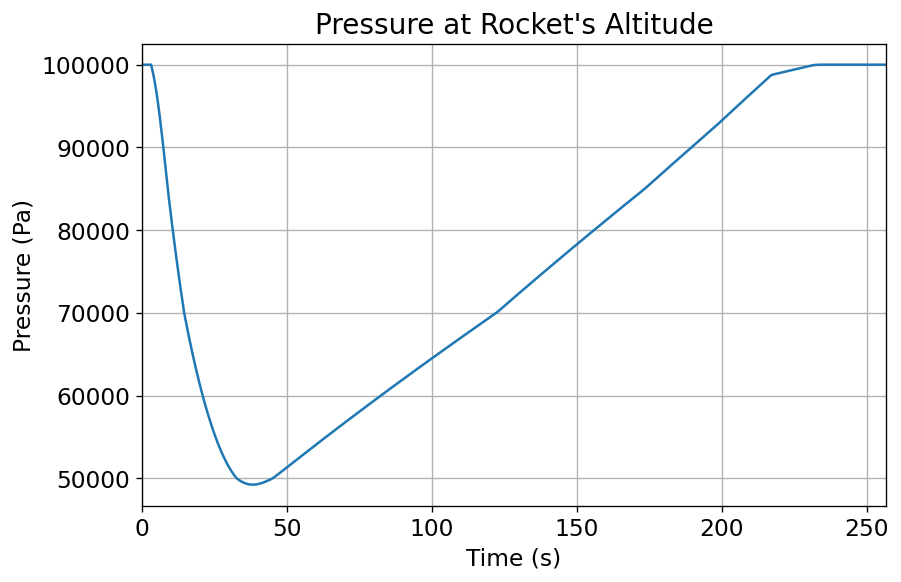


Parachute:  Drogue


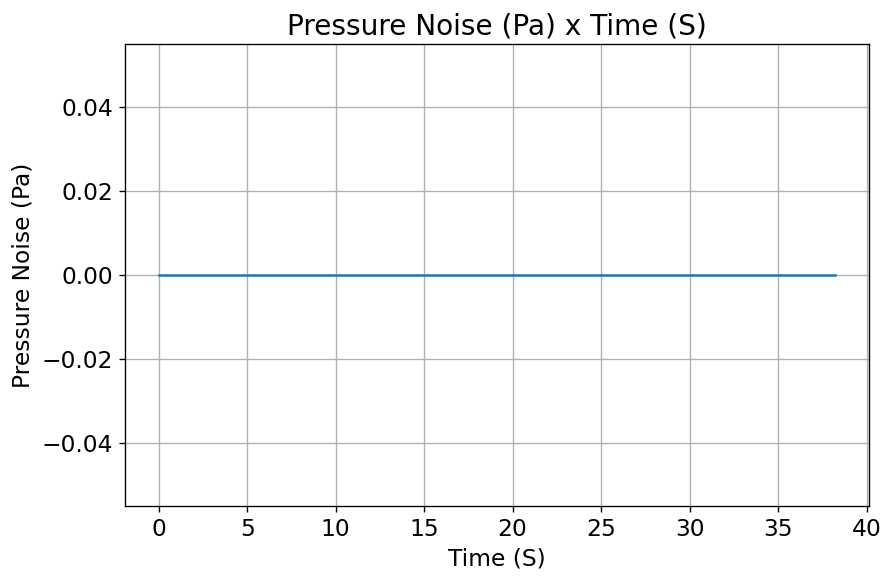

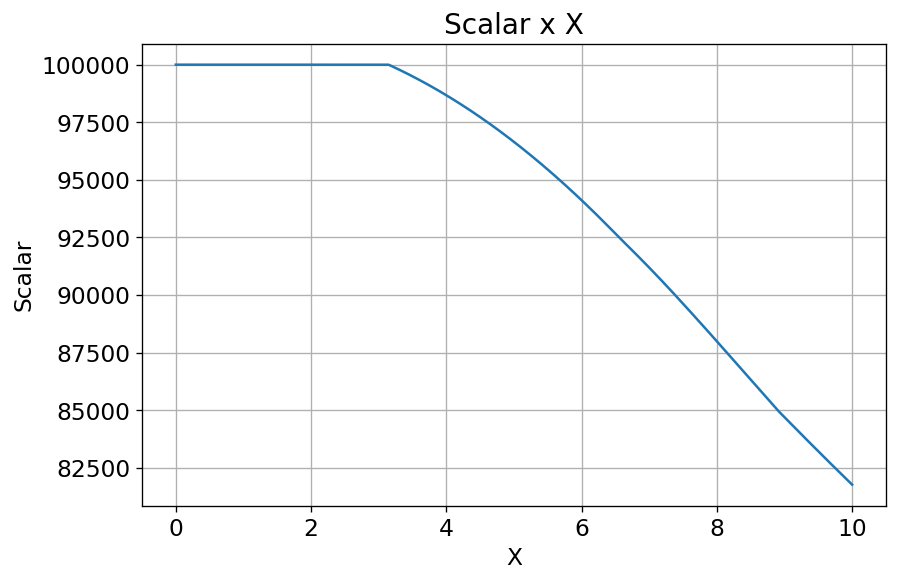

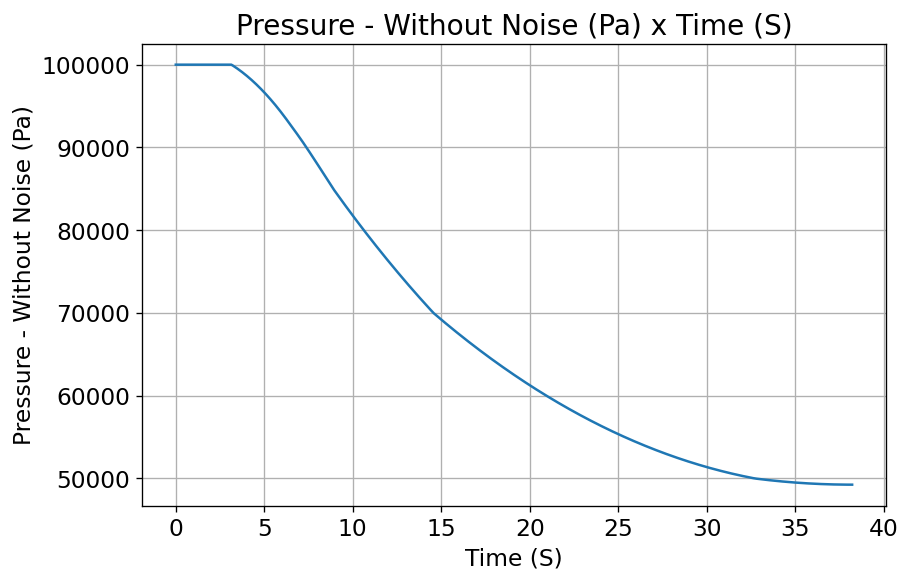


Parachute:  Main


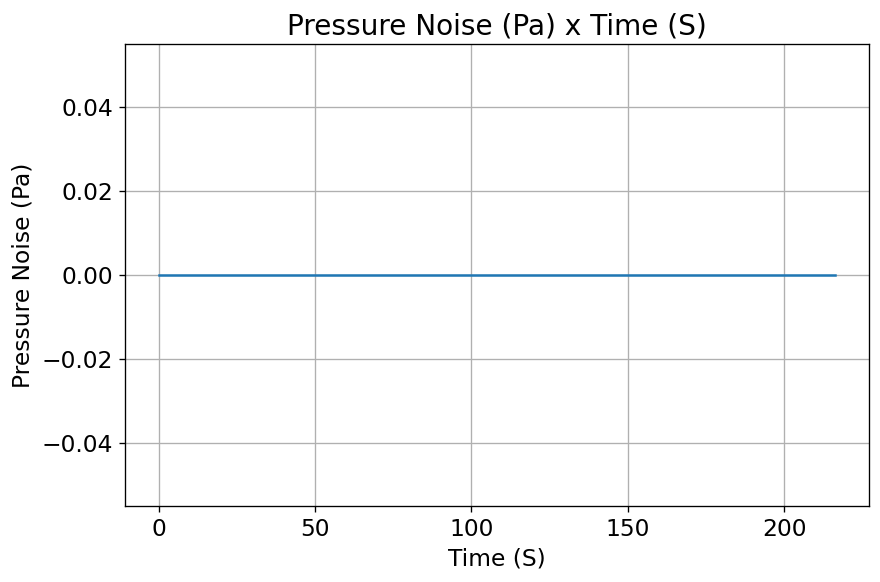

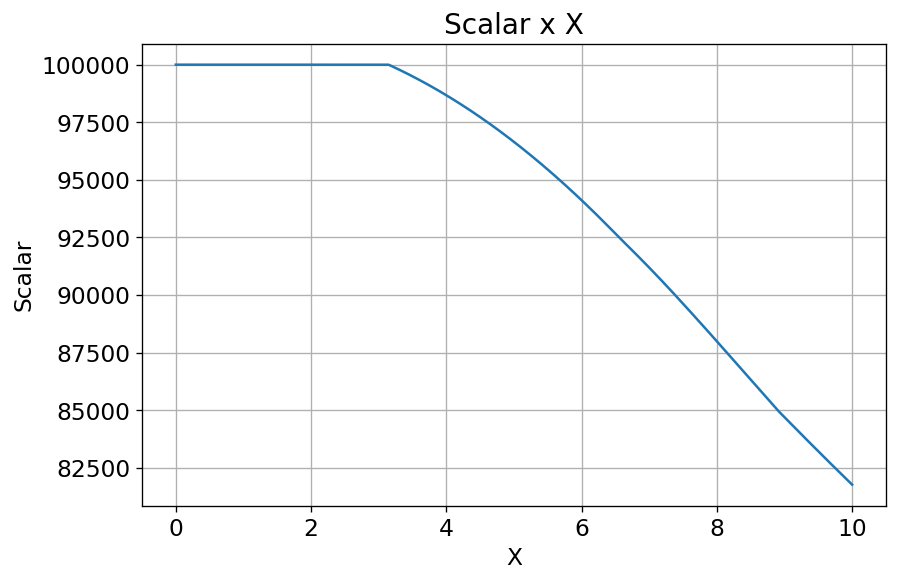

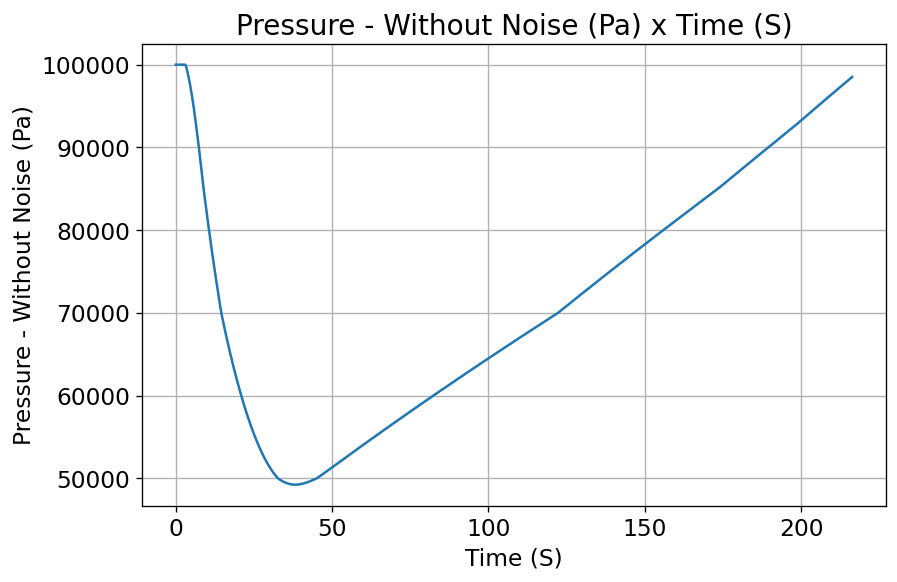

['FlightPhases', 'M1', 'M2', 'M3', 'R1', 'R2', 'R3', 'TimeNodes', '_Flight__cache_sensor_data', '_Flight__calculate_and_save_pressure_signals', '_Flight__calculate_rail_button_forces', '_Flight__evaluate_post_process', '_Flight__init_controllers', '_Flight__init_equations_of_motion', '_Flight__init_flight_state', '_Flight__init_solution_monitors', '_Flight__init_solver_monitors', '_Flight__is_lsoda', '_Flight__post_processed_variables', '_Flight__set_ode_solver', '_Flight__simulate', '_Flight__transform_pressure_signals_lists_to_functions', '__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_controllers', '_solver', 'acceleration', 'aerodynamic_bending_moment', 'aerodynamic_drag', 

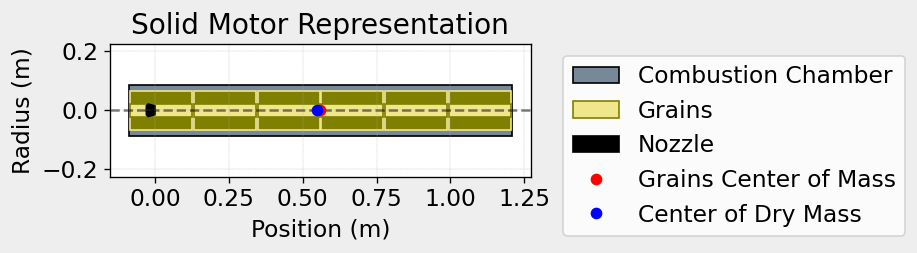

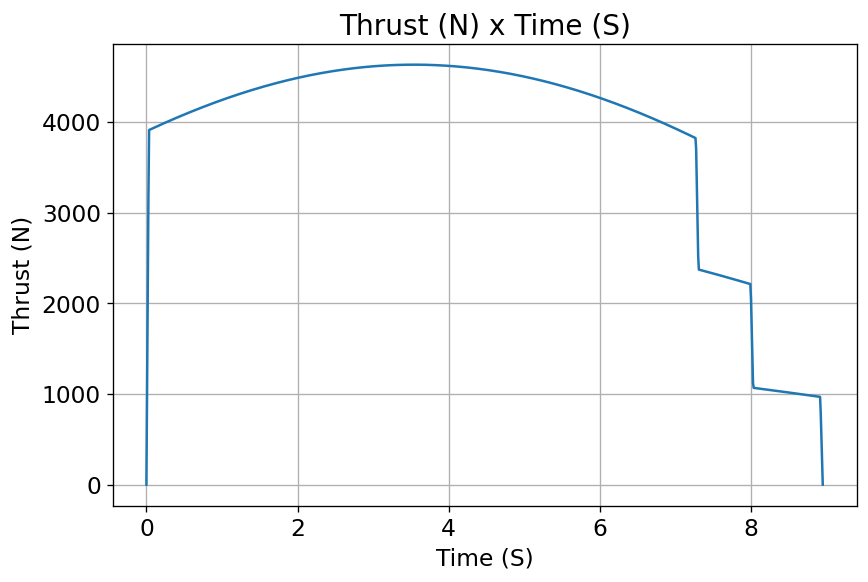

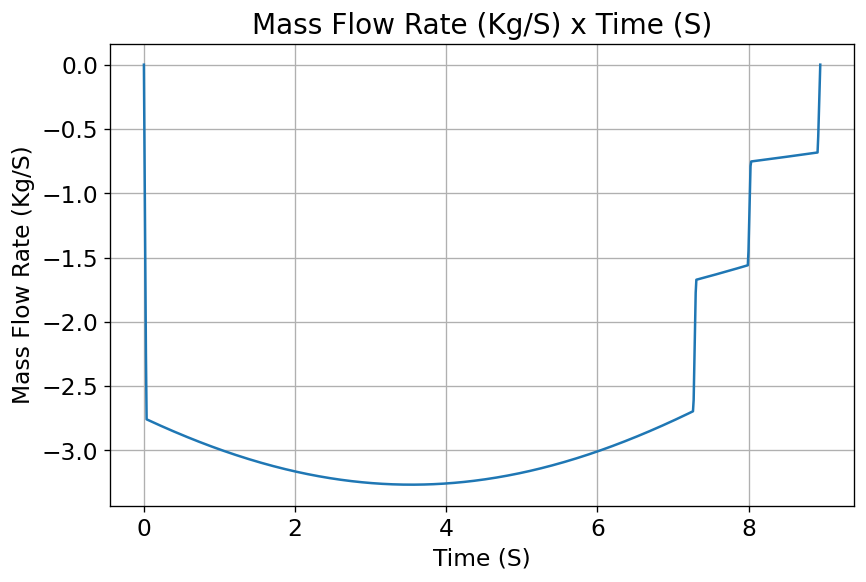

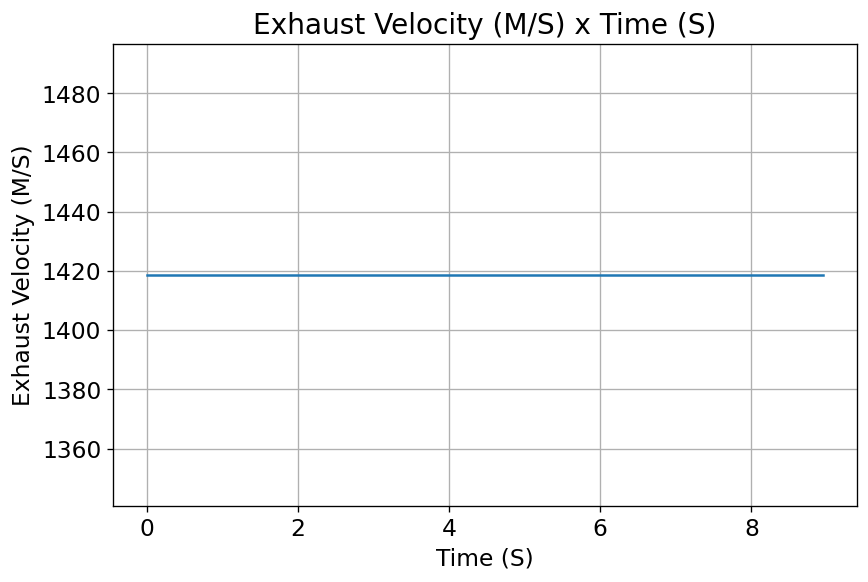

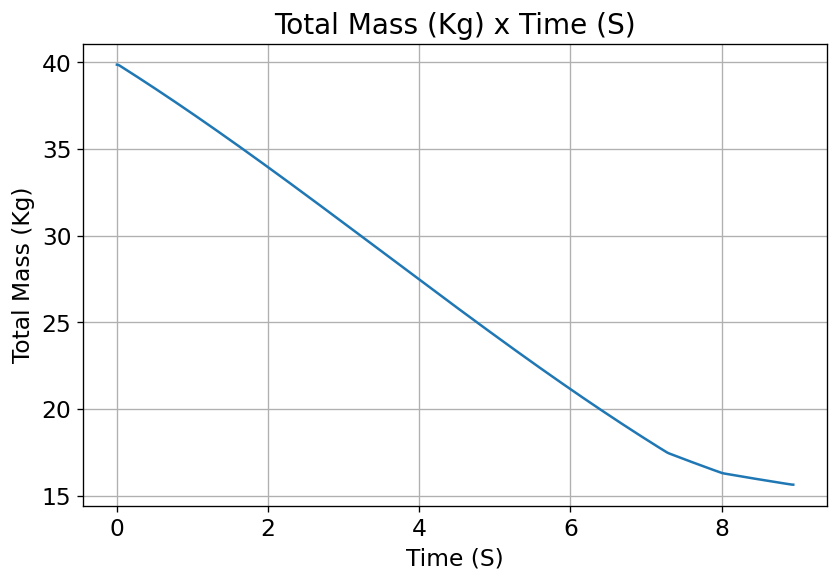

...

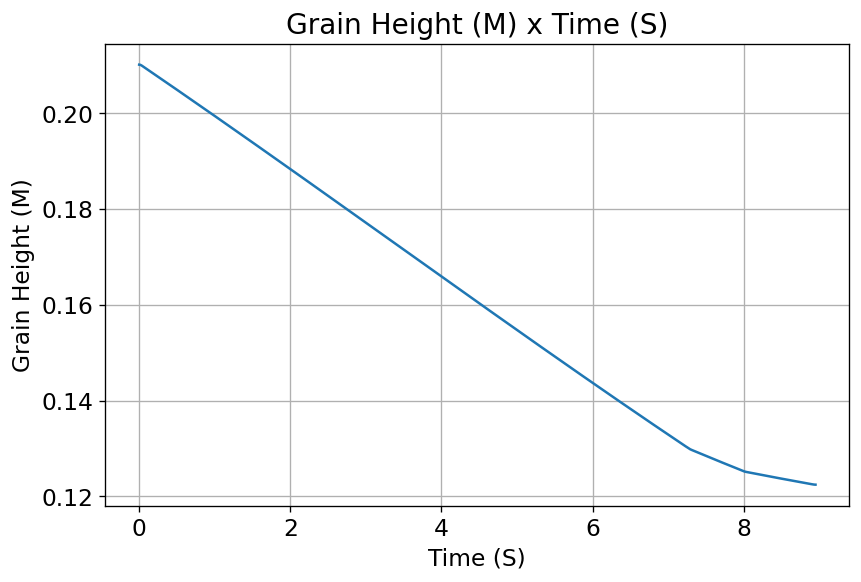

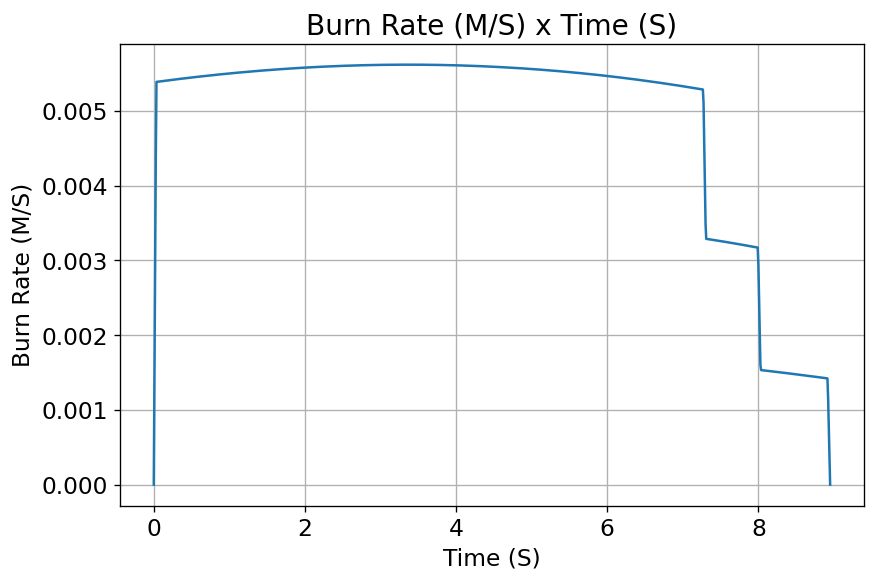

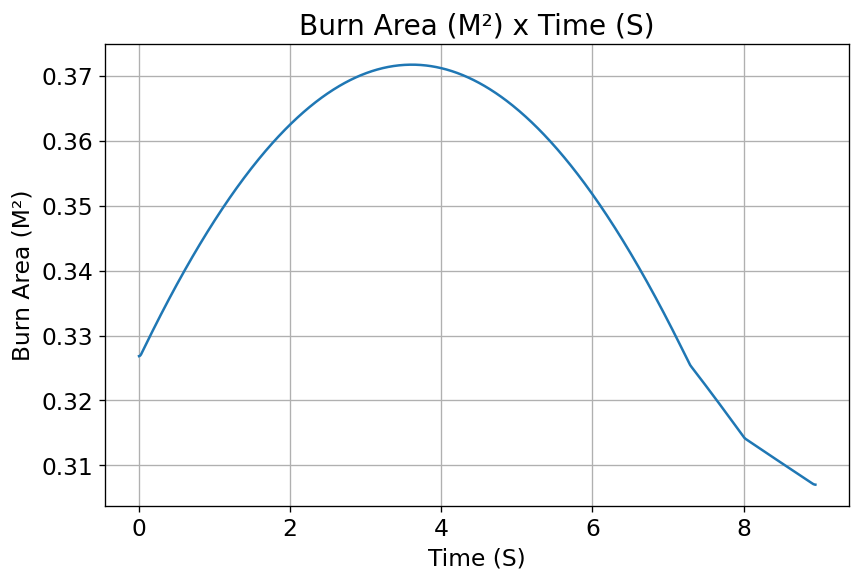

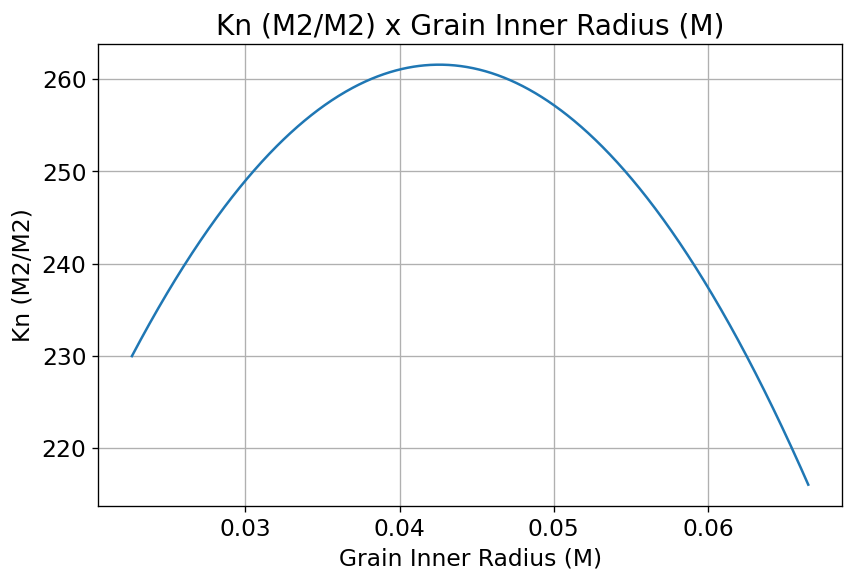

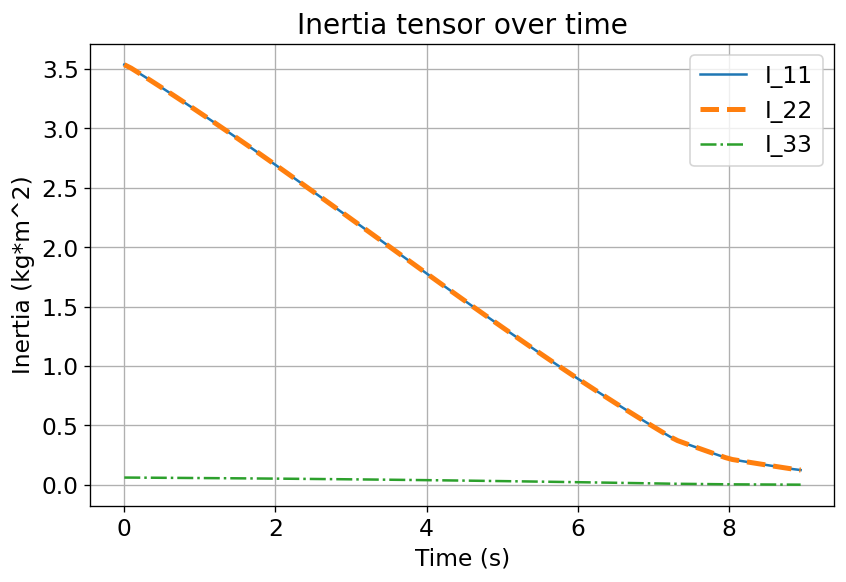

rocketCreated!!!

Inertia Details

Rocket Mass: 54.887 kg (without motor)
Rocket Dry Mass: 70.527 kg (with unloaded motor)
Rocket Loaded Mass: 94.751 kg
Rocket Structural Mass Ratio: 0.744
Rocket Inertia (with unloaded motor) 11: 26.025 kg*m2
Rocket Inertia (with unloaded motor) 22: 75.801 kg*m2
Rocket Inertia (with unloaded motor) 33: 0.002 kg*m2
Rocket Inertia (with unloaded motor) 12: 0.000 kg*m2
Rocket Inertia (with unloaded motor) 13: 0.000 kg*m2
Rocket Inertia (with unloaded motor) 23: 0.000 kg*m2

Geometrical Parameters

Rocket Maximum Radius: 0.07969114638367447 m
Rocket Frontal Area: 0.019951 m2

Rocket Distances
Rocket Center of Dry Mass - Center of Mass without Motor: 0.322 m
Rocket Center of Dry Mass - Nozzle Exit: 1.680 m
Rocket Center of Dry Mass - Center of Propellant Mass: 1.120 m
Rocket Center of Mass - Rocket Loaded Center of Mass: 0.286 m


Aerodynamics Lift Coefficient Derivatives

Nose Cone Lift Coefficient Derivative: 2.000/rad
Fins Lift Coefficient Derivative: 8.

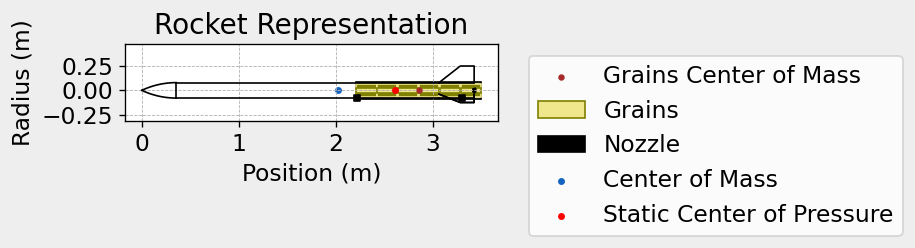


Mass Plots
----------------------------------------


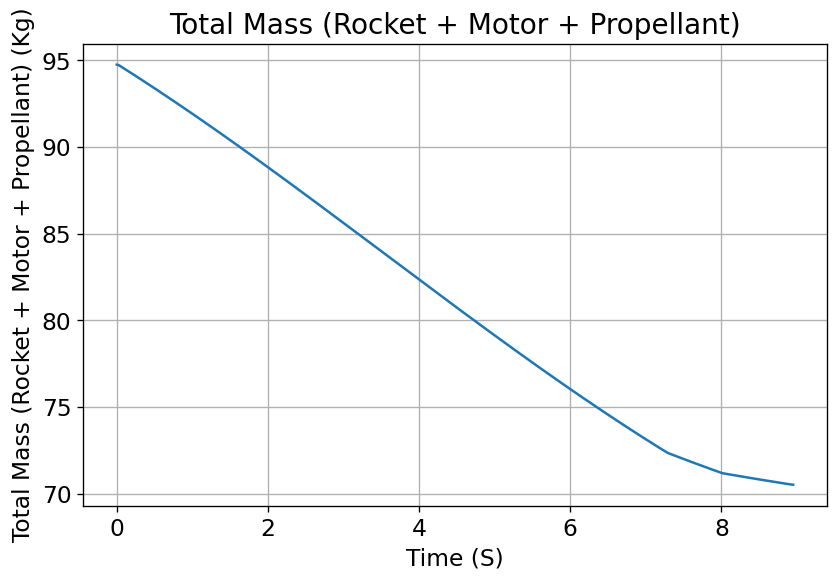

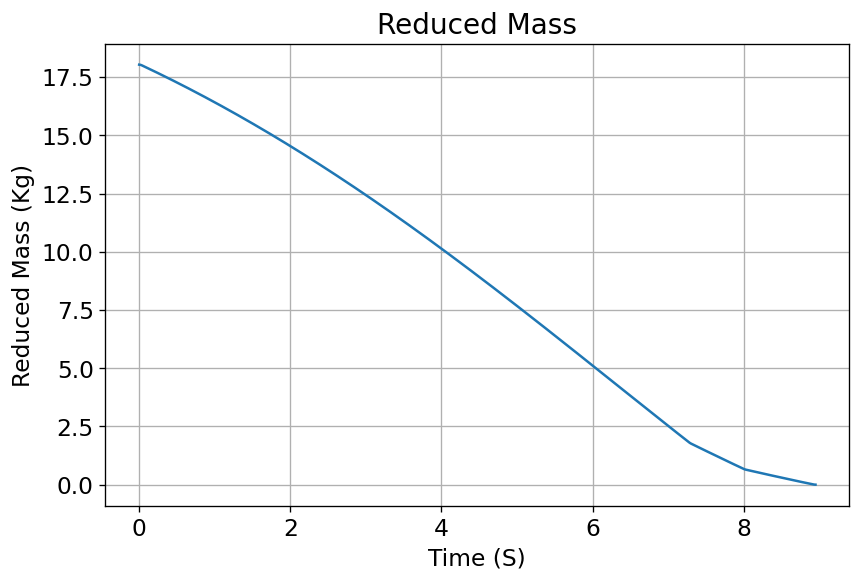


Aerodynamics Plots
----------------------------------------
Drag Plots
--------------------


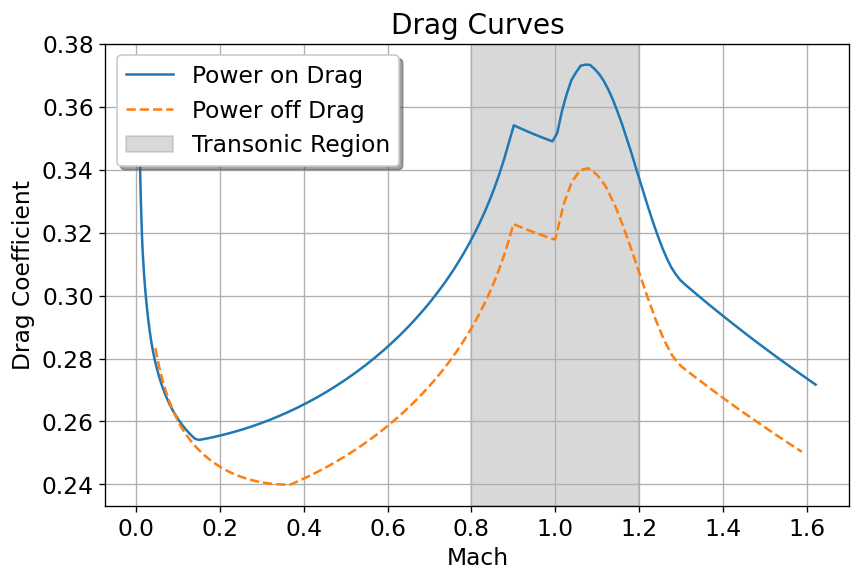


Stability Plots
--------------------


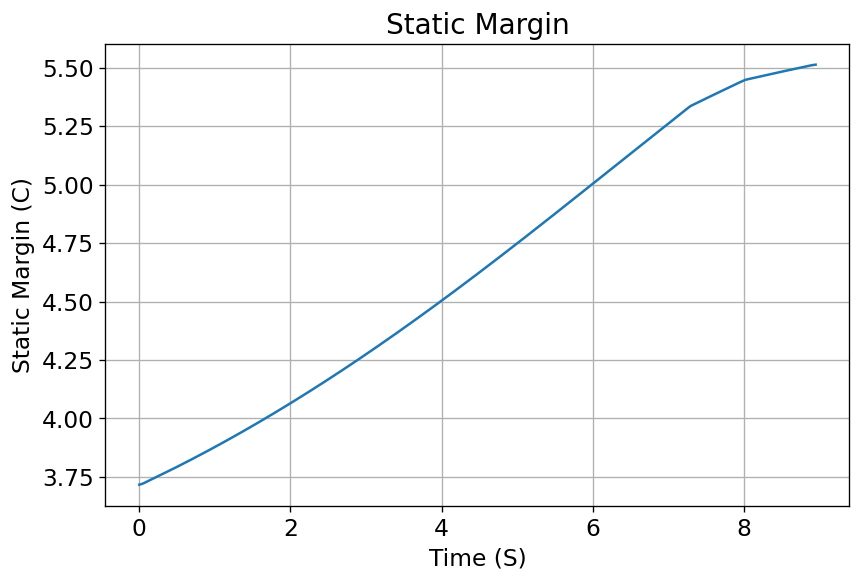

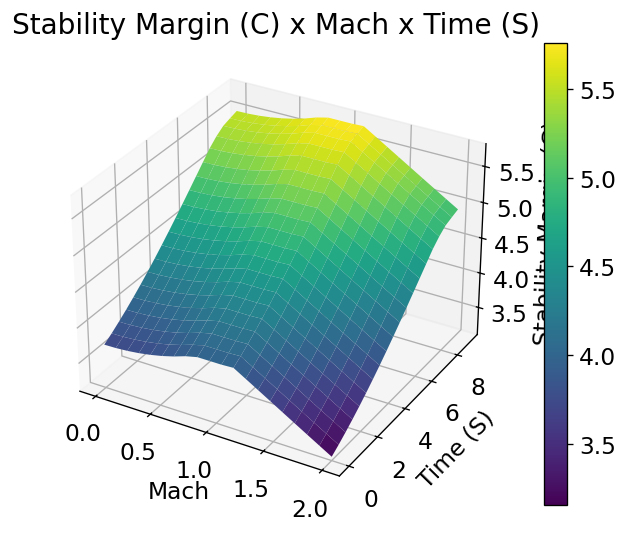


Thrust-to-Weight Plot
----------------------------------------


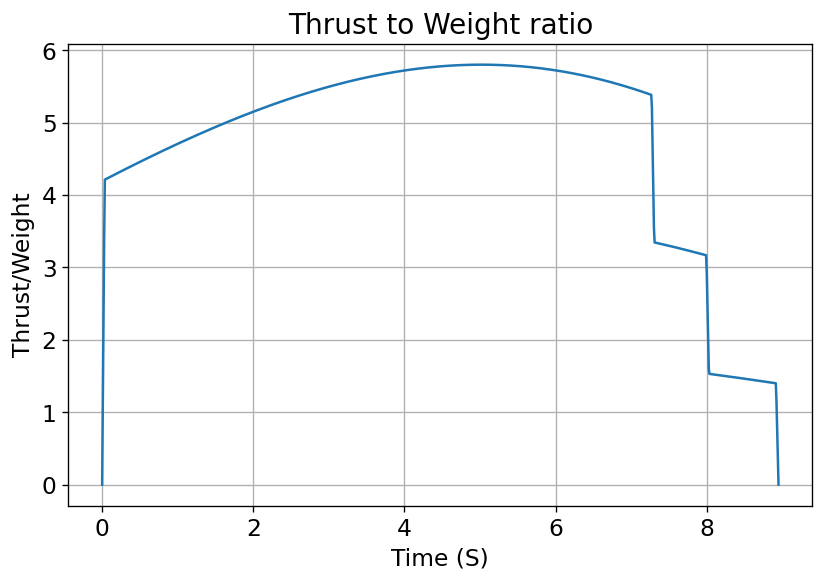

running flight

Initial Conditions

Initial time: 0.000 s
Position - x: 0.00 m | y: 0.00 m | z: 0.00 m
Velocity - Vx: 0.00 m/s | Vy: 0.00 m/s | Vz: 0.00 m/s
Attitude (quaternions) - e0: 0.711 | e1: 0.009 | e2: -0.009 | e3: -0.703
Euler Angles - Spin φ : -180.00° | Nutation θ: -1.39° | Precession ψ: 90.62°
Angular Velocity - ω1: 0.00 rad/s | ω2: 0.00 rad/s | ω3: 0.00 rad/s
Initial Stability Margin: 3.717 c


Surface Wind Conditions

Frontal Surface Wind Speed: -1.03 m/s
Lateral Surface Wind Speed: 1.73 m/s


Launch Rail

Launch Rail Length: 5.1816 m
Launch Rail Inclination: 91.39°
Launch Rail Heading: 89.38°


Rail Departure State

Rail Departure Time: 0.517 s
Rail Departure Velocity: 16.273 m/s
Rail Departure Stability Margin: 3.797 c
Rail Departure Angle of Attack: 7.059°
Rail Departure Thrust-Weight Ratio: 4.468
Rail Departure Reynolds Number: 1.711e+05


Burn out State

Burn out time: 8.949 s
Altitude at burn out: 1574.795 m (ASL) | 1574.795 m (AGL)
Rocket speed at burn out: 313.463

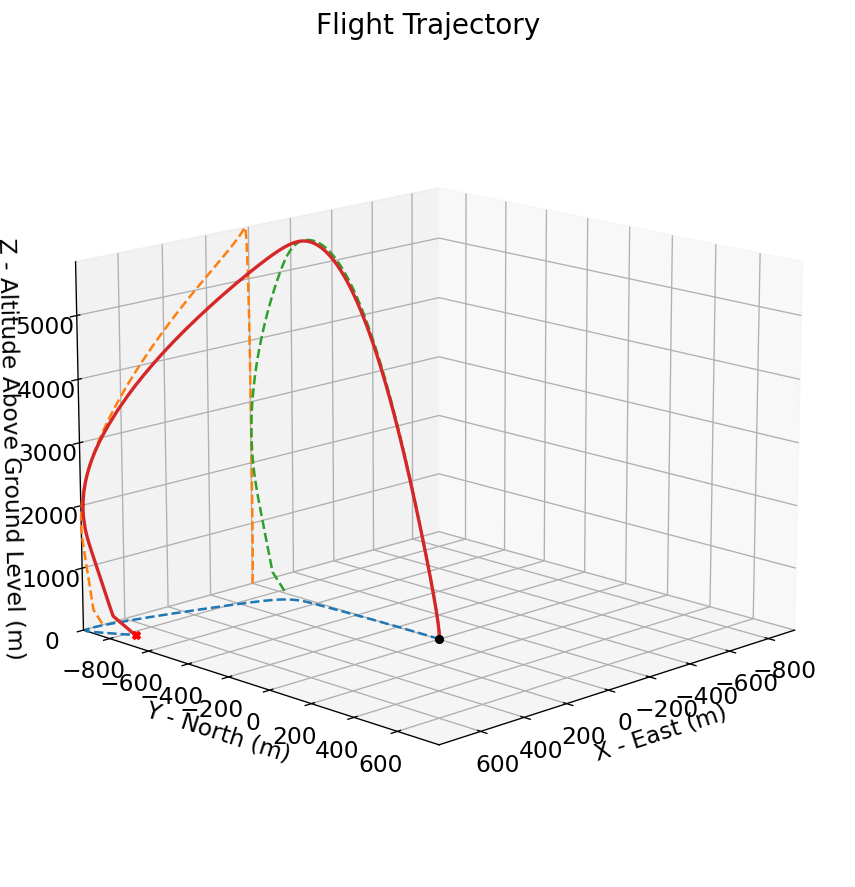



Trajectory Kinematic Plots



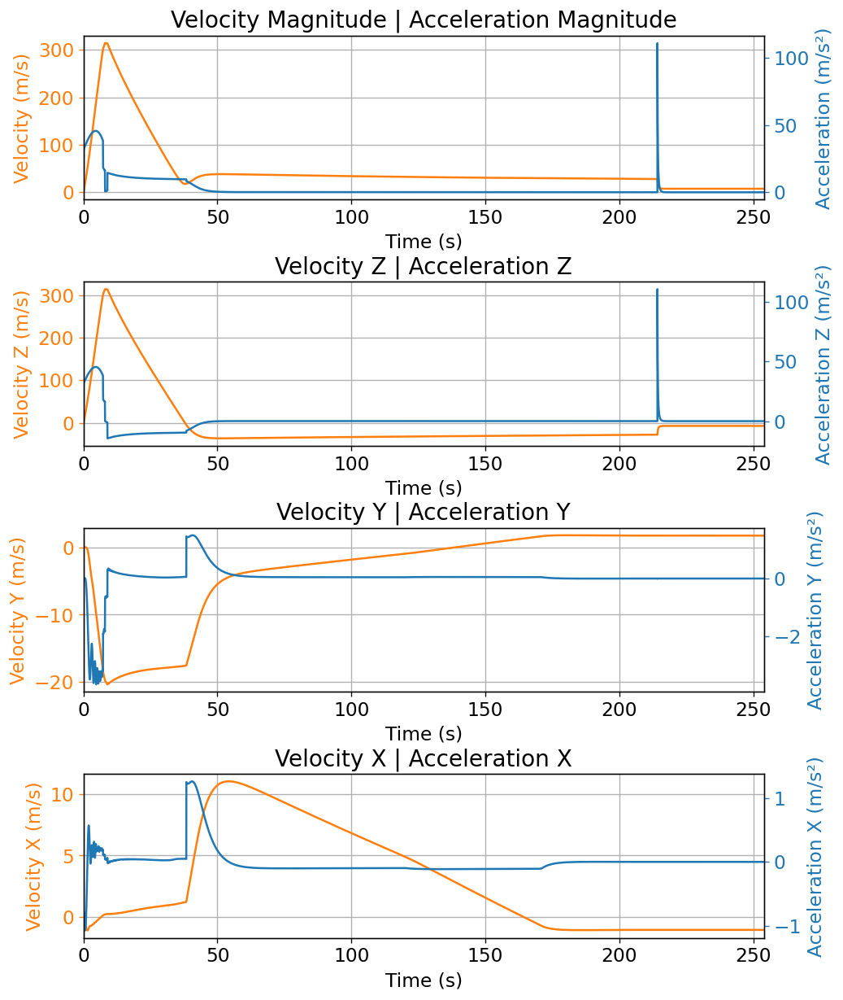



Angular Position Plots



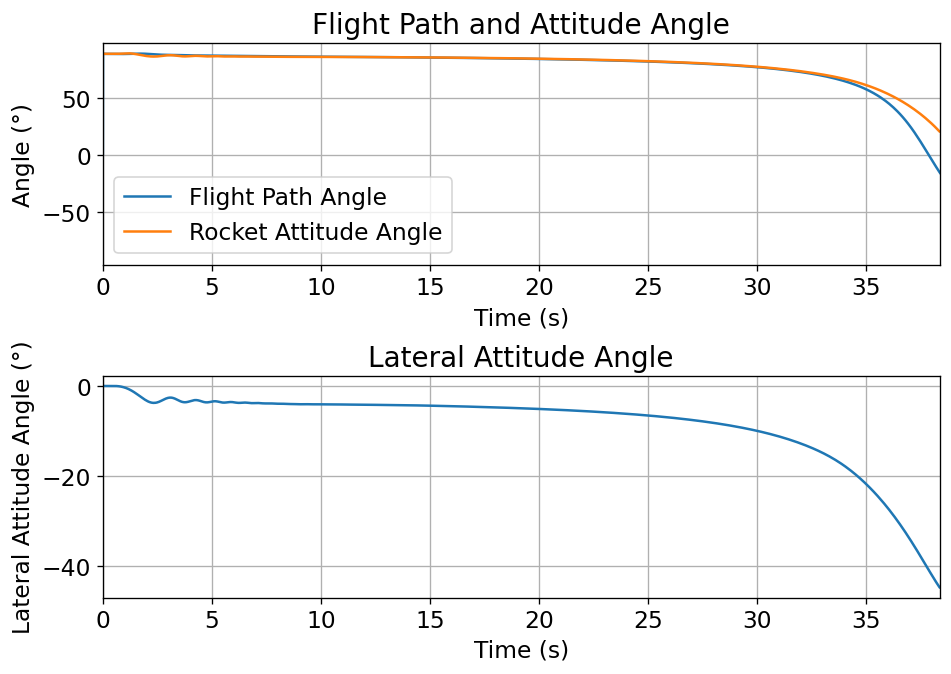



Path, Attitude and Lateral Attitude Angle plots



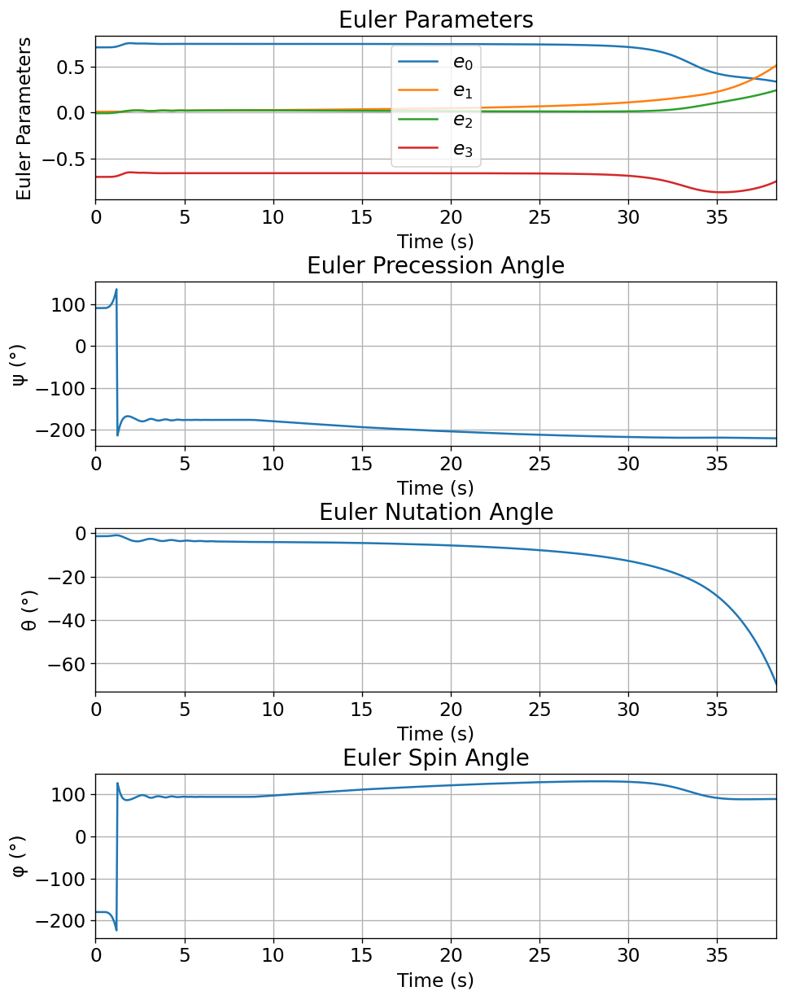



Trajectory Angular Velocity and Acceleration Plots



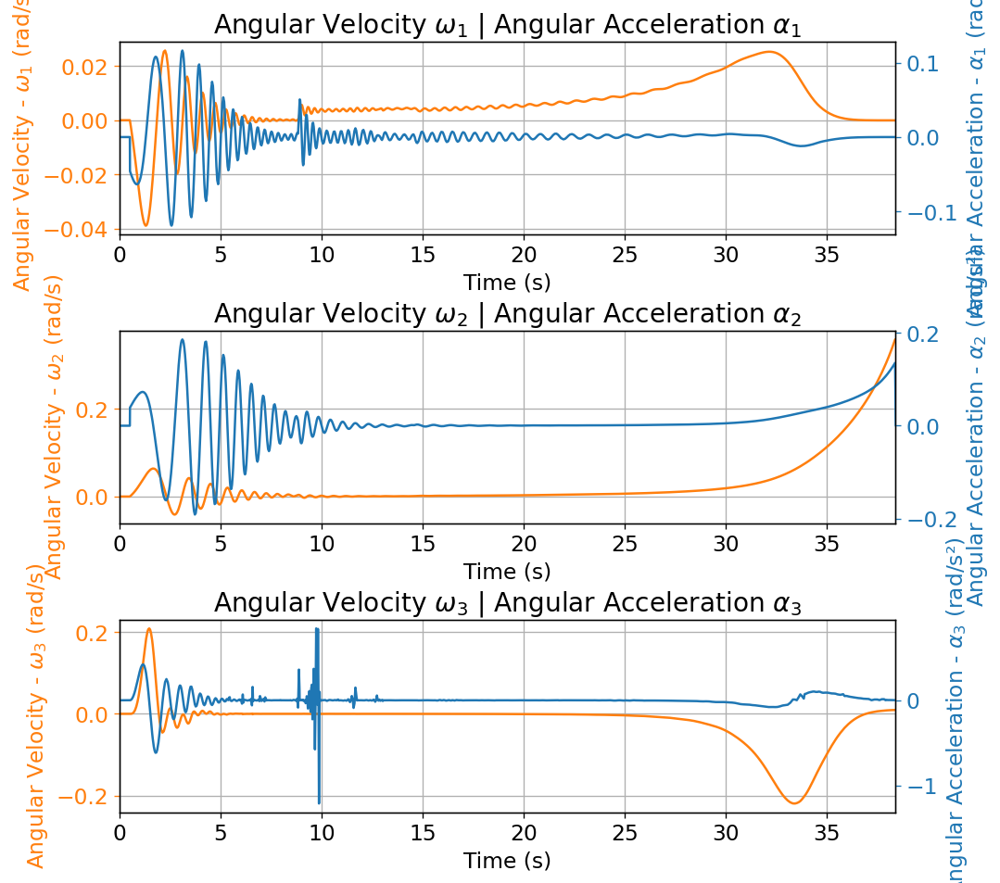



Aerodynamic Forces Plots



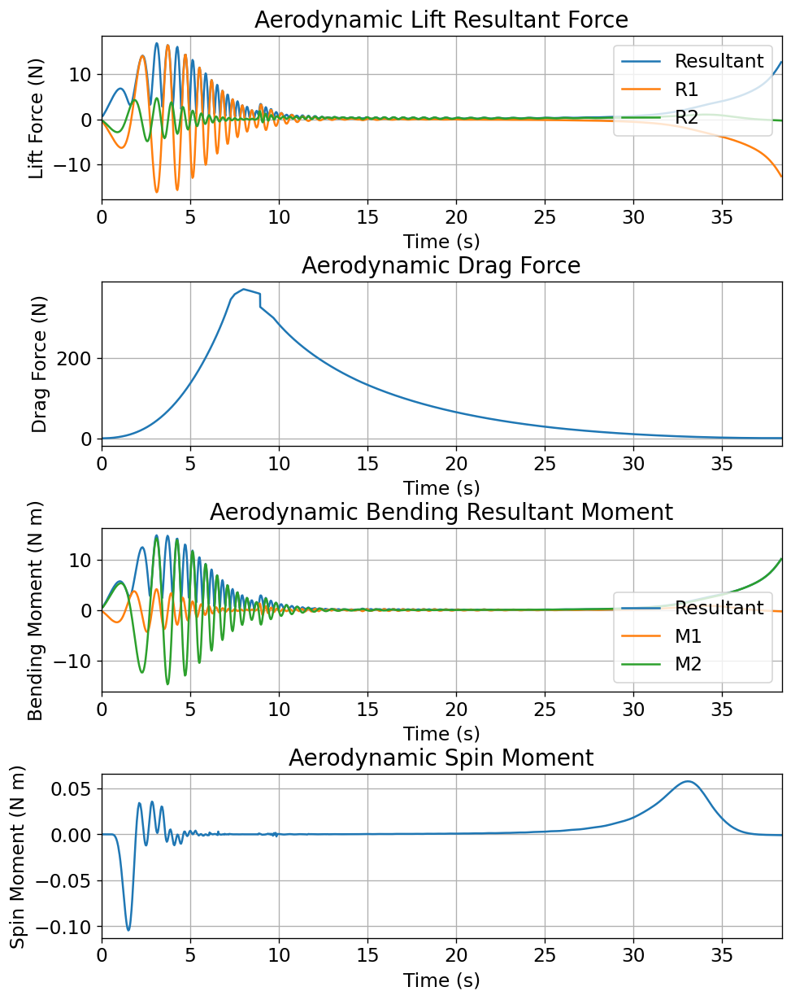



Rail Buttons Forces Plots



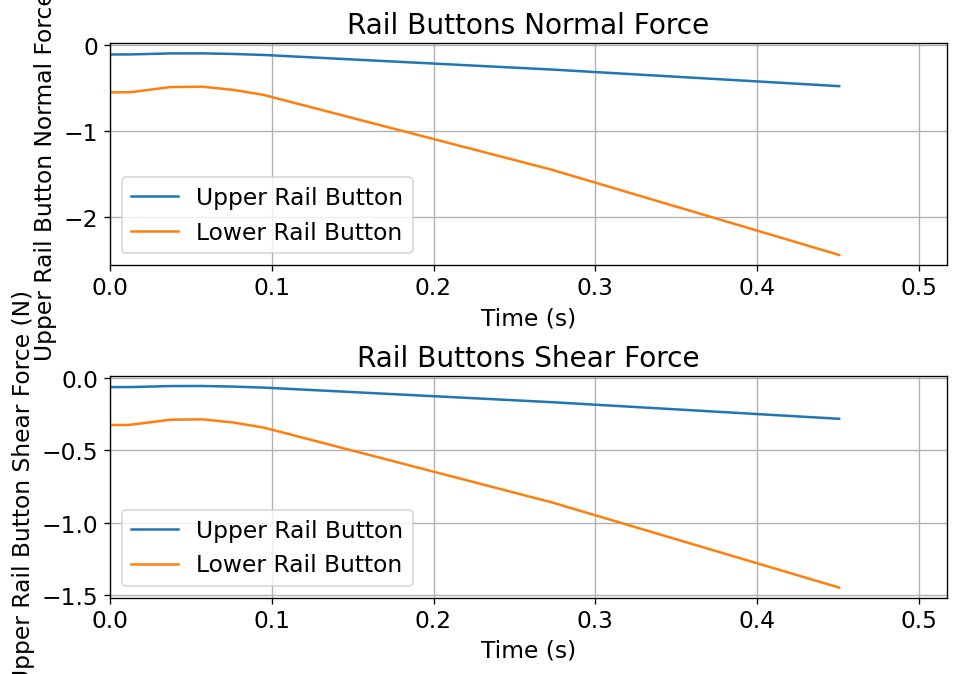



Trajectory Energy Plots



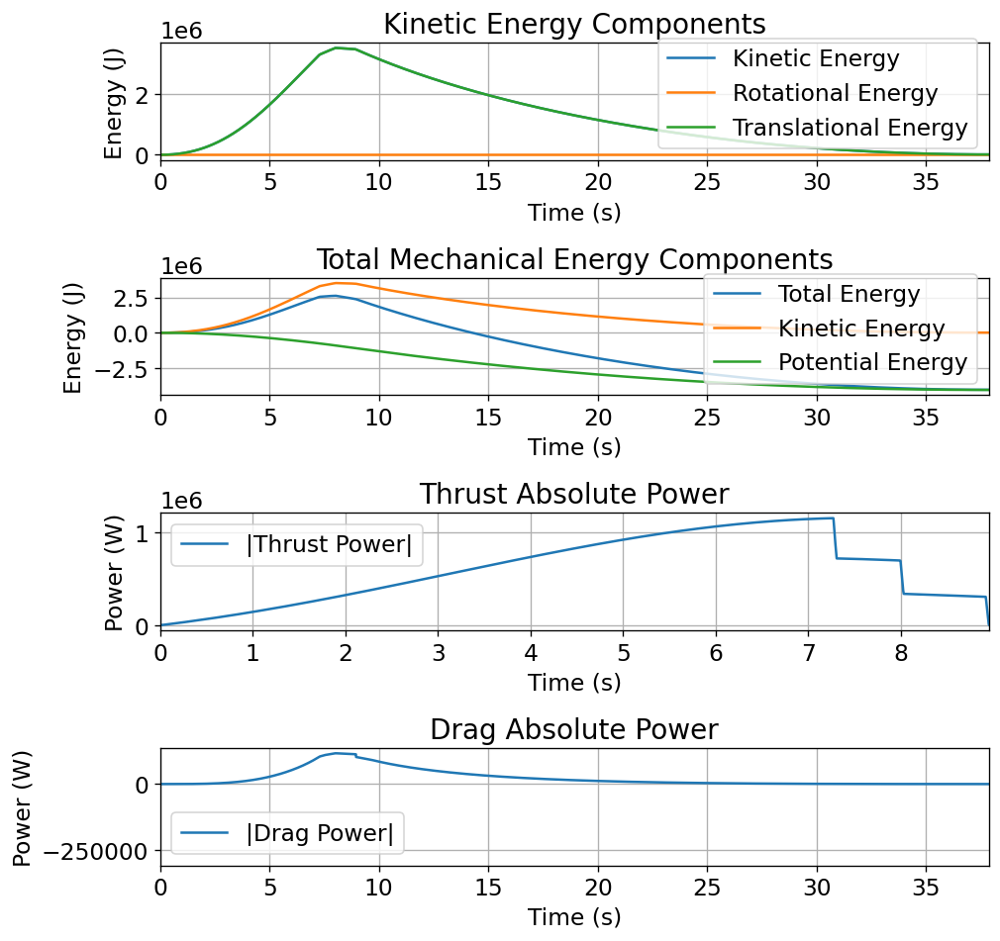



Trajectory Fluid Mechanics Plots



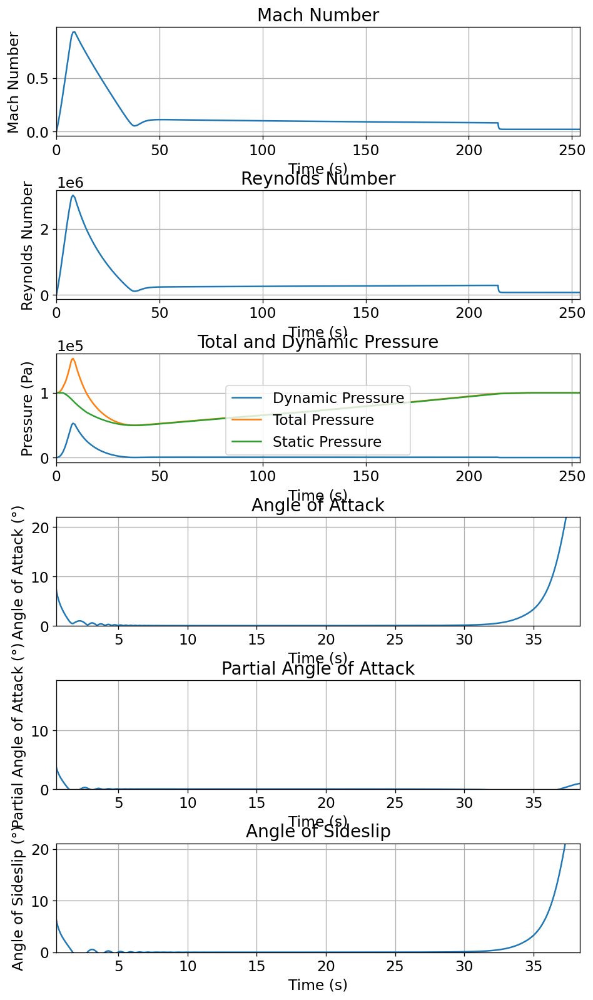



Trajectory Stability and Control Plots



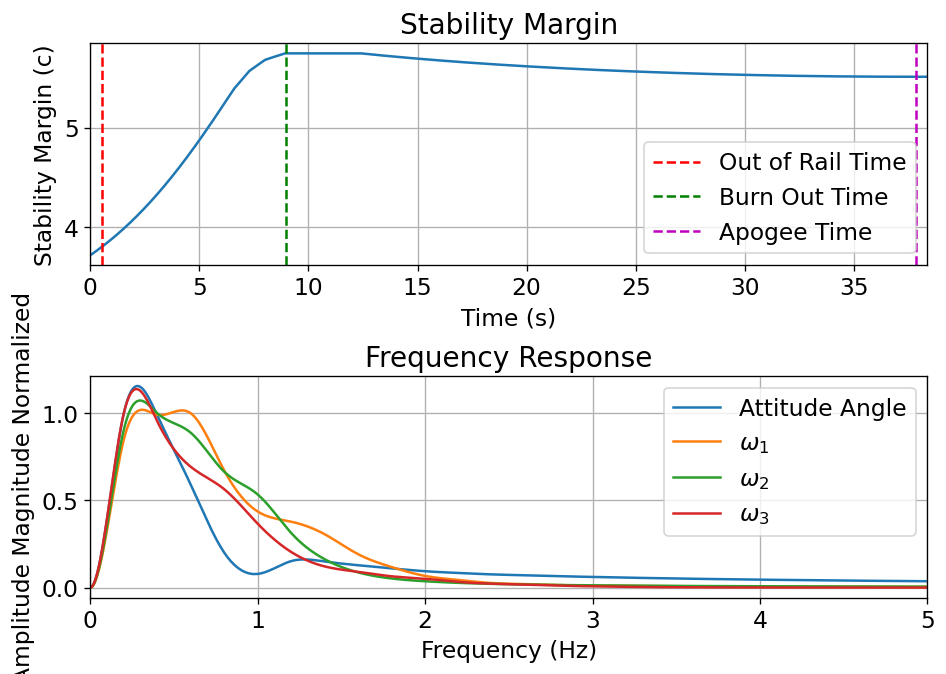



Rocket and Parachute Pressure Plots



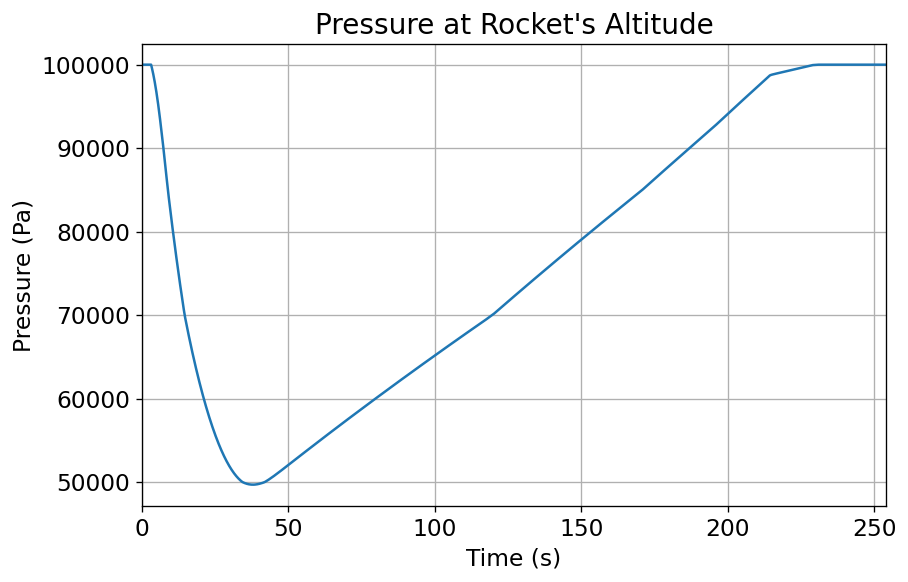


Parachute:  Drogue


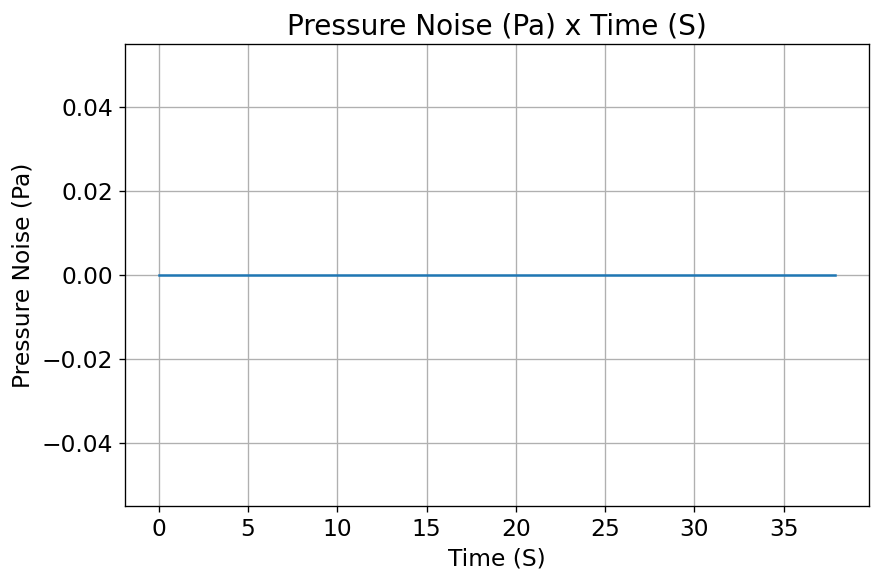

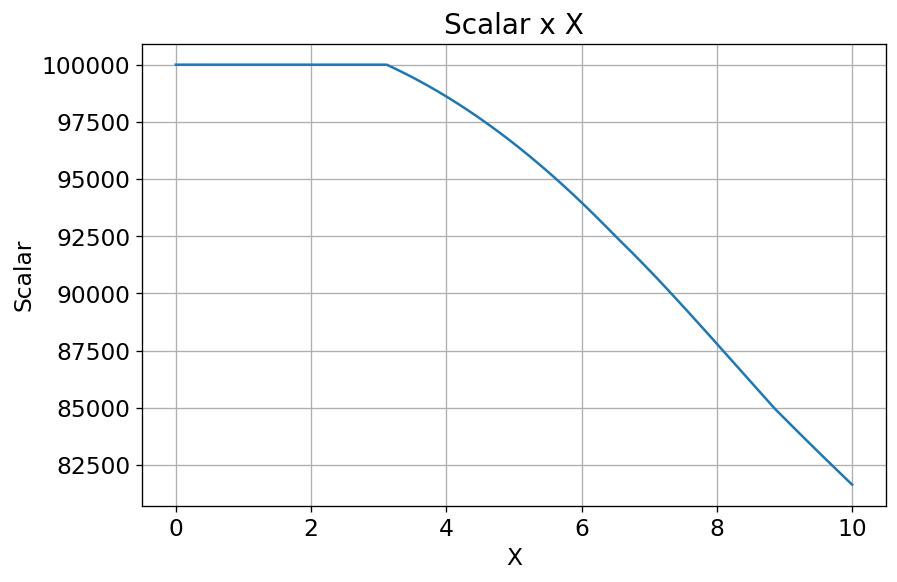

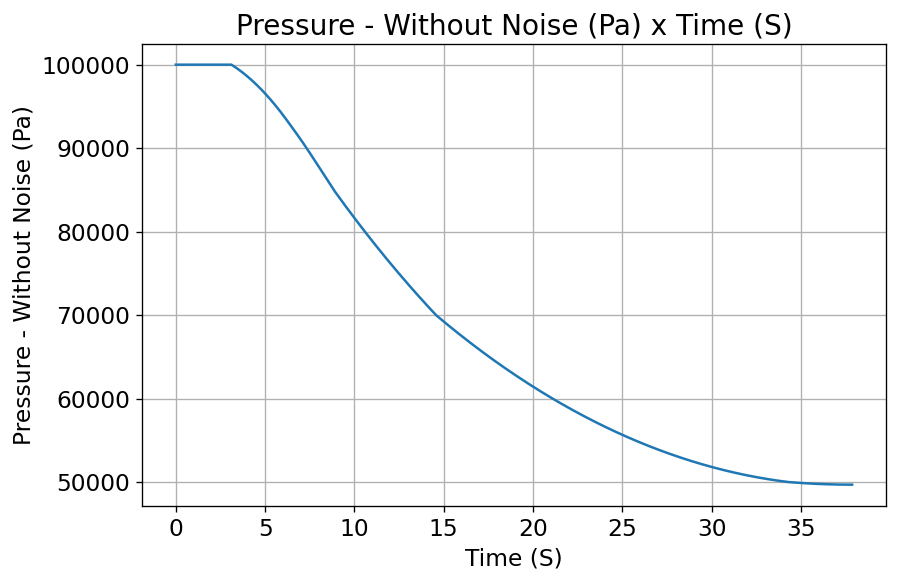


Parachute:  Main


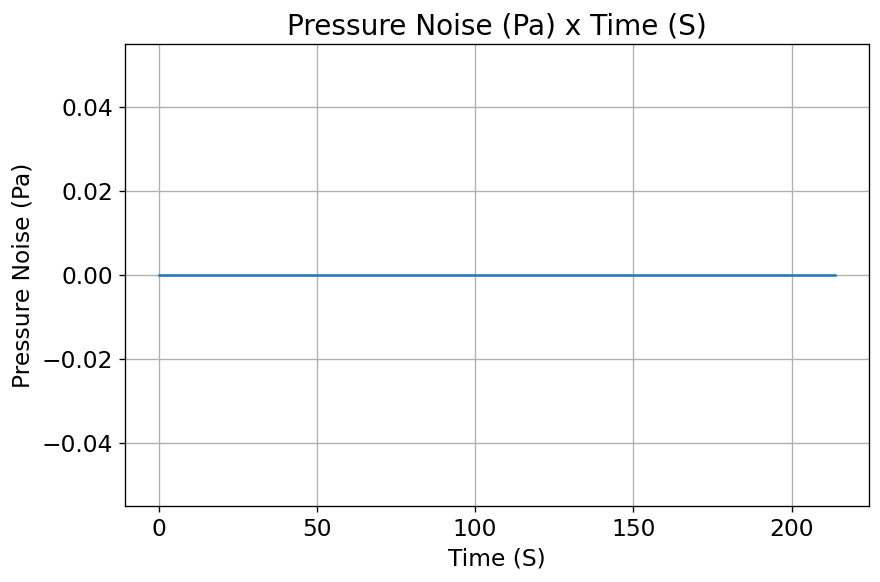

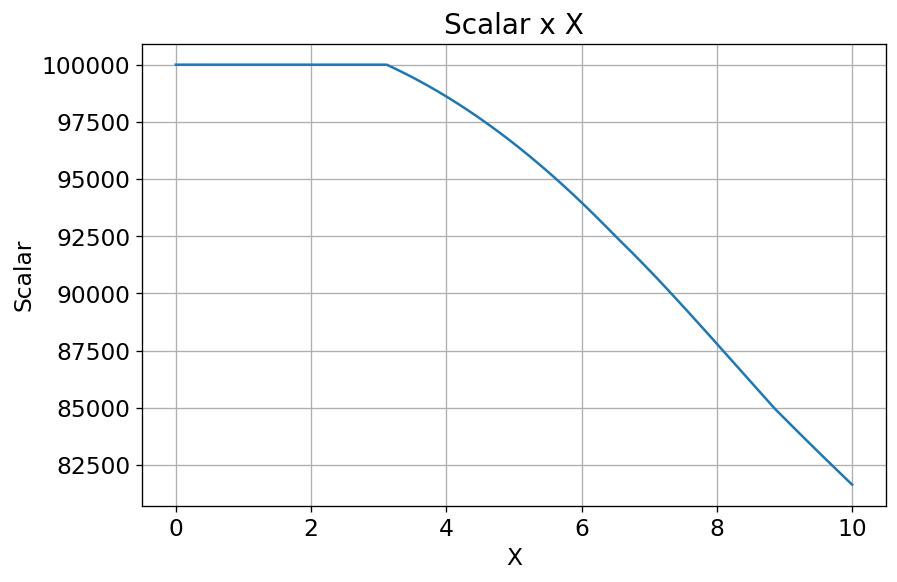

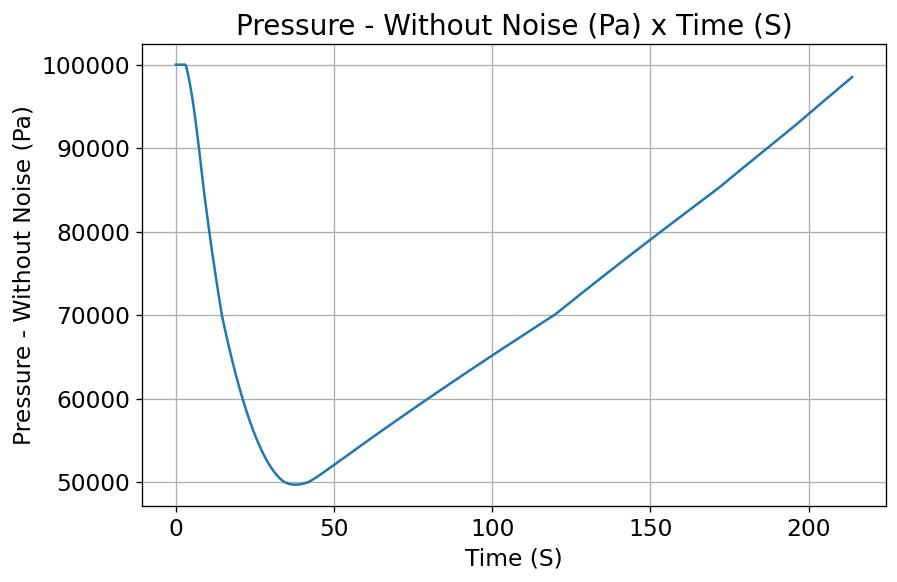

['FlightPhases', 'M1', 'M2', 'M3', 'R1', 'R2', 'R3', 'TimeNodes', '_Flight__cache_sensor_data', '_Flight__calculate_and_save_pressure_signals', '_Flight__calculate_rail_button_forces', '_Flight__evaluate_post_process', '_Flight__init_controllers', '_Flight__init_equations_of_motion', '_Flight__init_flight_state', '_Flight__init_solution_monitors', '_Flight__init_solver_monitors', '_Flight__is_lsoda', '_Flight__post_processed_variables', '_Flight__set_ode_solver', '_Flight__simulate', '_Flight__transform_pressure_signals_lists_to_functions', '__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_controllers', '_solver', 'acceleration', 'aerodynamic_bending_moment', 'aerodynamic_drag', 

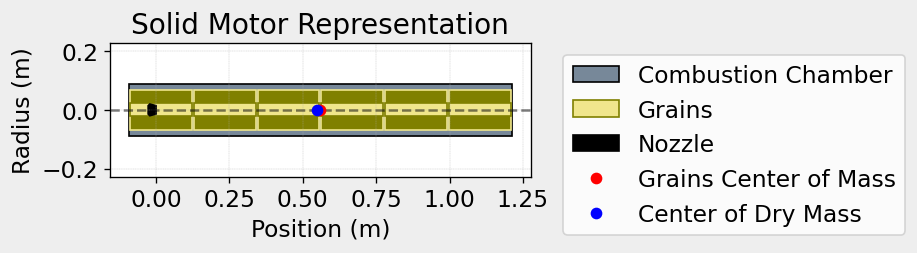

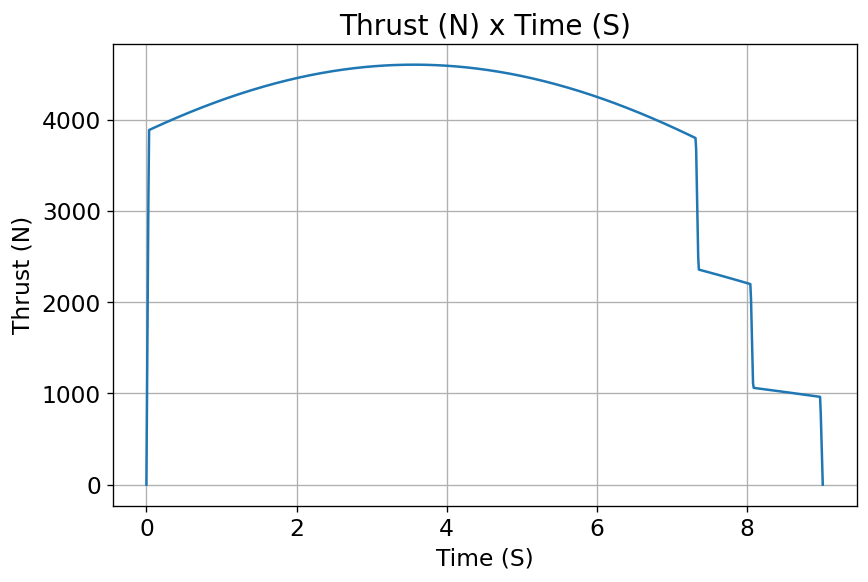

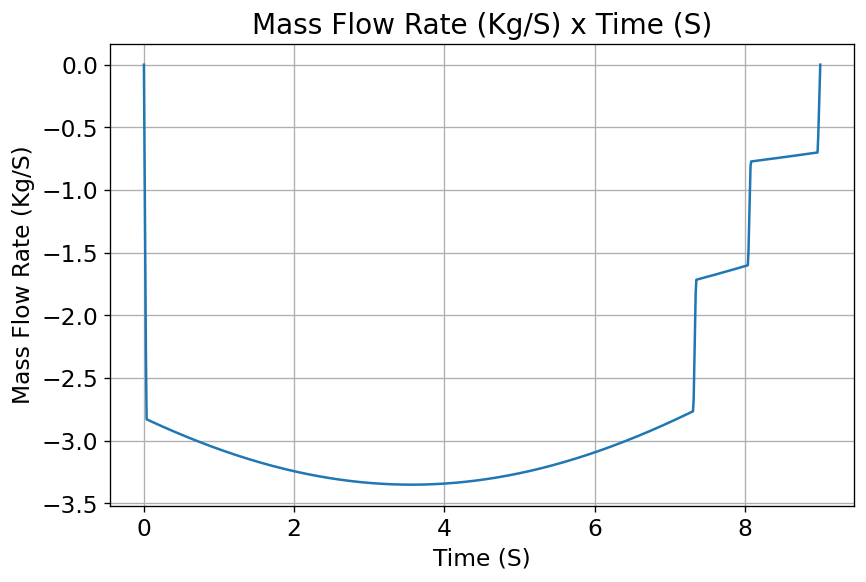

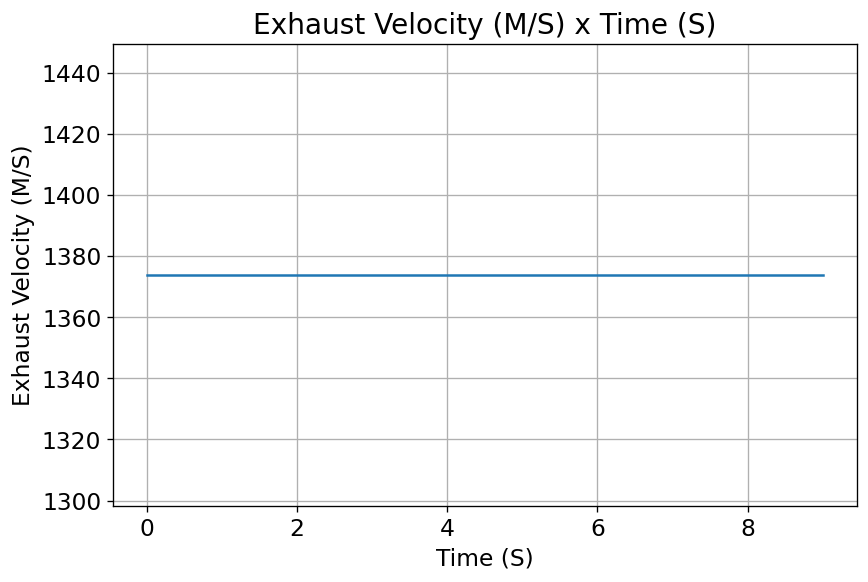

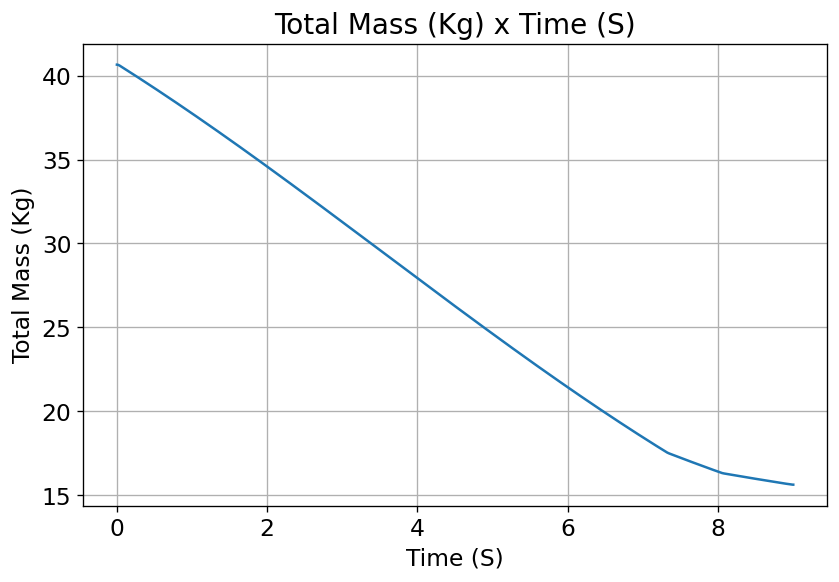

...

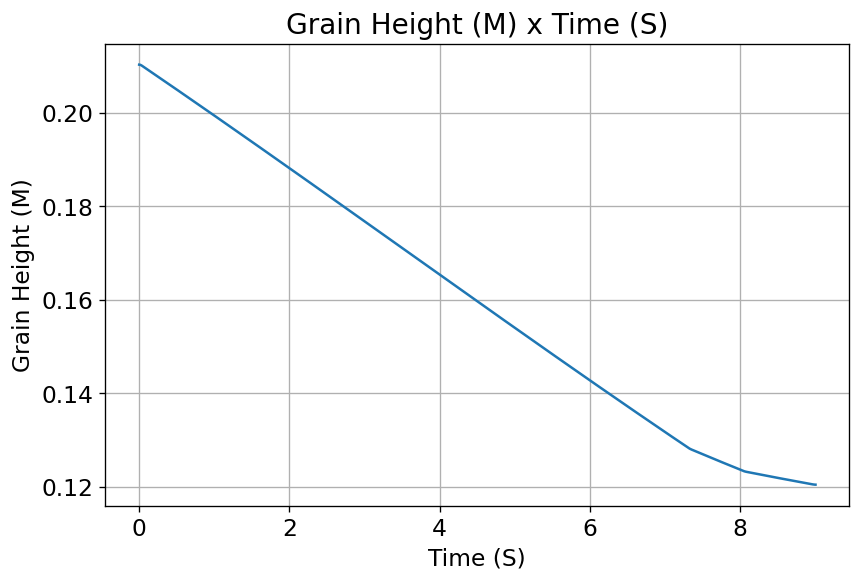

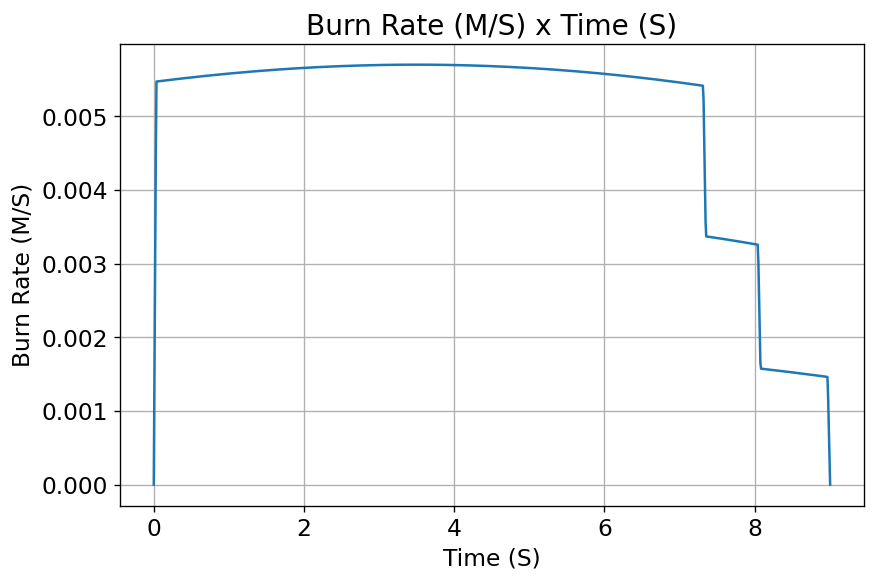

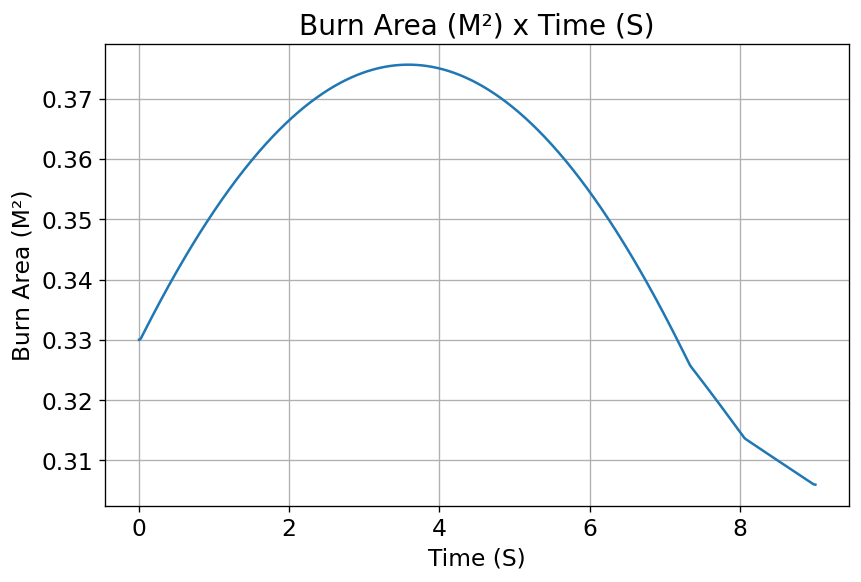

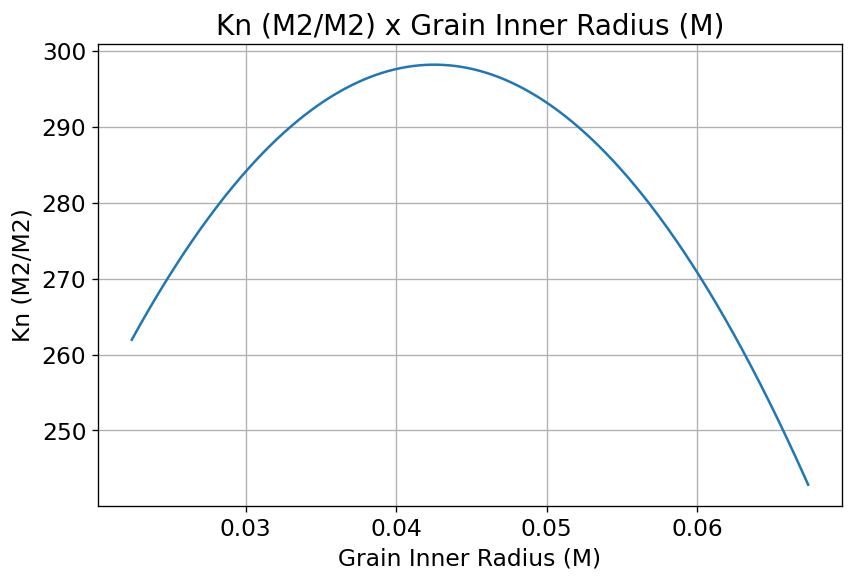

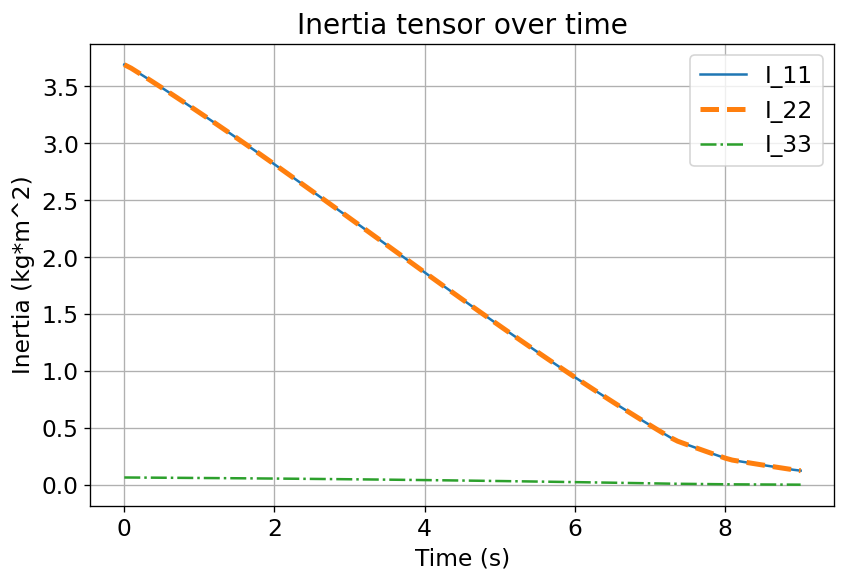

rocketCreated!!!

Inertia Details

Rocket Mass: 54.966 kg (without motor)
Rocket Dry Mass: 70.606 kg (with unloaded motor)
Rocket Loaded Mass: 95.614 kg
Rocket Structural Mass Ratio: 0.738
Rocket Inertia (with unloaded motor) 11: 26.084 kg*m2
Rocket Inertia (with unloaded motor) 22: 75.809 kg*m2
Rocket Inertia (with unloaded motor) 33: 0.002 kg*m2
Rocket Inertia (with unloaded motor) 12: 0.000 kg*m2
Rocket Inertia (with unloaded motor) 13: 0.000 kg*m2
Rocket Inertia (with unloaded motor) 23: 0.000 kg*m2

Geometrical Parameters

Rocket Maximum Radius: 0.07820774757910084 m
Rocket Frontal Area: 0.019215 m2

Rocket Distances
Rocket Center of Dry Mass - Center of Mass without Motor: 0.322 m
Rocket Center of Dry Mass - Nozzle Exit: 1.680 m
Rocket Center of Dry Mass - Center of Propellant Mass: 1.120 m
Rocket Center of Mass - Rocket Loaded Center of Mass: 0.293 m


Aerodynamics Lift Coefficient Derivatives

Nose Cone Lift Coefficient Derivative: 2.000/rad
Fins Lift Coefficient Derivative: 8.

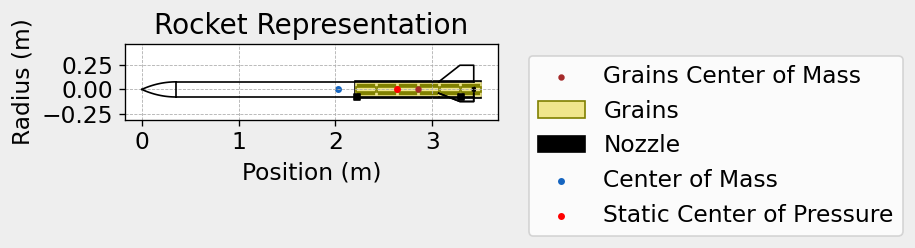


Mass Plots
----------------------------------------


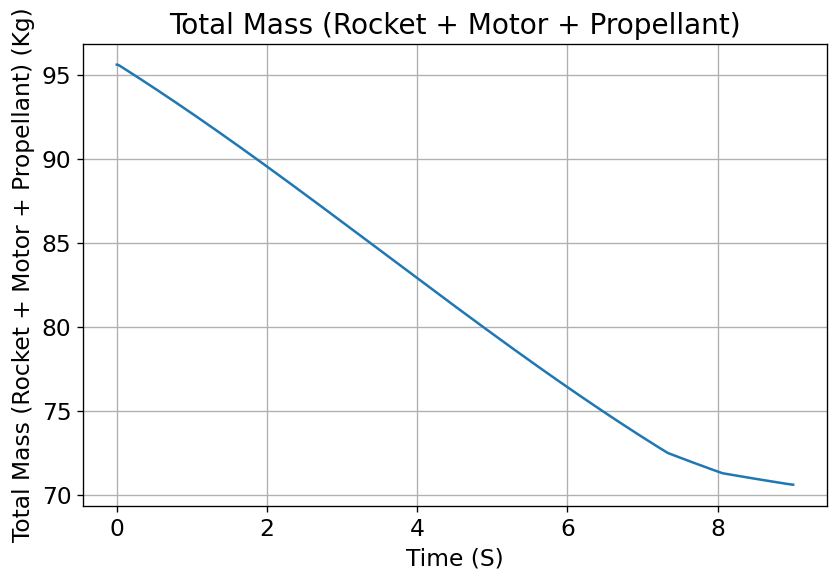

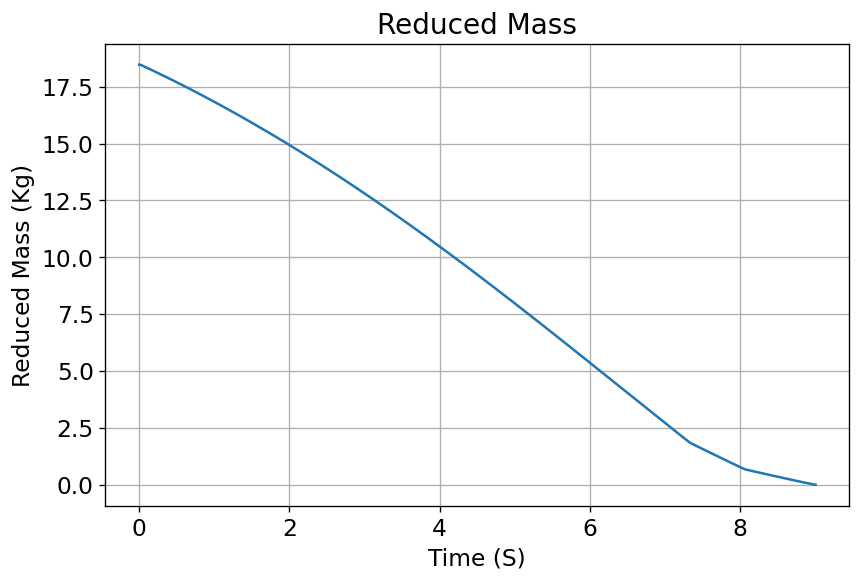


Aerodynamics Plots
----------------------------------------
Drag Plots
--------------------


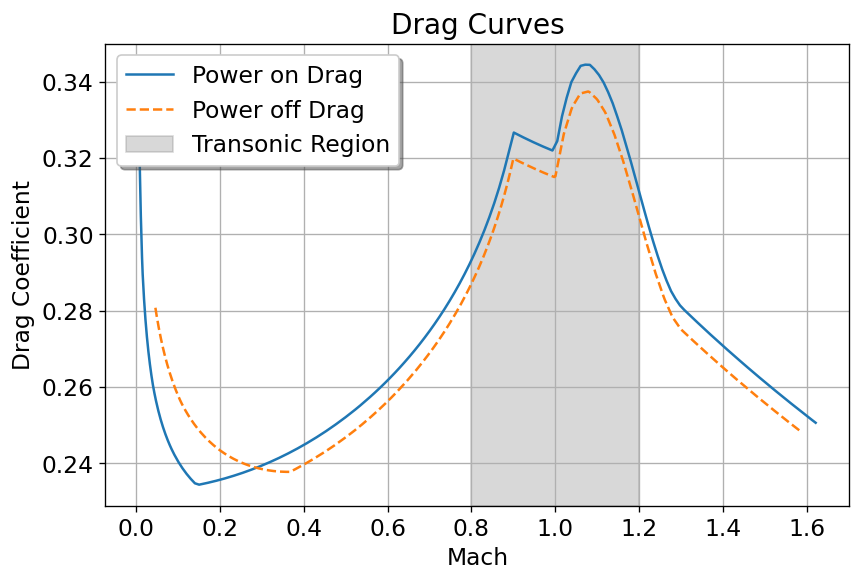


Stability Plots
--------------------


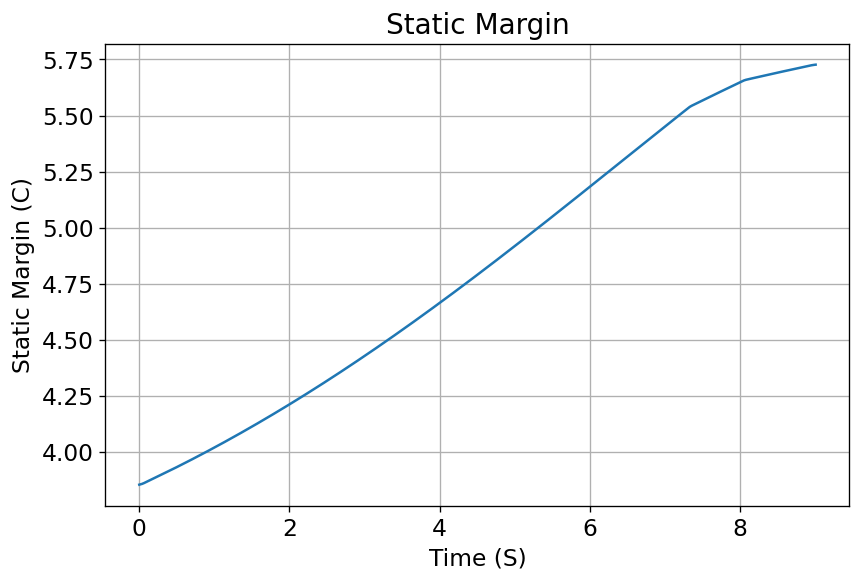

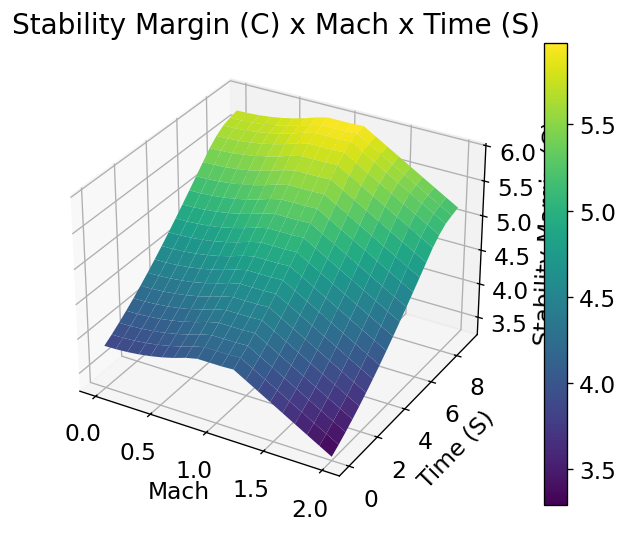


Thrust-to-Weight Plot
----------------------------------------


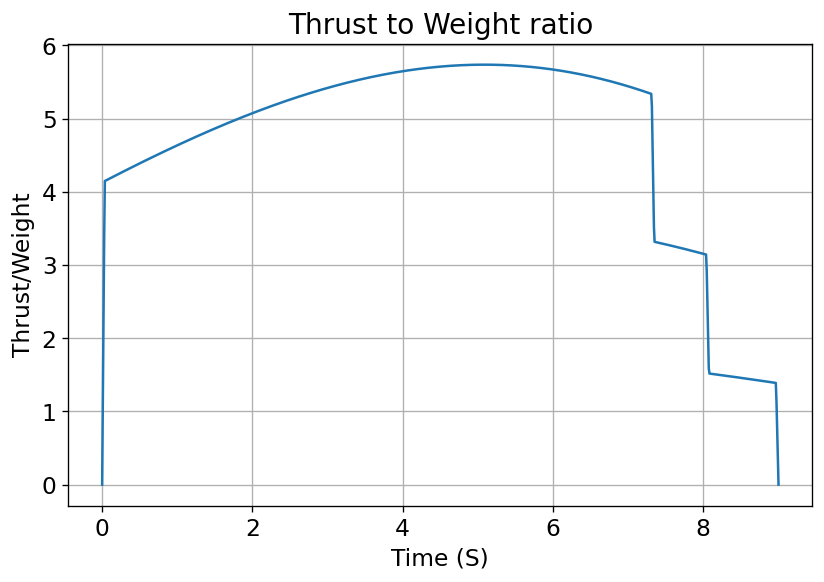

running flight

Initial Conditions

Initial time: 0.000 s
Position - x: 0.00 m | y: 0.00 m | z: 0.00 m
Velocity - Vx: 0.00 m/s | Vy: 0.00 m/s | Vz: 0.00 m/s
Attitude (quaternions) - e0: 0.709 | e1: -0.001 | e2: 0.001 | e3: -0.705
Euler Angles - Spin φ : 0.00° | Nutation θ: -0.22° | Precession ψ: -89.62°
Angular Velocity - ω1: 0.00 rad/s | ω2: 0.00 rad/s | ω3: 0.00 rad/s
Initial Stability Margin: 3.854 c


Surface Wind Conditions

Frontal Surface Wind Speed: -1.03 m/s
Lateral Surface Wind Speed: 1.73 m/s


Launch Rail

Launch Rail Length: 5.1816 m
Launch Rail Inclination: 89.78°
Launch Rail Heading: 89.62°


Rail Departure State

Rail Departure Time: 0.523 s
Rail Departure Velocity: 16.112 m/s
Rail Departure Stability Margin: 3.937 c
Rail Departure Angle of Attack: 7.116°
Rail Departure Thrust-Weight Ratio: 4.401
Rail Departure Reynolds Number: 1.665e+05


Burn out State

Burn out time: 9.006 s
Altitude at burn out: 1572.000 m (ASL) | 1572.000 m (AGL)
Rocket speed at burn out: 312.779 m

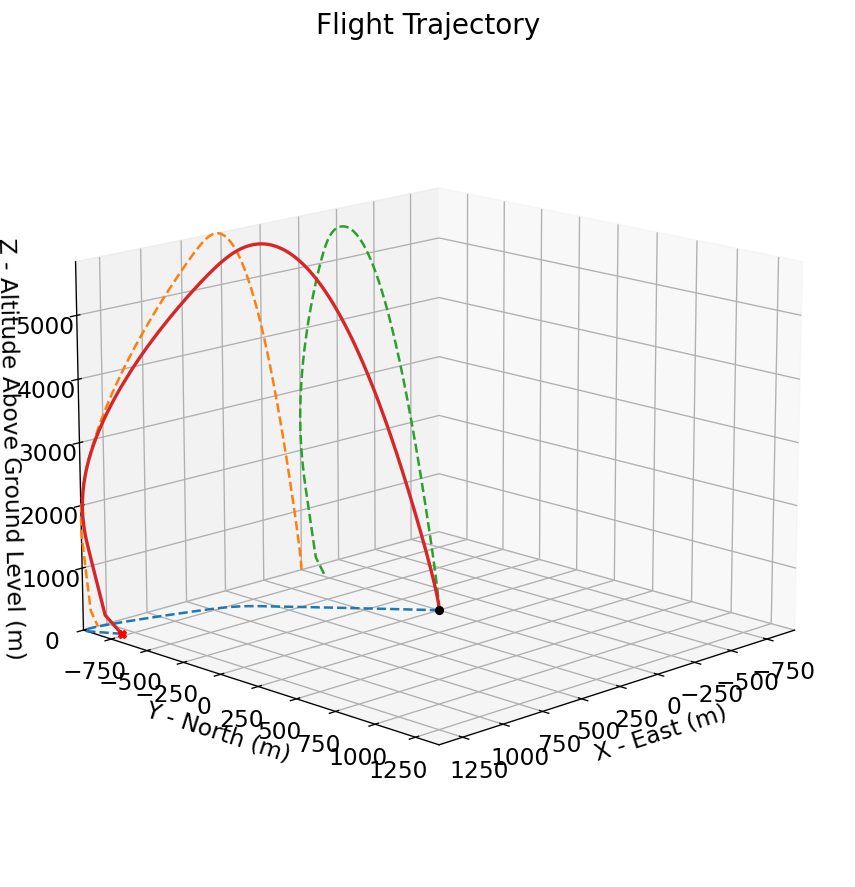



Trajectory Kinematic Plots



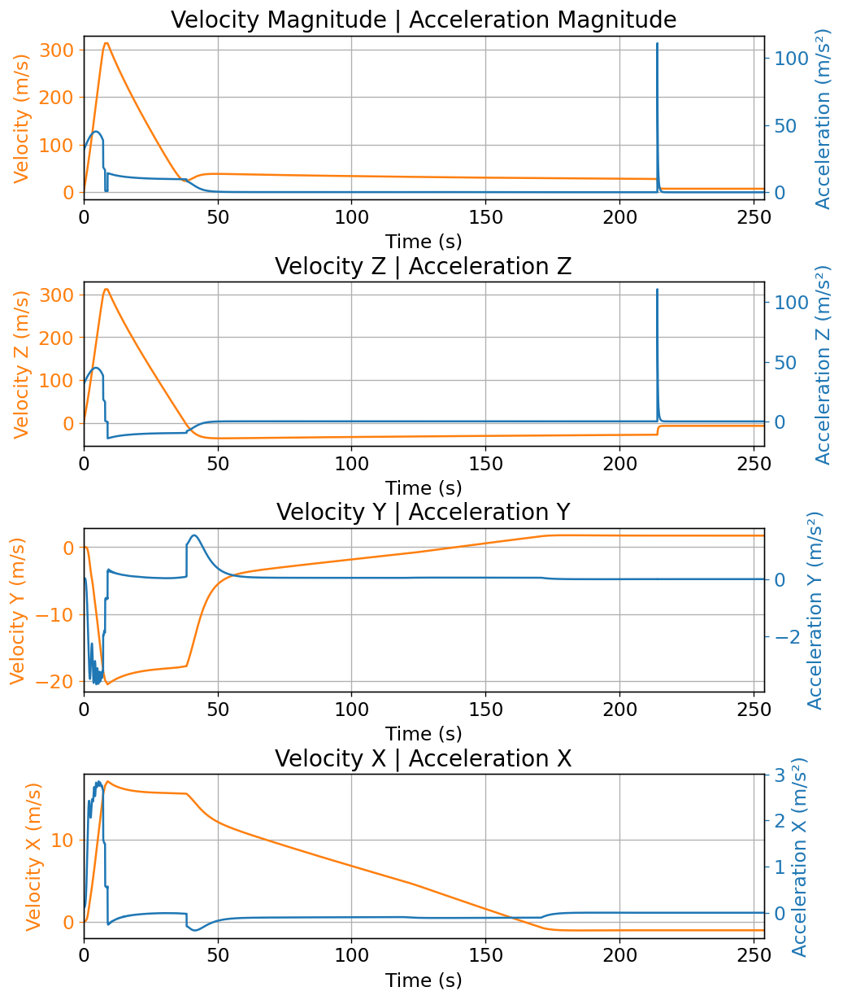



Angular Position Plots



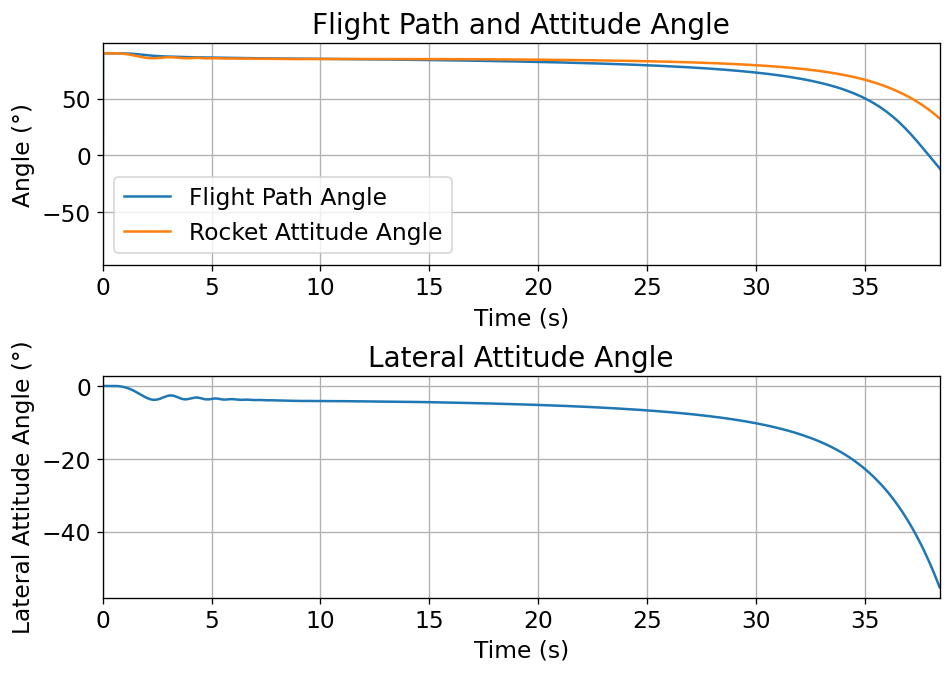



Path, Attitude and Lateral Attitude Angle plots



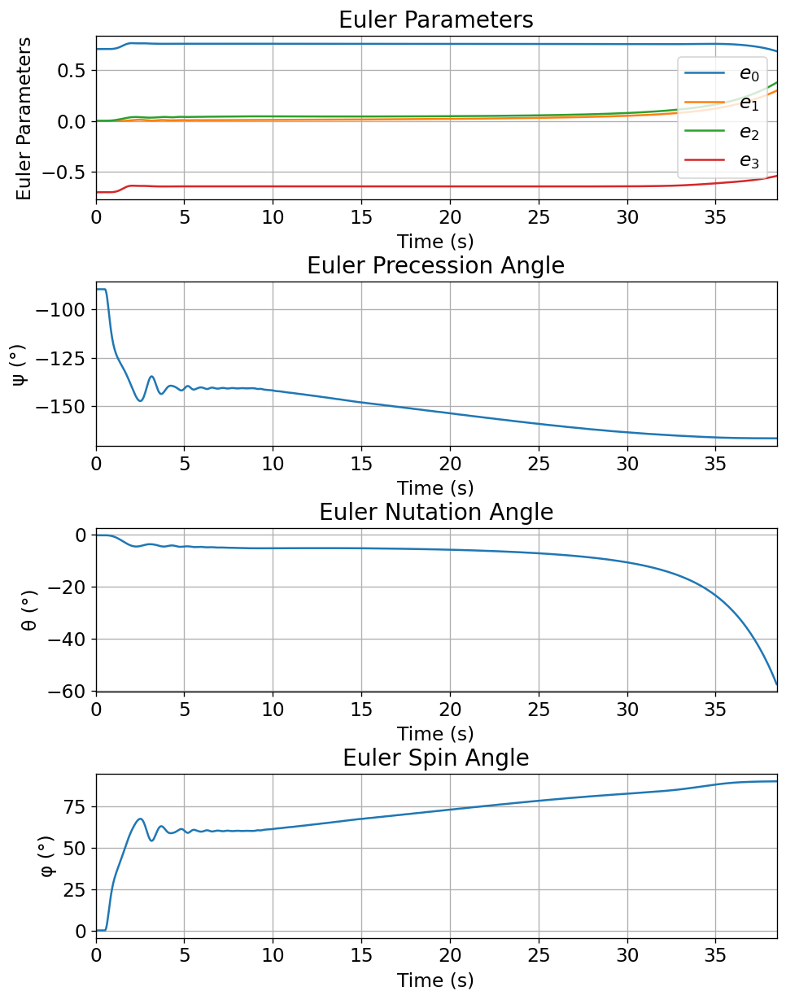



Trajectory Angular Velocity and Acceleration Plots



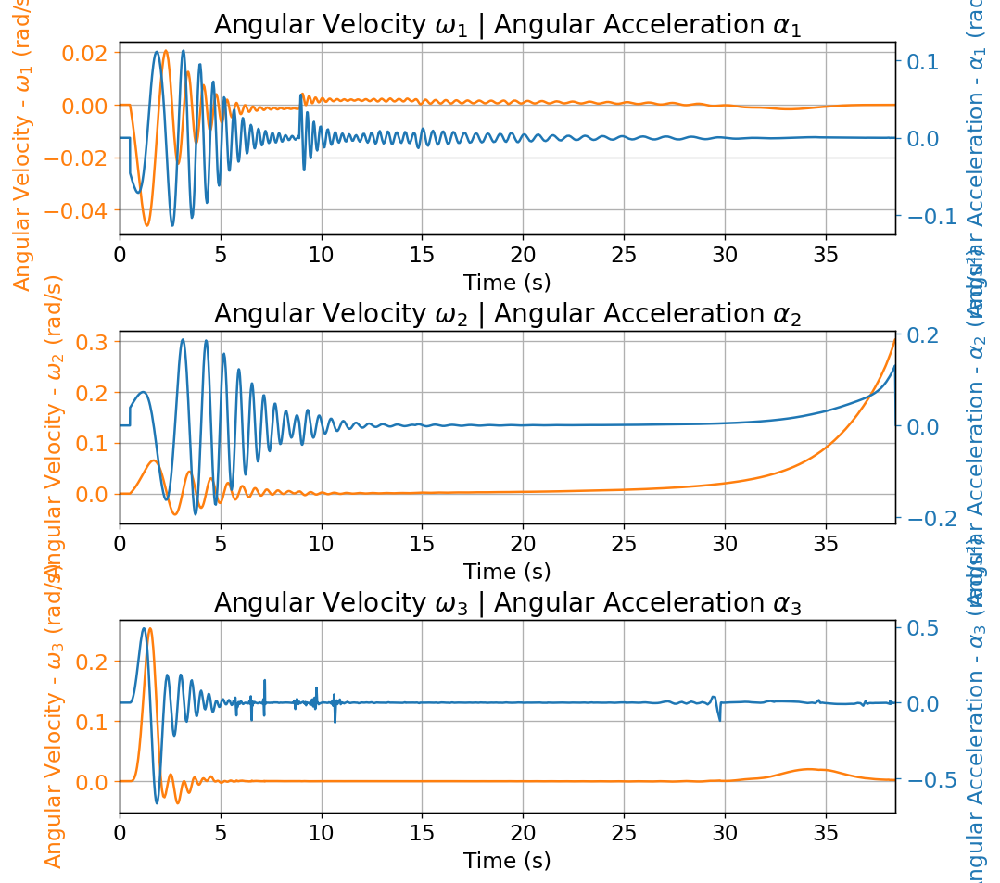



Aerodynamic Forces Plots



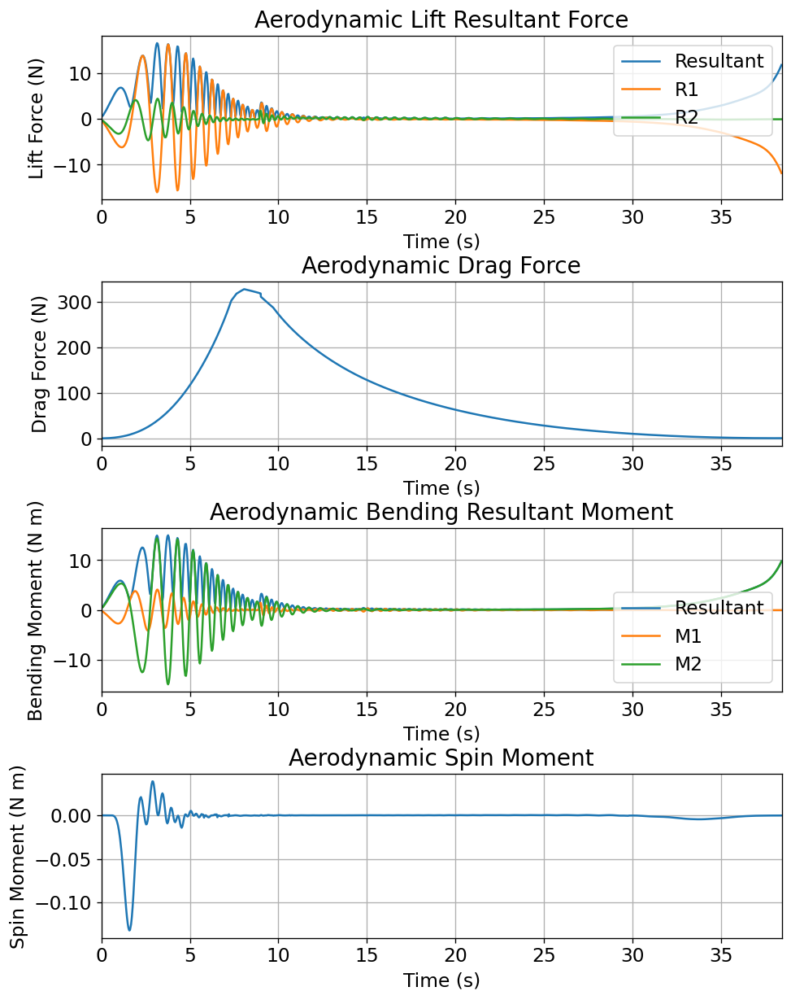



Rail Buttons Forces Plots



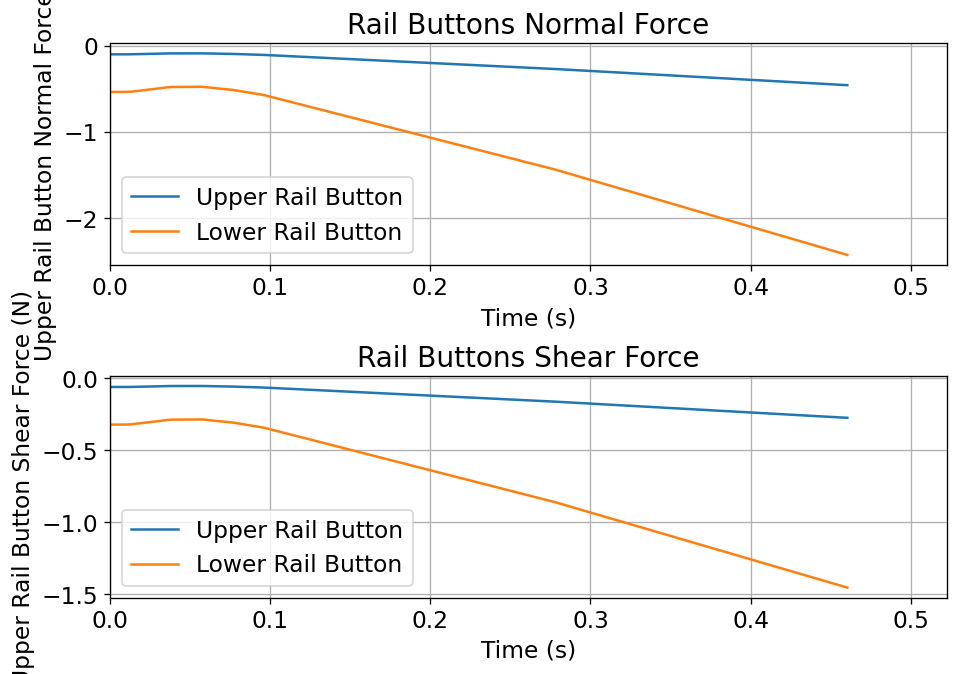



Trajectory Energy Plots



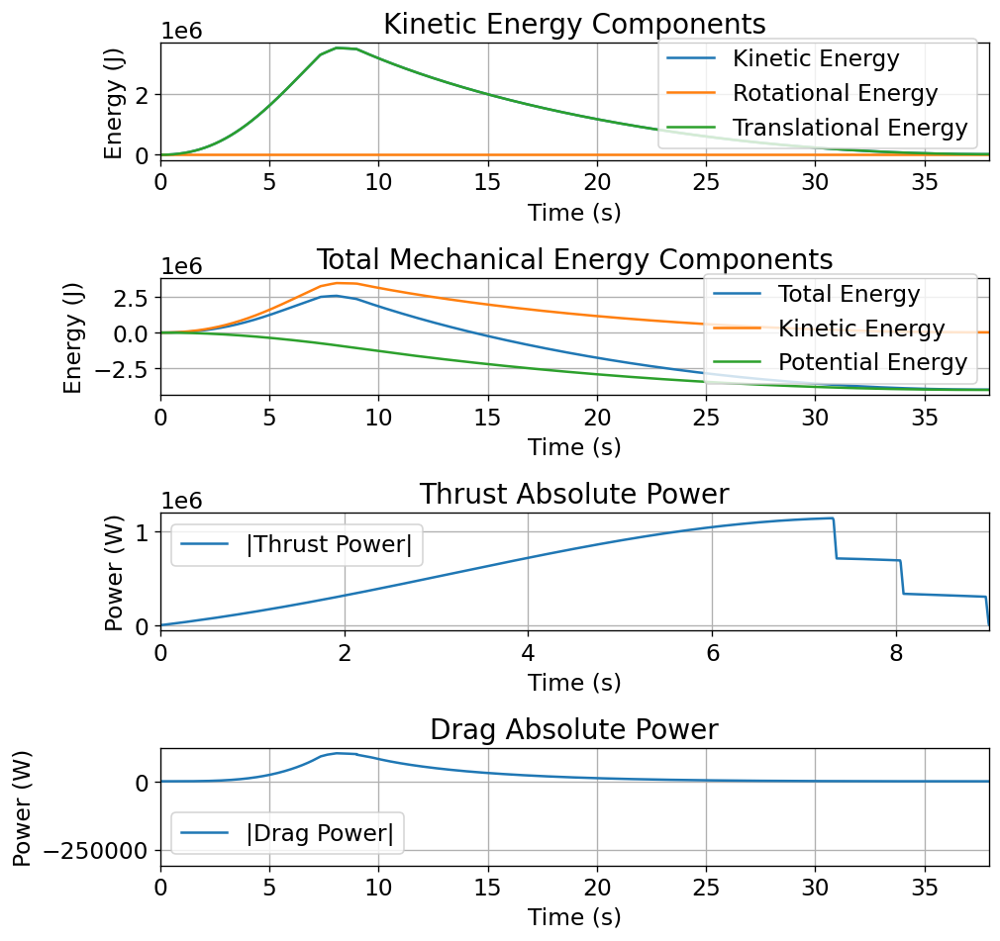



Trajectory Fluid Mechanics Plots



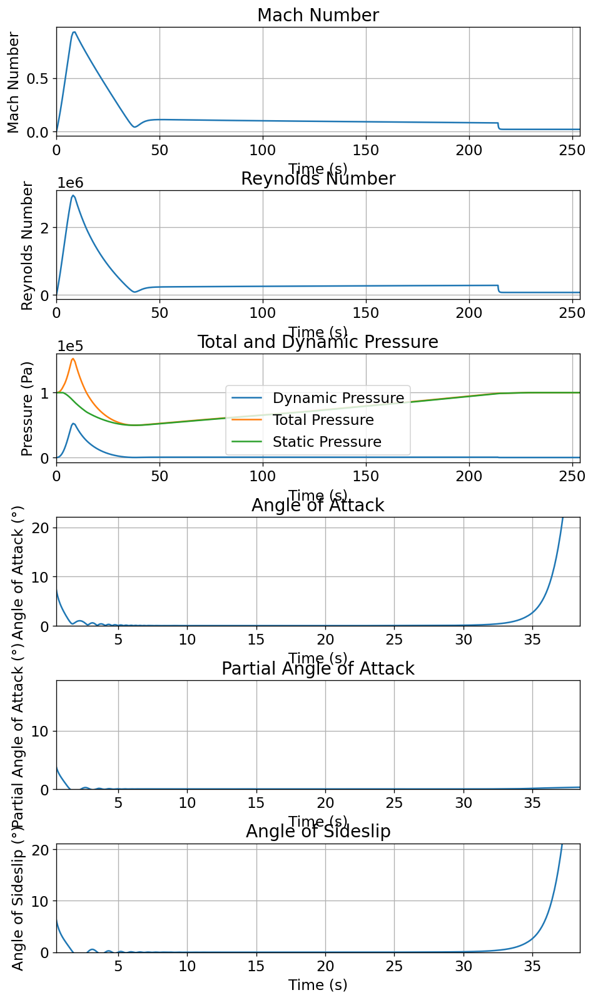



Trajectory Stability and Control Plots



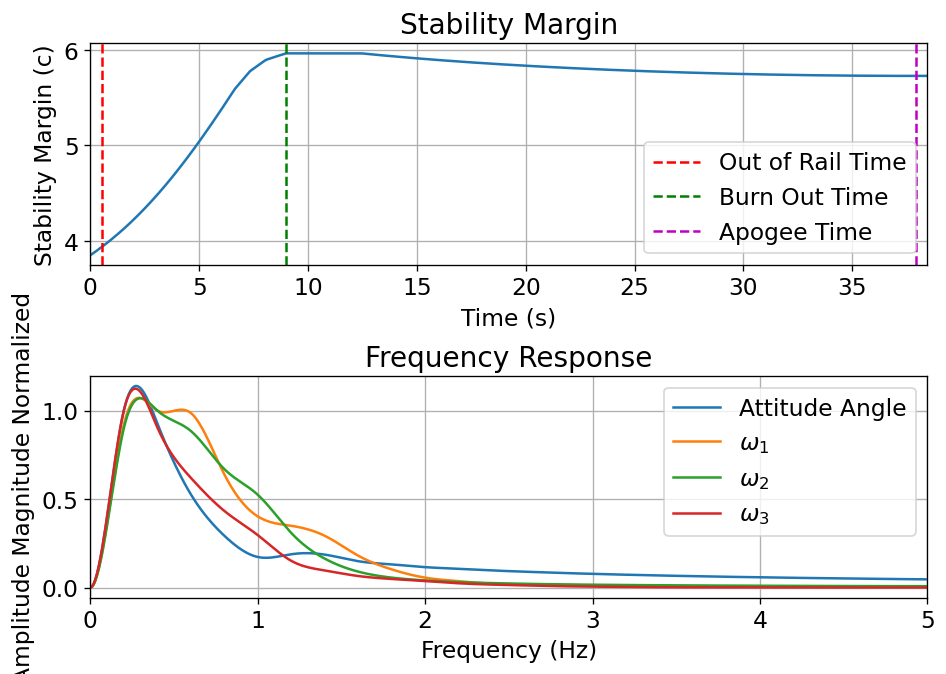



Rocket and Parachute Pressure Plots



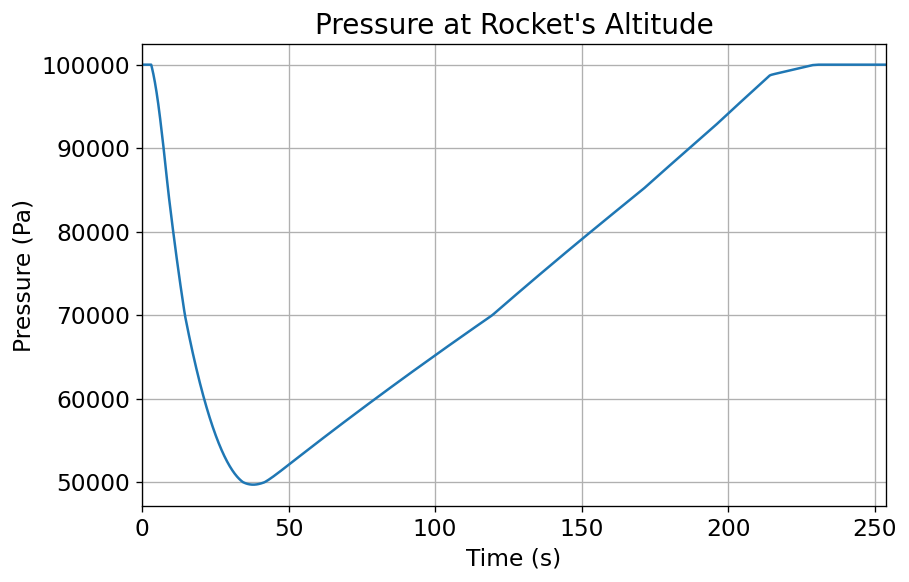


Parachute:  Drogue


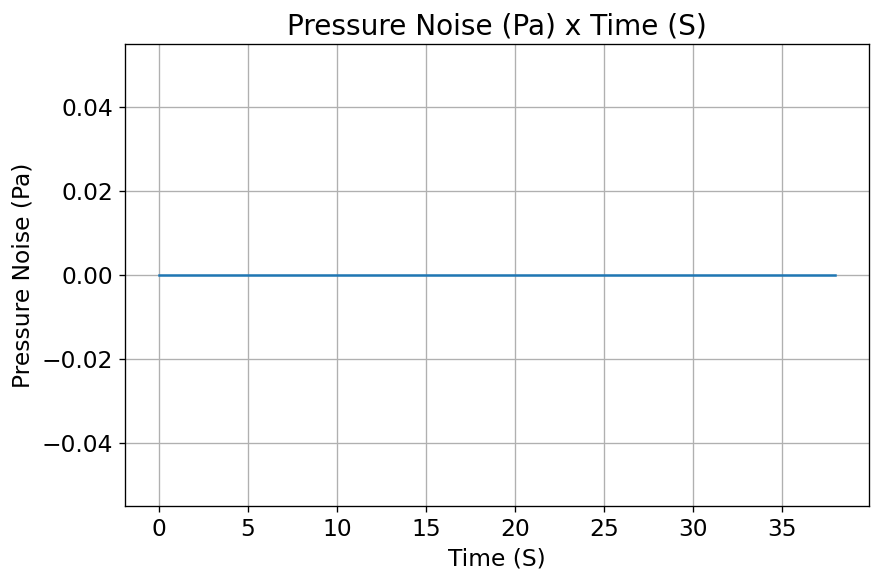

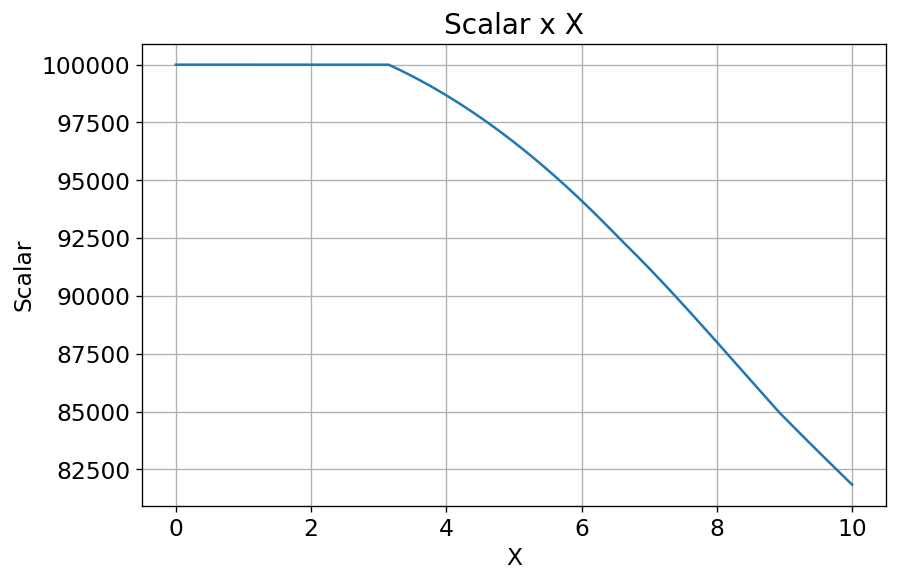

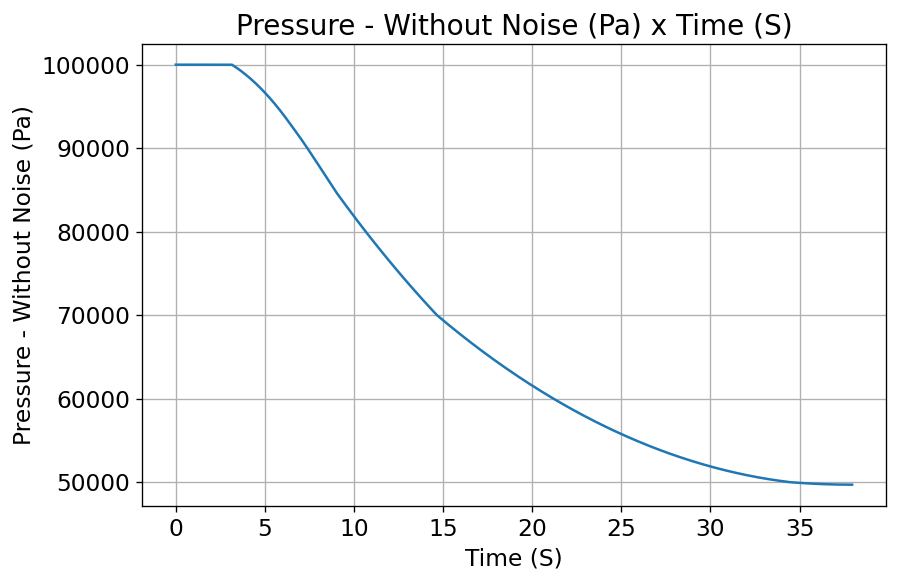


Parachute:  Main


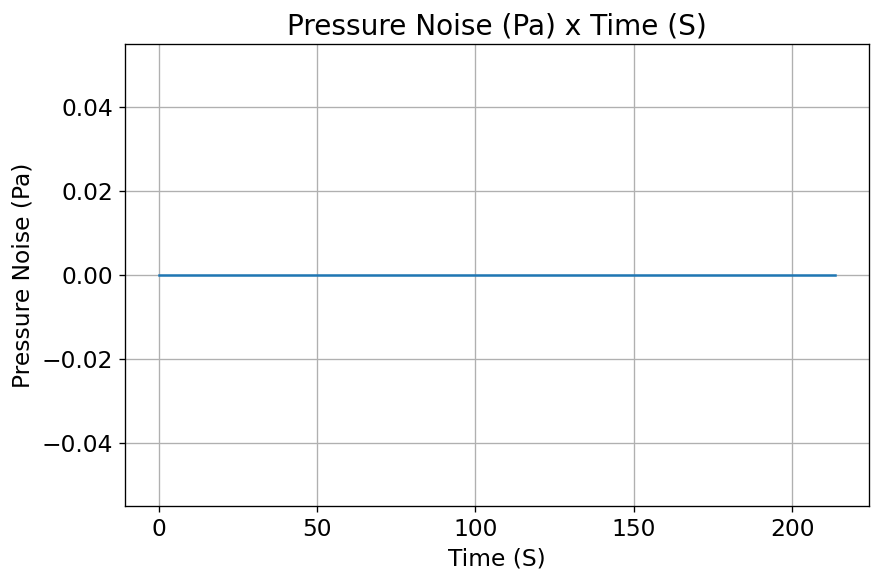

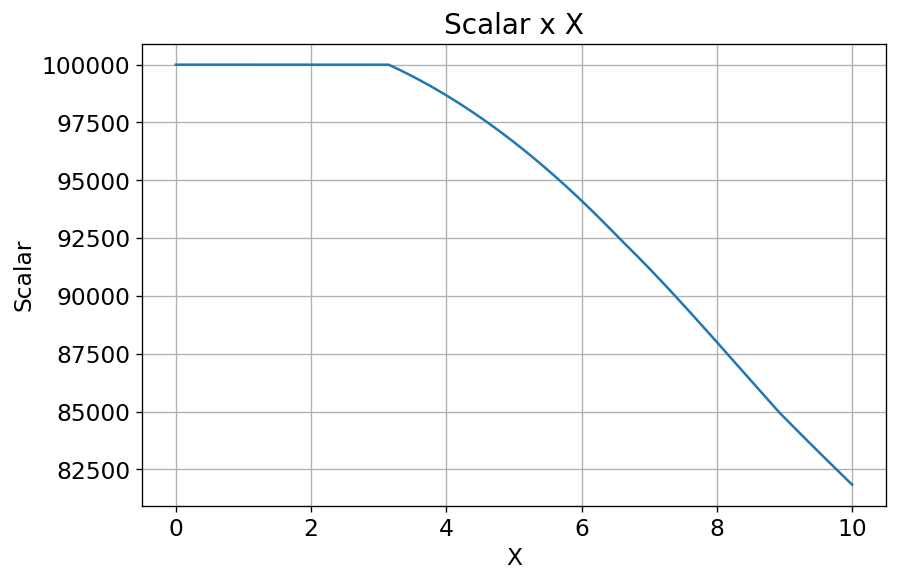

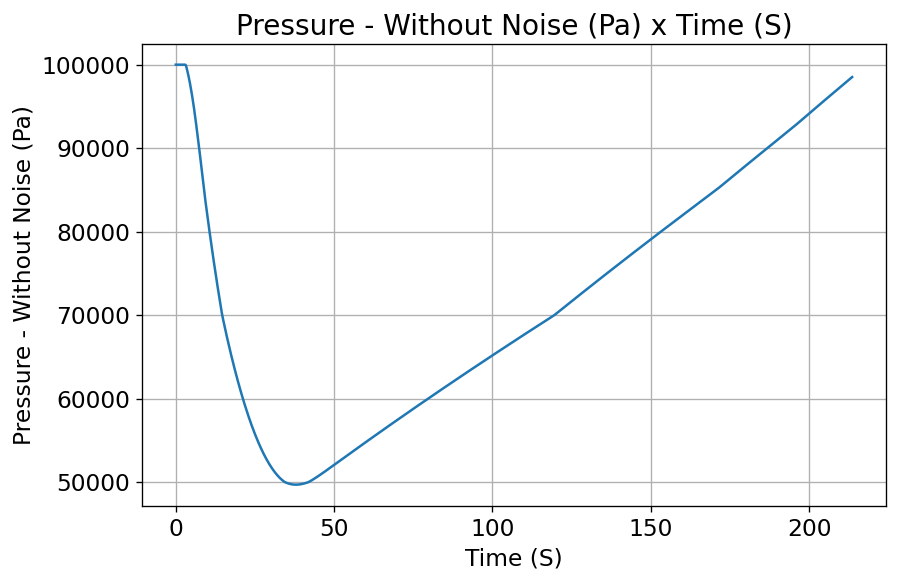

['FlightPhases', 'M1', 'M2', 'M3', 'R1', 'R2', 'R3', 'TimeNodes', '_Flight__cache_sensor_data', '_Flight__calculate_and_save_pressure_signals', '_Flight__calculate_rail_button_forces', '_Flight__evaluate_post_process', '_Flight__init_controllers', '_Flight__init_equations_of_motion', '_Flight__init_flight_state', '_Flight__init_solution_monitors', '_Flight__init_solver_monitors', '_Flight__is_lsoda', '_Flight__post_processed_variables', '_Flight__set_ode_solver', '_Flight__simulate', '_Flight__transform_pressure_signals_lists_to_functions', '__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_controllers', '_solver', 'acceleration', 'aerodynamic_bending_moment', 'aerodynamic_drag', 

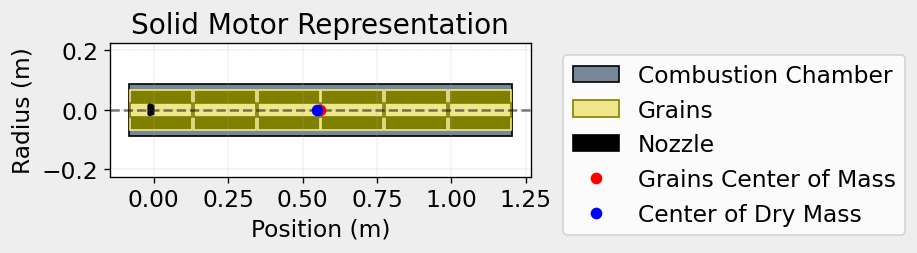

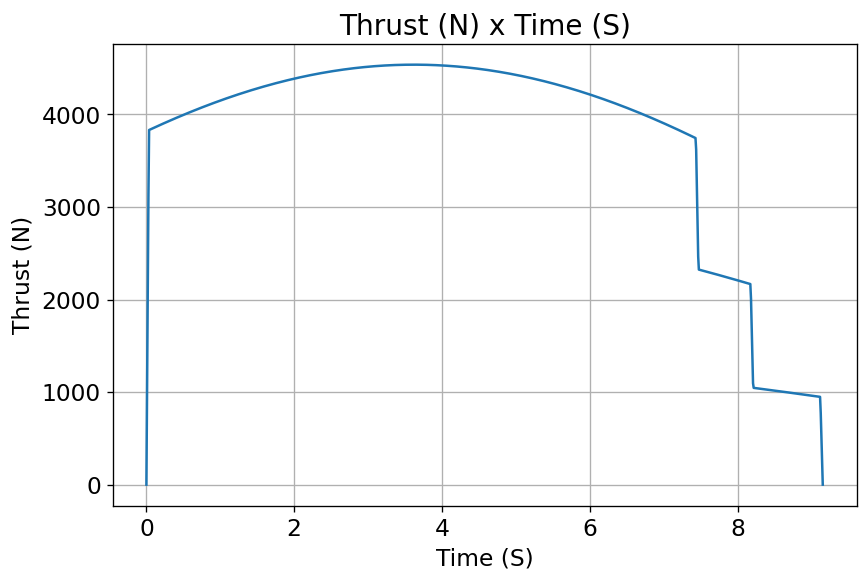

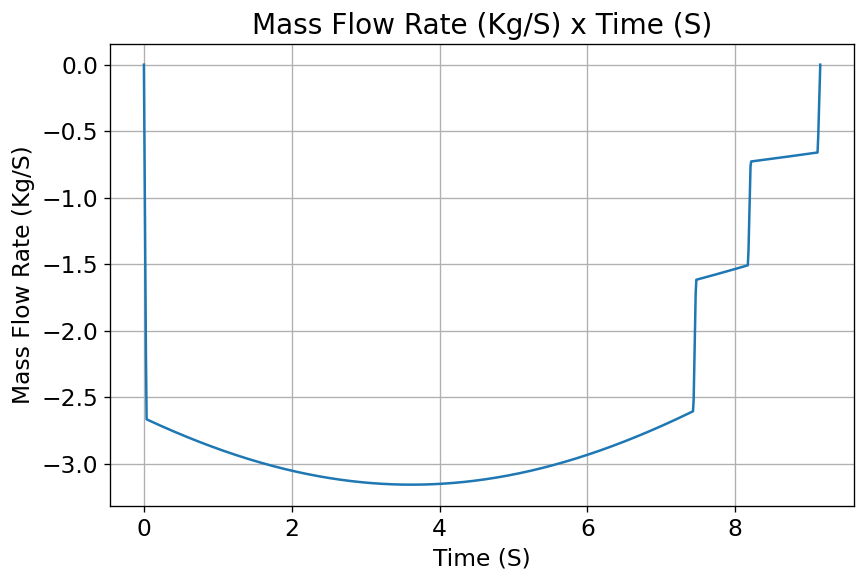

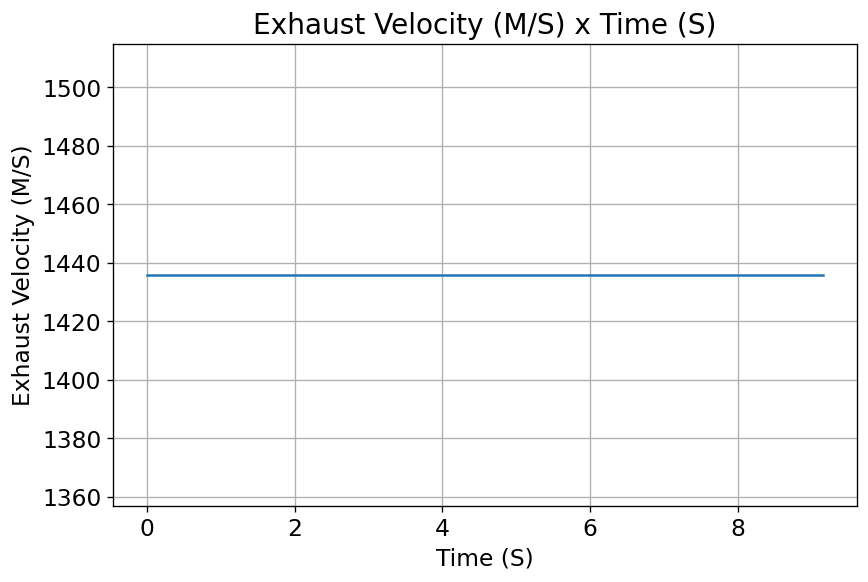

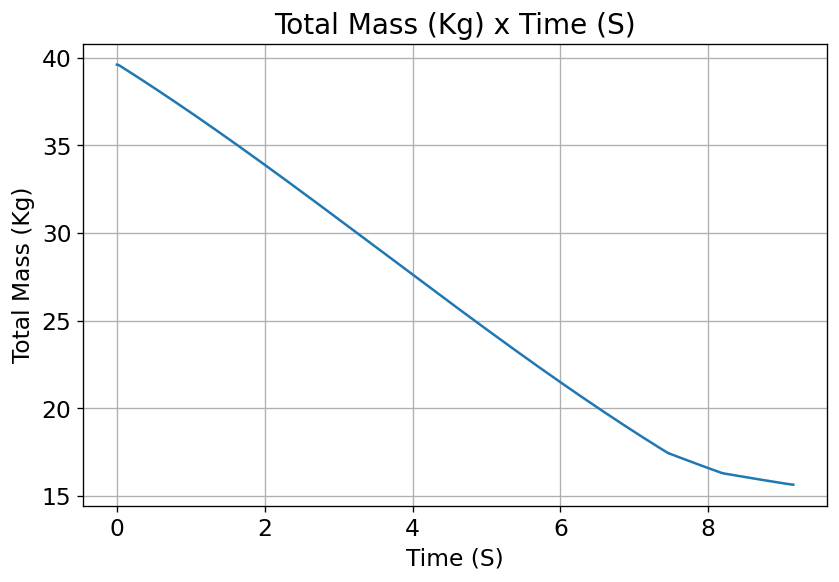

...

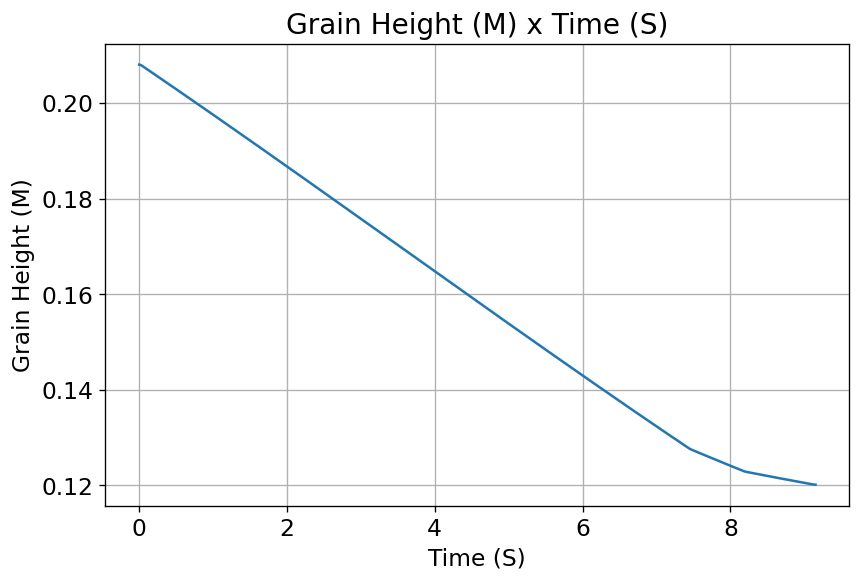

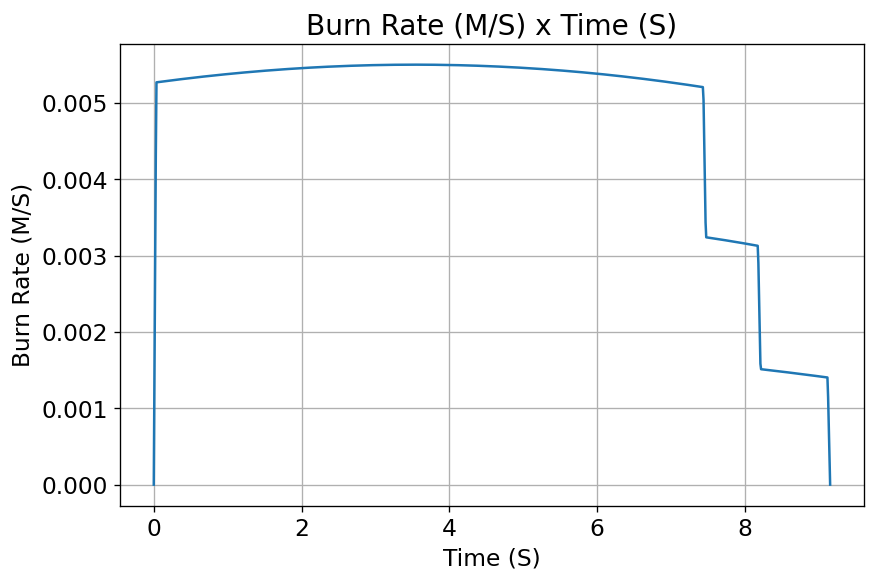

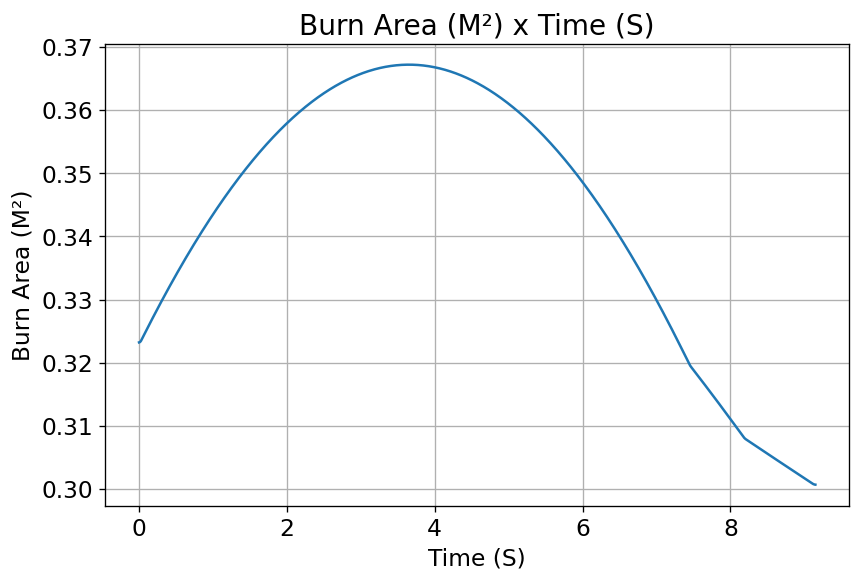

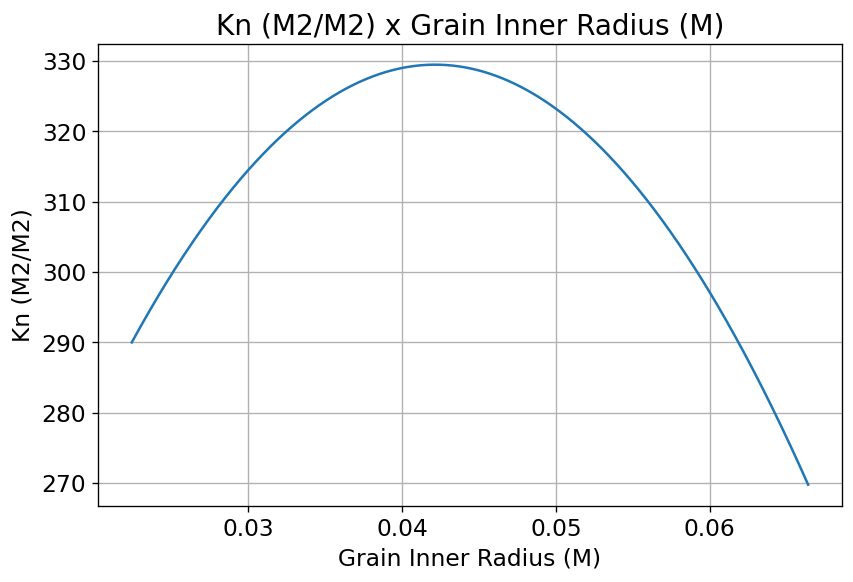

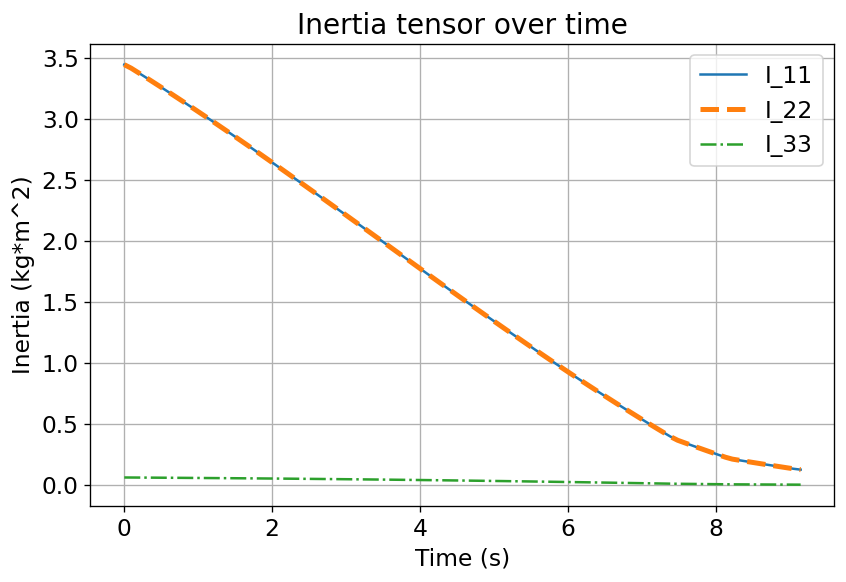

rocketCreated!!!

Inertia Details

Rocket Mass: 54.753 kg (without motor)
Rocket Dry Mass: 70.393 kg (with unloaded motor)
Rocket Loaded Mass: 94.350 kg
Rocket Structural Mass Ratio: 0.746
Rocket Inertia (with unloaded motor) 11: 25.983 kg*m2
Rocket Inertia (with unloaded motor) 22: 75.787 kg*m2
Rocket Inertia (with unloaded motor) 33: 0.002 kg*m2
Rocket Inertia (with unloaded motor) 12: 0.000 kg*m2
Rocket Inertia (with unloaded motor) 13: 0.000 kg*m2
Rocket Inertia (with unloaded motor) 23: 0.000 kg*m2

Geometrical Parameters

Rocket Maximum Radius: 0.07940155354628908 m
Rocket Frontal Area: 0.019807 m2

Rocket Distances
Rocket Center of Dry Mass - Center of Mass without Motor: 0.323 m
Rocket Center of Dry Mass - Nozzle Exit: 1.679 m
Rocket Center of Dry Mass - Center of Propellant Mass: 1.119 m
Rocket Center of Mass - Rocket Loaded Center of Mass: 0.284 m


Aerodynamics Lift Coefficient Derivatives

Nose Cone Lift Coefficient Derivative: 2.000/rad
Fins Lift Coefficient Derivative: 8.

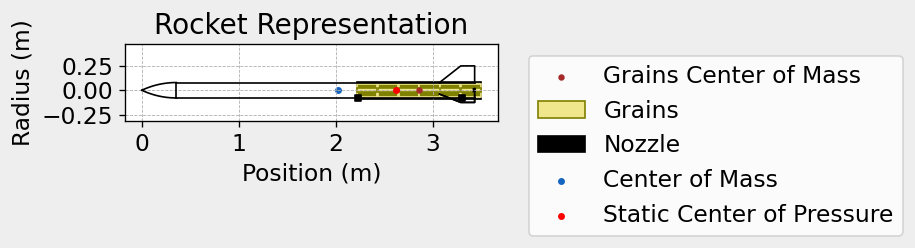


Mass Plots
----------------------------------------


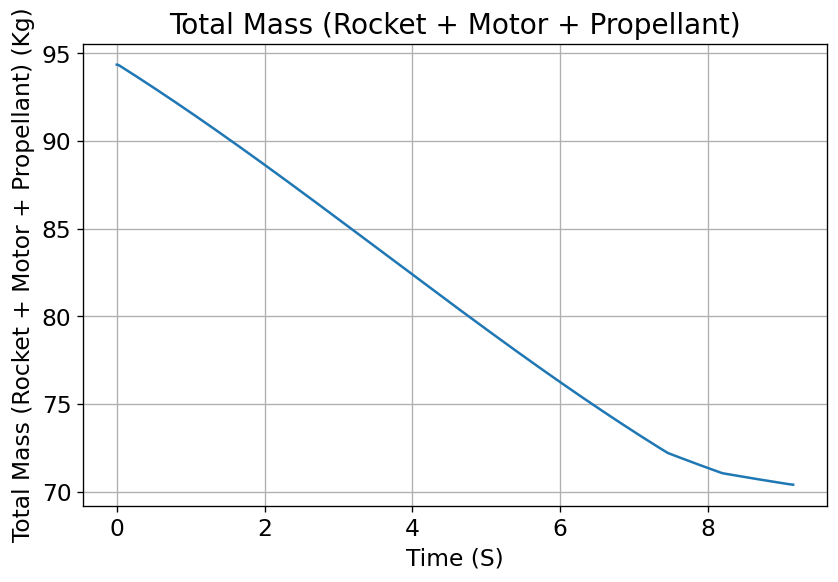

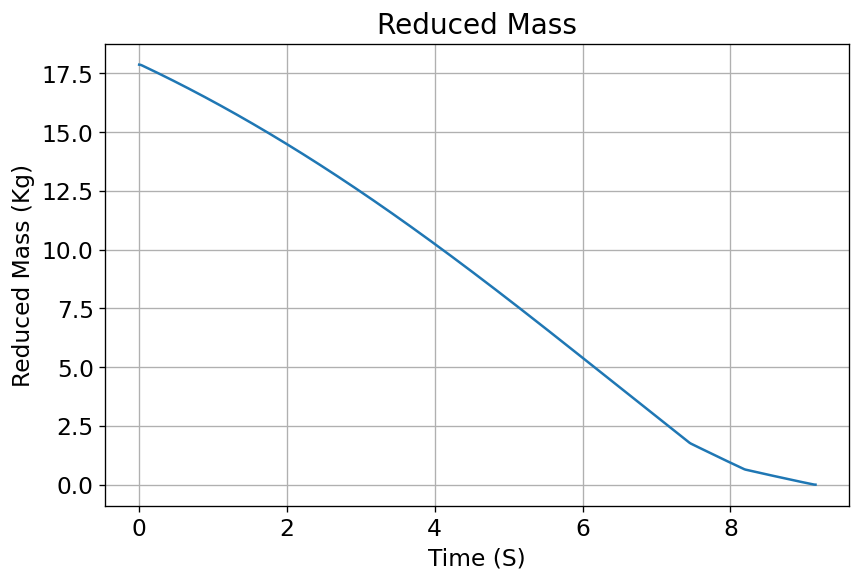


Aerodynamics Plots
----------------------------------------
Drag Plots
--------------------


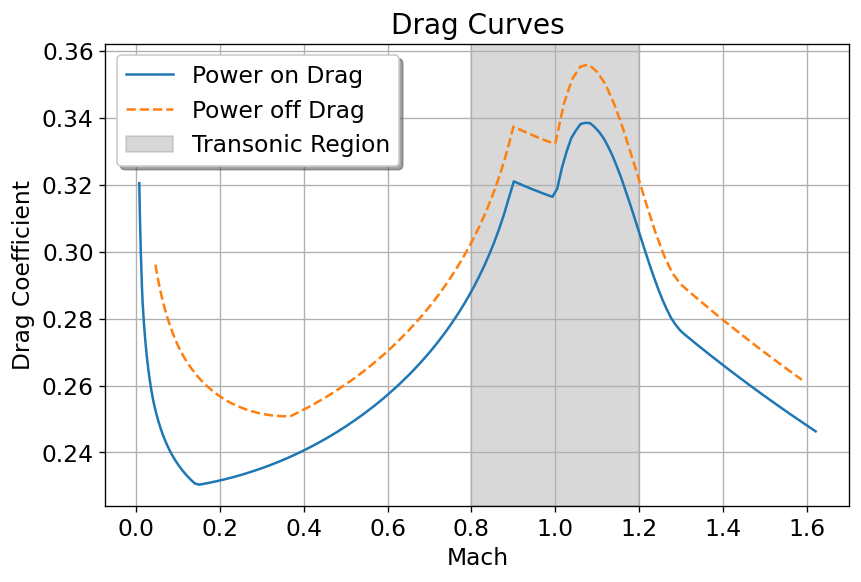


Stability Plots
--------------------


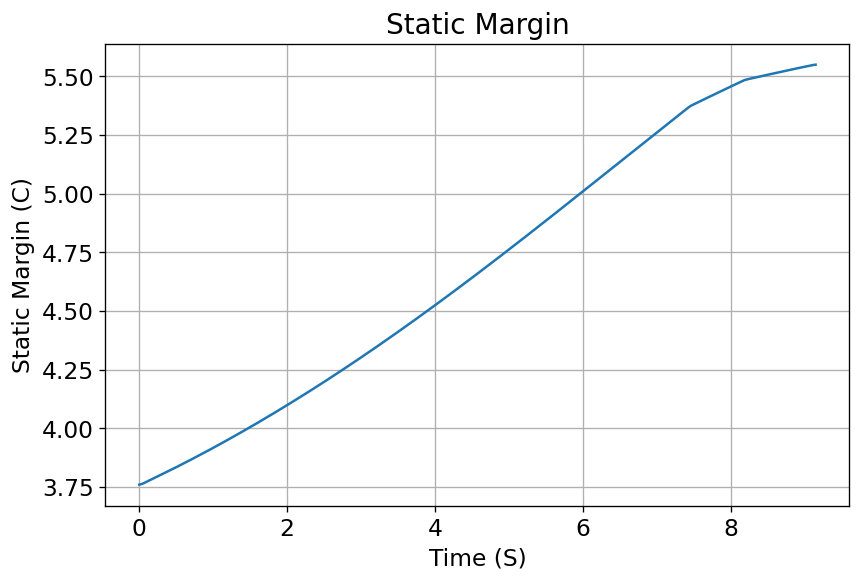

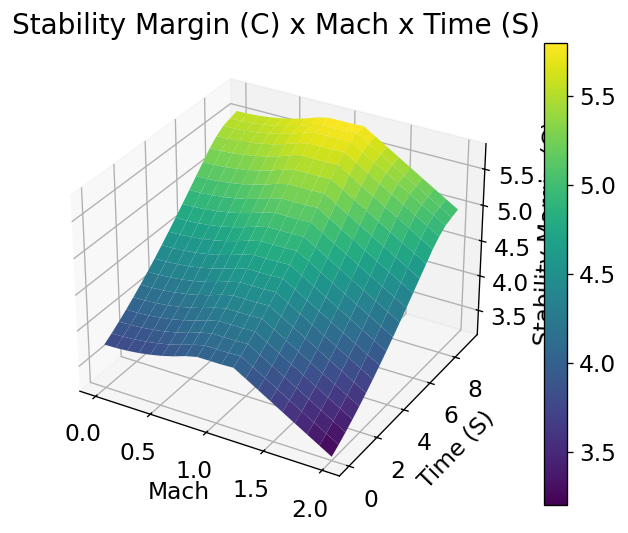


Thrust-to-Weight Plot
----------------------------------------


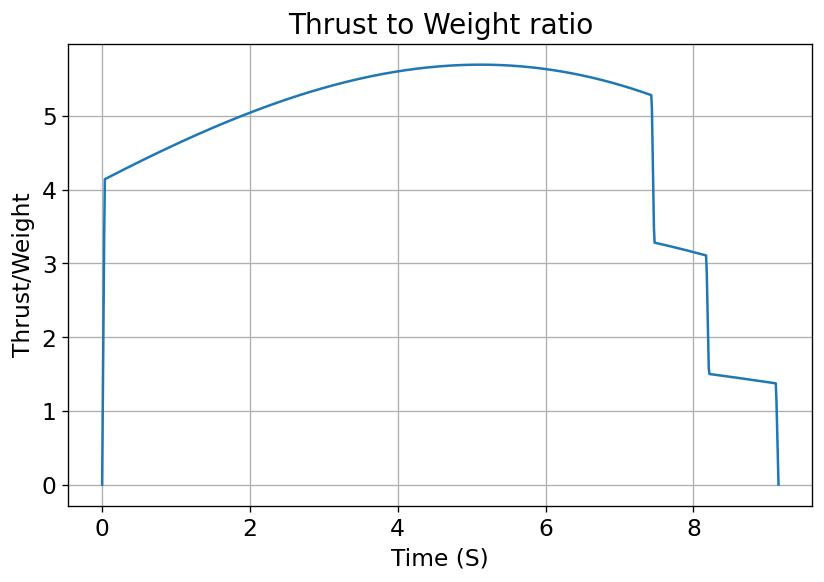

running flight

Initial Conditions

Initial time: 0.000 s
Position - x: 0.00 m | y: 0.00 m | z: 0.00 m
Velocity - Vx: 0.00 m/s | Vy: 0.00 m/s | Vz: 0.00 m/s
Attitude (quaternions) - e0: 0.695 | e1: 0.006 | e2: -0.006 | e3: -0.719
Euler Angles - Spin φ : -180.00° | Nutation θ: -1.01° | Precession ψ: 88.06°
Angular Velocity - ω1: 0.00 rad/s | ω2: 0.00 rad/s | ω3: 0.00 rad/s
Initial Stability Margin: 3.761 c


Surface Wind Conditions

Frontal Surface Wind Speed: -1.10 m/s
Lateral Surface Wind Speed: 1.68 m/s


Launch Rail

Launch Rail Length: 5.1816 m
Launch Rail Inclination: 91.01°
Launch Rail Heading: 91.94°


Rail Departure State

Rail Departure Time: 0.523 s
Rail Departure Velocity: 16.084 m/s
Rail Departure Stability Margin: 3.839 c
Rail Departure Angle of Attack: 7.138°
Rail Departure Thrust-Weight Ratio: 4.389
Rail Departure Reynolds Number: 1.686e+05


Burn out State

Burn out time: 9.151 s
Altitude at burn out: 1613.118 m (ASL) | 1613.118 m (AGL)
Rocket speed at burn out: 314.560

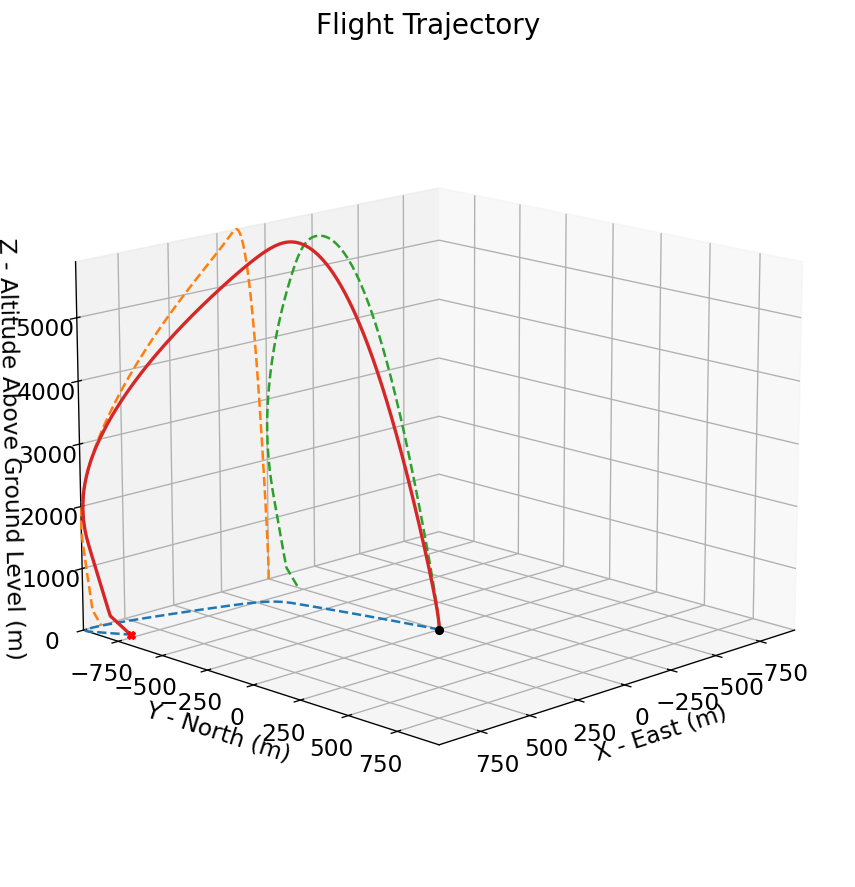



Trajectory Kinematic Plots



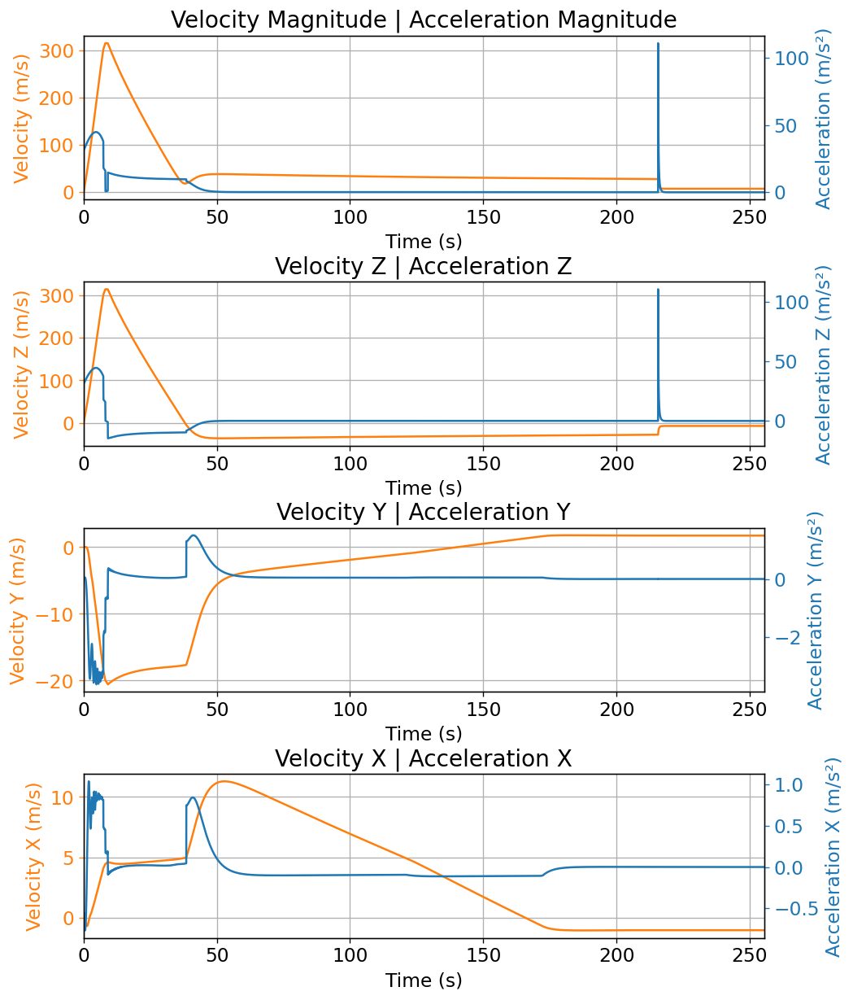



Angular Position Plots



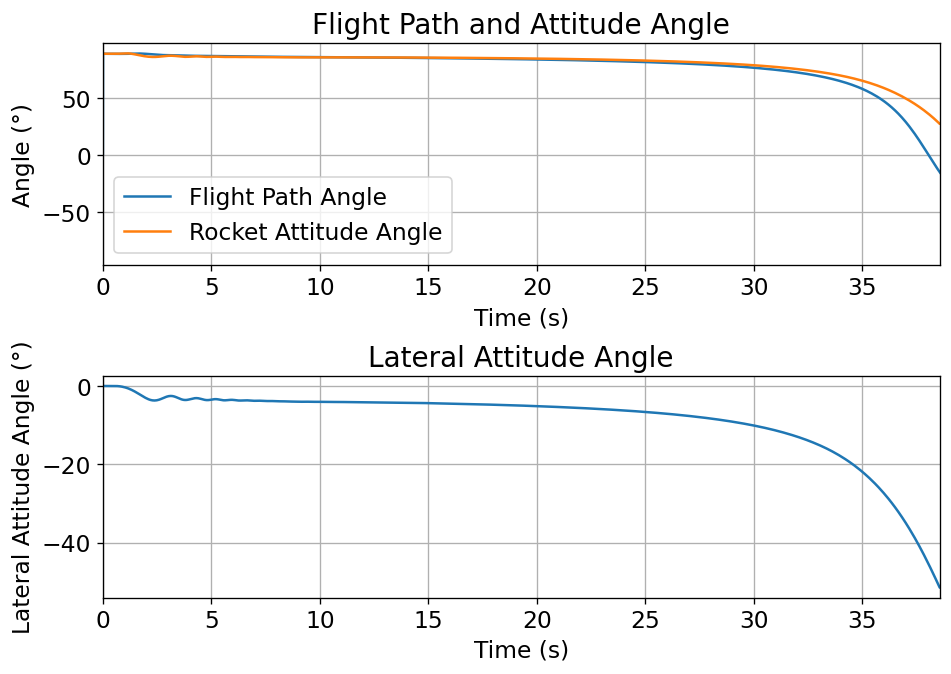



Path, Attitude and Lateral Attitude Angle plots



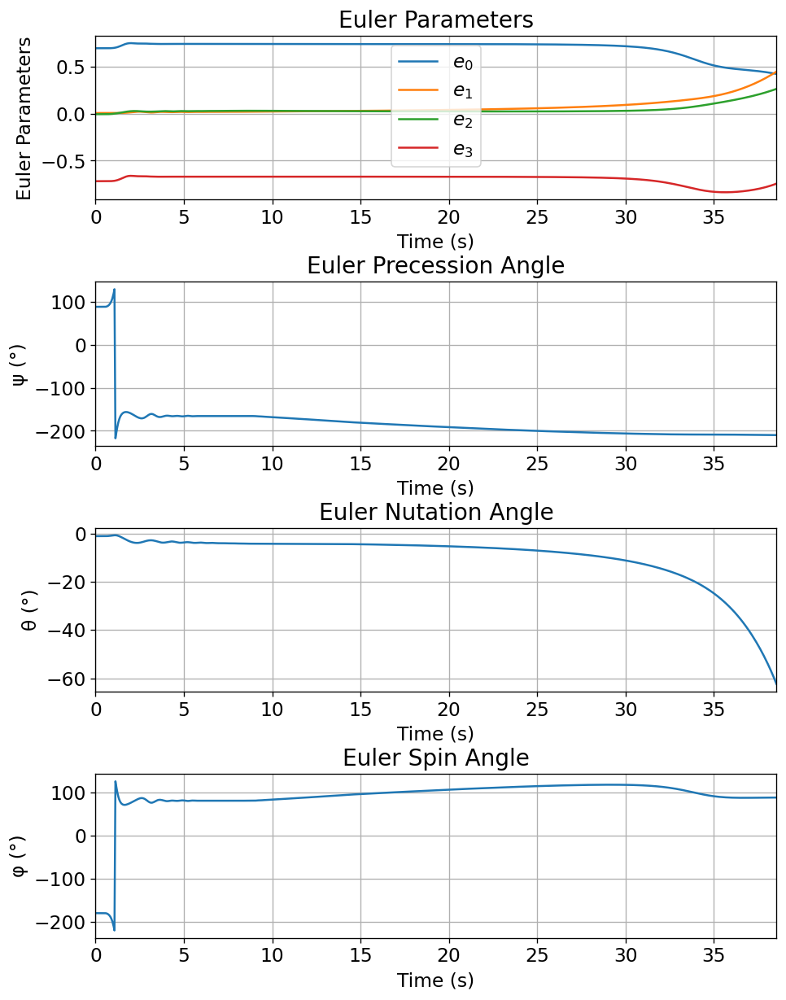



Trajectory Angular Velocity and Acceleration Plots



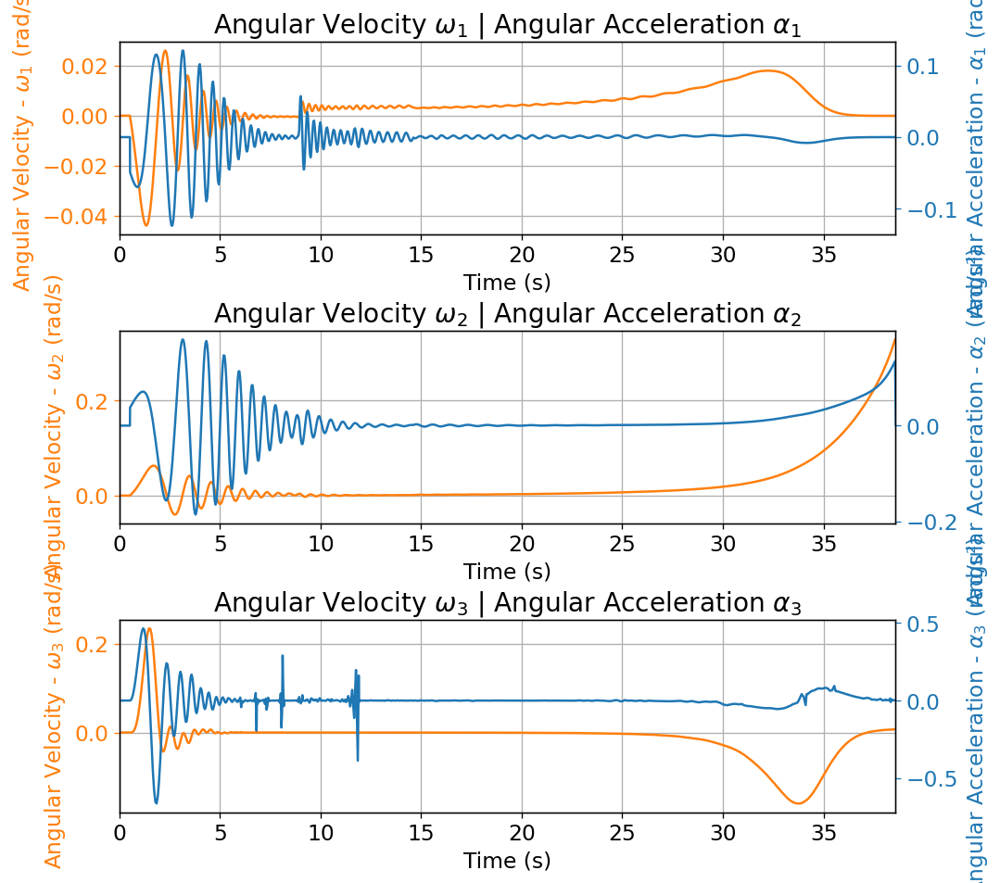



Aerodynamic Forces Plots



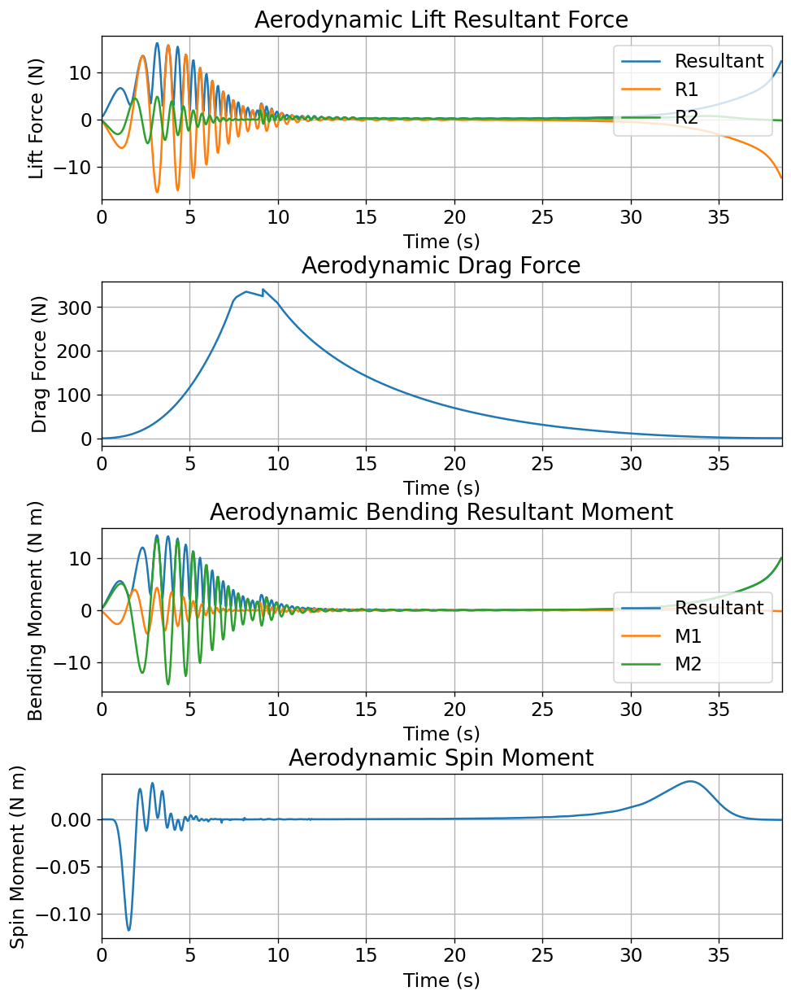



Rail Buttons Forces Plots



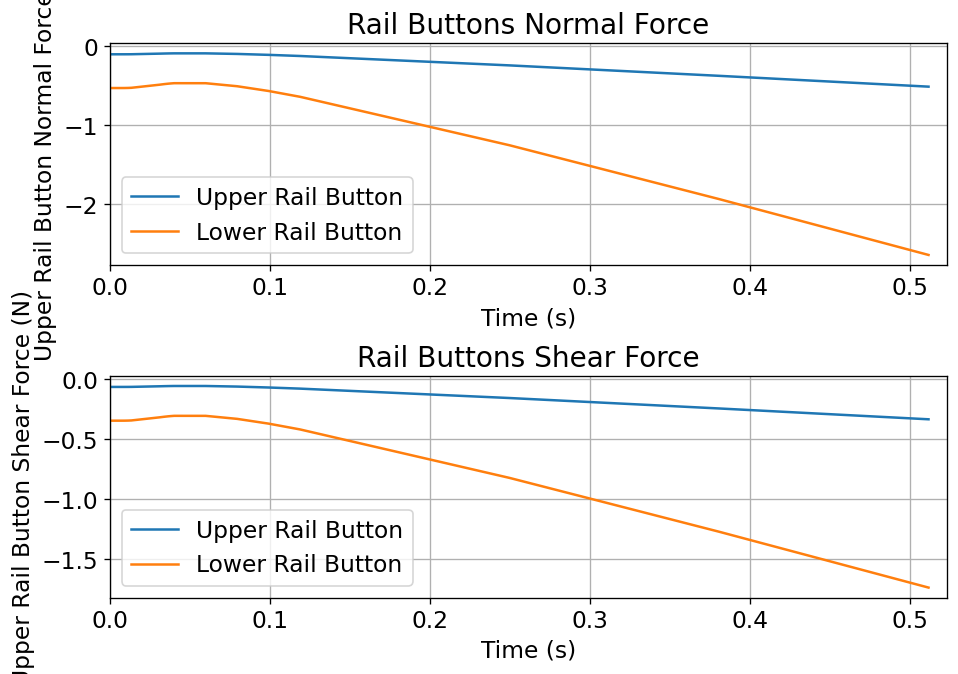



Trajectory Energy Plots



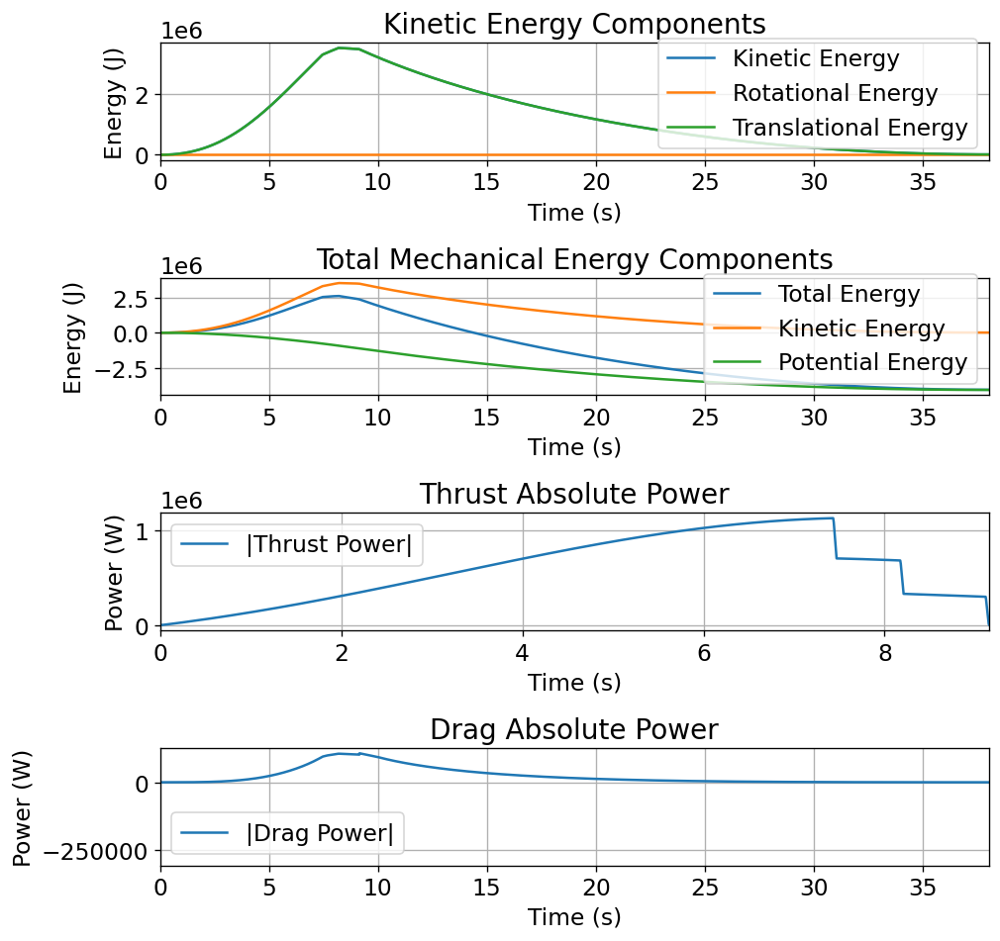



Trajectory Fluid Mechanics Plots



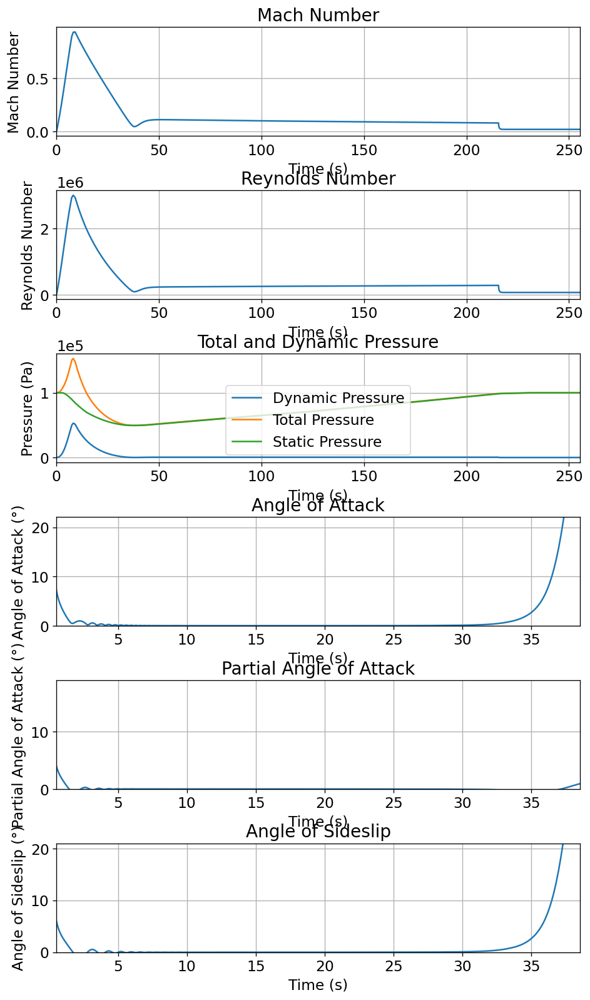



Trajectory Stability and Control Plots



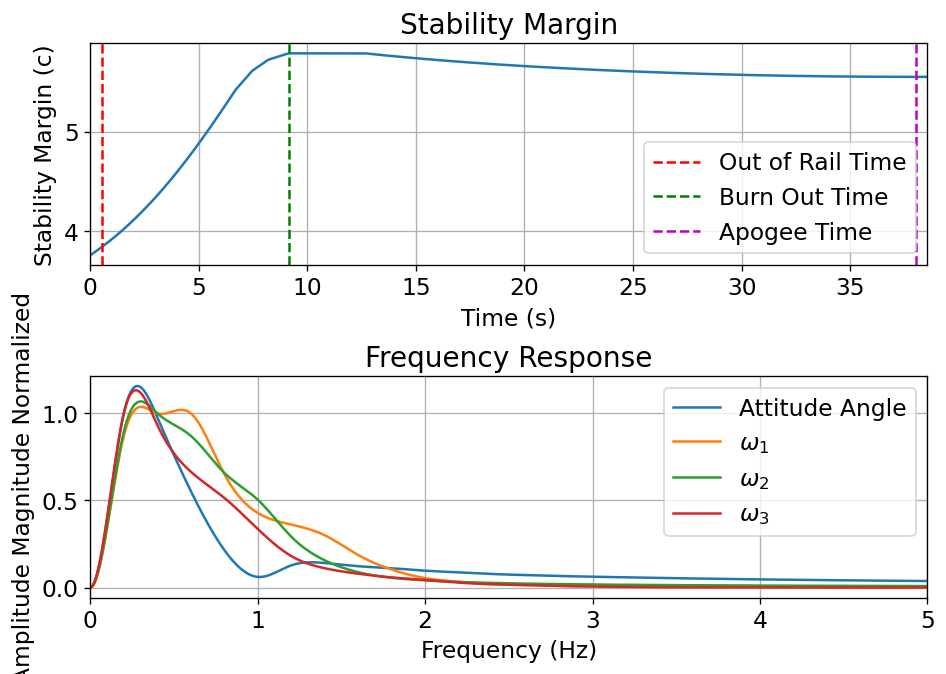



Rocket and Parachute Pressure Plots



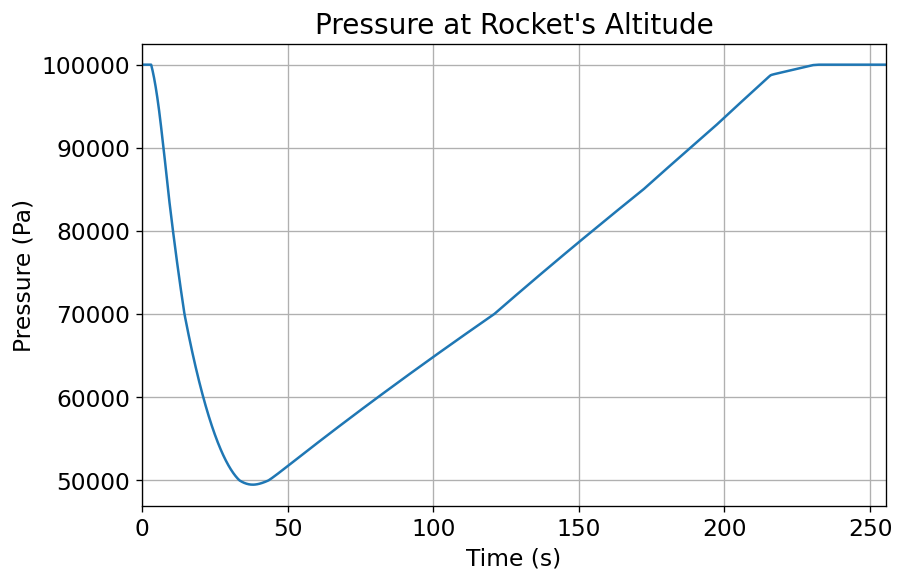


Parachute:  Drogue


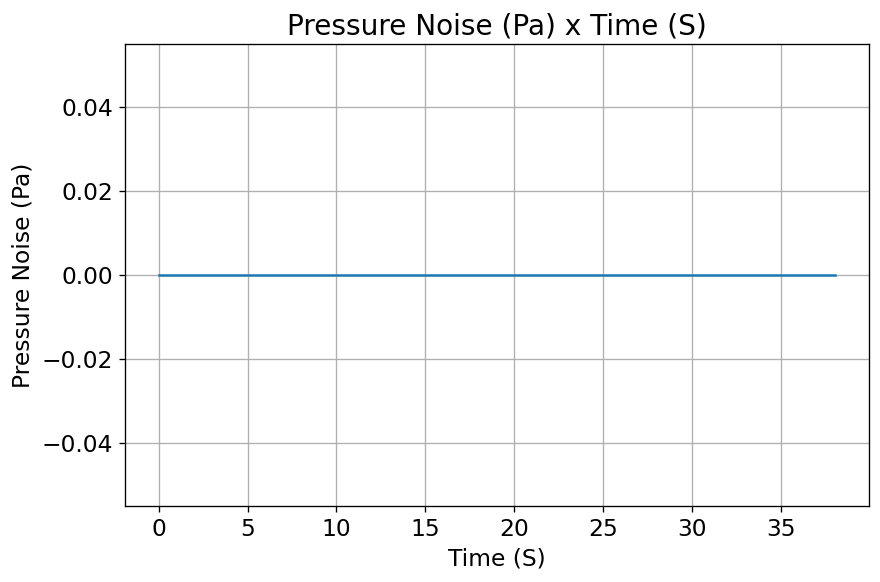

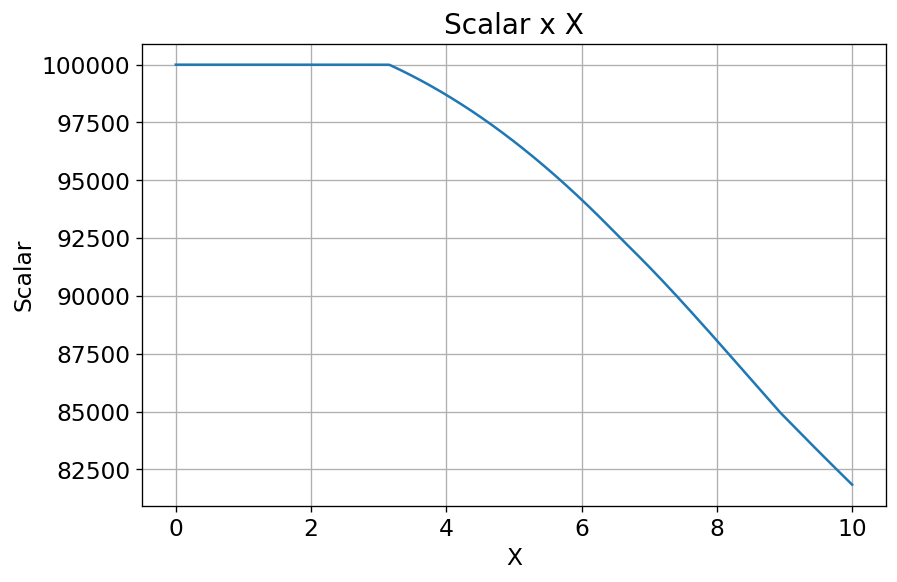

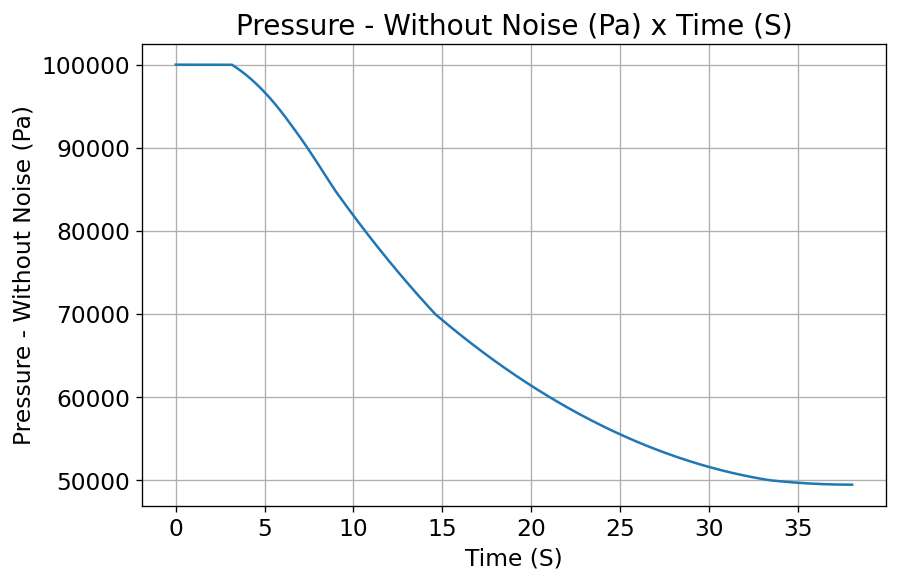


Parachute:  Main


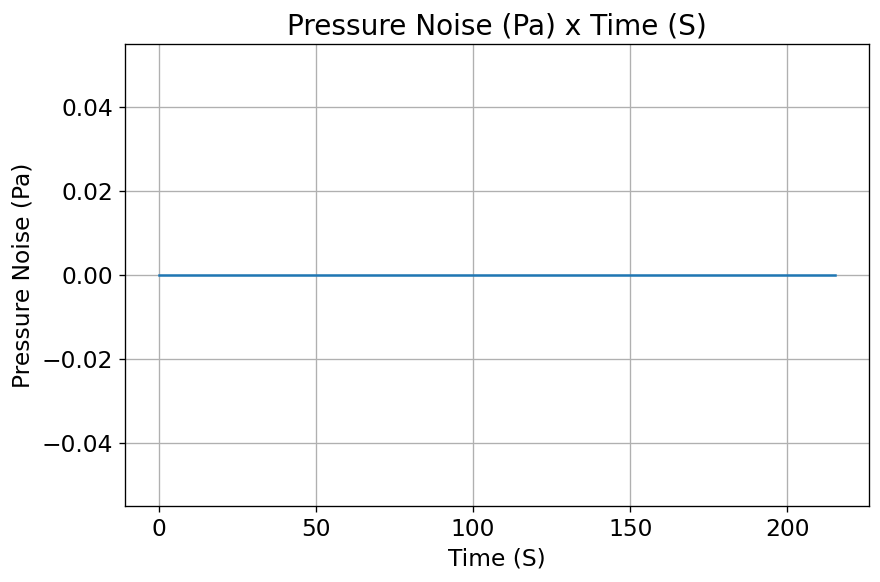

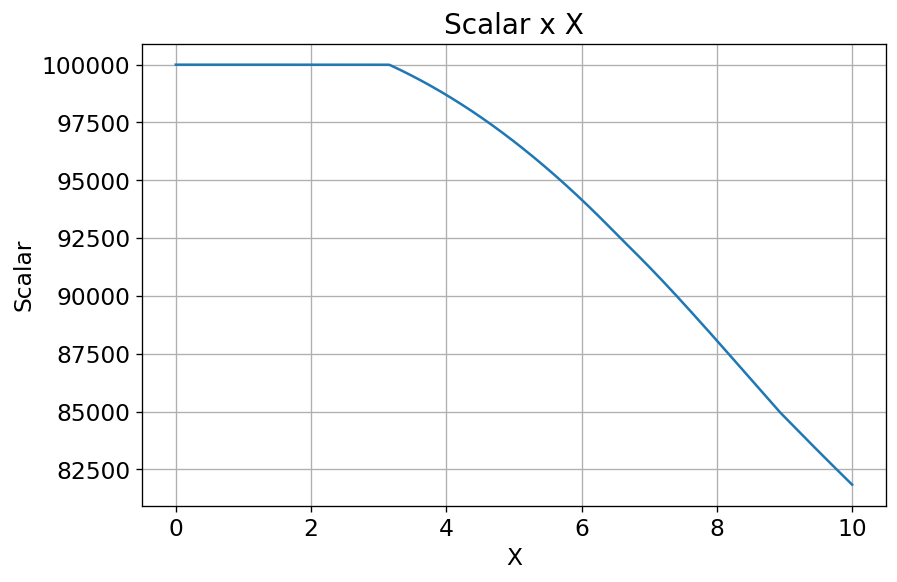

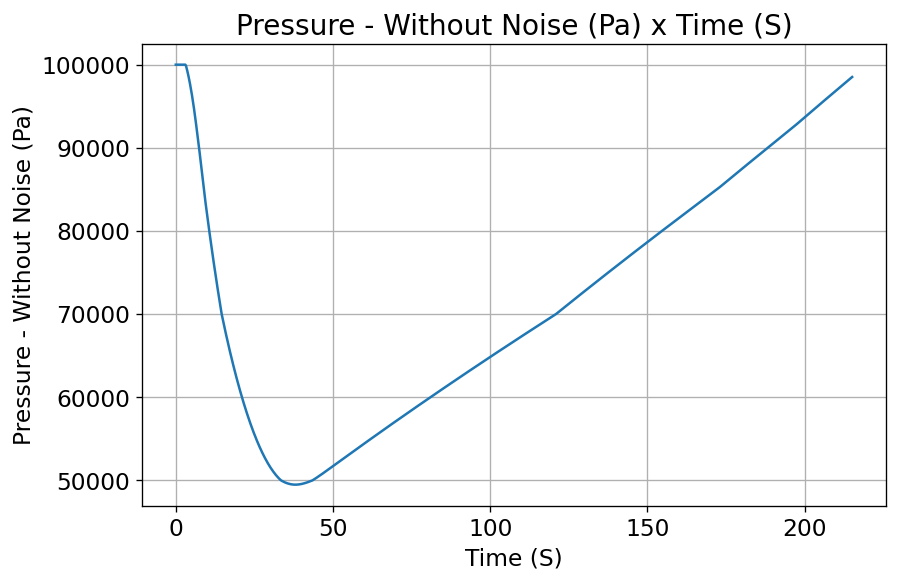

['FlightPhases', 'M1', 'M2', 'M3', 'R1', 'R2', 'R3', 'TimeNodes', '_Flight__cache_sensor_data', '_Flight__calculate_and_save_pressure_signals', '_Flight__calculate_rail_button_forces', '_Flight__evaluate_post_process', '_Flight__init_controllers', '_Flight__init_equations_of_motion', '_Flight__init_flight_state', '_Flight__init_solution_monitors', '_Flight__init_solver_monitors', '_Flight__is_lsoda', '_Flight__post_processed_variables', '_Flight__set_ode_solver', '_Flight__simulate', '_Flight__transform_pressure_signals_lists_to_functions', '__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_controllers', '_solver', 'acceleration', 'aerodynamic_bending_moment', 'aerodynamic_drag', 

In [ ]:
# Set up parachutes. This rocket, named Valetudo, only has a drogue chute.
'''def drogueTrigger(p, y):
    # Check if rocket is going down, i.e. if it has passed the apogee
    vertical_velocity = y[5]
    # Return true to activate parachute once the vertical velocity is negative
    return True if vertical_velocity < 0 else False'''
def drogueTrigger(p, h, y):
    # Check if rocket is going down, i.e. if it has passed the apogee
    vertical_velocity = y[5]
    # Return true to activate parachute once the vertical velocity is negative
    return True if vertical_velocity < 0 else False

def mainTrigger(p, y):
    # Check if rocket is going down, i.e. if it has passed the apogee
    vertical_velocity = y[5]
    # Return true to activate parachute once the vertical velocity is negative
    return True if vertical_velocity < 0 and y[2] < 800 else False #Opening based on height

# Iterate over flight settings
out = display('Starting', display_id=True)
number_of_simulations= 10

import datetime
from rocketpy import Rocket, Flight, Motor, Parachute, Function, SolidMotor


#with open("valetudo_rocket_v0.disp_outputs.txt") as file:
#      file.close()
for setting in flight_settings(analysis_parameters, number_of_simulations):
    start_time = process_time()
    i += 1

    
    Env.select_ensemble_member()
    Env.railLength = setting['railLength']

    # Create motor
    SRAD =  SolidMotor(  #double check later
        thrust_source='DukeAEROinME321.eng', 
        center_of_dry_mass_position=inch_to_meter(43.25)/2.0,
        burn_time=9,
        dry_mass= 15.64,                          # OR
        dry_inertia=(0.125, 0.125, 0.002),

        reshape_thrust_curve=(setting['burnOut'], setting['impulse']),
        nozzle_radius=setting['nozzleRadius'],
        throat_radius=setting['throatRadius'],
        grain_number=6,
        grain_separation=setting['grainSeparation'],
        grain_density=setting['grainDensity'],
        grain_outer_radius=setting['grainOuterRadius'],
        grain_initial_inner_radius=setting['grainInitialInnerRadius'],
        grain_initial_height=setting['grainInitialHeight'],
        #grains_center_of_mass_position= 0.3,
        grains_center_of_mass_position= 0.56, #check this


        interpolation_method='linear',
        coordinate_system_orientation = "nozzle_to_combustion_chamber"

        #Orientation ??
    )
    # Create rocket
    Valetudo = Rocket(
        radius=setting['radius'],
        mass=setting['rocketMass'],
        #inertia=(23.2, 23.2, 0.087), #change this
        inertia = (setting['inertiaI'], setting["inertiaZ"], 0),
        power_off_drag= 'PowerOff.csv', #power_off_drag='/content/Cd_PowerOff.csv', #???
        power_on_drag='PowerOn.csv', #power_on_drag='/content/Cd_PowerOn.csv',


        #center_of_mass_without_motor= inch_to_meter(135-55.693), #Change this  # OR
        center_of_mass_without_motor= inch_to_meter(55.693), #Change this  # OR

        coordinate_system_orientation="nose_to_tail", ##check
)

    rail_buttons = Valetudo.set_rail_buttons( #double check later
        upper_button_position= 2.225,              # VV
        lower_button_position= 3.302,             # VV
        angular_position=0,
)
    Valetudo.add_motor(SRAD, position=inch_to_meter(134.5))

    print("rocketCreated!!!")
    # Edit rocket drag
    Valetudo.power_off_drag *= setting["powerOffDrag"]
    Valetudo.power_on_drag *= setting["powerOnDrag"]
    # Add rocket nose, fins and tail
    NoseCone = Valetudo.add_nose(length=0.3556, kind="ogive", position=0)
    

    FinSet =  Valetudo.add_trapezoidal_fins(
       n=3,
       root_chord=inch_to_meter(14.25),     # OR
       tip_chord=inch_to_meter(5.625),     # OR
       span=inch_to_meter(6.75),         # OR
       position=inch_to_meter(120.75),      # OR
        cant_angle=0,)
    # Add parachute
    Drogue = Valetudo.add_parachute(
    "Drogue",
    cd_s=1.51, 
    trigger= 9144, # Trigger at apogee event
    sampling_rate=100, 
    lag=1/2, 
    noise=(0, 0, 0),) 

    # Add parachute
    Main = Valetudo.add_parachute(
    "Main",
    cd_s=22.713,  
    trigger=304.8, # Trigger at 304 m
    sampling_rate=100, # Not sure
    lag=1/2,    
    noise=(0, 0, 0), 
)
    Valetudo.all_info()
    # Run trajectory simulation
    print("running flight")
    #try:
    TestFlight = Flight(
        rocket=Valetudo,
        environment=Env,
        inclination=setting['inclination'],
        heading=setting['heading'],
        rail_length=5.1816

    )
    TestFlight.all_info()
    results = export_flight_data(setting, TestFlight, process_time() - start_time)
    
    results['apogeeAltitude'] = TestFlight.apogee_state[2]
    #impact_time  = TestFlight.flightData[-1].time
    #print(impact_time)
    print(results)
    with open("valetudo_rocket_v0.disp_outputs.txt", 'a') as file:
      file.write(str(results) + '\n')
      file.close()
    

    # Register time
    out.update(f"Curent iteration: {i:06d} | Average Time per Iteration: {(process_time() - initial_cpu_time)/i:2.6f} s")

# Done
print("flight done")

    

In [160]:




#filename = '/Users/alexzhang/Desktop/projects/Aero/MonteCarlo/RocketPy-Jupiter/rocketpy/valetudo_rocket_v0'
filename = '/content/valetudo_rocket_v0'

# Initialize variable to store all results
dispersion_general_results = []

dispersion_results = {"outOfRailTime": [],
                  "outOfRailVelocity": [],
                         "apogeeTime": [],
                     "apogeeAltitude": [],
                            "apogeeX": [],
                            "apogeeY": [],
                         "impactTime": [],
                            "impactX": [],
                            "impactY": [],
                     "impactVelocity": [],
                "initialStaticMargin": [],
              "outOfRailStaticMargin": [],
                  "finalStaticMargin": [],
                     "numberOfEvents": [],
                        "maxVelocity": [],
                  "drogueTriggerTime": [],
                 "drogueInflatedTime": [],
             "drogueInflatedVelocity": [],
                      "executionTime": []}



#Info
#SRAD.info()
#Valetudo.all_info()
#TestFlight.info()
#TestFlight.all_info()
TestFlight.prints.impact_conditions()




Impact Conditions

Time of impact: 253.852 s
X impact: 1817.313 m
Y impact: -772.756 m
Altitude impact: 0.000 m (ASL) | 0.000 m (AGL) 
Latitude: 32.9815778°
Longitude: -106.9555752°
Vertical velocity at impact: -7.154 m/s
Number of parachutes triggered until impact: 2


In [161]:
# Get all dispersion results
# Get file
print("Flight resluts")
print(results)
#dispersion_output_file = open(str(filename) + '.disp_outputs.txt', 'w')



#dispersion_output_file.write(str(results) + '\n')


dispersion_output_file = open("valetudo_rocket_v0.disp_outputs.txt", 'r+')


#Need to clear dispersion output file and then write to it



# Read each line of the file and convert to dict
for line in dispersion_output_file:
    # Skip comments lines
    if line[0] != '{': continue
    # Eval results and store them
    flight_result = eval(line)
    dispersion_general_results.append(flight_result)
    for parameter_key, parameter_value in flight_result.items():
        dispersion_results[parameter_key].append(parameter_value)

# Close data file
dispersion_output_file.close()

# Print number of flights simulated



Flight resluts
{'outOfRailTime': 0.519536355824371, 'outOfRailVelocity': np.float64(16.20650378267933), 'apogeeX': np.float64(974.6155219417697), 'apogeeY': np.float64(-624.5301804366254), 'apogeeTime': np.float64(37.86950853173185), 'apogeeAltitude': np.float64(5826.58303579723), 'impactX': np.float64(1817.31345661446), 'impactY': np.float64(-772.7563408121571), 'impactVelocity': np.float64(-7.153684498293807), 'initialStaticMargin': np.float64(3.8687613242853276), 'outOfRailStaticMargin': np.float64(3.948143320969402), 'finalStaticMargin': np.float64(5.676439954733269), 'numberOfEvents': 2, 'executionTime': 0.5403200000000083, 'maxVelocity': np.float64(315.2238781056965), 'drogueTriggerTime': 37.87, 'drogueInflatedTime': 38.37, 'drogueInflatedVelocity': np.float64(33.439533894609845)}


<>:69: SyntaxWarning: invalid escape sequence '\s'
<>:69: SyntaxWarning: invalid escape sequence '\s'
/var/folders/01/g4v6c0x12771bc0vycxrq3vr0000gn/T/ipykernel_35563/2442908474.py:69: SyntaxWarning: invalid escape sequence '\s'
  ax.set_title('1$\sigma$, 2$\sigma$ and 3$\sigma$ Dispersion Ellipses: Apogee and Lading Points')
/var/folders/01/g4v6c0x12771bc0vycxrq3vr0000gn/T/ipykernel_35563/2442908474.py:9: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img = imread("Valetudo_basemap_final.jpg")


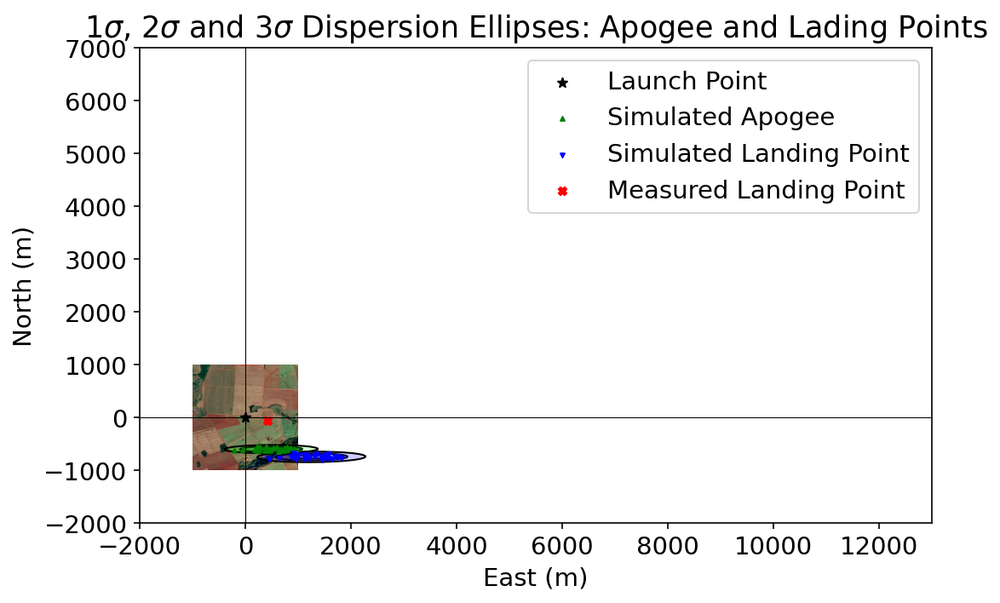

In [162]:

#Error Ellipses
# Import libraries


from imageio import imread
from matplotlib.patches import Ellipse

# Import background map
img = imread("Valetudo_basemap_final.jpg")

# Retrieve dispersion data por apogee and impact XY position
apogeeX = np.array(dispersion_results['apogeeX'])
apogeeY = np.array(dispersion_results['apogeeY'])
impactX = np.array(dispersion_results['impactX'])
impactY = np.array(dispersion_results['impactY'])

# Define function to calculate eigen values
def eigsorted(cov):
    vals, vecs = np.linalg.eigh(cov)
    order = vals.argsort()[::-1]
    return vals[order], vecs[:,order]

# Create plot figure
plt.figure(num=None, figsize=(8, 6), dpi=150, facecolor='w', edgecolor='k')
ax = plt.subplot(111)

# Calculate error ellipses for impact
impactCov = np.cov(impactX, impactY)
impactVals, impactVecs = eigsorted(impactCov)
impactTheta = np.degrees(np.arctan2(*impactVecs[:,0][::-1]))
impactW, impactH = 2 * np.sqrt(impactVals)

# Draw error ellipses for impact
impact_ellipses = []
for j in [1, 2, 3]:
    impactEll = Ellipse(xy=(np.mean(impactX), np.mean(impactY)),
                  width=impactW*j, height=impactH*j,
                  angle=impactTheta, color='black')
    impactEll.set_facecolor((0, 0, 1, 0.2))
    impact_ellipses.append(impactEll)
    ax.add_artist(impactEll)

# Calculate error ellipses for apogee
apogeeCov = np.cov(apogeeX, apogeeY)
apogeeVals, apogeeVecs = eigsorted(apogeeCov)
apogeeTheta = np.degrees(np.arctan2(*apogeeVecs[:,0][::-1]))
apogeeW, apogeeH = 2 * np.sqrt(apogeeVals)

# Draw error ellipses for apogee
for j in [1, 2, 3]:
    apogeeEll = Ellipse(xy=(np.mean(apogeeX), np.mean(apogeeY)),
                  width=apogeeW*j, height=apogeeH*j,
                  angle=apogeeTheta, color='black')
    apogeeEll.set_facecolor((0, 1, 0, 0.2))
    ax.add_artist(apogeeEll)

# Draw launch point
plt.scatter(0, 0, s=30, marker='*', color='black', label='Launch Point')
# Draw apogee points
plt.scatter(apogeeX, apogeeY, s=5, marker='^', color='green', label='Simulated Apogee')
# Draw impact points
plt.scatter(impactX, impactY, s=5, marker='v', color='blue', label='Simulated Landing Point')
# Draw real landing point
plt.scatter(411.89, -61.07, s=20, marker='X', color='red', label='Measured Landing Point')

plt.legend()

# Add title and labels to plot
ax.set_title('1$\sigma$, 2$\sigma$ and 3$\sigma$ Dispersion Ellipses: Apogee and Lading Points')
ax.set_ylabel('North (m)')
ax.set_xlabel('East (m)')

# Add background image to plot
# You can translate the basemap by changing dx and dy (in meters)
dx = 0
dy = 0
plt.imshow(img,zorder=0, extent=[-1000-dx, 1000-dx, -1000-dy, 1000-dy])
plt.axhline(0, color='black', linewidth=0.5)
plt.axvline(0, color='black', linewidth=0.5)
plt.xlim(-2000, 13000)
plt.ylim(-2000, 7000)

# Save plot and show result
plt.savefig('result.pdf', bbox_inches='tight', pad_inches=0)
plt.savefig('result.svg', bbox_inches='tight', pad_inches=0)
plt.show()

Number of simulations:  30
Out of Rail Time -         Mean Value: 0.521 s
Out of Rail Time - Standard Deviation: 0.004 s


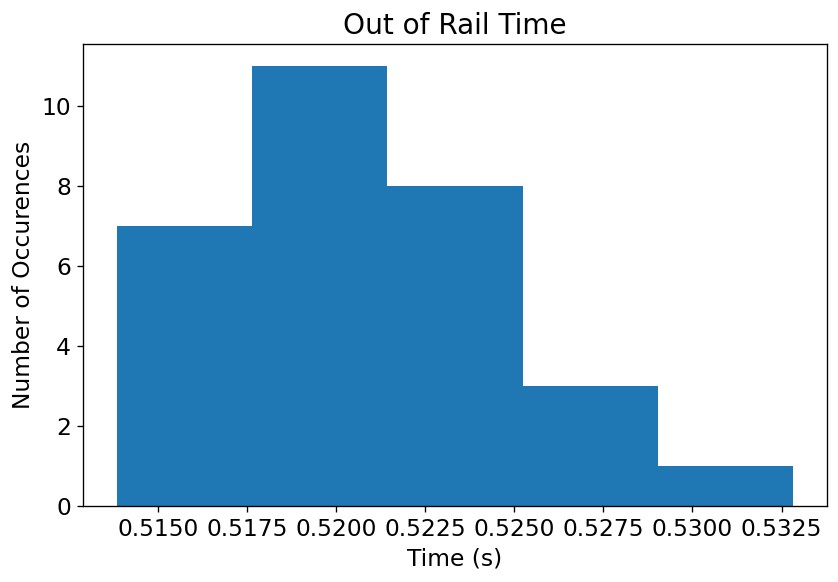

Out of Rail Velocity -         Mean Value: 16.169 m/s
Out of Rail Velocity - Standard Deviation: 0.127 m/s


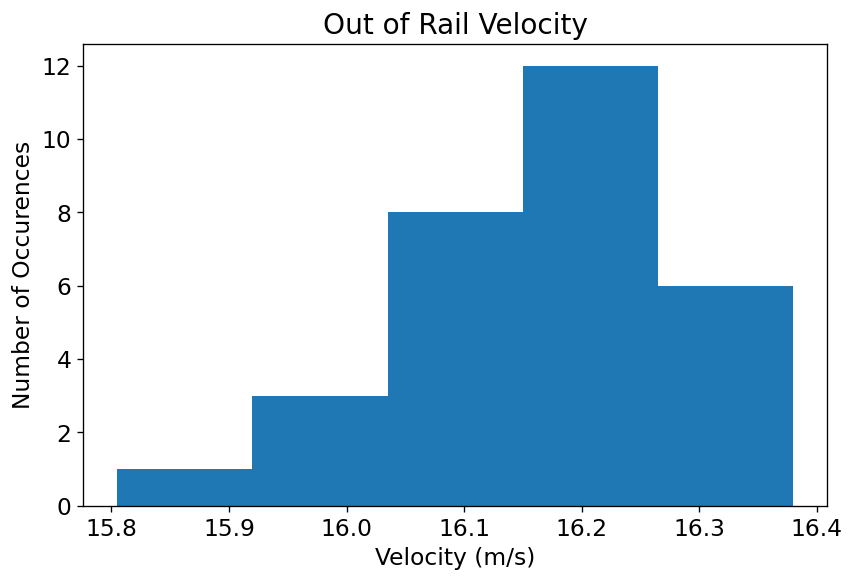

Apogee Time -         Mean Value: 37.883 s
Apogee Time - Standard Deviation: 0.247 s


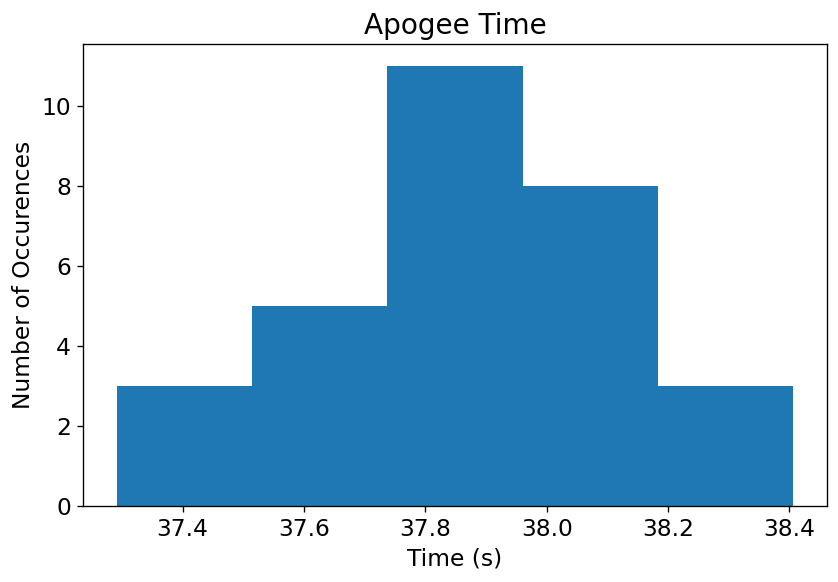

Apogee Altitude - Mean Value: 5832.318 m
Apogee Altitude - Mean Value: 69.040 m


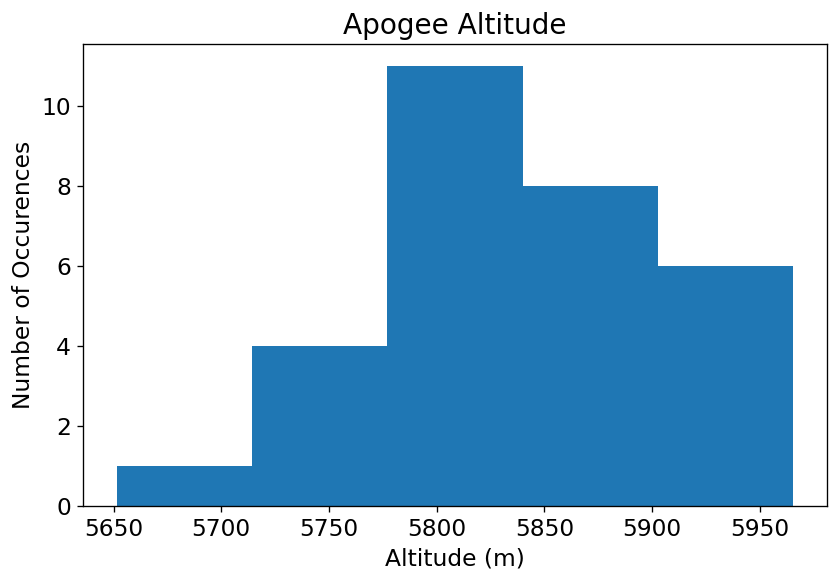

Apogee X Position -         Mean Value: 488.273 m
Apogee X Position - Standard Deviation: 289.921 m


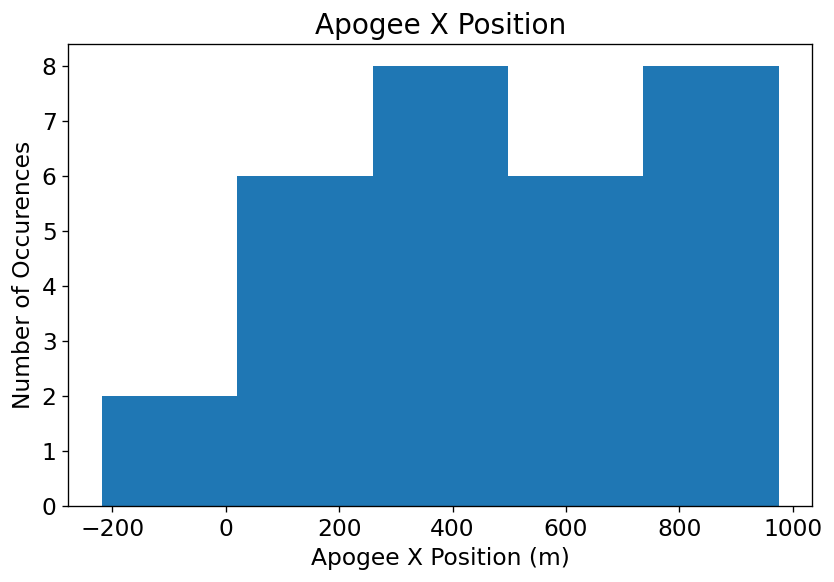

Apogee Y Position -         Mean Value: -600.433 m
Apogee Y Position - Standard Deviation: 25.521 m


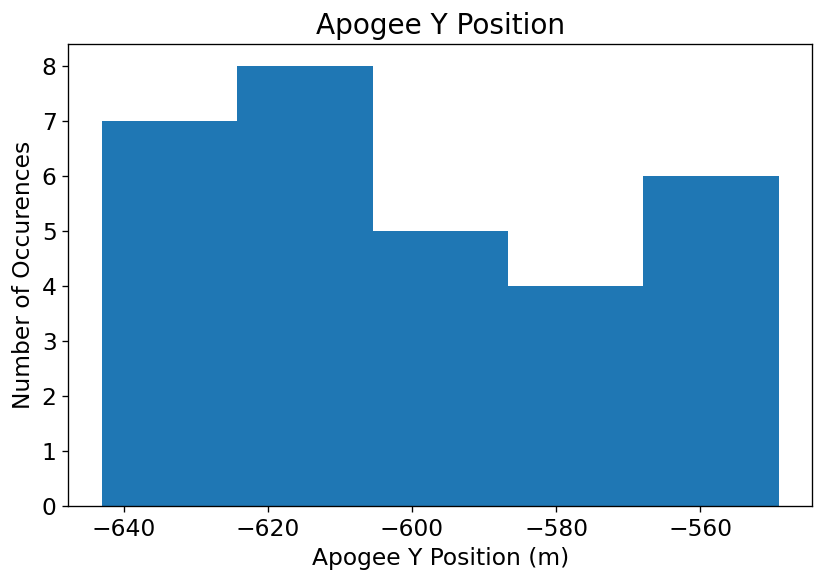

Impact Time -         Mean Value: nan s
Impact Time - Standard Deviation: nan s


/Users/alexzhang/Desktop/projects/Aero/MonteCarloCode/my_env/lib/python3.12/site-packages/numpy/_core/fromnumeric.py:3860: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/Users/alexzhang/Desktop/projects/Aero/MonteCarloCode/my_env/lib/python3.12/site-packages/numpy/_core/_methods.py:145: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/Users/alexzhang/Desktop/projects/Aero/MonteCarloCode/my_env/lib/python3.12/site-packages/numpy/_core/_methods.py:223: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/Users/alexzhang/Desktop/projects/Aero/MonteCarloCode/my_env/lib/python3.12/site-packages/numpy/_core/_methods.py:181: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/Users/alexzhang/Desktop/projects/Aero/MonteCarloCode/my_env/lib/python3.12/site-packages/numpy/_core/_methods.py:215: R

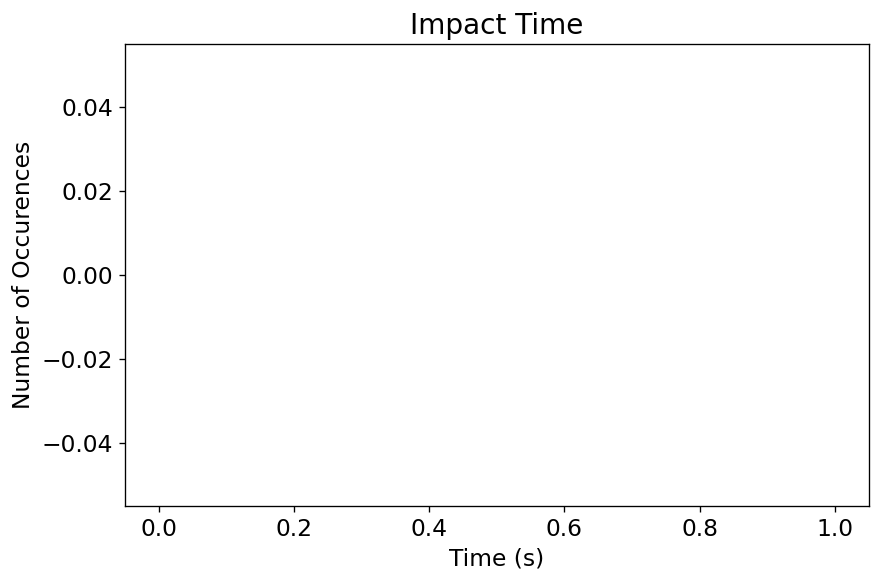

Impact X Position -         Mean Value: 1250.485 m
Impact X Position - Standard Deviation: 335.883 m


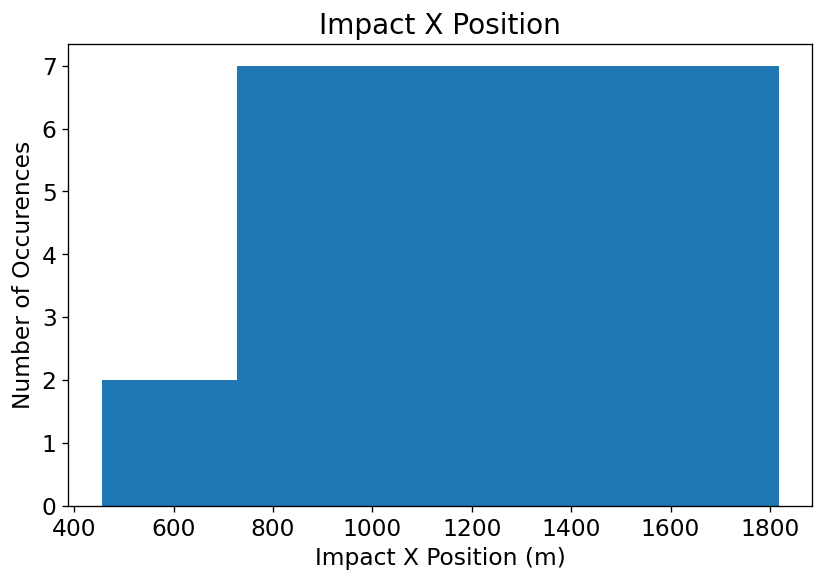

Impact Y Position -         Mean Value: -747.698 m
Impact Y Position - Standard Deviation: 32.976 m


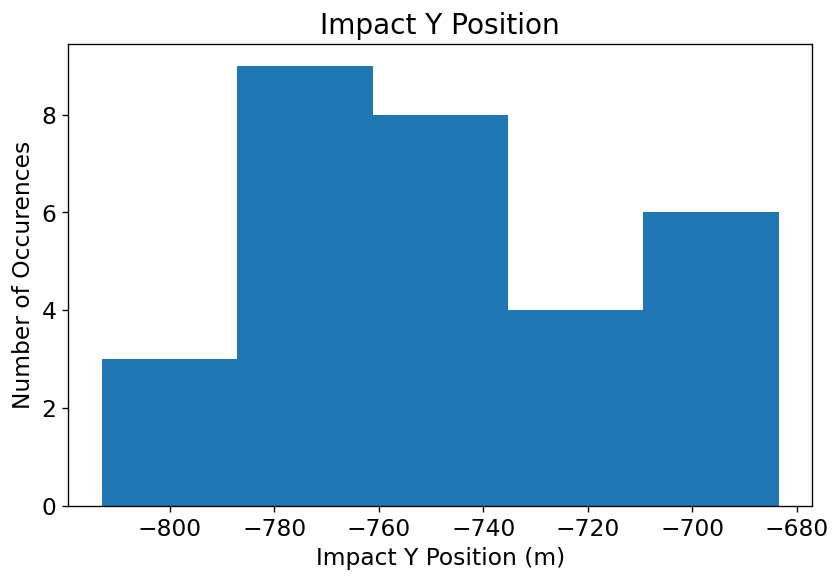

Impact Velocity -         Mean Value: -7.157 m/s
Impact Velocity - Standard Deviation: 0.004 m/s


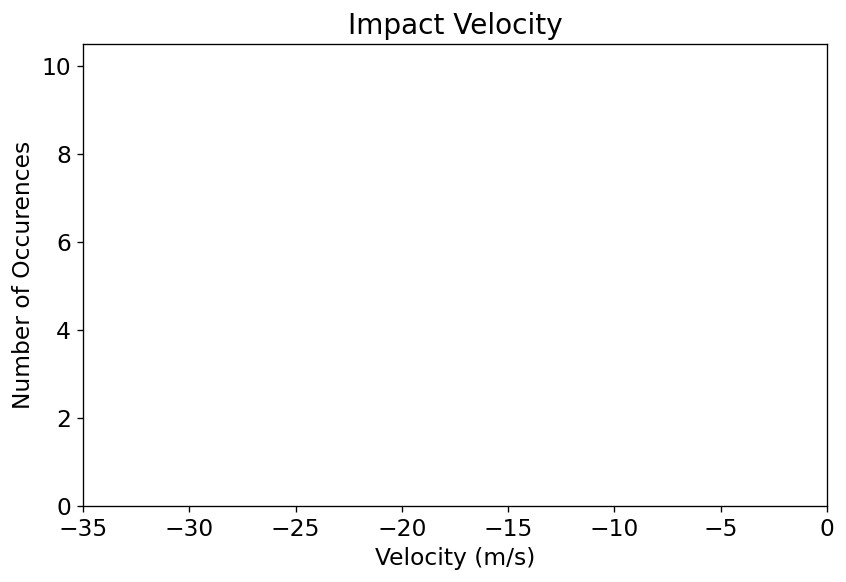

Initial Static Margin -             Mean Value: 2.771 c
Initial Static Margin -     Standard Deviation: 1.103 c
Out of Rail Static Margin -         Mean Value: 2.852 c
Out of Rail Static Margin - Standard Deviation: 1.113 c
Final Static Margin -               Mean Value: 4.610 c
Final Static Margin -       Standard Deviation: 1.343 c


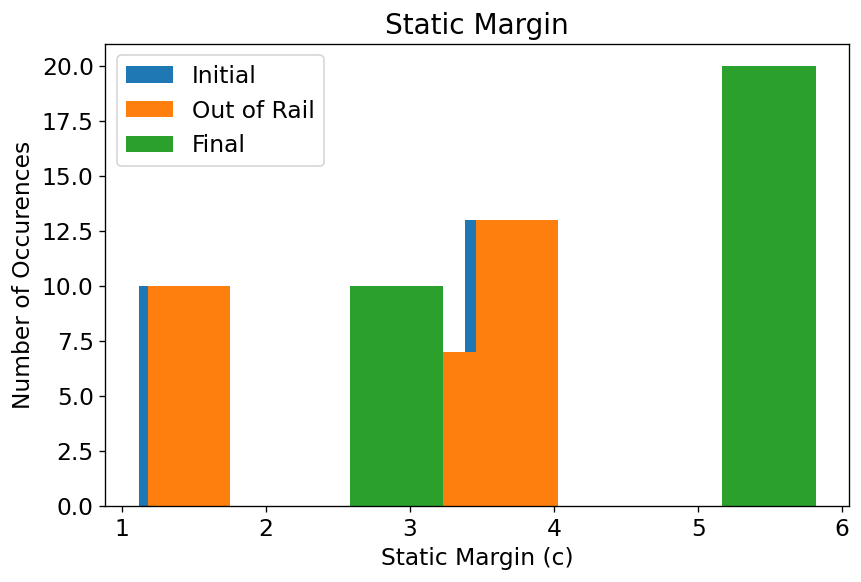

Maximum Velocity -         Mean Value: 314.458 m/s
Maximum Velocity - Standard Deviation: 1.679 m/s


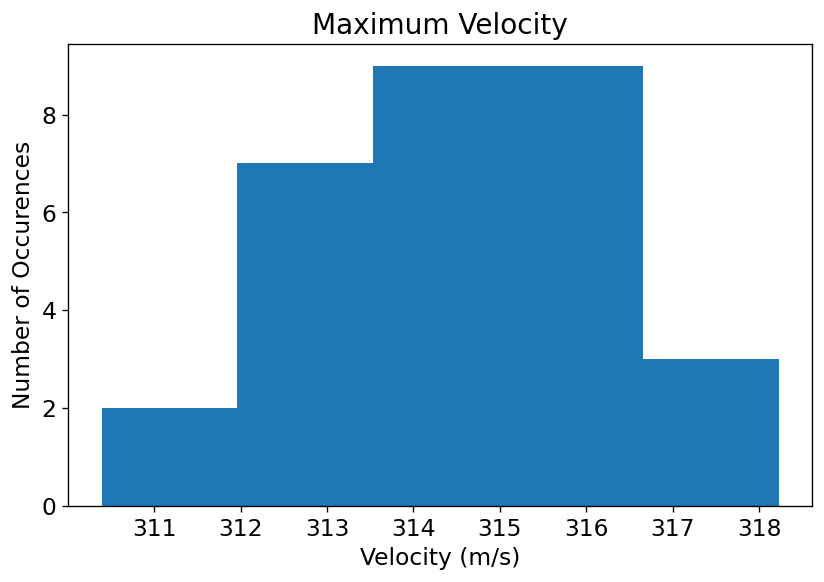

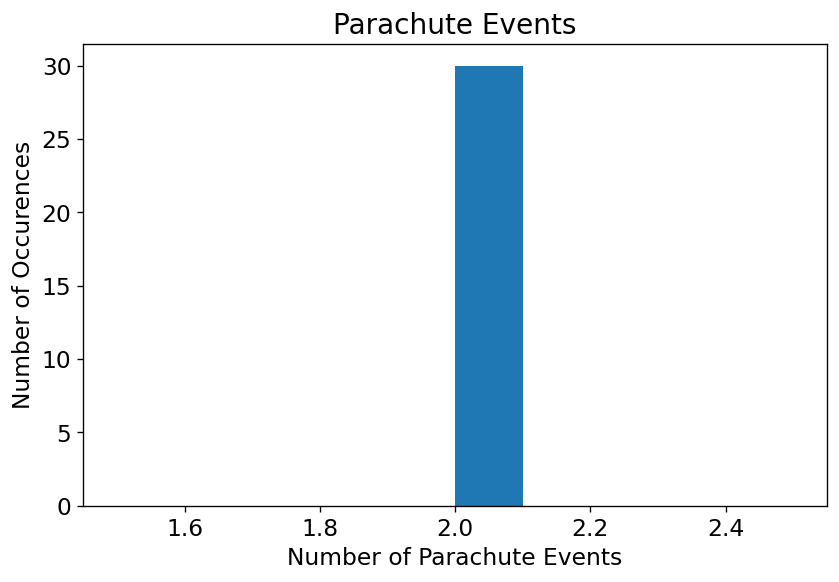

Drogue Parachute Trigger Time -         Mean Value: 37.889 s
Drogue Parachute Trigger Time - Standard Deviation: 0.247 s


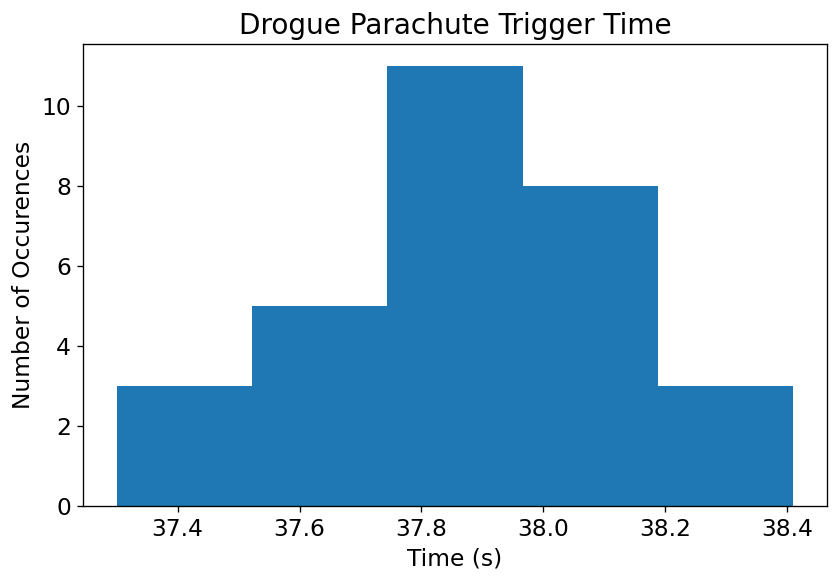

Drogue Parachute Fully Inflated Time -         Mean Value: 38.389 s
Drogue Parachute Fully Inflated Time - Standard Deviation: 0.247 s


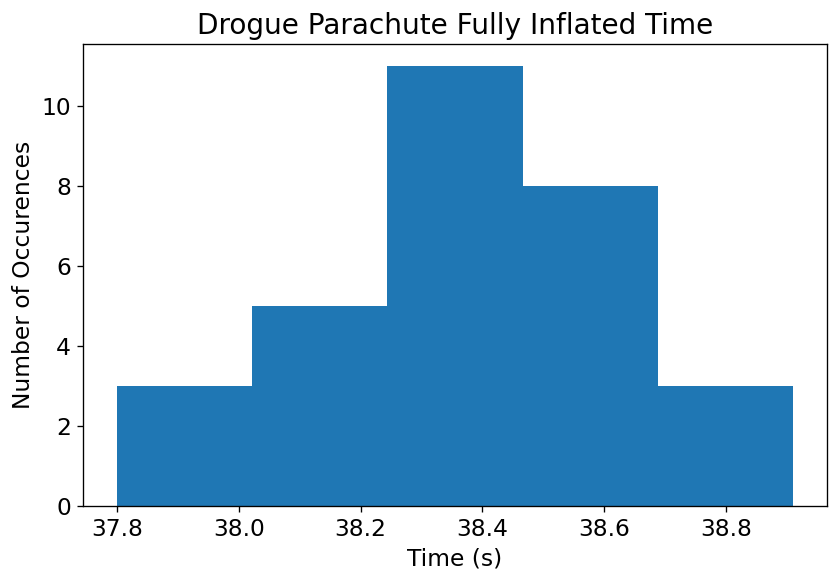

In [163]:
N = len(dispersion_general_results)
print('Number of simulations: ', N)

print(f'Out of Rail Time -         Mean Value: {np.mean(dispersion_results["outOfRailTime"]):0.3f} s')
print(f'Out of Rail Time - Standard Deviation: {np.std(dispersion_results["outOfRailTime"]):0.3f} s')

plt.figure()
plt.hist(dispersion_results["outOfRailTime"], bins=int(N**0.5))
plt.title('Out of Rail Time')
plt.xlabel('Time (s)')
plt.ylabel('Number of Occurences')
plt.show()

# You can also use Plotly instead of Matplotlib if you wish!
# import plotly.express as px
# fig1 = px.histogram(
#     x=dispersion_results["outOfRailTime"],
#     title='Out of Rail Time',
#     nbins=int(N**0.5)
# )
# fig1.update_layout(
#     xaxis_title_text='Time (s)',
#     yaxis_title_text='Number of occurences'
# )

#Out of rail velocity
print(f'Out of Rail Velocity -         Mean Value: {np.mean(dispersion_results["outOfRailVelocity"]):0.3f} m/s')
print(f'Out of Rail Velocity - Standard Deviation: {np.std(dispersion_results["outOfRailVelocity"]):0.3f} m/s')

plt.figure()
plt.hist(dispersion_results["outOfRailVelocity"], bins=int(N**0.5))
plt.title('Out of Rail Velocity')
plt.xlabel('Velocity (m/s)')
plt.ylabel('Number of Occurences')
plt.show()

#Apogee Time
print(f'Apogee Time -         Mean Value: {np.mean(dispersion_results["apogeeTime"]):0.3f} s')
print(f'Apogee Time - Standard Deviation: {np.std(dispersion_results["apogeeTime"]):0.3f} s')

plt.figure()
plt.hist(dispersion_results["apogeeTime"], bins=int(N**0.5))
plt.title('Apogee Time')
plt.xlabel('Time (s)')
plt.ylabel('Number of Occurences')
plt.show()

#Apogee Altitude
#print(f'Apogee Altitude -         Mean Value: {np.mean(dispersion_results["apogeeAltitude"]):0.3f} m')
# Ensure the data is numeric (if it contains strings)
apogee_altitude = pd.to_numeric(dispersion_results["apogeeAltitude"], errors='coerce')

# Now calculate the mean, ignoring NaNs if any
mean_apogee_altitude = np.nanmean(apogee_altitude)
std_apogee_altitude = np.nanstd(apogee_altitude)

# Print the result
print(f'Apogee Altitude - Mean Value: {mean_apogee_altitude:0.3f} m')
print(f'Apogee Altitude - Mean Value: {std_apogee_altitude:0.3f} m')


#print(f'Apogee Altitude - Standard Deviation: {np.std(dispersion_results["apogeeAltitude"]):0.3f} m')

plt.figure()
plt.hist(dispersion_results["apogeeAltitude"], bins=int(N**0.5))
plt.title('Apogee Altitude')
plt.xlabel('Altitude (m)')
plt.ylabel('Number of Occurences')
plt.show()

# Real measured apogee for Valetudo = 860 m

#Apogee X Position
print(f'Apogee X Position -         Mean Value: {np.mean(dispersion_results["apogeeX"]):0.3f} m')
print(f'Apogee X Position - Standard Deviation: {np.std(dispersion_results["apogeeX"]):0.3f} m')

plt.figure()
plt.hist(dispersion_results["apogeeX"], bins=int(N**0.5))
plt.title('Apogee X Position')
plt.xlabel('Apogee X Position (m)')
plt.ylabel('Number of Occurences')
plt.show()

#Apogee Y Position
print(f'Apogee Y Position -         Mean Value: {np.mean(dispersion_results["apogeeY"]):0.3f} m')
print(f'Apogee Y Position - Standard Deviation: {np.std(dispersion_results["apogeeY"]):0.3f} m')

plt.figure()
plt.hist(dispersion_results["apogeeY"], bins=int(N**0.5))
plt.title('Apogee Y Position')
plt.xlabel('Apogee Y Position (m)')
plt.ylabel('Number of Occurences')
plt.show()

#Impact Time
print(f'Impact Time -         Mean Value: {np.mean(dispersion_results["impactTime"]):0.3f} s')
print(f'Impact Time - Standard Deviation: {np.std(dispersion_results["impactTime"]):0.3f} s')

plt.figure()
plt.hist(dispersion_results["impactTime"], bins=int(N**0.5))
plt.title('Impact Time')
plt.xlabel('Time (s)')
plt.ylabel('Number of Occurences')
plt.show()

#Impact X Position
print(f'Impact X Position -         Mean Value: {np.mean(dispersion_results["impactX"]):0.3f} m')
print(f'Impact X Position - Standard Deviation: {np.std(dispersion_results["impactX"]):0.3f} m')

plt.figure()
plt.hist(dispersion_results["impactX"], bins=int(N**0.5))
plt.title('Impact X Position')
plt.xlabel('Impact X Position (m)')
plt.ylabel('Number of Occurences')
plt.show()

#Impact Y Position
print(f'Impact Y Position -         Mean Value: {np.mean(dispersion_results["impactY"]):0.3f} m')
print(f'Impact Y Position - Standard Deviation: {np.std(dispersion_results["impactY"]):0.3f} m')

plt.figure()
plt.hist(dispersion_results["impactY"], bins=int(N**0.5))
plt.title('Impact Y Position')
plt.xlabel('Impact Y Position (m)')
plt.ylabel('Number of Occurences')
plt.show()

#Impact Velocity
print(f'Impact Velocity -         Mean Value: {np.mean(dispersion_results["impactVelocity"]):0.3f} m/s')
print(f'Impact Velocity - Standard Deviation: {np.std(dispersion_results["impactVelocity"]):0.3f} m/s')

plt.figure()
plt.hist(dispersion_results["impactVelocity"], bins=int(N**0.5))
plt.title('Impact Velocity')
# plt.grid()
plt.xlim(-35,0)
plt.xlabel('Velocity (m/s)')
plt.ylabel('Number of Occurences')
plt.show()

#Static Margin
print(f'Initial Static Margin -             Mean Value: {np.mean(dispersion_results["initialStaticMargin"]):0.3f} c')
print(f'Initial Static Margin -     Standard Deviation: {np.std(dispersion_results["initialStaticMargin"]):0.3f} c')

print(f'Out of Rail Static Margin -         Mean Value: {np.mean(dispersion_results["outOfRailStaticMargin"]):0.3f} c')
print(f'Out of Rail Static Margin - Standard Deviation: {np.std(dispersion_results["outOfRailStaticMargin"]):0.3f} c')

print(f'Final Static Margin -               Mean Value: {np.mean(dispersion_results["finalStaticMargin"]):0.3f} c')
print(f'Final Static Margin -       Standard Deviation: {np.std(dispersion_results["finalStaticMargin"]):0.3f} c')

plt.figure()
plt.hist(dispersion_results["initialStaticMargin"], label='Initial', bins=int(N**0.5))
plt.hist(dispersion_results["outOfRailStaticMargin"], label='Out of Rail', bins=int(N**0.5))
plt.hist(dispersion_results["finalStaticMargin"], label='Final', bins=int(N**0.5))
plt.legend()
plt.title('Static Margin')
plt.xlabel('Static Margin (c)')
plt.ylabel('Number of Occurences')
plt.show()

#Maximum Velocity
print(f'Maximum Velocity -         Mean Value: {np.mean(dispersion_results["maxVelocity"]):0.3f} m/s')
print(f'Maximum Velocity - Standard Deviation: {np.std(dispersion_results["maxVelocity"]):0.3f} m/s')

plt.figure()
plt.hist(dispersion_results["maxVelocity"], bins=int(N**0.5))
plt.title('Maximum Velocity')
plt.xlabel('Velocity (m/s)')
plt.ylabel('Number of Occurences')
plt.show()

#NUmber of Parachute Events
plt.figure()
plt.hist(dispersion_results["numberOfEvents"])
plt.title('Parachute Events')
plt.xlabel('Number of Parachute Events')
plt.ylabel('Number of Occurences')
plt.show()

#Drogue Parachute Trigger TIme
print(f'Drogue Parachute Trigger Time -         Mean Value: {np.mean(dispersion_results["drogueTriggerTime"]):0.3f} s')
print(f'Drogue Parachute Trigger Time - Standard Deviation: {np.std(dispersion_results["drogueTriggerTime"]):0.3f} s')

plt.figure()
plt.hist(dispersion_results["drogueTriggerTime"], bins=int(N**0.5))
plt.title('Drogue Parachute Trigger Time')
plt.xlabel('Time (s)')
plt.ylabel('Number of Occurences')
plt.show()

#Drogue Parachute Fully Inflated Time
print(f'Drogue Parachute Fully Inflated Time -         Mean Value: {np.mean(dispersion_results["drogueInflatedTime"]):0.3f} s')
print(f'Drogue Parachute Fully Inflated Time - Standard Deviation: {np.std(dispersion_results["drogueInflatedTime"]):0.3f} s')

plt.figure()
plt.hist(dispersion_results["drogueInflatedTime"], bins=int(N**0.5))
plt.title('Drogue Parachute Fully Inflated Time')
plt.xlabel('Time (s)')
plt.ylabel('Number of Occurences')
plt.show()

In [151]:
print(dispersion_results)


{'outOfRailTime': [0.523409224723406, 0.5187298514077614, 0.5221731627879894, 0.5204371374029519, 0.5201147421303242, 0.5163668312329811, 0.5211284056149847, 0.5145981058381003, 0.5267892188322535, 0.524586579372545], 'outOfRailVelocity': [np.float64(16.088705264627027), np.float64(16.22982856307784), np.float64(16.123402138668062), np.float64(16.178932673935815), np.float64(16.182272102492803), np.float64(16.303008766556843), np.float64(16.155350142043574), np.float64(16.35706036808618), np.float64(15.98136769461047), np.float64(16.051142513233447)], 'apogeeTime': [np.float64(38.03798968757014), np.float64(37.705997820707246), np.float64(37.721905713237625), np.float64(37.83013694952924), np.float64(38.18800234258008), np.float64(37.83977171043456), np.float64(37.83080415857875), np.float64(37.63207685020955), np.float64(38.101076970677305), np.float64(38.09090618317908)], 'apogeeAltitude': [np.float64(5868.550140088174), np.float64(5791.899978121995), np.float64(5766.9261473761135), 

In [133]:
TestFlight.plots.trajectory_3d(filename = "trajectory.jpg")


Env.export_environment(filename='environment.json')

Your Environment file was saved at 'environment.json.json'. You can use it in the future by using the custom_atmosphere atmospheric model.


In [134]:
print(dispersion_results["impactTime"])

[]
